In [2]:
import os
import csv
import optuna
import numpy as np
import pandas as pd
from tensorflow import keras
from tensorflow.keras.optimizers import Adam, RMSprop, SGD
import tensorflow as tf
from keras.models import Sequential
from keras.layers import Input, LSTM, Dense, Activation, Dropout
from pandas import DataFrame
from pandas import Series
from pandas import concat
from pandas import read_csv
from datetime import datetime
from sklearn.metrics import mean_squared_error
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import KFold
from sklearn.model_selection import train_test_split
from sklearn.model_selection import cross_val_score
from math import sqrt
from matplotlib import pyplot as plt
from matplotlib.patches import Patch
from numpy import array
import keras.backend as K
import itertools
#!pip install pydot
    
# date-time parsing function for loading the dataset
def parser(x):
    return datetime.strptime('190'+x, '%Y-%m')
    
def rmse (y_true, y_pred):
    return K.sqrt(K.mean(K.square(y_pred - y_true)))
    
def mape (y_true, y_pred):
    return 100*K.mean(K.sqrt(K.square(y_true - y_pred))/y_true)
    
def pearson (y_true, y_pred):
    return (K.square(K.mean((y_true - K.mean(y_true))*(y_pred - K.mean(y_pred)))))/(K.mean(K.square(y_true - K.mean(y_true)))*K.mean(K.square(y_pred - K.mean(y_pred))))
    
# convert time series into a supervised learning problem
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
# convert time series into a supervised learning problem
def series_to_supervised(data, n_in=1, n_out=1, dropnan=True):

    n_vars = 1 if type(data) is list else data.shape[1]
    cols, names = list(), list()
    df = DataFrame(data)
    # input sequence (t-n, ... t-1)
    for i in range(n_in, 0, -1):
    	cols.append(df.shift(i))
    	names += [('var%d(t-%d)' % (j+1, i)) for j in range(n_vars)]
    # forecast sequence (t, t+1, ... t+n)
    for i in range(0, n_out):
        cols.append(df[0].shift(-i)) # df[0] for temperature
        if i == 0:
            names += [('var%d(t)' % (1))] # % (1) for temperature
        else:            
            names += [('var%d(t+%d)' % (1, i))] # % (1) for temperature
    
    # put it all together
    agg = concat(cols, axis=1)

    if dropnan:
        #Drop rows containing NaN
        agg.dropna(inplace=True)

    #print("Agg:")
    agg.columns = names
    #print(type(agg))
    #print(agg)

    #print("Test columns:")
    #print(agg.iloc[:, -36]) # Column containing response actual values (temperature) at time t

    return agg
     
# create a differenced series
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def difference(dataset, interval=1):
    diff = list()
    for i in range(interval, len(dataset)):
        value = dataset[i] - dataset[i - interval]
        diff.append(value)
    return Series(diff)
     
# transform series into training sets for supervised learning
def prepare_training_data(data, n_lag, n_seq, n_time_steps):
    
    #Prepare data for time series forecasting.
        
    #Parameters:
    #x (array-like): Input features.
    #y (array-like): Target values.
    #n_test (int): Number of test samples (rows).
    #n_lag (int): Number of lag observations.
    #n_seq (int): Number of sequence observations.
    #n_train (int): Number of training samples (rows).
        
    #Returns:
    #tuple: Training and test datasets.
    
    n_vars = len(data[0][0])

    print(n_vars)
    print(len(data))
    print(type(data))

    # Each weather station has 227 time steps (the first 180 have no nan values)
    # Loop through data, grabbing one weather station (ws) at a time, 
    # differencing on each ws and separating by training (first 226-n_lag-n_seq-n_test time steps) 
    # and testing (n_test time steps) to scale data on training only.
    # We then recombine the training and testing datasets to change each ws to a supervised learning problem by taking all the first 180 time steps for all 12 predictors
    # and changing these to (t-n_lag) to (t-1) since we lose one row through differencing. We then shift forward only one dependent variable (temperature or specific humidity)
    # for time steps t to (t+n_seq)


    diff_values = []
    
    for ws in range(84):
        
        # transform data to be stationary
        diff_series = difference(data[ws], 1)
        for i in range(len(diff_series)):
            diff_values_row = []
            for j in range(len(diff_series[0])):
                diff_values_row.append(diff_series[i][j])
            diff_values.append(diff_values_row)

    #print("Diff values:")
    #print(len(diff_values))
    #print(len(diff_values[0]))
    #print(len(diff_values_for_training))
    #print(len(diff_values_for_training[0]))
    
    # rescale values to 0, 1
    scaler_all_features =  MinMaxScaler(feature_range=(0, 1))
    scaler =  MinMaxScaler(feature_range=(0, 1))
    #diff_values_training = np.array(diff_values_for_training)
    #diff_values_training = diff_values_training.reshape(1, -1) 
    train_scaled_values = scaler_all_features.fit_transform(diff_values)
    response_train_values = []
    for i in range(len(diff_values)):
        response_train_values.append(diff_values[i][0]) # Uses first column (temperatures) as response variable
    response_train_values = np.array(response_train_values)
    response_train_values = response_train_values.reshape(len(response_train_values), 1)

    # Fit the scaler for just the response variable for use later when forecasting
    response_scaled_values = scaler.fit_transform(response_train_values) 
    scaled_values = scaler_all_features.transform(diff_values)

    #print("Scaled values rows:")
    #print(len(scaled_values))

    train = []

    # Transform each weather station as a separate "batch"
    for ws in range(84):
        # transform into supervised learning problem X, y
        first = (n_time_steps-1)*ws
        last = (n_time_steps-1)*ws+(n_time_steps-2)
        #print("Batch "+str(ws+1)+":")
        #print("Range: "+str(first)+"-"+str(last))
        scaled_values_batch = scaled_values[first:last]
        supervised = series_to_supervised(scaled_values_batch, n_lag, n_seq)
        supervised_values = supervised.values
        train.append([supervised_values])
        #print("Supervised count:")
        #print(len(supervised_values))
        #print(len(supervised_values[0]))
    
    return scaler, scaler_all_features, train

# transform series into testing and validation sets for supervised learning
def prepare_testing_and_validation_data(data, n_lag, n_seq, n_time_steps, scaler_all_features):
    
    #Prepare data for time series forecasting.
        
    #Parameters:
    #x (array-like): Input features.
    #y (array-like): Target values.
    #n_test (int): Number of test samples (rows).
    #n_lag (int): Number of lag observations.
    #n_seq (int): Number of sequence observations.
    #n_train (int): Number of training samples (rows).
        
    #Returns:
    #tuple: Training and test datasets.
    
    n_vars = len(data[0][0])

    print(n_vars)
    print(len(data))
    print(type(data))

    # Each weather station has 227 time steps (the first 180 have no nan values)
    # Loop through data, grabbing one weather station (ws) at a time, 
    # differencing on each ws and separating by training (first 226-n_lag-n_seq-n_test time steps) 
    # and testing (n_test time steps) to scale data on training only.
    # We then recombine the training and testing datasets to change each ws to a supervised learning problem by taking all the first 180 time steps for all 12 predictors
    # and changing these to (t-n_lag) to (t-1) since we lose one row through differencing. We then shift forward only one dependent variable (temperature or specific humidity)
    # for time steps t to (t+n_seq)


    diff_values = []
    
    for ws in range(21):
        
        # transform data to be stationary
        diff_series = difference(data[ws], 1)
        for i in range(len(diff_series)):
            diff_values_row = []
            for j in range(len(diff_series[0])):
                diff_values_row.append(diff_series[i][j])
            diff_values.append(diff_values_row)

    #print("Diff values:")
    #print(len(diff_values))
    #print(len(diff_values[0]))
    #print(len(diff_values_for_training))
    #print(len(diff_values_for_training[0]))
    
    # rescale values to 0, 1
    scaled_values = scaler_all_features.transform(diff_values)

    validation = []
    test = []

    # Transform each weather station as a separate "batch"
    for ws in range(21):
        # transform into supervised learning problem X, y
        first = (n_time_steps-1)*ws
        last = (n_time_steps-1)*ws+(n_time_steps-2)
        #print("Batch "+str(ws+1)+":")
        #print("Range: "+str(first)+"-"+str(last))
        scaled_values_batch = scaled_values[first:last]
        supervised = series_to_supervised(scaled_values_batch, n_lag, n_seq)
        supervised_values = supervised.values
        # training/test/validation split is 80%/10%/10%
        if ws < 11:
            test.append([supervised_values])
        else:
            validation.append([supervised_values])
        #print("Supervised count:")
        #print(len(supervised_values))
        #print(len(supervised_values[0]))
    
    return validation, test
    
def plot_kfold(cv, X, y, ax, n_splits, xlim_max=105):
    
    #Plots the indices for a cross-validation object.
    #Taken from https://www.geeksforgeeks.org/cross-validation-using-k-fold-with-scikit-learn/
    
    #Parameters:
    #cv: Cross-validation object
    #X: Feature set
    #y: Target variable
    #ax: Matplotlib axis object
    #n_splits: Number of folds in the cross-validation
    #xlim_max: Maximum limit for the x-axis
        
    # Set color map for the plot
    cmap_cv = plt.cm.coolwarm
    cv_split = cv.split(X=X, y=y)
        
    for i_split, (train_idx, test_idx) in enumerate(cv_split):
        # Create an array of NaNs and fill in training/testing indices
        indices = np.full(len(X), np.nan)
        indices[test_idx], indices[train_idx] = 1, 0
            
        # Plot the training and testing indices
        ax_x = range(len(indices))
        ax_y = [i_split + 0.5] * len(indices)
        ax.scatter(ax_x, ax_y, c=indices, marker="_", 
                   lw=10, cmap=cmap_cv, vmin=-0.2, vmax=1.2)
    
        # Set y-ticks and labels
        y_ticks = np.arange(n_splits) + 0.5
        ax.set(yticks=y_ticks, yticklabels=range(n_splits),
               xlabel="Weather Station index (file_id)", ylabel="Fold",
               ylim=[n_splits, -0.2], xlim=[0, xlim_max])
    
        # Set plot title and create legend
        ax.set_title("KFold", fontsize=14)
        legend_patches = [Patch(color=cmap_cv(0.8), label="Testing set"), 
                          Patch(color=cmap_cv(0.02), label="Training set")]
        ax.legend(handles=legend_patches, loc=(1.03, 0.8))
    
#Main

#Configure
n_seq = 60
if n_seq > 46:
    n_lag = 179 - n_seq + 46
else:
    n_lag = 179
n_time_steps = 227
n_test = 1

print("Model Parameters:")
print("n_lag (number of input time steps): "+str(n_lag))
print("n_seq (number of output/future prediction time steps): "+str(n_seq))

# Create 2D array with file_ids to use for sample creation
array = np.array([
    6501, 6541, 6640, 6668, 6678, 
    6687, 6697, 6714, 6744, 6772, 
    6783, 6840, 6844, 6854, 6870, 
    6891, 6895, 6899, 6901, 6909, 
    6929, 6950, 6963, 6969, 6994, 
    7032, 7057, 7094, 7095, 7100, 
    7108, 7116, 7119, 7131, 7139, 
    7152, 7155, 7156, 7182, 7193, 
    7202, 7239, 7280, 7286, 7287, 
    7311, 7321, 7329, 7347, 7350, 
    7354, 7357, 7361, 7414, 7423, 
    7424, 7432, 7463, 7482, 7489, 
    7528, 7531, 7534, 7538, 7549, 
    7553, 7555, 7562, 7571, 7573, 
    7574, 7575, 7585, 7599, 7603, 
    7606, 7622, 7652, 7671, 7704, 
    7786, 7805, 7816, 7838, 7861, 
    7862, 7863, 7870, 7892, 7907, 
    7938, 7962, 7979, 7987, 7999, 
    8000, 8034, 8083, 8120, 8133, 
    8184, 8186, 8247, 8248, 9858])
    
#Create arrays holding the 5-fold cross-validation indices gathered for consistency across models
train_array = []
test_array = []
    
train_array.append([1, 2, 3, 5, 6, 7, 8, 9, 11, 13, 14, 15, 16, 17, 19, 20, 21, 22, 
                        23, 24, 25, 27, 28, 29, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42, 
                        43, 44, 46, 48, 49, 50, 51, 52, 54, 55, 56, 57, 58, 59, 60, 61, 
                        62, 63, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 78, 79, 81, 
                        82, 83, 84, 85, 86, 87, 88, 90, 91, 92, 93, 95, 97, 98, 100, 101, 102, 103])
test_array.append([0, 4, 10, 12, 18, 26, 30, 31, 33, 45, 47, 53, 64, 65, 77, 80, 89, 94, 96, 99, 104])
    
train_array.append([0, 1, 2, 3, 4, 6, 7, 8, 10, 12, 13, 14, 17, 18, 19, 20, 21, 23, 
                        24, 25, 26, 27, 29, 30, 31, 32, 33, 34, 36, 37, 38, 41, 43, 45, 
                        46, 47, 48, 49, 50, 51, 52, 53, 54, 57, 58, 59, 60, 61, 63, 64, 
                        65, 66, 67, 68, 69, 70, 71, 73, 74, 75, 77, 80, 81, 82, 83, 84, 
                        86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 104])
test_array.append([5, 9, 11, 15, 16, 22, 28, 35, 39, 40, 42, 44, 55, 56, 62, 72, 76, 78, 79, 85, 103])
    
train_array.append([0, 1, 2, 4, 5, 9, 10, 11, 12, 14, 15, 16, 18, 20, 21, 22, 23, 26, 
                    28, 29, 30, 31, 32, 33, 35, 36, 37, 39, 40, 41, 42, 44, 45, 46, 47, 
                    48, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 
                    70, 71, 72, 74, 75, 76, 77, 78, 79, 80, 82, 83, 85, 86, 87, 88, 89, 
                    90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104])
test_array.append([3, 6, 7, 8, 13, 17, 19, 24, 25, 27, 34, 38, 43, 49, 66, 67, 68, 69, 73, 81, 84])
    
train_array.append([0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 
                        18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 33, 34, 
                        35, 37, 38, 39, 40, 42, 43, 44, 45, 47, 49, 51, 52, 53, 55, 56, 
                        60, 62, 64, 65, 66, 67, 68, 69, 71, 72, 73, 74, 76, 77, 78, 79, 
                        80, 81, 82, 84, 85, 86, 87, 88, 89, 92, 93, 94, 95, 96, 99, 102, 103, 104])
test_array.append([32, 36, 41, 46, 48, 50, 54, 57, 58, 59, 61, 63, 70, 75, 83, 90, 91, 97, 98, 100, 101])
    
train_array.append([0, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 15, 16, 17, 18, 19, 22,
                        24, 25, 26, 27, 28, 30, 31, 32, 33, 34, 35, 36, 38, 39, 40, 41, 
                        42, 43, 44, 45, 46, 47, 48, 49, 50, 53, 54, 55, 56, 57, 58, 59, 
                        61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 72, 73, 75, 76, 77, 78, 
                        79, 80, 81, 83, 84, 85, 89, 90, 91, 94, 96, 97, 98, 99, 100, 101, 103, 104])
test_array.append([1, 2, 14, 20, 21, 23, 29, 37, 51, 52, 60, 71, 74, 82, 86, 87, 88, 92, 93, 95, 102])
    
# Equations for three Principal Components from PCA using response variables combined with other predictors
#PC1=-0.0002714X1+0.02612X2+0.03858X3-0.007658X4+0.001592X5-0.02087X6+0.8564X7-0.1468X8+0.01192X9-0.0001049X10+0.01913X11+0.02076X12
#PC2=0.0003944X1+0.002204X2+0.01052X3+0.3248X4-0.0009976X5-0.04421X6+2.3406X7+0.06103X8+0.08841X9+0.00009018X10+0.05678X11-0.002022X12
#PC3=-0.00007998X1-0.0006124X2-0.001063X3-0.01855X4+0.00001956X5+0.01170X6+0.6076X7+0.4664X8-0.002995X9+0.008185X10+0.8815X11-0.0004730X12
    
# Equations for three Principal Components from PCA omitting both response variables,
#PC-1=-0.0004514X1+0.03194X2-0.04343X3+0.002243X4-0.02252X5+0.9877X6-0.2265X7+0.006144X8-0.0001488X9+0.02943X10
#PC-2=0.0001702X1+0.005484X2+0.2057X3-0.0003188X4-0.02584X5+1.6963X6-0.05890X7+0.05809X8+1.9748X9+0.03686X10
#PC-3=-0.00006323X1-0.001180X2-0.02384X3-0.00002833X4+0.01170X5+0.5204X6+0.4791X7-0.004318X8+0.008271X9+0.8765X10
    
# Get the current working directory 
current_directory = os.getcwd() 
    
# Print the current working directory 
print(current_directory)
    
# Define the directory containing the files 
path = current_directory+"\\Modeling\\"
print(path)
    
filename = path + 'Final_Monthly_Dataset.csv'
    
# load dataset
df = read_csv(filename, header=0, parse_dates=[0], index_col=0, date_format='%Y-%m')
    
df = df.rename(columns={'Unnamed: 0' : 'indices'})
    
#Remove unused columns
df = df.drop(['Day', 'vapor_pressure'], axis=1)
    
# Round numbers in columns to reasonable precision,
df['temperatures'] = np.round(df['temperatures'], 2)
df['slp'] = np.round(df['slp'], 2)
df['wet_bulb_temperature'] = np.round(df['wet_bulb_temperature'], 2)
df['specific_humidity'] = np.round(df['specific_humidity'], 2)
df['GHI'] = np.round(df['GHI'], 2)
df['PRCP'] = np.round(df['PRCP'], 2)
df['SNDP'] = np.round(df['SNDP'], 2)
df['solar_activity'] = np.round(df['solar_activity'], 2)
df['ONI'] = np.round(df['ONI'], 2)
df['water'] = np.round(df['water'], 0)
df['region'] = np.round(df['region'], 0)
    
df_trimmed = df[df['file_id'] != 7533] # Remove file_id 7533 so there are 105 weather stations for 5-fold CV
df_trimmed = df_trimmed.drop(['Year', 'Month', 'date', 'latitude', 'longitude', 'elevation'], axis=1)
    
X = []
y = []
    
for i in array:
    add_to_X = [] # create list to store each column to add to X
    new_df = df_trimmed[df_trimmed['file_id'] == i].drop(['file_id'], axis=1)
    #new_df = new_df.iloc[:180, :]
    add_to_y = []
    for j in range(new_df.shape[0]):
        add_to_y.append(new_df['temperatures'].iloc[j])
    y.append(add_to_y)
    #new_df = new_df.drop(['temperatures'], axis=1)
    columns_list = new_df.columns.tolist()
    for j in range(new_df.shape[0]):
        l=0
        new_row = []
        for m in columns_list:
            new_row.append(new_df.iloc[j, l])
            l += 1
        add_to_X.append(new_row)
    X.append(add_to_X)
    
#Perform k-fold cross-validation
#Taken from: https://www.geeksforgeeks.org/cross-validation-using-k-fold-with-scikit-learn/
    
#k = 5  # Number of folds
#kf = KFold(n_splits=k, shuffle=True, random_state=42)
    
#for i, (train_index, test_index) in enumerate(kf.split(X)):
#    print(f"Fold {i}:")
#    print(f"  Training dataset index: {train_index}")
#    print(f"  Test dataset index: {test_index}")
    
#for train_indices, test_indices in kf.split(X):
#    print('Train: %s | test: %s' % (train_indices, test_indices))
    
# Create figure and axis
#fig, ax = plt.subplots(figsize=(6, 3))
#plot_kfold(kf, X, y, ax, k)
#plt.tight_layout()
#fig.subplots_adjust(right=0.6)
    
#Create train and test sets for each cross-validation split
train_X = []
train_y = []
val_X = []
val_y = []
for i in range(5):
    print(f"Fold {i+1}")
    #Add each corresponding sample for each entry of train index 
    train_X_rows = [] # Stores all the samples for one fold of train_X
    train_y_rows = [] # Stores all the samples for one fold of train_y
    for j in train_array[i]:
        train_X_rows.append(X[j])
        train_y_rows.append(y[j])
    # Stores one fold of train dataset
    train_X.append(train_X_rows)
    train_y.append(train_y_rows)
    #Add each corresponding sample for each entry of the validation index 
    val_X_rows = [] # Stores all the samples for one fold of val_X
    val_y_rows = [] # Stores all the samples for one fold of val_y
    for j in test_array[i]: 
            val_X_rows.append(X[j])
            val_y_rows.append(y[j])
    # Stores one fold of validation dataset
    val_X.append(val_X_rows)
    val_y.append(val_y_rows) 
    
    #print("Train_X Fold "+str(i)+":")
    #print(len(train_X[i]))
    #print(len(train_X[i][0]))
    #print(len(train_X[i][0][0])) 
    #print("Train_y Fold "+str(i)+":")
    #print(len(train_y[i]))
    #print(len(train_y[i][0]))
    #print(train_y[i][0][0])
    #print("Validation_X Fold "+str(i)+":")
    #print(len(val_X[i]))
    #print(len(val_X[i][0]))
    #print(len(val_X[i][0][0]))
    #print("Validation_y Fold "+str(i)+":")
    #print(len(val_y[i]))
    #print(len(val_y[i][0]))
    #print(val_y[i][0][0])
    
#Convert 3D arrays to DataFrames
df_X = []
df_y = []
val_df_X = []
val_df_y = []
dataset = []
dataset_test = []
scaler = []
scaler_all_features = []
train = []
test = []
validation = []

for i in range(5):
    dataset_scaling = [] # Holds all 84 weather station rows to train the scaling function
    dataset_testing = [] # Holds remaining 21 weather station rows for testing and validation
    print("Fold "+str(i+1)+":")
    #Transform train_X to the correct format
    df1 = []
    dataset_df = [] # captures each weather station's dataset as values for training scaler mapping
    df_X.append(pd.DataFrame(train_X[i]))
    X_t = df_X[i].transpose()
    for k in range(84):
        X = np.array(X_t.iloc[:, k])
        df = pd.DataFrame()
        for j in range(n_time_steps):
            new_row = pd.DataFrame(X[j]).transpose()
            new_row.columns = new_df.columns
            # Add the new row
            df = pd.concat([df, new_row], ignore_index=True)
        df.columns = new_df.columns
        df1.append(df)
        dataset_df.append(df.values)
        dataset_scaling.append(df.values)
    df_X[i] = df1
    dataset.append(dataset_df)
     

    #print(len(dataset))
    #print(len(dataset[0]))
    #print(len(dataset_scaling))
    #print(len(dataset_scaling[:][0]))
    #print("Stop")
    
    #Transform train_y to the correct format
    df2 = []
    df_y.append(pd.DataFrame(train_y[i]))
    y_t = df_y[i].transpose()
    
    for j in range(84):
        y = np.array(y_t.iloc[:, j])
        y = pd.DataFrame(y)
        y.columns = ['temperatures']
        df2.append(y)
    df_y[i] = df2

    #Transform val_X to the correct format
    df3 = []
    dataset_vl_df = [] # captures each weather station's dataset as values for training scaler mapping
    val_df_X.append(pd.DataFrame(val_X[i]))
    val_X_t = val_df_X[i].transpose()
    for k in range(21):
        vl_X = np.array(val_X_t.iloc[:, k])
        vl_df = pd.DataFrame()
        for j in range(n_time_steps):
            new1_row = pd.DataFrame(vl_X[j]).transpose()
            new1_row.columns = new_df.columns
            # Add the new row
            vl_df = pd.concat([vl_df, new1_row], ignore_index=True)
        vl_df.columns = new_df.columns
        df3.append(vl_df)
        dataset_vl_df.append(vl_df.values)
        dataset_testing.append(vl_df.values)
    val_df_X[i] = df3
    dataset_test.append(dataset_vl_df)

    #Transform val_y to the correct format
    df4 = []
    val_df_y.append(pd.DataFrame(train_y[i]))
    val_y_t = val_df_y[i].transpose()
    
    for j in range(21):
        v_y = np.array(val_y_t.iloc[:, j])
        v_y = pd.DataFrame(v_y)
        v_y.columns = ['temperatures']
        df4.append(v_y)
    val_df_y[i] = df4
    
    scaler.append(MinMaxScaler(feature_range=(0, 1)))
    scaler_all_features.append(MinMaxScaler(feature_range=(0, 1)))
    train.append([1])
    test.append([1])
    validation.append([1])
    
    # prepare data
    scaler[i], scaler_all_features[i], train[i] = prepare_training_data(dataset_scaling, n_lag, n_seq, n_time_steps)

    validation[i], test[i] = prepare_testing_and_validation_data(dataset_testing, n_lag, n_seq, n_time_steps, scaler_all_features[i])

    #Reshape dimensionality
    train1 = train[i]
    test1 = test[i]
    validation1 = validation[i]
    print(np.array(train1).shape)
    print(np.array(test1).shape)
    print(np.array(validation1).shape)
    train2 = []
    test2 = []
    validation2 = []

    for k in range(84):
        train2.append(train1[k][0])
        
    for k in range(11):
        test2.append(test1[k][0])

    for k in range(10):
        validation2.append(validation1[k][0])

    print(np.array(train2).shape)
    print(np.array(test2).shape)
    print(np.array(validation2).shape)

    train[i] = train2
    test[i] = test2
    validation[i] = validation2

    #Reshape dimensionality (again)
    dim_size = n_seq + 12*n_lag
    train1 = np.array(train[i]).reshape(84, dim_size)
    test1 = np.array(test[i]).reshape(11, dim_size)
    validation1 = np.array(validation[i]).reshape(10, dim_size)
    train2 = pd.DataFrame(train1).values
    test2 = pd.DataFrame(test1).values
    validation2 = pd.DataFrame(validation1).values
    print(np.array(train2).shape)
    print(np.array(test2).shape)
    print(np.array(validation2).shape)

    print(train2)

    train[i] = train2
    test[i] = test2
    validation[i] = validation2
    
    #X_train = train1[:][:-n_seq]
    #y_train = train1[:][-n_seq:]
    #X_test = test1[:][:-n_seq]
    #y_test = test1[:][-n_seq:]


Model Parameters:
n_lag (number of input time steps): 165
n_seq (number of output/future prediction time steps): 60
C:\Users\User
C:\Users\User\Modeling\
Fold 1
Fold 2
Fold 3
Fold 4
Fold 5
Fold 1:
12
84
<class 'list'>
12
21
<class 'list'>
(84, 1, 1, 2040)
(11, 1, 1, 2040)
(10, 1, 1, 2040)
(84, 1, 2040)
(11, 1, 2040)
(10, 1, 2040)
(84, 2040)
(11, 2040)
(10, 2040)
[[0.39307412 0.69695044 0.32924264 ... 0.45808019 0.42952612 0.37788578]
 [0.45747266 0.51683609 0.42215989 ... 0.49422843 0.47691373 0.38882139]
 [0.38487242 0.62674714 0.3411641  ... 0.51032807 0.38244228 0.37363305]
 ...
 [0.54100851 0.46473952 0.46949509 ... 0.48025516 0.45504253 0.40583232]
 [0.44896719 0.51620076 0.3997195  ... 0.49696233 0.45170109 0.39611179]
 [0.46780073 0.52414231 0.42356241 ... 0.49301337 0.4881531  0.43772783]]
Fold 2:
12
84
<class 'list'>
12
21
<class 'list'>
(84, 1, 1, 2040)
(11, 1, 1, 2040)
(10, 1, 1, 2040)
(84, 1, 2040)
(11, 1, 2040)
(10, 1, 2040)
(84, 2040)
(11, 2040)
(10, 2040)
[[0.38166311 0.

In [2]:
print(n_seq)
print(n_lag)
print(np.array(train[1]).shape)
print(np.array(test[1]).shape)

60
165
(84, 2040)
(11, 2040)


[I 2025-05-18 16:23:06,047] A new study created in memory with name: no-name-ac3df8a7-0fb3-43b7-b910-98d23076524d
[I 2025-05-18 16:27:03,139] Trial 0 finished with value: 0.5060068368911743 and parameters: {'lr': 0.29698174272055783, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.31780389114660235}. Best is trial 0 with value: 0.5060068368911743.


Cross Validation Accuracies:
[0.49511605501174927, 0.6201498508453369, 0.41846200823783875, 0.6492351293563843, 0.3470711410045624]
Mean Cross Validation Accuracy:
0.5060068368911743
Standard Deviation of Cross Validation Accuracy:
0.11540037519686716


[I 2025-05-18 16:30:51,575] Trial 1 finished with value: 0.09516151249408722 and parameters: {'lr': 0.014408806903418623, 'optimizer': 'Adam', 'activation_function': 'tanh', 'lstm_units': 512, 'dropout_rate': 0.27970674126273687}. Best is trial 1 with value: 0.09516151249408722.


Cross Validation Accuracies:
[0.08902981132268906, 0.10314986854791641, 0.08787543326616287, 0.09257730841636658, 0.10317514091730118]
Mean Cross Validation Accuracy:
0.09516151249408722
Standard Deviation of Cross Validation Accuracy:
0.006714088075596214


[I 2025-05-18 16:35:34,501] Trial 2 finished with value: 0.05120259001851082 and parameters: {'lr': 0.013948192237791243, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.26131834248266084}. Best is trial 2 with value: 0.05120259001851082.


Cross Validation Accuracies:
[0.042854923754930496, 0.04557938873767853, 0.056579384952783585, 0.06261538714170456, 0.048383865505456924]
Mean Cross Validation Accuracy:
0.05120259001851082
Standard Deviation of Cross Validation Accuracy:
0.007326813693738397


[I 2025-05-18 16:39:07,386] Trial 3 finished with value: 0.15685375928878784 and parameters: {'lr': 0.0030713017275097046, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.4084100067306007}. Best is trial 2 with value: 0.05120259001851082.


Cross Validation Accuracies:
[0.18653105199337006, 0.14725950360298157, 0.1697692722082138, 0.12897655367851257, 0.1517324149608612]
Mean Cross Validation Accuracy:
0.15685375928878784
Standard Deviation of Cross Validation Accuracy:
0.019712781025378854


[I 2025-05-18 16:43:01,335] Trial 4 finished with value: 0.06099615097045898 and parameters: {'lr': 0.03349523209513895, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.16281084571279902}. Best is trial 2 with value: 0.05120259001851082.


Cross Validation Accuracies:
[0.04556339979171753, 0.07825231552124023, 0.05568418279290199, 0.06982030719518661, 0.05566054955124855]
Mean Cross Validation Accuracy:
0.06099615097045898
Standard Deviation of Cross Validation Accuracy:
0.011580124398736336


[I 2025-05-18 16:50:14,336] Trial 5 finished with value: 17.81078758239746 and parameters: {'lr': 0.1932509916120153, 'optimizer': 'RMSprop', 'activation_function': 'tanh', 'lstm_units': 1024, 'dropout_rate': 0.3390576290742664}. Best is trial 2 with value: 0.05120259001851082.


Cross Validation Accuracies:
[16.146427154541016, 16.648284912109375, 17.80168342590332, 19.007369995117188, 19.450172424316406]
Mean Cross Validation Accuracy:
17.81078758239746
Standard Deviation of Cross Validation Accuracy:
1.2838211018869146


[I 2025-05-18 16:55:48,528] Trial 6 finished with value: 0.32445245385169985 and parameters: {'lr': 0.17343645647495137, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.16647972054399568}. Best is trial 2 with value: 0.05120259001851082.


Cross Validation Accuracies:
[0.33255502581596375, 0.25240468978881836, 0.3324074447154999, 0.27985355257987976, 0.4250415563583374]
Mean Cross Validation Accuracy:
0.32445245385169985
Standard Deviation of Cross Validation Accuracy:
0.05903734986647732


[I 2025-05-18 17:02:30,462] Trial 7 finished with value: 0.06206820383667946 and parameters: {'lr': 0.0030268843589711107, 'optimizer': 'RMSprop', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.18913646351791505}. Best is trial 2 with value: 0.05120259001851082.


Cross Validation Accuracies:
[0.05151995271444321, 0.055699750781059265, 0.07033677399158478, 0.0749289020895958, 0.05785563960671425]
Mean Cross Validation Accuracy:
0.06206820383667946
Standard Deviation of Cross Validation Accuracy:
0.008981484347368592


[I 2025-05-18 17:06:49,479] Trial 8 finished with value: 2.110949087142944 and parameters: {'lr': 0.1825251466617383, 'optimizer': 'RMSprop', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.1680497930900442}. Best is trial 2 with value: 0.05120259001851082.


Cross Validation Accuracies:
[2.4176864624023438, 2.3084030151367188, 1.8812508583068848, 1.929060459136963, 2.0183446407318115]
Mean Cross Validation Accuracy:
2.110949087142944
Standard Deviation of Cross Validation Accuracy:
0.2133055104232564


[I 2025-05-18 17:12:20,792] Trial 9 finished with value: 0.2333028256893158 and parameters: {'lr': 0.046984255323140364, 'optimizer': 'Adam', 'activation_function': 'tanh', 'lstm_units': 1024, 'dropout_rate': 0.35356112717638477}. Best is trial 2 with value: 0.05120259001851082.


Cross Validation Accuracies:
[0.22767725586891174, 0.18928135931491852, 0.27025270462036133, 0.22872374951839447, 0.2505790591239929]
Mean Cross Validation Accuracy:
0.2333028256893158
Standard Deviation of Cross Validation Accuracy:
0.027034297737666163


[I 2025-05-18 17:15:50,809] Trial 10 finished with value: 0.050633519887924194 and parameters: {'lr': 0.9980624671028815, 'optimizer': 'SGD', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.49642884101317575}. Best is trial 10 with value: 0.050633519887924194.


Cross Validation Accuracies:
[0.04076169803738594, 0.04463436082005501, 0.05510783568024635, 0.06243911758065224, 0.05022458732128143]
Mean Cross Validation Accuracy:
0.050633519887924194
Standard Deviation of Cross Validation Accuracy:
0.007655085116527337


[I 2025-05-18 17:19:09,990] Trial 11 finished with value: 0.05115214958786964 and parameters: {'lr': 0.9000925852865834, 'optimizer': 'SGD', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.48531285855512724}. Best is trial 10 with value: 0.050633519887924194.


Cross Validation Accuracies:
[0.04125293716788292, 0.04493257403373718, 0.05781799927353859, 0.06283874809741974, 0.04891848936676979]
Mean Cross Validation Accuracy:
0.05115214958786964
Standard Deviation of Cross Validation Accuracy:
0.008033391579504346


[I 2025-05-18 17:22:18,276] Trial 12 finished with value: 0.05167665258049965 and parameters: {'lr': 0.8209007340400255, 'optimizer': 'SGD', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.497191934808085}. Best is trial 10 with value: 0.050633519887924194.


Cross Validation Accuracies:
[0.03947872668504715, 0.049594130367040634, 0.054687999188899994, 0.06555619835853577, 0.0490662083029747]
Mean Cross Validation Accuracy:
0.05167665258049965
Standard Deviation of Cross Validation Accuracy:
0.008504712971606838


[I 2025-05-18 17:24:58,041] Trial 13 finished with value: 0.051234462112188336 and parameters: {'lr': 0.8268432729051752, 'optimizer': 'SGD', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.4891443813453797}. Best is trial 10 with value: 0.050633519887924194.


Cross Validation Accuracies:
[0.041623517870903015, 0.044134728610515594, 0.05605212599039078, 0.06481456756591797, 0.04954737052321434]
Mean Cross Validation Accuracy:
0.051234462112188336
Standard Deviation of Cross Validation Accuracy:
0.008405377949993808


[I 2025-05-18 17:27:10,779] Trial 14 finished with value: 0.05258800908923149 and parameters: {'lr': 0.9632630155749831, 'optimizer': 'SGD', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.41936069005519505}. Best is trial 10 with value: 0.050633519887924194.


Cross Validation Accuracies:
[0.04389183223247528, 0.04641476646065712, 0.057789500802755356, 0.06534470617771149, 0.04949923977255821]
Mean Cross Validation Accuracy:
0.05258800908923149
Standard Deviation of Cross Validation Accuracy:
0.007912796585530856


[I 2025-05-18 17:29:21,618] Trial 15 finished with value: 0.5053215026855469 and parameters: {'lr': 0.0010483298206350631, 'optimizer': 'SGD', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.44304962149576377}. Best is trial 10 with value: 0.050633519887924194.


Cross Validation Accuracies:
[0.5002774000167847, 0.5065346956253052, 0.5150234699249268, 0.49077874422073364, 0.5139932036399841]
Mean Cross Validation Accuracy:
0.5053215026855469
Standard Deviation of Cross Validation Accuracy:
0.009030317805760536


[I 2025-05-18 17:31:51,734] Trial 16 finished with value: 0.05371336936950684 and parameters: {'lr': 0.4016309532510117, 'optimizer': 'SGD', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.4535782251581964}. Best is trial 10 with value: 0.050633519887924194.


Cross Validation Accuracies:
[0.045630645006895065, 0.047614578157663345, 0.05813783034682274, 0.06409512460231781, 0.05308866873383522]
Mean Cross Validation Accuracy:
0.05371336936950684
Standard Deviation of Cross Validation Accuracy:
0.006786348574979257


[I 2025-05-18 17:35:24,129] Trial 17 finished with value: 0.05528087541460991 and parameters: {'lr': 0.08001572530134655, 'optimizer': 'SGD', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.38014342100576887}. Best is trial 10 with value: 0.050633519887924194.


Cross Validation Accuracies:
[0.05710998922586441, 0.046562209725379944, 0.05919357389211655, 0.06389933079481125, 0.049639273434877396]
Mean Cross Validation Accuracy:
0.05528087541460991
Standard Deviation of Cross Validation Accuracy:
0.00633680430736509


[I 2025-05-18 17:39:17,994] Trial 18 finished with value: 0.054469408094882966 and parameters: {'lr': 0.08983702819353191, 'optimizer': 'SGD', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.235998507160264}. Best is trial 10 with value: 0.050633519887924194.


Cross Validation Accuracies:
[0.04566151276230812, 0.0472976453602314, 0.06036296859383583, 0.06532197445631027, 0.0537029393017292]
Mean Cross Validation Accuracy:
0.054469408094882966
Standard Deviation of Cross Validation Accuracy:
0.007511496885529679


[I 2025-05-18 17:41:17,755] Trial 19 finished with value: 0.054272673279047015 and parameters: {'lr': 0.46788183950155443, 'optimizer': 'SGD', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.4673491532007089}. Best is trial 10 with value: 0.050633519887924194.


Cross Validation Accuracies:
[0.048090044409036636, 0.04566169157624245, 0.059503257274627686, 0.06353984028100967, 0.05456853285431862]
Mean Cross Validation Accuracy:
0.054272673279047015
Standard Deviation of Cross Validation Accuracy:
0.006718643191831086


[I 2025-05-18 17:42:29,638] Trial 20 finished with value: 0.05171536356210708 and parameters: {'lr': 0.014569649378879508, 'optimizer': 'RMSprop', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.3869638834592674}. Best is trial 10 with value: 0.050633519887924194.


Cross Validation Accuracies:
[0.04609682410955429, 0.0469045527279377, 0.05329485237598419, 0.06135964021086693, 0.05092094838619232]
Mean Cross Validation Accuracy:
0.05171536356210708
Standard Deviation of Cross Validation Accuracy:
0.005492719525421898


[I 2025-05-18 17:44:24,716] Trial 21 finished with value: 0.051897817850112916 and parameters: {'lr': 0.013553105825205318, 'optimizer': 'SGD', 'activation_function': 'relu', 'lstm_units': 1024, 'dropout_rate': 0.10338783434295443}. Best is trial 10 with value: 0.050633519887924194.


Cross Validation Accuracies:
[0.04236256703734398, 0.04529568925499916, 0.05775947868824005, 0.06398032605648041, 0.05009102821350098]
Mean Cross Validation Accuracy:
0.051897817850112916
Standard Deviation of Cross Validation Accuracy:
0.007976461260207672


[I 2025-05-18 17:46:20,390] Trial 22 finished with value: 0.05128640010952949 and parameters: {'lr': 0.00756798071281617, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.26338796720246355}. Best is trial 10 with value: 0.050633519887924194.


Cross Validation Accuracies:
[0.04272444546222687, 0.04542502388358116, 0.056797321885824203, 0.06254743784666061, 0.04893777146935463]
Mean Cross Validation Accuracy:
0.05128640010952949
Standard Deviation of Cross Validation Accuracy:
0.007353367730170433


[I 2025-05-18 17:47:17,630] Trial 23 finished with value: 0.05358706191182137 and parameters: {'lr': 0.07898942390414265, 'optimizer': 'SGD', 'activation_function': 'tanh', 'lstm_units': 256, 'dropout_rate': 0.2417252243497029}. Best is trial 10 with value: 0.050633519887924194.


Cross Validation Accuracies:
[0.04646776616573334, 0.04904163256287575, 0.0585821233689785, 0.06329023092985153, 0.05055355653166771]
Mean Cross Validation Accuracy:
0.05358706191182137
Standard Deviation of Cross Validation Accuracy:
0.006319012307808582


[I 2025-05-18 17:49:11,724] Trial 24 finished with value: 0.3394468367099762 and parameters: {'lr': 0.0065878605977781534, 'optimizer': 'SGD', 'activation_function': 'relu', 'lstm_units': 1024, 'dropout_rate': 0.30744695308536624}. Best is trial 10 with value: 0.050633519887924194.


Cross Validation Accuracies:
[0.3293604850769043, 0.3252300024032593, 0.37356722354888916, 0.27369120717048645, 0.3953852653503418]
Mean Cross Validation Accuracy:
0.3394468367099762
Standard Deviation of Cross Validation Accuracy:
0.04223970710101


[I 2025-05-18 17:50:08,540] Trial 25 finished with value: 0.055935341864824295 and parameters: {'lr': 0.4012362288533934, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.21597493616298086}. Best is trial 10 with value: 0.050633519887924194.


Cross Validation Accuracies:
[0.05163329467177391, 0.050638068467378616, 0.05948922783136368, 0.06682898104190826, 0.051087137311697006]
Mean Cross Validation Accuracy:
0.055935341864824295
Standard Deviation of Cross Validation Accuracy:
0.00634626319768014


[I 2025-05-18 17:52:03,458] Trial 26 finished with value: 0.05574812740087509 and parameters: {'lr': 0.03152831193914176, 'optimizer': 'SGD', 'activation_function': 'relu', 'lstm_units': 1024, 'dropout_rate': 0.43953452066202026}. Best is trial 10 with value: 0.050633519887924194.


Cross Validation Accuracies:
[0.050075460225343704, 0.05300244316458702, 0.058232132345438004, 0.06516464799642563, 0.0522659532725811]
Mean Cross Validation Accuracy:
0.05574812740087509
Standard Deviation of Cross Validation Accuracy:
0.0054163569335957265


[I 2025-05-18 17:53:00,393] Trial 27 finished with value: 0.05181351378560066 and parameters: {'lr': 0.5571647550743268, 'optimizer': 'SGD', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.380081737167246}. Best is trial 10 with value: 0.050633519887924194.


Cross Validation Accuracies:
[0.042915355414152145, 0.046122923493385315, 0.058802880346775055, 0.062148336321115494, 0.0490780733525753]
Mean Cross Validation Accuracy:
0.05181351378560066
Standard Deviation of Cross Validation Accuracy:
0.007412185594099932


[I 2025-05-18 17:54:11,326] Trial 28 finished with value: 1.3142987012863159 and parameters: {'lr': 0.022353895609591425, 'optimizer': 'RMSprop', 'activation_function': 'tanh', 'lstm_units': 256, 'dropout_rate': 0.4717491043589646}. Best is trial 10 with value: 0.050633519887924194.


Cross Validation Accuracies:
[0.9929751753807068, 0.7471227049827576, 1.7781994342803955, 1.190519094467163, 1.8626770973205566]
Mean Cross Validation Accuracy:
1.3142987012863159
Standard Deviation of Cross Validation Accuracy:
0.437305743263722


[I 2025-05-18 17:56:05,598] Trial 29 finished with value: 0.05855252370238304 and parameters: {'lr': 0.2532515277285152, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.34088787976057244}. Best is trial 10 with value: 0.050633519887924194.


Cross Validation Accuracies:
[0.05566832795739174, 0.0503695048391819, 0.06485157459974289, 0.06595654040575027, 0.055916670709848404]
Mean Cross Validation Accuracy:
0.05855252370238304
Standard Deviation of Cross Validation Accuracy:
0.0059451763533213435


[I 2025-05-18 17:57:26,660] Trial 30 finished with value: 0.23188124299049379 and parameters: {'lr': 0.12297135019855206, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.2872594970494031}. Best is trial 10 with value: 0.050633519887924194.


Cross Validation Accuracies:
[0.2179366648197174, 0.2592393457889557, 0.1980637162923813, 0.23247720301151276, 0.25168928503990173]
Mean Cross Validation Accuracy:
0.23188124299049379
Standard Deviation of Cross Validation Accuracy:
0.022267715910022835


[I 2025-05-18 17:58:21,442] Trial 31 finished with value: 0.05156188309192657 and parameters: {'lr': 0.7222723970967063, 'optimizer': 'SGD', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.4924084190721662}. Best is trial 10 with value: 0.050633519887924194.


Cross Validation Accuracies:
[0.042287904769182205, 0.04575890675187111, 0.05567916855216026, 0.06434151530265808, 0.049741920083761215]
Mean Cross Validation Accuracy:
0.05156188309192657
Standard Deviation of Cross Validation Accuracy:
0.007787997338054042


[I 2025-05-18 17:59:16,166] Trial 32 finished with value: 0.05196512937545776 and parameters: {'lr': 0.619932212868821, 'optimizer': 'SGD', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.49920832892768746}. Best is trial 10 with value: 0.050633519887924194.


Cross Validation Accuracies:
[0.04300757870078087, 0.04569827392697334, 0.05565278232097626, 0.06469158828258514, 0.050775423645973206]
Mean Cross Validation Accuracy:
0.05196512937545776
Standard Deviation of Cross Validation Accuracy:
0.007700495199476003


[I 2025-05-18 18:00:10,990] Trial 33 finished with value: 0.05118766725063324 and parameters: {'lr': 0.9922870639417618, 'optimizer': 'SGD', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.42712507324011423}. Best is trial 10 with value: 0.050633519887924194.


Cross Validation Accuracies:
[0.044123753905296326, 0.04550706222653389, 0.0549783930182457, 0.06133345142006874, 0.049995675683021545]
Mean Cross Validation Accuracy:
0.05118766725063324
Standard Deviation of Cross Validation Accuracy:
0.0063386990360091745


[I 2025-05-18 18:01:17,748] Trial 34 finished with value: 0.058665980398654935 and parameters: {'lr': 0.3107713401921615, 'optimizer': 'SGD', 'activation_function': 'relu', 'lstm_units': 512, 'dropout_rate': 0.42061095247784897}. Best is trial 10 with value: 0.050633519887924194.


Cross Validation Accuracies:
[0.05769883096218109, 0.04745245352387428, 0.05708417668938637, 0.06482882052659988, 0.06626562029123306]
Mean Cross Validation Accuracy:
0.058665980398654935
Standard Deviation of Cross Validation Accuracy:
0.006706948500145634


[I 2025-05-18 18:02:18,596] Trial 35 finished with value: 2.061997580528259 and parameters: {'lr': 0.2979279987801557, 'optimizer': 'Adam', 'activation_function': 'tanh', 'lstm_units': 256, 'dropout_rate': 0.46636132265015384}. Best is trial 10 with value: 0.050633519887924194.


Cross Validation Accuracies:
[2.9262921810150146, 1.4882571697235107, 1.6842068433761597, 1.9464020729064941, 2.264829635620117]
Mean Cross Validation Accuracy:
2.061997580528259
Standard Deviation of Cross Validation Accuracy:
0.5046607217634455


[I 2025-05-18 18:03:13,217] Trial 36 finished with value: 0.05105341747403145 and parameters: {'lr': 0.0054779779742564014, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.4029388206511233}. Best is trial 10 with value: 0.050633519887924194.


Cross Validation Accuracies:
[0.042119160294532776, 0.04513082280755043, 0.05655968189239502, 0.06264844536781311, 0.048808977007865906]
Mean Cross Validation Accuracy:
0.05105341747403145
Standard Deviation of Cross Validation Accuracy:
0.0075458493443949165


[I 2025-05-18 18:04:08,066] Trial 37 finished with value: 0.5007291495800018 and parameters: {'lr': 0.0014997029269822751, 'optimizer': 'SGD', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.40074133855741356}. Best is trial 10 with value: 0.050633519887924194.


Cross Validation Accuracies:
[0.5035052299499512, 0.4991954565048218, 0.5045709013938904, 0.4893297255039215, 0.5070444345474243]
Mean Cross Validation Accuracy:
0.5007291495800018
Standard Deviation of Cross Validation Accuracy:
0.006239352324638534


[I 2025-05-18 18:05:05,163] Trial 38 finished with value: 0.23998537063598632 and parameters: {'lr': 0.002715649615311279, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.4263741505338019}. Best is trial 10 with value: 0.050633519887924194.


Cross Validation Accuracies:
[0.1552112102508545, 0.3280297815799713, 0.22620178759098053, 0.19330467283725739, 0.2971794009208679]
Mean Cross Validation Accuracy:
0.23998537063598632
Standard Deviation of Cross Validation Accuracy:
0.06415404644485045


[I 2025-05-18 18:06:17,381] Trial 39 finished with value: 0.07560375928878785 and parameters: {'lr': 0.00674705629274846, 'optimizer': 'RMSprop', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.3567801355105379}. Best is trial 10 with value: 0.050633519887924194.


Cross Validation Accuracies:
[0.06820381432771683, 0.06620052456855774, 0.08477935194969177, 0.0901472195982933, 0.06868788599967957]
Mean Cross Validation Accuracy:
0.07560375928878785
Standard Deviation of Cross Validation Accuracy:
0.009866235862116995


[I 2025-05-18 18:07:39,030] Trial 40 finished with value: 0.10314770638942719 and parameters: {'lr': 0.4872112519590104, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 512, 'dropout_rate': 0.4531354014179937}. Best is trial 10 with value: 0.050633519887924194.


Cross Validation Accuracies:
[0.06042986735701561, 0.04878710210323334, 0.06075393781065941, 0.07791096717119217, 0.2678566575050354]
Mean Cross Validation Accuracy:
0.10314770638942719
Standard Deviation of Cross Validation Accuracy:
0.08287708038805702


[I 2025-05-18 18:09:31,509] Trial 41 finished with value: 0.06037379056215286 and parameters: {'lr': 0.0044186671241770725, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.4720008119849116}. Best is trial 10 with value: 0.050633519887924194.


Cross Validation Accuracies:
[0.07389560341835022, 0.04494350031018257, 0.05644563212990761, 0.06918922066688538, 0.05739499628543854]
Mean Cross Validation Accuracy:
0.06037379056215286
Standard Deviation of Cross Validation Accuracy:
0.010226912849157397


[I 2025-05-18 18:10:28,413] Trial 42 finished with value: 0.05117906332015991 and parameters: {'lr': 0.013081968670755109, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.32692567858844235}. Best is trial 10 with value: 0.050633519887924194.


Cross Validation Accuracies:
[0.042478520423173904, 0.04522868990898132, 0.0566975362598896, 0.06263450533151627, 0.048856064677238464]
Mean Cross Validation Accuracy:
0.05117906332015991
Standard Deviation of Cross Validation Accuracy:
0.007459000045473208


[I 2025-05-18 18:11:25,344] Trial 43 finished with value: 0.051165948063135146 and parameters: {'lr': 0.011517813543258417, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.31984574762557}. Best is trial 10 with value: 0.050633519887924194.


Cross Validation Accuracies:
[0.04249661788344383, 0.045213814824819565, 0.056661561131477356, 0.06241835653781891, 0.049039389938116074]
Mean Cross Validation Accuracy:
0.051165948063135146
Standard Deviation of Cross Validation Accuracy:
0.007374630631947895


[I 2025-05-18 18:12:21,397] Trial 44 finished with value: 0.05101452022790909 and parameters: {'lr': 0.01036707107495608, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.3151721911403335}. Best is trial 10 with value: 0.050633519887924194.


Cross Validation Accuracies:
[0.04289058595895767, 0.04481053724884987, 0.05636318773031235, 0.06258324533700943, 0.04842504486441612]
Mean Cross Validation Accuracy:
0.05101452022790909
Standard Deviation of Cross Validation Accuracy:
0.007397793457106384


[I 2025-05-18 18:13:18,667] Trial 45 finished with value: 0.05124574676156044 and parameters: {'lr': 0.009819015004846367, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.2888157264893921}. Best is trial 10 with value: 0.050633519887924194.


Cross Validation Accuracies:
[0.0424063615500927, 0.04550166428089142, 0.056676410138607025, 0.06256602704524994, 0.04907827079296112]
Mean Cross Validation Accuracy:
0.05124574676156044
Standard Deviation of Cross Validation Accuracy:
0.007395512381870281


[I 2025-05-18 18:14:15,107] Trial 46 finished with value: 0.0529729388654232 and parameters: {'lr': 0.004669033049406575, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.32162078092441765}. Best is trial 10 with value: 0.050633519887924194.


Cross Validation Accuracies:
[0.0424254834651947, 0.04810556024312973, 0.06319020688533783, 0.06225388124585152, 0.048889562487602234]
Mean Cross Validation Accuracy:
0.0529729388654232
Standard Deviation of Cross Validation Accuracy:
0.008272153407367585


[I 2025-05-18 18:15:26,406] Trial 47 finished with value: 0.07746086865663529 and parameters: {'lr': 0.019868114547475224, 'optimizer': 'RMSprop', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.3691976357253277}. Best is trial 10 with value: 0.050633519887924194.


Cross Validation Accuracies:
[0.07912344485521317, 0.07820636034011841, 0.09416373074054718, 0.08066189289093018, 0.05514891445636749]
Mean Cross Validation Accuracy:
0.07746086865663529
Standard Deviation of Cross Validation Accuracy:
0.012572791063592782


[I 2025-05-18 18:16:27,695] Trial 48 finished with value: 0.07640332132577896 and parameters: {'lr': 0.043103465723001284, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.3118579776383651}. Best is trial 10 with value: 0.050633519887924194.


Cross Validation Accuracies:
[0.0687599778175354, 0.06505382061004639, 0.0725092664361, 0.07816150784492493, 0.09753203392028809]
Mean Cross Validation Accuracy:
0.07640332132577896
Standard Deviation of Cross Validation Accuracy:
0.011418487165143472


[I 2025-05-18 18:17:24,746] Trial 49 finished with value: 0.09226350858807564 and parameters: {'lr': 0.0041920574843385666, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.39764525398348943}. Best is trial 10 with value: 0.050633519887924194.


Cross Validation Accuracies:
[0.15779340267181396, 0.11493396013975143, 0.06917332857847214, 0.0676213726401329, 0.05179547891020775]
Mean Cross Validation Accuracy:
0.09226350858807564
Standard Deviation of Cross Validation Accuracy:
0.03895168570201917


[I 2025-05-18 18:18:32,035] Trial 50 finished with value: 0.3562938868999481 and parameters: {'lr': 0.002039336487440665, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.3420556698664082}. Best is trial 10 with value: 0.050633519887924194.


Cross Validation Accuracies:
[0.325153648853302, 0.379838764667511, 0.35945212841033936, 0.3475613594055176, 0.3694635331630707]
Mean Cross Validation Accuracy:
0.3562938868999481
Standard Deviation of Cross Validation Accuracy:
0.01888780984267887


[I 2025-05-18 18:19:28,756] Trial 51 finished with value: 0.051129596680402754 and parameters: {'lr': 0.010355079053119876, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.2677747095818496}. Best is trial 10 with value: 0.050633519887924194.


Cross Validation Accuracies:
[0.042531128972768784, 0.04500840604305267, 0.056491829454898834, 0.06287523359060287, 0.04874138534069061]
Mean Cross Validation Accuracy:
0.051129596680402754
Standard Deviation of Cross Validation Accuracy:
0.0075341847853005505


[I 2025-05-18 18:20:25,630] Trial 52 finished with value: 0.051146432757377625 and parameters: {'lr': 0.009744986292357625, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.26742511467119445}. Best is trial 10 with value: 0.050633519887924194.


Cross Validation Accuracies:
[0.042774174362421036, 0.04558233171701431, 0.05639117583632469, 0.06249237433075905, 0.048492107540369034]
Mean Cross Validation Accuracy:
0.051146432757377625
Standard Deviation of Cross Validation Accuracy:
0.007270998466891448


[I 2025-05-18 18:21:20,572] Trial 53 finished with value: 0.051286022365093234 and parameters: {'lr': 0.018945250375942742, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.26324196005617573}. Best is trial 10 with value: 0.050633519887924194.


Cross Validation Accuracies:
[0.04269124194979668, 0.04611726850271225, 0.05619018152356148, 0.06246700510382652, 0.04896441474556923]
Mean Cross Validation Accuracy:
0.051286022365093234
Standard Deviation of Cross Validation Accuracy:
0.007142006452972655


[I 2025-05-18 18:22:15,318] Trial 54 finished with value: 0.05087483674287796 and parameters: {'lr': 0.009229188441615811, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.20233349593059152}. Best is trial 10 with value: 0.050633519887924194.


Cross Validation Accuracies:
[0.042344093322753906, 0.044997166842222214, 0.05610760673880577, 0.06242304667830467, 0.04850227013230324]
Mean Cross Validation Accuracy:
0.05087483674287796
Standard Deviation of Cross Validation Accuracy:
0.007398549771754583


[I 2025-05-18 18:23:12,409] Trial 55 finished with value: 0.05117783322930336 and parameters: {'lr': 0.009253646980148527, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.19402808456303408}. Best is trial 10 with value: 0.050633519887924194.


Cross Validation Accuracies:
[0.04250810295343399, 0.04537586867809296, 0.056686174124479294, 0.06254282593727112, 0.04877619445323944]
Mean Cross Validation Accuracy:
0.05117783322930336
Standard Deviation of Cross Validation Accuracy:
0.007404049745783045


[I 2025-05-18 18:24:07,881] Trial 56 finished with value: 0.05117224454879761 and parameters: {'lr': 0.00594326753258139, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.24280201978317223}. Best is trial 10 with value: 0.050633519887924194.


Cross Validation Accuracies:
[0.042579203844070435, 0.04552124813199043, 0.056497618556022644, 0.06255534291267395, 0.048707809299230576]
Mean Cross Validation Accuracy:
0.05117224454879761
Standard Deviation of Cross Validation Accuracy:
0.007345503207183106


[I 2025-05-18 18:25:07,168] Trial 57 finished with value: 0.05125132203102112 and parameters: {'lr': 0.026328607636254282, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.13231401721925973}. Best is trial 10 with value: 0.050633519887924194.


Cross Validation Accuracies:
[0.04241979494690895, 0.04488905891776085, 0.05728549137711525, 0.06300368905067444, 0.0486585758626461]
Mean Cross Validation Accuracy:
0.05125132203102112
Standard Deviation of Cross Validation Accuracy:
0.007742427597535019


[I 2025-05-18 18:26:02,076] Trial 58 finished with value: 0.05123756304383278 and parameters: {'lr': 0.008372914074088564, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.21118115518185845}. Best is trial 10 with value: 0.050633519887924194.


Cross Validation Accuracies:
[0.0428713858127594, 0.045443084090948105, 0.05669654905796051, 0.06262695044279099, 0.048549845814704895]
Mean Cross Validation Accuracy:
0.05123756304383278
Standard Deviation of Cross Validation Accuracy:
0.007352705696910426


[I 2025-05-18 18:27:17,111] Trial 59 finished with value: 0.06087909862399101 and parameters: {'lr': 0.003320629471157802, 'optimizer': 'RMSprop', 'activation_function': 'tanh', 'lstm_units': 256, 'dropout_rate': 0.15448851218878298}. Best is trial 10 with value: 0.050633519887924194.


Cross Validation Accuracies:
[0.050009336322546005, 0.054733194410800934, 0.06793726980686188, 0.0727851390838623, 0.05893055349588394]
Mean Cross Validation Accuracy:
0.06087909862399101
Standard Deviation of Cross Validation Accuracy:
0.00838203172366573


[I 2025-05-18 18:28:18,642] Trial 60 finished with value: 0.05099768415093422 and parameters: {'lr': 0.016697888810956192, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.21883623853446413}. Best is trial 10 with value: 0.050633519887924194.


Cross Validation Accuracies:
[0.04301609471440315, 0.04485991969704628, 0.056143343448638916, 0.06257372349500656, 0.04839533939957619]
Mean Cross Validation Accuracy:
0.05099768415093422
Standard Deviation of Cross Validation Accuracy:
0.007329837885427493


[I 2025-05-18 18:29:15,103] Trial 61 finished with value: 0.05147626176476479 and parameters: {'lr': 0.017393981190335618, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.22366243040251466}. Best is trial 10 with value: 0.050633519887924194.


Cross Validation Accuracies:
[0.043329477310180664, 0.045495811849832535, 0.056689489632844925, 0.06301507353782654, 0.04885145649313927]
Mean Cross Validation Accuracy:
0.05147626176476479
Standard Deviation of Cross Validation Accuracy:
0.007339583132400581


[I 2025-05-18 18:30:11,633] Trial 62 finished with value: 0.051228398084640504 and parameters: {'lr': 0.0056391121084280104, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.27650213286210545}. Best is trial 10 with value: 0.050633519887924194.


Cross Validation Accuracies:
[0.042812664061784744, 0.04536869004368782, 0.05651320144534111, 0.06254235655069351, 0.04890507832169533]
Mean Cross Validation Accuracy:
0.051228398084640504
Standard Deviation of Cross Validation Accuracy:
0.007300594152839811


[I 2025-05-18 18:31:12,066] Trial 63 finished with value: 0.05110460072755814 and parameters: {'lr': 0.01040518030658935, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.1904662475677858}. Best is trial 10 with value: 0.050633519887924194.


Cross Validation Accuracies:
[0.042975880205631256, 0.045036520808935165, 0.05664405971765518, 0.062423527240753174, 0.0484430156648159]
Mean Cross Validation Accuracy:
0.05110460072755814
Standard Deviation of Cross Validation Accuracy:
0.0073319223888783725


[I 2025-05-18 18:32:11,292] Trial 64 finished with value: 0.05101017132401466 and parameters: {'lr': 0.015246669215792825, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.19834409952204282}. Best is trial 10 with value: 0.050633519887924194.


Cross Validation Accuracies:
[0.042513586580753326, 0.045088786631822586, 0.05650857463479042, 0.06224726140499115, 0.048692647367715836]
Mean Cross Validation Accuracy:
0.05101017132401466
Standard Deviation of Cross Validation Accuracy:
0.0073366245469738585


[I 2025-05-18 18:33:12,172] Trial 65 finished with value: 0.05102658942341805 and parameters: {'lr': 0.04379227015055495, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.1862144428988687}. Best is trial 10 with value: 0.050633519887924194.


Cross Validation Accuracies:
[0.040609318763017654, 0.045284729450941086, 0.05544658005237579, 0.06342758238315582, 0.05036473646759987]
Mean Cross Validation Accuracy:
0.05102658942341805
Standard Deviation of Cross Validation Accuracy:
0.007940371236135465


[I 2025-05-18 18:34:09,106] Trial 66 finished with value: 0.051178717613220216 and parameters: {'lr': 0.015367155763467522, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.17338326050570974}. Best is trial 10 with value: 0.050633519887924194.


Cross Validation Accuracies:
[0.0422576405107975, 0.04552554711699486, 0.05664964020252228, 0.0626484677195549, 0.04881229251623154]
Mean Cross Validation Accuracy:
0.051178717613220216
Standard Deviation of Cross Validation Accuracy:
0.0074649860354366595


[I 2025-05-18 18:35:18,731] Trial 67 finished with value: 0.051289044320583344 and parameters: {'lr': 0.026026402984923588, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.15357383407083947}. Best is trial 10 with value: 0.050633519887924194.


Cross Validation Accuracies:
[0.0425432063639164, 0.04492229223251343, 0.057720281183719635, 0.06296142935752869, 0.04829801246523857]
Mean Cross Validation Accuracy:
0.051289044320583344
Standard Deviation of Cross Validation Accuracy:
0.007792006998397457


[I 2025-05-18 18:36:21,508] Trial 68 finished with value: 0.20489020943641661 and parameters: {'lr': 0.038080973520784045, 'optimizer': 'Adam', 'activation_function': 'tanh', 'lstm_units': 256, 'dropout_rate': 0.20378063346237058}. Best is trial 10 with value: 0.050633519887924194.


Cross Validation Accuracies:
[0.17720986902713776, 0.22712673246860504, 0.1464909017086029, 0.20602408051490784, 0.2675994634628296]
Mean Cross Validation Accuracy:
0.20489020943641661
Standard Deviation of Cross Validation Accuracy:
0.041484646675593886


[I 2025-05-18 18:37:17,214] Trial 69 finished with value: 0.05158682838082314 and parameters: {'lr': 0.0557308259981527, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.17772345302679238}. Best is trial 10 with value: 0.050633519887924194.


Cross Validation Accuracies:
[0.042248718440532684, 0.04559166729450226, 0.05684429407119751, 0.06425211578607559, 0.04899734631180763]
Mean Cross Validation Accuracy:
0.05158682838082314
Standard Deviation of Cross Validation Accuracy:
0.007973683234700893


[I 2025-05-18 18:38:13,805] Trial 70 finished with value: 0.04941210076212883 and parameters: {'lr': 0.057985701700996824, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.2304602014121111}. Best is trial 70 with value: 0.04941210076212883.


Cross Validation Accuracies:
[0.03847917914390564, 0.043218716979026794, 0.055227283388376236, 0.06213202327489853, 0.04800330102443695]
Mean Cross Validation Accuracy:
0.04941210076212883
Standard Deviation of Cross Validation Accuracy:
0.00843189506817298


[I 2025-05-18 18:39:10,593] Trial 71 finished with value: 0.05133620500564575 and parameters: {'lr': 0.056031511603623387, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.24771269408315133}. Best is trial 70 with value: 0.04941210076212883.


Cross Validation Accuracies:
[0.04098176956176758, 0.046640798449516296, 0.05657607689499855, 0.06181385740637779, 0.05066852271556854]
Mean Cross Validation Accuracy:
0.05133620500564575
Standard Deviation of Cross Validation Accuracy:
0.0073067699153136385


[I 2025-05-18 18:40:07,828] Trial 72 finished with value: 0.05733947157859802 and parameters: {'lr': 0.13132067195663524, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.22784838248140743}. Best is trial 70 with value: 0.04941210076212883.


Cross Validation Accuracies:
[0.0506073459982872, 0.056863151490688324, 0.060050226747989655, 0.06640152633190155, 0.05277510732412338]
Mean Cross Validation Accuracy:
0.05733947157859802
Standard Deviation of Cross Validation Accuracy:
0.005583025105496159


[I 2025-05-18 18:41:05,279] Trial 73 finished with value: 0.051363945752382276 and parameters: {'lr': 0.02678779895040711, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.13448231794256807}. Best is trial 70 with value: 0.04941210076212883.


Cross Validation Accuracies:
[0.04285254329442978, 0.04561549425125122, 0.056337401270866394, 0.06302886456251144, 0.048985425382852554]
Mean Cross Validation Accuracy:
0.051363945752382276
Standard Deviation of Cross Validation Accuracy:
0.007374979542366323


[I 2025-05-18 18:42:02,766] Trial 74 finished with value: 0.05084395930171013 and parameters: {'lr': 0.032606010996866545, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.2004928680576964}. Best is trial 70 with value: 0.04941210076212883.


Cross Validation Accuracies:
[0.04305226355791092, 0.04533463716506958, 0.05594463273882866, 0.06262960284948349, 0.047258660197257996]
Mean Cross Validation Accuracy:
0.05084395930171013
Standard Deviation of Cross Validation Accuracy:
0.007332609167068705


[I 2025-05-18 18:42:59,941] Trial 75 finished with value: 0.05111144781112671 and parameters: {'lr': 0.03265029067101093, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.2032644469880603}. Best is trial 70 with value: 0.04941210076212883.


Cross Validation Accuracies:
[0.04202714562416077, 0.04561185464262962, 0.05648599937558174, 0.06258207559585571, 0.0488501638174057]
Mean Cross Validation Accuracy:
0.05111144781112671
Standard Deviation of Cross Validation Accuracy:
0.007461160537585771


[I 2025-05-18 18:43:57,862] Trial 76 finished with value: 0.052065926045179366 and parameters: {'lr': 0.05539063009254613, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.17836184269376862}. Best is trial 70 with value: 0.04941210076212883.


Cross Validation Accuracies:
[0.04410469904541969, 0.04808243736624718, 0.057841990143060684, 0.06262338906526566, 0.047677114605903625]
Mean Cross Validation Accuracy:
0.052065926045179366
Standard Deviation of Cross Validation Accuracy:
0.006976158328617893


[I 2025-05-18 18:47:35,996] Trial 77 finished with value: 5.1490504264831545 and parameters: {'lr': 0.06904452103470694, 'optimizer': 'RMSprop', 'activation_function': 'tanh', 'lstm_units': 1024, 'dropout_rate': 0.21845123016490992}. Best is trial 70 with value: 0.04941210076212883.


Cross Validation Accuracies:
[4.776567459106445, 6.43551778793335, 4.592682361602783, 4.292056083679199, 5.648428440093994]
Mean Cross Validation Accuracy:
5.1490504264831545
Standard Deviation of Cross Validation Accuracy:
0.7857614091767304


[I 2025-05-18 18:48:31,476] Trial 78 finished with value: 0.05104346573352814 and parameters: {'lr': 0.015833586880058852, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.229776861638574}. Best is trial 70 with value: 0.04941210076212883.


Cross Validation Accuracies:
[0.04275273531675339, 0.04515543207526207, 0.05660469830036163, 0.0626346617937088, 0.048069801181554794]
Mean Cross Validation Accuracy:
0.05104346573352814
Standard Deviation of Cross Validation Accuracy:
0.007450247859502771


[I 2025-05-18 18:49:27,565] Trial 79 finished with value: 0.05116663053631783 and parameters: {'lr': 0.022111178506033214, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.1605606094235222}. Best is trial 70 with value: 0.04941210076212883.


Cross Validation Accuracies:
[0.04237431287765503, 0.045970574021339417, 0.055691029876470566, 0.06311721354722977, 0.04868002235889435]
Mean Cross Validation Accuracy:
0.05116663053631783
Standard Deviation of Cross Validation Accuracy:
0.007399644545997925


[I 2025-05-18 18:50:37,477] Trial 80 finished with value: 0.056874577701091764 and parameters: {'lr': 0.11248423147675819, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.13830086012265888}. Best is trial 70 with value: 0.04941210076212883.


Cross Validation Accuracies:
[0.05036699399352074, 0.04299604892730713, 0.06606906652450562, 0.07012763619422913, 0.054813142865896225]
Mean Cross Validation Accuracy:
0.056874577701091764
Standard Deviation of Cross Validation Accuracy:
0.009993937205746014


[I 2025-05-18 18:51:34,951] Trial 81 finished with value: 0.051140548288822175 and parameters: {'lr': 0.0156860687359567, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.23130240720747922}. Best is trial 70 with value: 0.04941210076212883.


Cross Validation Accuracies:
[0.04219070449471474, 0.04553718492388725, 0.056463561952114105, 0.06249069795012474, 0.049020592123270035]
Mean Cross Validation Accuracy:
0.051140548288822175
Standard Deviation of Cross Validation Accuracy:
0.007391237661932407


[I 2025-05-18 18:52:33,682] Trial 82 finished with value: 0.05120643377304077 and parameters: {'lr': 0.012060384240064163, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.1977963235766358}. Best is trial 70 with value: 0.04941210076212883.


Cross Validation Accuracies:
[0.04253422096371651, 0.04517320543527603, 0.05686889588832855, 0.06262999773025513, 0.04882584884762764]
Mean Cross Validation Accuracy:
0.05120643377304077
Standard Deviation of Cross Validation Accuracy:
0.007481117489580763


[I 2025-05-18 18:53:30,472] Trial 83 finished with value: 0.05133330374956131 and parameters: {'lr': 0.03726780759211114, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.185718637260016}. Best is trial 70 with value: 0.04941210076212883.


Cross Validation Accuracies:
[0.042577680200338364, 0.04661112651228905, 0.056483980268239975, 0.06341292709112167, 0.04758080467581749]
Mean Cross Validation Accuracy:
0.05133330374956131
Standard Deviation of Cross Validation Accuracy:
0.0075562943241830605


[I 2025-05-18 18:54:27,126] Trial 84 finished with value: 0.05113290622830391 and parameters: {'lr': 0.01726968188944019, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.2114737056378802}. Best is trial 70 with value: 0.04941210076212883.


Cross Validation Accuracies:
[0.04264068976044655, 0.04491112753748894, 0.056531548500061035, 0.06292541325092316, 0.04865575209259987]
Mean Cross Validation Accuracy:
0.05113290622830391
Standard Deviation of Cross Validation Accuracy:
0.007552127163698846


[I 2025-05-18 18:55:29,404] Trial 85 finished with value: 0.051384180784225464 and parameters: {'lr': 0.007222771879453456, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.25148672191403}. Best is trial 70 with value: 0.04941210076212883.


Cross Validation Accuracies:
[0.04165898635983467, 0.045470770448446274, 0.05896860361099243, 0.062481652945280075, 0.04834089055657387]
Mean Cross Validation Accuracy:
0.051384180784225464
Standard Deviation of Cross Validation Accuracy:
0.00799358244821166


[I 2025-05-18 18:56:26,271] Trial 86 finished with value: 0.05096536874771118 and parameters: {'lr': 0.022655614900128365, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.23770329523227512}. Best is trial 70 with value: 0.04941210076212883.


Cross Validation Accuracies:
[0.04194872826337814, 0.04581849277019501, 0.05605965480208397, 0.062397148460149765, 0.04860281944274902]
Mean Cross Validation Accuracy:
0.05096536874771118
Standard Deviation of Cross Validation Accuracy:
0.0073485932662996556


[I 2025-05-18 18:57:23,745] Trial 87 finished with value: 0.05491100996732712 and parameters: {'lr': 0.046107542644897866, 'optimizer': 'SGD', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.255135920897142}. Best is trial 70 with value: 0.04941210076212883.


Cross Validation Accuracies:
[0.04766698181629181, 0.04711512103676796, 0.058520928025245667, 0.064348004758358, 0.05690401419997215]
Mean Cross Validation Accuracy:
0.05491100996732712
Standard Deviation of Cross Validation Accuracy:
0.006622873591014377


[I 2025-05-18 18:59:17,401] Trial 88 finished with value: 0.0510696567595005 and parameters: {'lr': 0.022338753377401117, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.18526518839616612}. Best is trial 70 with value: 0.04941210076212883.


Cross Validation Accuracies:
[0.042719464749097824, 0.04511847347021103, 0.056778792291879654, 0.06254888325929642, 0.04818267002701759]
Mean Cross Validation Accuracy:
0.0510696567595005
Standard Deviation of Cross Validation Accuracy:
0.007454446339031951


[I 2025-05-18 19:00:13,785] Trial 89 finished with value: 0.05117003843188286 and parameters: {'lr': 0.027117099716478018, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.2403126184996429}. Best is trial 70 with value: 0.04941210076212883.


Cross Validation Accuracies:
[0.04314391687512398, 0.04461844265460968, 0.05688166245818138, 0.06259835511445999, 0.04860781505703926]
Mean Cross Validation Accuracy:
0.05117003843188286
Standard Deviation of Cross Validation Accuracy:
0.007444945860250558


[I 2025-05-18 19:01:08,947] Trial 90 finished with value: 0.05109236538410187 and parameters: {'lr': 0.013395784704298482, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.20410807439442796}. Best is trial 70 with value: 0.04941210076212883.


Cross Validation Accuracies:
[0.04235191270709038, 0.0457637682557106, 0.05658650025725365, 0.062246665358543396, 0.048512980341911316]
Mean Cross Validation Accuracy:
0.05109236538410187
Standard Deviation of Cross Validation Accuracy:
0.007294472064184798


[I 2025-05-18 19:02:05,163] Trial 91 finished with value: 0.0515819139778614 and parameters: {'lr': 0.032051541720143246, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.22043181534562928}. Best is trial 70 with value: 0.04941210076212883.


Cross Validation Accuracies:
[0.041214704513549805, 0.04732857644557953, 0.05682668834924698, 0.06277889758348465, 0.04976070299744606]
Mean Cross Validation Accuracy:
0.0515819139778614
Standard Deviation of Cross Validation Accuracy:
0.0075068877938457785


[I 2025-05-18 19:03:01,494] Trial 92 finished with value: 0.05085935443639755 and parameters: {'lr': 0.02070184753089932, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.21186782293224482}. Best is trial 70 with value: 0.04941210076212883.


Cross Validation Accuracies:
[0.04240499436855316, 0.044687382876873016, 0.05601789057254791, 0.06238377466797829, 0.048802729696035385]
Mean Cross Validation Accuracy:
0.05085935443639755
Standard Deviation of Cross Validation Accuracy:
0.0073921836983809825


[I 2025-05-18 19:03:58,406] Trial 93 finished with value: 0.05130203738808632 and parameters: {'lr': 0.021182598888473195, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.212159991399431}. Best is trial 70 with value: 0.04941210076212883.


Cross Validation Accuracies:
[0.04315275326371193, 0.04622470960021019, 0.05615091323852539, 0.06248563528060913, 0.048496175557374954]
Mean Cross Validation Accuracy:
0.05130203738808632
Standard Deviation of Cross Validation Accuracy:
0.00705191333827883


[I 2025-05-18 19:04:54,730] Trial 94 finished with value: 0.06501976400613785 and parameters: {'lr': 0.2358548245777431, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.1657334603825348}. Best is trial 70 with value: 0.04941210076212883.


Cross Validation Accuracies:
[0.04834612458944321, 0.06019552797079086, 0.07072124630212784, 0.08051500469446182, 0.06532091647386551]
Mean Cross Validation Accuracy:
0.06501976400613785
Standard Deviation of Cross Validation Accuracy:
0.010714322954737647


[I 2025-05-18 19:06:05,918] Trial 95 finished with value: 0.052716927230358125 and parameters: {'lr': 0.019063611532985088, 'optimizer': 'RMSprop', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.23516848663814222}. Best is trial 70 with value: 0.04941210076212883.


Cross Validation Accuracies:
[0.044292546808719635, 0.05060224235057831, 0.05599837005138397, 0.06343374401330948, 0.049257732927799225]
Mean Cross Validation Accuracy:
0.052716927230358125
Standard Deviation of Cross Validation Accuracy:
0.0065272679093035715


[I 2025-05-18 19:07:01,528] Trial 96 finished with value: 0.05144221559166908 and parameters: {'lr': 0.038657409728258145, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.19577481088188534}. Best is trial 70 with value: 0.04941210076212883.


Cross Validation Accuracies:
[0.04339125379920006, 0.046306464821100235, 0.05502527579665184, 0.06350932270288467, 0.048978760838508606]
Mean Cross Validation Accuracy:
0.05144221559166908
Standard Deviation of Cross Validation Accuracy:
0.007151446364871158


[I 2025-05-18 19:07:58,665] Trial 97 finished with value: 0.050808680802583696 and parameters: {'lr': 0.029008489370959397, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.11312376992419157}. Best is trial 70 with value: 0.04941210076212883.


Cross Validation Accuracies:
[0.042220339179039, 0.04512418806552887, 0.055751021951436996, 0.06297165900468826, 0.04797619581222534]
Mean Cross Validation Accuracy:
0.050808680802583696
Standard Deviation of Cross Validation Accuracy:
0.007569158678710127


[I 2025-05-18 19:08:54,726] Trial 98 finished with value: 0.06283197700977325 and parameters: {'lr': 0.008364313546692327, 'optimizer': 'SGD', 'activation_function': 'tanh', 'lstm_units': 256, 'dropout_rate': 0.11965084655086525}. Best is trial 70 with value: 0.04941210076212883.


Cross Validation Accuracies:
[0.08364452421665192, 0.05153108015656471, 0.06380491703748703, 0.06347272545099258, 0.05170663818717003]
Mean Cross Validation Accuracy:
0.06283197700977325
Standard Deviation of Cross Validation Accuracy:
0.011713263641748928


[I 2025-05-18 19:10:04,412] Trial 99 finished with value: 0.05104229599237442 and parameters: {'lr': 0.012332860517227314, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.3021036622751122}. Best is trial 70 with value: 0.04941210076212883.


Cross Validation Accuracies:
[0.04218493402004242, 0.04499541223049164, 0.05661538615822792, 0.06263148784637451, 0.04878425970673561]
Mean Cross Validation Accuracy:
0.05104229599237442
Standard Deviation of Cross Validation Accuracy:
0.007556256930934142
Number of finished trials: 100
Best trial: {'lr': 0.057985701700996824, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.2304602014121111}
Best hyperparameters:  {'lr': 0.057985701700996824, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.2304602014121111}
Fold 1:
Epoch 1/100
84/84 [==============================] - 5s 21ms/step - loss: 0.1386 - val_loss: 0.0640
Epoch 2/100
84/84 [==============================] - 1s 8ms/step - loss: 0.0627 - val_loss: 0.0666
Epoch 3/100
84/84 [==============================] - 1s 8ms/step - loss: 0.0639 - val_loss: 0.0700
Epoch 4/100
84/84 [==============================] - 1s 8ms/step - loss: 0.0645 - val_loss: 0.0

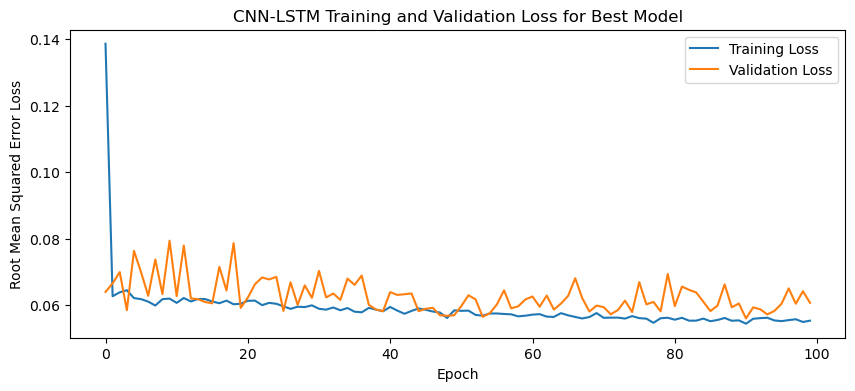

1/1 - 1s - loss: 0.0459 - 872ms/epoch - 872ms/step
Test Loss: 0.04589606821537018


NameError: name 'make_forecasts' is not defined

In [3]:
n_batch = 1
nb_epoch = 100

def rmse (y_true, y_pred):
    return K.sqrt(K.mean(K.square(y_pred - y_true)))

def mape (y_true, y_pred):
    return 100*K.mean(K.sqrt(K.square(y_true - y_pred))/y_true)
    
def pearson (y_true, y_pred):
    return (K.square(K.mean((y_true - K.mean(y_true))*(y_pred - K.mean(y_pred)))))/(K.mean(K.square(y_true - K.mean(y_true)))*K.mean(K.square(y_pred - K.mean(y_pred))))
 
# fit an LSTM network to training data
#Adapted from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def create_model(trial, X, y, n_lag, n_seq, n_batch, nb_epoch):

    cv_accuracies = []
    
    #Parameters:
    #trial (array-like): Optuna parameters.
    #train (array-like): Target values.
    #n_lag (int): Number of lag observations.
    #n_seq (int): Number of sequence observations
    #nb_epoch (int): Maximum number of epochs
    
    # Hyperparameters to be tuned by Optuna (taken from Javier Leon's dissertation 'Fruit Prices')
    lr = trial.suggest_float('lr', 1e-3, 1, log=True)
    optimizer_name = trial.suggest_categorical('optimizer', ['Adam', 'RMSprop', 'SGD'])
    if optimizer_name == 'Adam':
        optimizer = Adam(learning_rate=lr)
    elif optimizer_name == 'RMSprop':
        optimizer = RMSprop(learning_rate=lr)
    else:
        optimizer = SGD(learning_rate=lr)
    
    #Optuna will try either Rectified Linear Unit (ReLU) = max(0, x), tanh, or sigmoid functions
    activation_function = trial.suggest_categorical('activation_function', ['relu', 'tanh', 'sigmoid'])
    
    lstm_units = trial.suggest_categorical('lstm_units', [256, 512, 1024])
    dropout_rate = trial.suggest_float('dropout_rate', 0.1, 0.5)

    # design network
    model = Sequential()
    model.add(LSTM(lstm_units, return_sequences=True, batch_input_shape=(n_batch, X.shape[1], X.shape[2]), stateful=True))
    model.add(Dropout(dropout_rate))
    model.add(LSTM(lstm_units))
    model.add(Dropout(dropout_rate))
    model.add(Dense(256, input_dim=y.shape[1], activation=activation_function))
    model.add(Dense(128, activation=activation_function))
    model.add(Dense(n_seq))
    model.compile(loss=rmse, optimizer=optimizer)
        
    return model
    
def objective(trial):
    
    cv_accuracies = []
        
    for i in range(5):
        train1 = train[i]
        test1 = test[i]
        validation1 = validation[i]

        X, y = train1[:, 0:-n_seq], train1[:, -n_seq:]
        X_test, y_test = test1[:, 0:-n_seq], test1[:, -n_seq:]
        X_val, y_val = validation1[:, 0:-n_seq], validation1[:, -n_seq:]
        X = X.reshape(X.shape[0], 1, X.shape[1])
        X_test = X_test.reshape(X_test.shape[0], 1, X_test.shape[1])
        X_val = X_val.reshape(X_val.shape[0], 1, X_val.shape[1])
    
        model = create_model(trial, X, y, n_lag, n_seq, n_batch, nb_epoch)

        history = model.fit(X, y, validation_data=(X_val, y_val), epochs=nb_epoch, verbose=0)

        cv_accuracy = model.evaluate(X_test, y_test, verbose=0)
    
        loss = history.history['val_loss'][-1]
    
        # Plotting the training and validation loss
        #plt.figure(figsize=(10, 4))
        #plt.plot(history.history['loss'], label='Training Loss')
        #plt.plot(history.history['val_loss'], label='Validation Loss')
        #title1 = "LSTM Training and Validation Loss for Fold " + str(i+1)
        #plt.title(title1)
        #plt.xlabel('Epoch')
        #plt.ylabel('Root Mean Squared Error Loss')
        #plt.legend()
        #plt.show()
            
        cv_accuracies.append(cv_accuracy)
    
    print("Cross Validation Accuracies:")
    print(cv_accuracies)
    print("Mean Cross Validation Accuracy:")
    print(np.mean(cv_accuracies))
    print("Standard Deviation of Cross Validation Accuracy:")
    print(np.std(cv_accuracies))
        
    return np.mean(cv_accuracies)

n_batch = 1
nb_epoch = 100

# optimize and fit model
study = optuna.create_study(direction='minimize')
study.optimize(objective, n_trials=100)
print('Number of finished trials:', len(study.trials))

print('Best trial:', study.best_trial.params)
best_params = study.best_params
print("Best hyperparameters: ", best_params)

for i in range(5):
    print("Fold "+str(i+1)+":")
    train1 = train[i]
    test1 = test[i]
    validation1 = validation[i]

    X, y = train1[:, 0:-n_seq], train1[:, -n_seq:]
    X_test, y_test = test1[:, 0:-n_seq], test1[:, -n_seq:]
    X_val, y_val = validation1[:, 0:-n_seq], validation1[:, -n_seq:]
    X = X.reshape(X.shape[0], 1, X.shape[1])
    X_test = X_test.reshape(X_test.shape[0], 1, X_test.shape[1])
    X_val = X_val.reshape(X_val.shape[0], 1, X_val.shape[1])

    best_model = create_model(optuna.trial.FixedTrial(best_params), X, y, n_lag, n_seq, n_batch, nb_epoch)
    history = best_model.fit(X, y, epochs=100, batch_size=n_batch, validation_data=(X_val, y_val))

    # Plotting the training and validation loss
    plt.figure(figsize=(10, 4))
    plt.plot(history.history['loss'], label='Training Loss')
    plt.plot(history.history['val_loss'], label='Validation Loss')
    title1 = "CNN-LSTM Training and Validation Loss for Best Model"
    plt.title(title1)
    plt.xlabel('Epoch')
    plt.ylabel('Root Mean Squared Error Loss')
    plt.legend()
    plt.show()

    # Evaluate the model
    loss = best_model.evaluate(X_test, y_test, verbose=2)
    print(f'Test Loss: {loss}')

    # make forecasts
    forecasts = make_forecasts(best_model, X_test, y_test, n_lag, n_seq, n_test)
    
    # inverse transform forecasts and test
    forecasts = inverse_transform(series, forecasts, scaler[i], n_test+2, n_seq)
    actual = [row[-n_seq:] for row in test1]
    actual = inverse_transform(series, actual, scaler[i], n_test+2, n_seq)

    #print("Forecasts:")
    #print(forecasts)
    #print("Actual:")
    #print(actual)

    rmse_list = [] # list stores root mean squared errors for each future time prediction
    mae_list = [] # list stores root mean squared errors for each future time prediction
    mape_list = [] # list stores root mean squared errors for each future time prediction
    r2_list = [] # list stores root mean squared errors for each future time prediction
    
    # evaluate forecasts
    rmse_list, mae_list, mape_list, r2_list = evaluate_forecasts(actual, forecasts, n_lag, n_seq)

    for j in range(len(X_test)):
        print("Weather Station "+str(j+1)+":")
        dataset_df = pd.DataFrame(y_test[j].flatten())
        dataset = dataset_df.values
        dataset = dataset[:, 0]
        dataset = np.array(dataset).reshape(-1, 1)
        dataset = dataset.flatten()
        dataset = pd.DataFrame(dataset)
        series = scaler[i].inverse_transform(dataset)
        series = pd.Series(series.flatten())

    # plot forecasts
    plot_forecasts(series, forecasts, 1)
    
    best_model.summary()

    # Print out table of actual and predicted values for each weather station
    for j in range(11):
        print("Weather Station "+str(j+1)+":")
        print("Actual Temp\tPredicted Temp\tDifference")
        print("-----------\t--------------\t----------")
        for k in range(n_seq):
            diff = forecasts[j][k] - actual[j][k]
            print(f"{actual[j][k]:.2f}\t\t{forecasts[j][k]:.2f}\t\t{diff:.2f}")

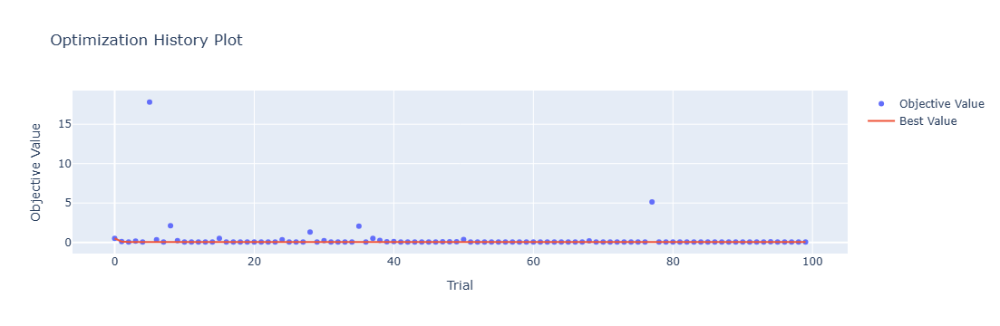

In [4]:
optuna.visualization.plot_optimization_history(study)

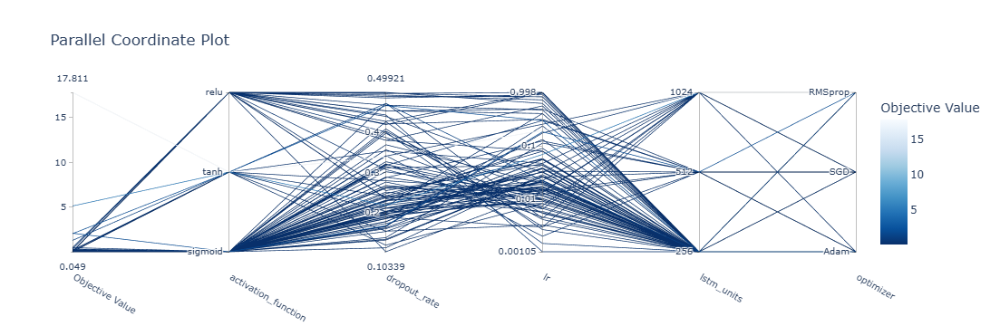

In [5]:
optuna.visualization.plot_parallel_coordinate(study)

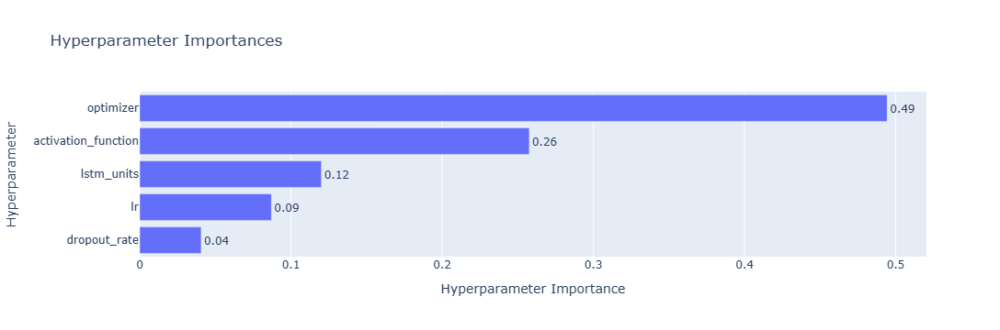

In [6]:
optuna.visualization.plot_param_importances(study)

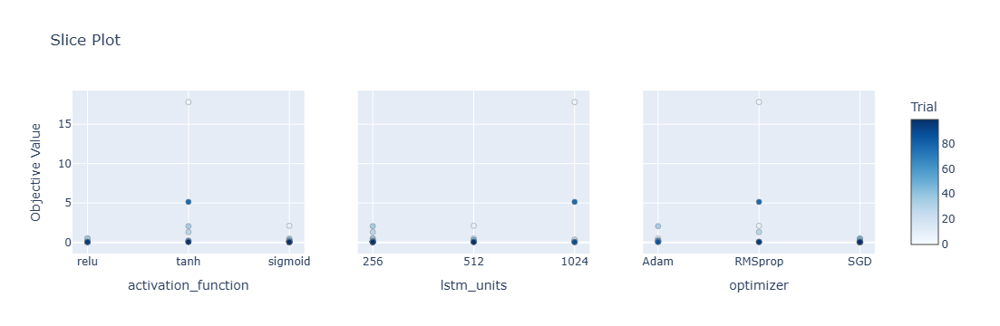

In [7]:
optuna.visualization.plot_slice(study, params=['optimizer', 'activation_function', 'lstm_units'])

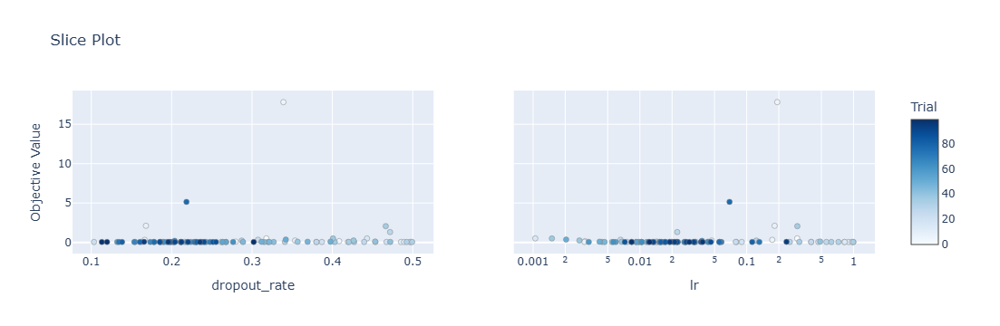

In [8]:
optuna.visualization.plot_slice(study, params=['lr', 'dropout_rate'])

Epoch 1/100
84/84 [==============================] - 29s 103ms/step - loss: 0.1781 - accuracy: 0.3452 - mae: 0.1423 - rmse: 0.1781 - mape: inf - pearson: 0.6278 - val_loss: 0.0651 - val_accuracy: 0.4000 - val_mae: 0.0514 - val_rmse: 0.0651 - val_mape: 11.4775 - val_pearson: 0.8035
Epoch 2/100
84/84 [==============================] - 2s 22ms/step - loss: 0.0616 - accuracy: 0.4643 - mae: 0.0488 - rmse: 0.0616 - mape: inf - pearson: 0.8345 - val_loss: 0.0773 - val_accuracy: 0.4000 - val_mae: 0.0606 - val_rmse: 0.0773 - val_mape: 13.5127 - val_pearson: 0.7331
Epoch 3/100
84/84 [==============================] - 2s 22ms/step - loss: 0.0615 - accuracy: 0.4881 - mae: 0.0483 - rmse: 0.0615 - mape: inf - pearson: 0.8368 - val_loss: 0.0733 - val_accuracy: 0.4000 - val_mae: 0.0577 - val_rmse: 0.0733 - val_mape: 13.2011 - val_pearson: 0.7571
Epoch 4/100
84/84 [==============================] - 2s 24ms/step - loss: 0.0626 - accuracy: 0.5119 - mae: 0.0495 - rmse: 0.0626 - mape: inf - pearson: 0.8264

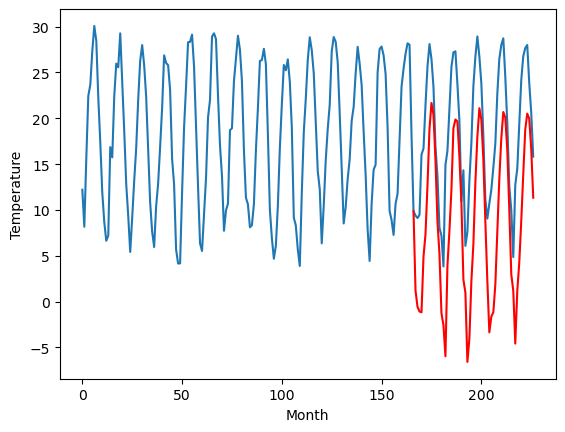

Weather Station 2:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-0.95		0.22		1.17
-1.85		-1.56		0.29
-2.23		-2.07		0.16
-1.48		-2.17		-0.69
4.35		3.88		-0.47
4.84		6.35		1.51
7.61		11.65		4.04
11.36		17.84		6.48
11.84		20.66		8.82
12.47		19.41		6.94
9.49		14.43		4.94
6.86		7.72		0.86
3.44		4.21		0.77
-3.77		-2.27		1.50
-3.11		-3.57		-0.46
-3.20		-6.97		-3.77
1.86		2.91		1.05
3.26		6.71		3.45
7.28		11.20		3.92
10.76		17.91		7.15
11.98		18.85		6.87
12.32		18.64		6.32
10.19		14.81		4.62
7.56		9.75		2.19
2.05		1.38		-0.67
1.81		-0.02		-1.83
-4.87		-7.59		-2.72
-2.10		-5.05		-2.95
1.76		1.23		-0.53
4.73		5.24		0.51
9.04		11.99		2.95
12.73		16.99		4.26
12.87		20.07		7.20
12.32		18.82		6.50
11.30		14.49		3.19
5.70		7.73		2.03
3.01		1.25		-1.76
-0.84		-4.38		-3.54
-0.05		-2.67		-2.62
1.05		-2.19		-3.24
2.64		0.81		-1.83
4.79		6.61		1.82
7.97		12.38		4.41
11.05		16.78		5.73
12.88		19.65		6.77
14.47		19.03		4.56
11.09		15.50		4.41
5.98		8.98		3.00
0.74		1.92		1.18


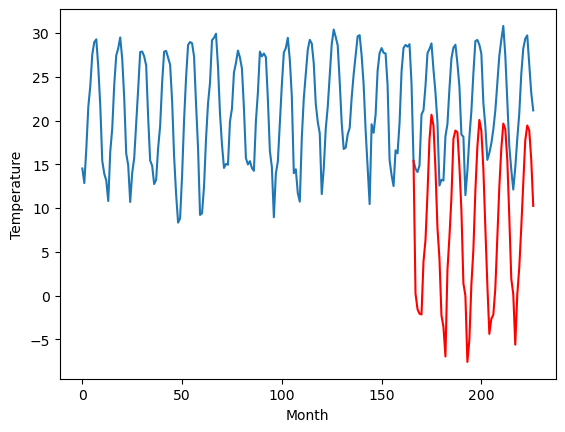

Weather Station 3:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-3.10		-1.16		1.94
-3.21		-2.94		0.27
-3.83		-3.46		0.37
-3.21		-3.55		-0.34
3.04		2.49		-0.55
2.80		4.96		2.16
6.49		10.27		3.78
10.21		16.45		6.24
12.58		19.28		6.70
11.82		18.03		6.21
8.43		13.04		4.61
4.71		6.33		1.62
-0.22		2.82		3.04
-7.22		-3.66		3.56
-6.40		-4.96		1.44
-5.54		-8.36		-2.82
0.44		1.51		1.07
2.08		5.32		3.24
6.06		9.81		3.75
10.20		16.52		6.32
11.96		17.46		5.50
12.24		17.24		5.00
8.67		13.41		4.74
4.79		8.35		3.56
-3.57		-0.01		3.56
-1.39		-1.42		-0.03
-7.40		-8.98		-1.58
-3.45		-6.43		-2.98
0.05		-0.16		-0.21
2.79		3.84		1.05
8.55		10.59		2.04
12.33		15.59		3.26
13.25		18.67		5.42
12.02		17.42		5.40
8.90		13.09		4.19
1.76		6.33		4.57
-0.72		-0.15		0.57
-5.24		-5.78		-0.54
-3.29		-4.07		-0.78
-0.51		-3.59		-3.08
-0.53		-0.59		-0.06
2.54		5.21		2.67
5.95		10.98		5.03
9.27		15.38		6.11
12.37		18.25		5.88
11.98		17.64		5.66
8.53		14.11		5.58
2.55		7.59		5.04
-2.54		0.52		3

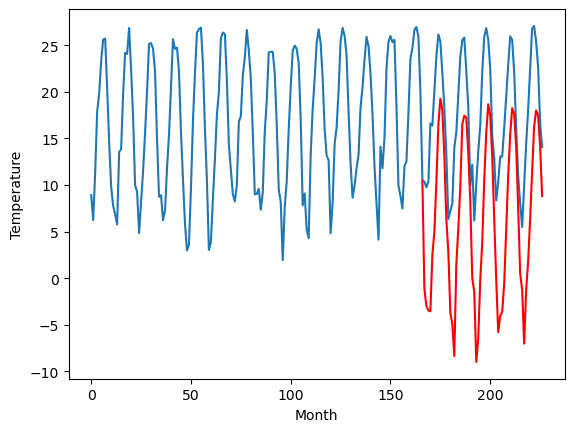

Weather Station 4:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-2.49		-2.36		0.13
-2.51		-4.14		-1.63
-2.47		-4.67		-2.20
-2.47		-4.75		-2.28
4.45		1.29		-3.16
4.53		3.75		-0.78
7.42		9.06		1.64
10.33		15.24		4.91
11.30		18.07		6.77
11.64		16.82		5.18
9.31		11.84		2.53
5.25		5.12		-0.13
2.41		1.61		-0.80
-5.05		-4.87		0.18
-4.96		-6.17		-1.21
-6.53		-9.57		-3.04
1.38		0.30		-1.08
3.17		4.11		0.94
7.14		8.60		1.46
10.42		15.30		4.88
11.05		16.25		5.20
11.10		16.03		4.93
8.59		12.20		3.61
6.28		7.14		0.86
-1.81		-1.23		0.58
0.96		-2.62		-3.58
-6.39		-10.19		-3.80
-3.95		-7.65		-3.70
-0.16		-1.37		-1.21
4.63		2.62		-2.01
9.15		9.36		0.21
11.58		14.36		2.78
11.56		17.42		5.86
10.37		16.18		5.81
9.13		11.85		2.72
3.51		5.08		1.57
-0.60		-1.40		-0.80
-2.78		-7.04		-4.26
-1.34		-5.32		-3.98
-0.93		-4.84		-3.91
2.59		-1.84		-4.43
4.01		3.95		-0.06
8.44		9.72		1.28
12.19		14.12		1.93
13.31		16.99		3.68
14.84		16.37		1.53
11.40		12.84		1.44
5.15		6.32		1.17
-0.71	

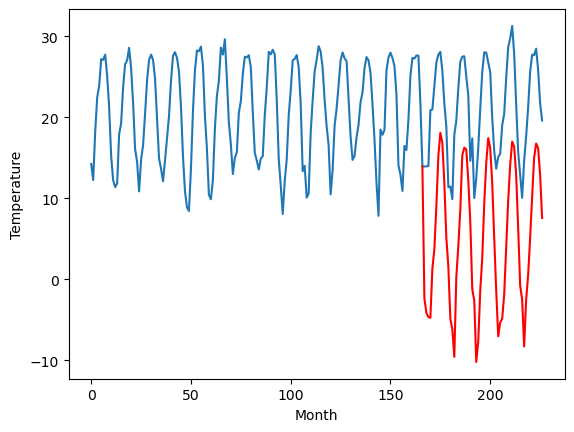

Weather Station 5:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
5.32		4.56		-0.76
3.27		2.78		-0.49
4.01		2.26		-1.75
3.34		2.18		-1.16
11.09		8.22		-2.87
11.34		10.67		-0.67
16.32		15.98		-0.34
20.52		22.16		1.64
22.13		24.99		2.86
22.62		23.74		1.12
16.91		18.76		1.85
12.03		12.05		0.02
9.51		8.54		-0.97
3.04		2.06		-0.98
2.16		0.76		-1.40
-0.93		-2.64		-1.71
8.97		7.23		-1.74
10.90		11.03		0.13
14.76		15.51		0.75
19.96		22.21		2.25
20.39		23.16		2.77
21.15		22.94		1.79
19.14		19.11		-0.03
14.79		14.05		-0.74
7.22		5.68		-1.54
9.55		4.28		-5.27
1.10		-3.28		-4.38
0.87		-0.74		-1.61
7.36		5.54		-1.82
13.40		9.54		-3.86
18.11		16.27		-1.84
22.45		21.28		-1.17
24.81		24.34		-0.47
22.45		23.10		0.65
19.50		18.77		-0.73
13.58		12.00		-1.58
6.65		5.51		-1.14
3.92		-0.12		-4.04
4.89		1.60		-3.29
5.02		2.08		-2.94
9.74		5.08		-4.66
11.24		10.87		-0.37
16.77		16.63		-0.14
21.32		21.03		-0.29
24.31		23.90		-0.41
26.05		23.28		-2.77
21.57		19.75		-1.82
13.91		13.2

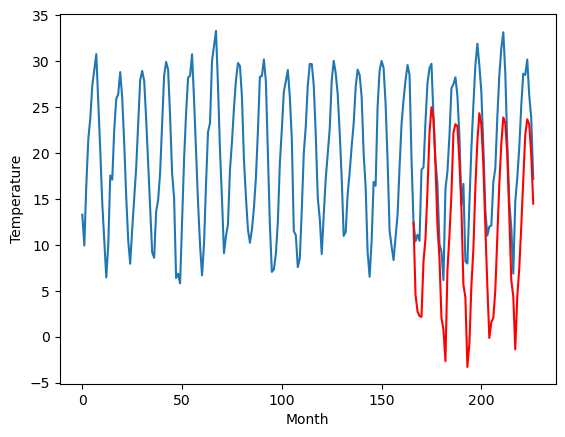

Weather Station 6:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
5.85		6.87		1.02
5.28		5.09		-0.19
4.75		4.57		-0.18
4.44		4.48		0.04
8.03		10.53		2.50
10.00		12.99		2.99
13.69		18.29		4.60
18.04		24.48		6.44
21.78		27.31		5.53
20.93		26.06		5.13
17.90		21.08		3.18
13.81		14.37		0.56
9.69		10.86		1.17
2.94		4.38		1.44
1.16		3.07		1.91
1.81		-0.32		-2.13
6.71		9.54		2.83
10.08		13.34		3.26
13.59		17.83		4.24
18.16		24.54		6.38
20.15		25.48		5.33
20.63		25.26		4.63
17.62		21.43		3.81
14.02		16.37		2.35
5.85		8.01		2.16
6.90		6.60		-0.30
0.52		-0.96		-1.48
4.13		1.58		-2.55
8.05		7.86		-0.19
10.92		11.86		0.94
15.55		18.60		3.05
19.12		23.61		4.49
21.26		26.68		5.42
20.41		25.43		5.02
17.76		21.11		3.35
11.20		14.34		3.14
9.51		7.87		-1.64
2.99		2.23		-0.76
4.68		3.95		-0.73
6.17		4.43		-1.74
7.08		7.43		0.35
11.76		13.23		1.47
13.28		18.99		5.71
17.10		23.39		6.29
20.93		26.26		5.33
20.45		25.63		5.18
16.93		22.11		5.18
12.58		15.60		3.02
7.14		8.53		1.39
5

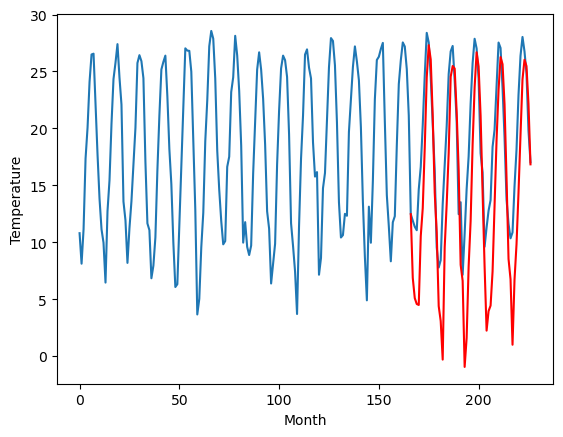

Weather Station 7:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-1.20		1.25		2.45
-1.56		-0.53		1.03
-2.03		-1.05		0.98
-0.92		-1.14		-0.22
4.50		4.90		0.40
5.74		7.37		1.63
8.08		12.68		4.60
13.33		18.86		5.53
16.40		21.69		5.29
15.37		20.43		5.06
11.48		15.45		3.97
7.48		8.74		1.26
3.30		5.23		1.93
-3.63		-1.25		2.38
-4.21		-2.56		1.65
-3.57		-5.95		-2.38
3.41		3.91		0.50
4.44		7.72		3.28
8.15		12.21		4.06
12.48		18.92		6.44
14.10		19.86		5.76
14.04		19.64		5.60
9.99		15.81		5.82
6.76		10.76		4.00
-1.89		2.39		4.28
0.05		0.99		0.94
-6.60		-6.58		0.02
-2.62		-4.03		-1.41
1.72		2.25		0.53
4.64		6.24		1.60
9.71		12.98		3.27
13.62		17.98		4.36
14.72		21.05		6.33
13.43		19.81		6.38
10.37		15.48		5.11
3.43		8.72		5.29
1.20		2.24		1.04
-5.31		-3.40		1.91
-2.12		-1.68		0.44
0.88		-1.20		-2.08
1.36		1.80		0.44
4.92		7.60		2.68
7.61		13.36		5.75
10.96		17.76		6.80
14.67		20.63		5.96
13.98		20.01		6.03
10.47		16.48		6.01
5.26		9.97		4.71
-0.61		2.90		3.51
-2.90		1

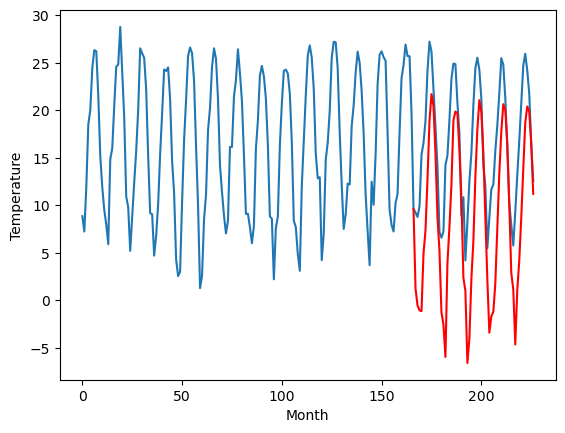

Weather Station 8:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
4.01		6.57		2.56
3.64		4.78		1.14
3.52		4.27		0.75
4.56		4.18		-0.38
10.14		10.21		0.07
11.04		12.68		1.64
14.16		17.99		3.83
19.68		24.17		4.49
22.94		27.00		4.06
21.57		25.74		4.17
16.70		20.77		4.07
12.86		14.05		1.19
8.63		10.54		1.91
1.70		4.06		2.36
0.76		2.75		1.99
1.38		-0.65		-2.03
7.90		9.21		1.31
11.53		13.02		1.49
14.55		17.52		2.97
19.34		24.22		4.88
21.46		25.17		3.71
21.41		24.94		3.53
16.90		21.11		4.21
13.05		16.06		3.01
3.55		7.69		4.14
5.61		6.28		0.67
-1.57		-1.28		0.29
2.67		1.27		-1.40
7.51		7.55		0.04
10.83		11.55		0.72
15.81		18.29		2.48
19.81		23.29		3.48
21.68		26.35		4.67
20.00		25.11		5.11
16.30		20.79		4.49
9.11		14.03		4.92
6.91		7.55		0.64
-0.26		1.91		2.17
2.91		3.63		0.72
5.88		4.11		-1.77
6.56		7.11		0.55
11.18		12.90		1.72
13.47		18.66		5.19
17.22		23.07		5.85
21.36		25.94		4.58
20.22		25.31		5.09
16.46		21.78		5.32
11.07		15.28		4.21
4.62		8.20		3.58
3.03		

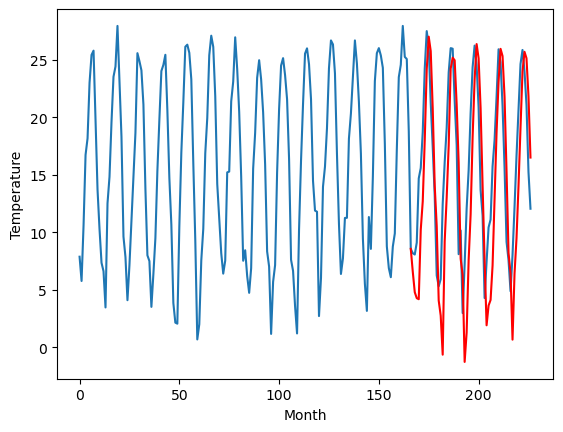

Weather Station 9:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
4.48		5.64		1.16
4.32		3.86		-0.46
3.13		3.35		0.22
3.63		3.26		-0.37
10.20		9.30		-0.90
12.48		11.77		-0.71
17.36		17.08		-0.28
23.29		23.26		-0.03
26.03		26.09		0.06
23.02		24.84		1.82
19.46		19.86		0.40
12.20		13.15		0.95
9.34		9.64		0.30
2.63		3.16		0.53
1.84		1.86		0.02
-2.43		-1.54		0.89
10.04		8.33		-1.71
12.64		12.13		-0.51
17.33		16.63		-0.70
23.52		23.34		-0.18
24.09		24.29		0.20
24.03		24.07		0.04
20.29		20.23		-0.06
16.33		15.18		-1.15
6.29		6.81		0.52
8.09		5.41		-2.68
-0.42		-2.15		-1.73
1.62		0.40		-1.22
8.84		6.68		-2.16
12.79		10.67		-2.12
19.63		17.41		-2.22
24.15		22.41		-1.74
26.48		25.48		-1.00
23.60		24.24		0.64
19.96		19.91		-0.05
13.40		13.15		-0.25
7.43		6.67		-0.76
2.14		1.03		-1.11
4.70		2.75		-1.95
6.31		3.23		-3.08
8.13		6.22		-1.91
13.91		12.02		-1.89
19.50		17.78		-1.72
23.37		22.19		-1.18
24.86		25.05		0.19
23.60		24.43		0.83
20.43		20.90		0.47
14.83		14.38		-0

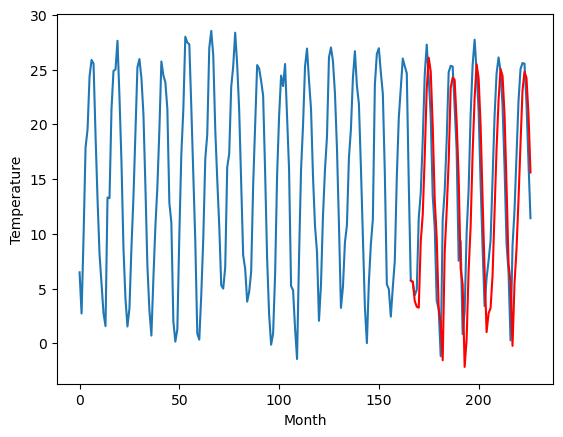

Weather Station 10:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-0.26		3.13		3.39
-0.08		1.34		1.42
-1.36		0.82		2.18
-2.23		0.74		2.97
4.96		6.78		1.82
6.62		9.26		2.64
11.71		14.57		2.86
18.69		20.75		2.06
21.32		23.58		2.26
18.94		22.31		3.37
15.27		17.33		2.06
8.88		10.62		1.74
5.20		7.11		1.91
-2.31		0.63		2.94
-3.90		-0.67		3.23
-6.07		-4.08		1.99
4.68		5.79		1.11
7.74		9.60		1.86
12.21		14.10		1.89
18.69		20.81		2.12
19.70		21.76		2.06
20.30		21.54		1.24
16.44		17.70		1.26
11.97		12.65		0.68
1.31		4.28		2.97
2.54		2.87		0.33
-6.43		-4.69		1.74
-2.85		-2.15		0.70
4.13		4.14		0.01
6.86		8.13		1.27
15.03		14.87		-0.16
18.93		19.87		0.94
20.96		22.94		1.98
19.05		21.70		2.65
15.32		17.36		2.04
8.28		10.60		2.32
3.26		4.13		0.87
-2.45		-1.51		0.94
-0.56		0.20		0.76
1.48		0.68		-0.80
1.82		3.68		1.86
8.10		9.47		1.37
13.06		15.23		2.17
16.90		19.64		2.74
19.73		22.50		2.77
18.93		21.87		2.94
16.32		18.34		2.02
9.74		11.83		2.09
3.24		4.75		1.51
0.81		2.

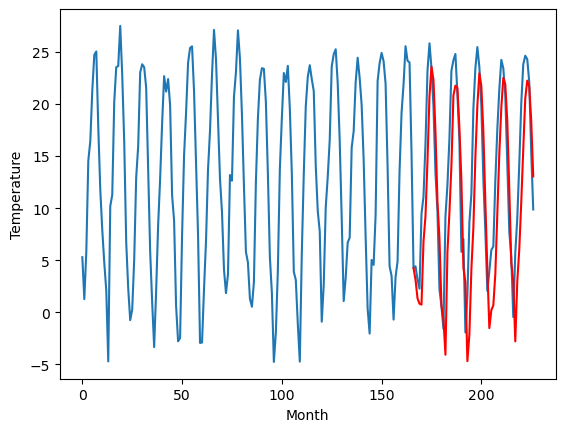

Weather Station 11:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-1.50		1.18		2.68
-2.17		-0.60		1.57
-3.20		-1.11		2.09
-4.66		-1.19		3.47
1.48		4.85		3.37
4.13		7.33		3.20
10.56		12.64		2.08
18.52		18.83		0.31
21.68		21.65		-0.03
18.99		20.38		1.39
14.16		15.40		1.24
7.41		8.69		1.28
3.93		5.18		1.25
-3.10		-1.30		1.80
-4.71		-2.60		2.11
-9.02		-6.00		3.02
2.71		3.88		1.17
6.68		7.68		1.00
11.83		12.19		0.36
19.14		18.90		-0.24
19.73		19.84		0.11
20.44		19.62		-0.82
16.39		15.78		-0.61
12.04		10.73		-1.31
1.18		2.35		1.17
0.28		0.94		0.66
-8.67		-6.61		2.06
-5.43		-4.07		1.36
1.48		2.22		0.74
5.09		6.20		1.11
14.41		12.96		-1.45
19.17		17.95		-1.22
20.28		21.03		0.75
19.16		19.78		0.62
15.32		15.45		0.13
8.08		8.69		0.61
3.05		2.22		-0.83
-3.13		-3.42		-0.29
-2.00		-1.70		0.30
-1.59		-1.23		0.36
0.27		1.76		1.49
7.12		7.55		0.43
12.14		13.32		1.18
17.65		17.73		0.08
20.11		20.59		0.48
18.30		19.95		1.65
15.92		16.42		0.50
9.96		9.91		-0.05
2.32		2.83		0

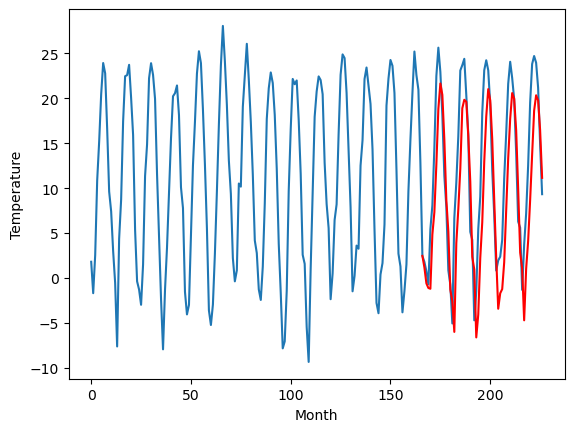

RangeIndex(start=1, stop=12, step=1)
[0.5800000000000001, -0.9500000000000002, -3.0999999999999996, -2.490000000000002, 5.320000000000001, 5.850000000000001, -1.200000000000001, 4.010000000000003, 4.48, -0.2599999999999998, -1.5000000000000018]
[1.2017398834228512, 0.22101842880249034, -1.1622073745727537, -2.3591589546203613, 4.560555419921876, 6.866094608306884, 1.2537252044677736, 6.570131282806397, 5.642737197875977, 3.1255908393859855, 1.182752704620361]
Predictions for (t+0):
    Weather_Station  Actual  Predicted
0                 0    0.58   1.201740
1                 1   -0.95   0.221018
2                 2   -3.10  -1.162207
3                 3   -2.49  -2.359159
4                 4    5.32   4.560555
5                 5    5.85   6.866095
6                 6   -1.20   1.253725
7                 7    4.01   6.570131
8                 8    4.48   5.642737
9                 9   -0.26   3.125591
10               10   -1.50   1.182753


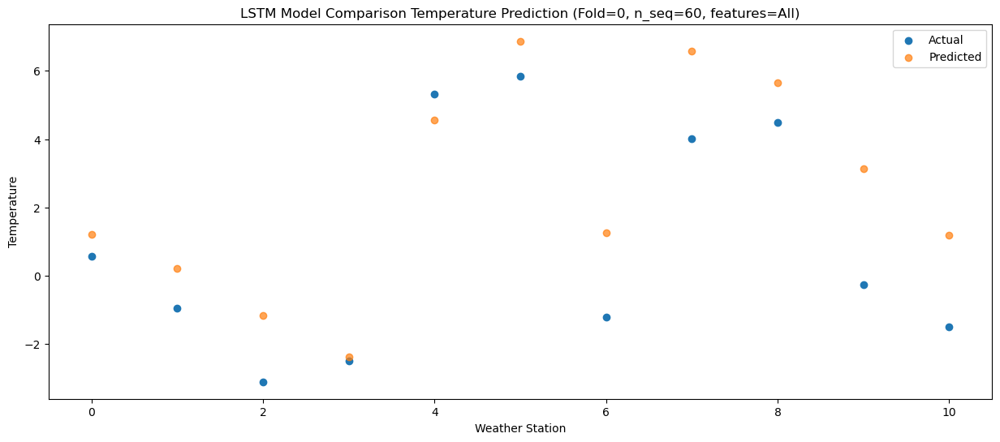

Predictions for (t+1):
    Weather_Station  Actual  Predicted
0                 0    0.11  -0.572264
1                 1   -1.85  -1.556951
2                 2   -3.21  -2.940454
3                 3   -2.51  -4.140658
4                 4    3.27   2.782512
5                 5    5.28   5.085287
6                 6   -1.56  -0.529741
7                 7    3.64   4.784717
8                 8    4.32   3.862224
9                 9   -0.08   1.342574
10               10   -2.17  -0.597944


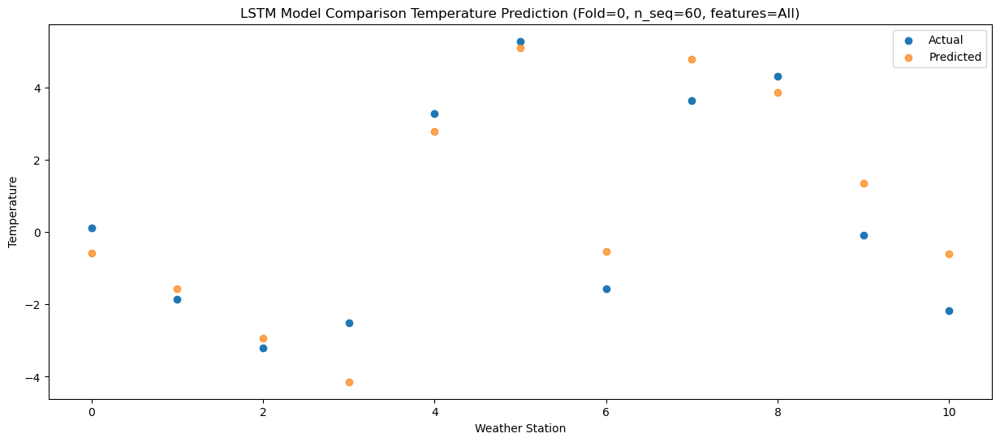

Predictions for (t+2):
    Weather_Station  Actual  Predicted
0                 0   -0.16  -1.079490
1                 1   -2.23  -2.073871
2                 2   -3.83  -3.458354
3                 3   -2.47  -4.665462
4                 4    4.01   2.262976
5                 5    4.75   4.566748
6                 6   -2.03  -1.047222
7                 7    3.52   4.265042
8                 8    3.13   3.346017
9                 9   -1.36   0.824794
10               10   -3.20  -1.113875


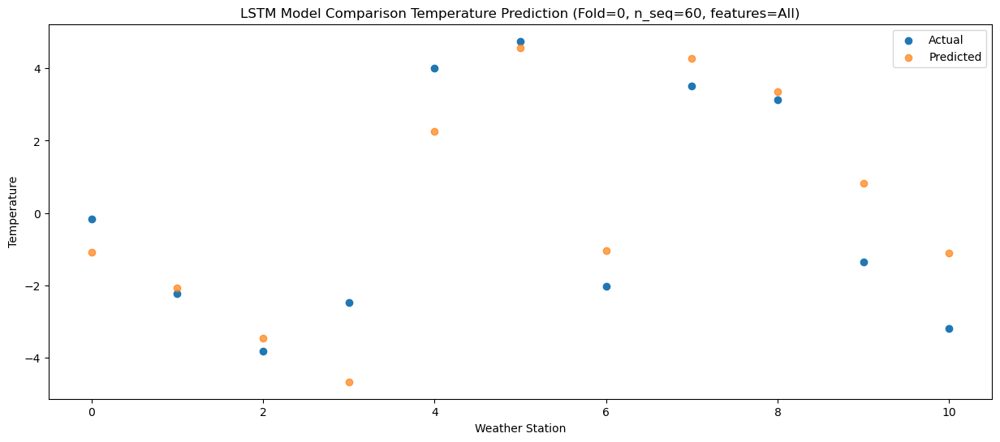

Predictions for (t+3):
    Weather_Station  Actual  Predicted
0                 0    0.19  -1.162296
1                 1   -1.48  -2.165566
2                 2   -3.21  -3.548434
3                 3   -2.47  -4.748723
4                 4    3.34   2.177931
5                 5    4.44   4.484707
6                 6   -0.92  -1.135006
7                 7    4.56   4.175979
8                 8    3.63   3.256981
9                 9   -2.23   0.739723
10               10   -4.66  -1.194954


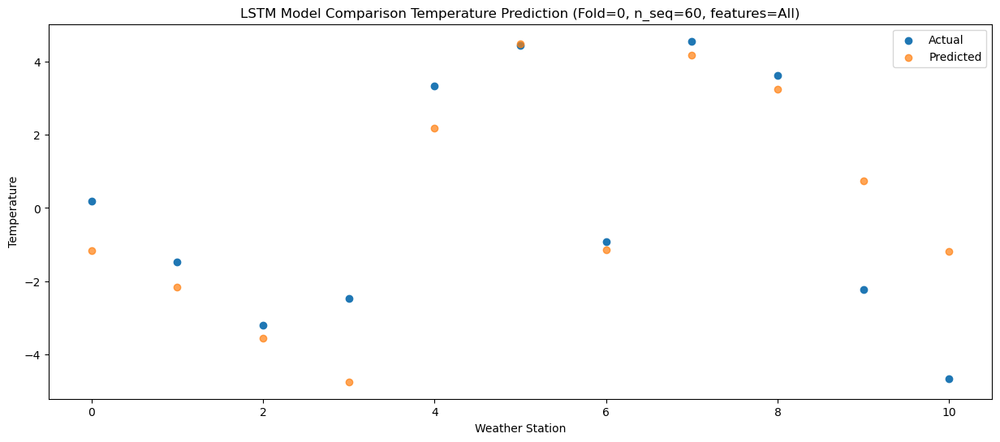

Predictions for (t+4):
    Weather_Station  Actual  Predicted
0                 0    6.77   4.893817
1                 1    4.35   3.884337
2                 2    3.04   2.494880
3                 3    4.45   1.292752
4                 4   11.09   8.216373
5                 5    8.03  10.526963
6                 6    4.50   4.904948
7                 7   10.14  10.213201
8                 8   10.20   9.303196
9                 9    4.96   6.783276
10               10    1.48   4.851941


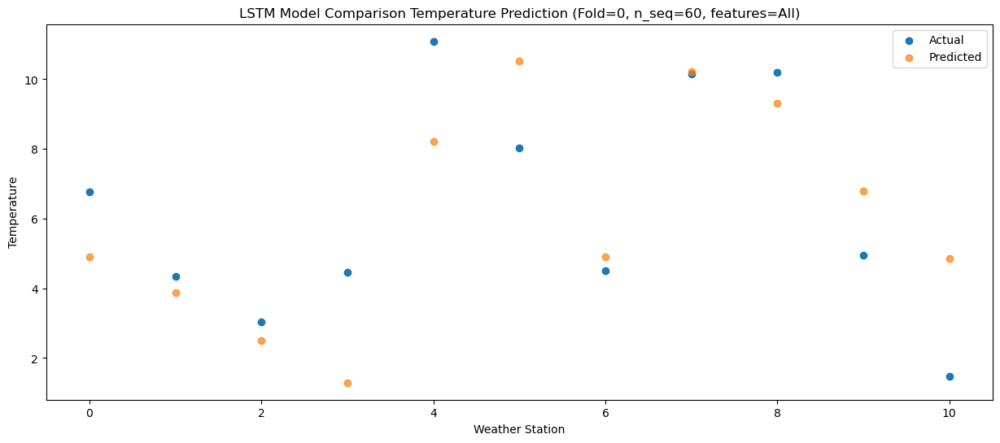

Predictions for (t+5):
    Weather_Station  Actual  Predicted
0                 0    7.42   7.350288
1                 1    4.84   6.346851
2                 2    2.80   4.959384
3                 3    4.53   3.754800
4                 4   11.34  10.672766
5                 5   10.00  12.985737
6                 6    5.74   7.371240
7                 7   11.04  12.681622
8                 8   12.48  11.774164
9                 9    6.62   9.256198
10               10    4.13   7.326595


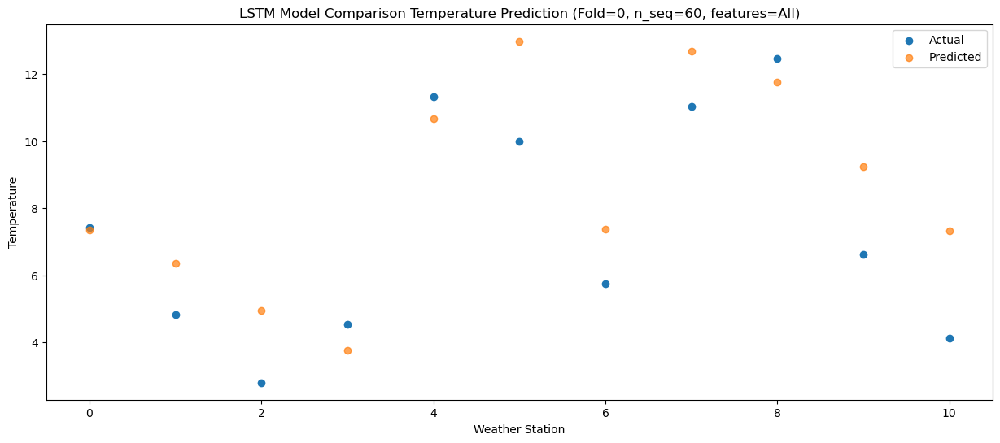

Predictions for (t+6):
    Weather_Station  Actual  Predicted
0                 0   12.15  12.665105
1                 1    7.61  11.652756
2                 2    6.49  10.266596
3                 3    7.42   9.056172
4                 4   16.32  15.979165
5                 5   13.69  18.293622
6                 6    8.08  12.680696
7                 7   14.16  17.990957
8                 8   17.36  17.081684
9                 9   11.71  14.566726
10               10   10.56  12.638542


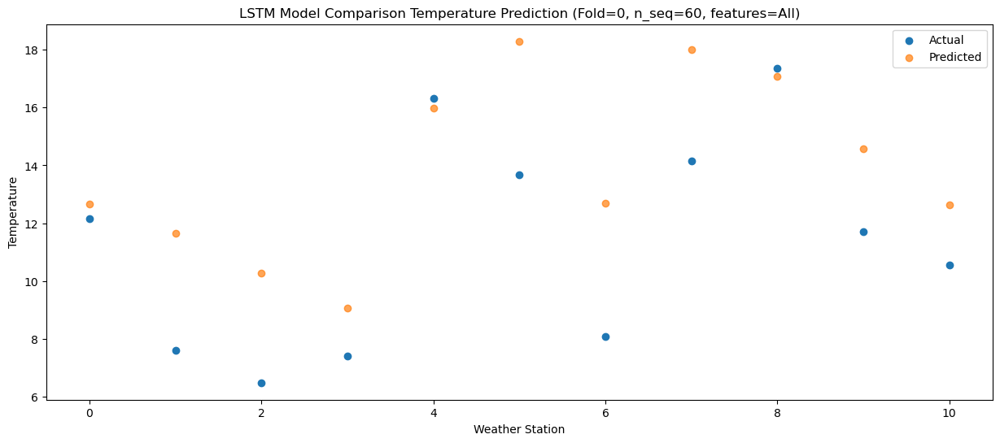

Predictions for (t+7):
    Weather_Station  Actual  Predicted
0                 0   16.37  18.846307
1                 1   11.36  17.838970
2                 2   10.21  16.453926
3                 3   10.33  15.243930
4                 4   20.52  22.160709
5                 5   18.04  24.475546
6                 6   13.33  18.859564
7                 7   19.68  24.169169
8                 8   23.29  23.264150
9                 9   18.69  20.750215
10               10   18.52  18.828619


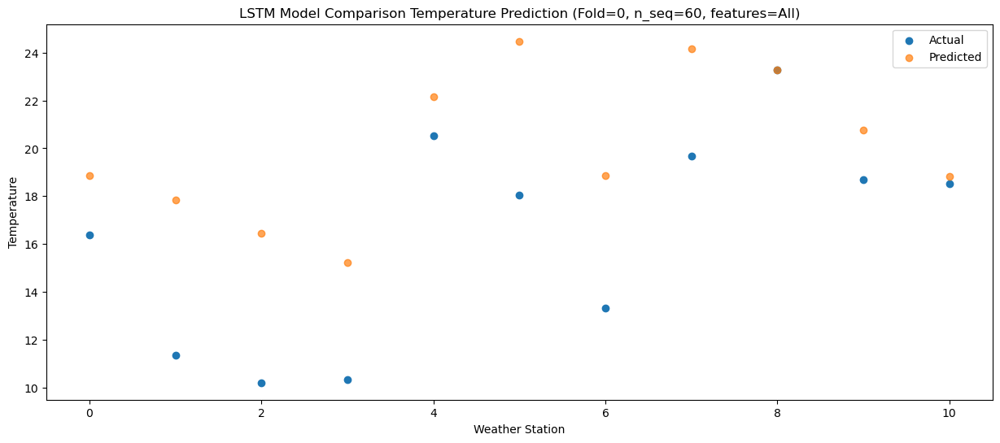

Predictions for (t+8):
    Weather_Station  Actual  Predicted
0                 0   18.82  21.671233
1                 1   11.84  20.662216
2                 2   12.58  19.276170
3                 3   11.30  18.072153
4                 4   22.13  24.991928
5                 5   21.78  27.305225
6                 6   16.40  21.686521
7                 7   22.94  26.996734
8                 8   26.03  26.093405
9                 9   21.32  23.578698
10               10   21.68  21.653700


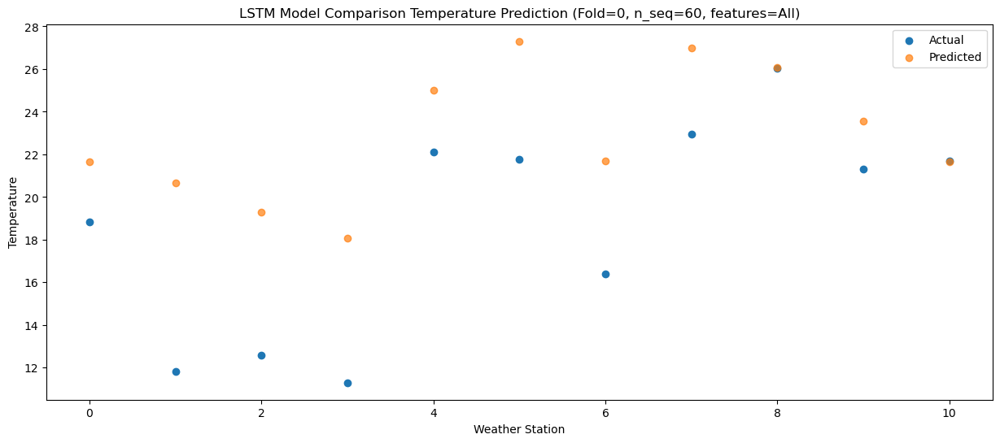

Predictions for (t+9):
    Weather_Station  Actual  Predicted
0                 0   17.19  20.413621
1                 1   12.47  19.412903
2                 2   11.82  18.025004
3                 3   11.64  16.816690
4                 4   22.62  23.737929
5                 5   20.93  26.056747
6                 6   15.37  20.433033
7                 7   21.57  25.743106
8                 8   23.02  24.838892
9                 9   18.94  22.314961
10               10   18.99  20.384164


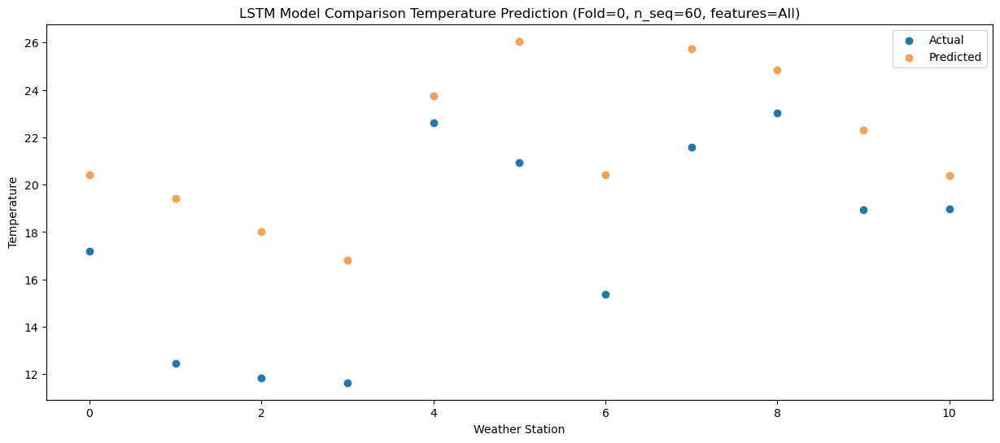

Predictions for (t+10):
    Weather_Station  Actual  Predicted
0                 0   14.13  15.426019
1                 1    9.49  14.430572
2                 2    8.43  13.044296
3                 3    9.31  11.835824
4                 4   16.91  18.757033
5                 5   17.90  21.080251
6                 6   11.48  15.453364
7                 7   16.70  20.765548
8                 8   19.46  19.859197
9                 9   15.27  17.330977
10               10   14.16  15.400328


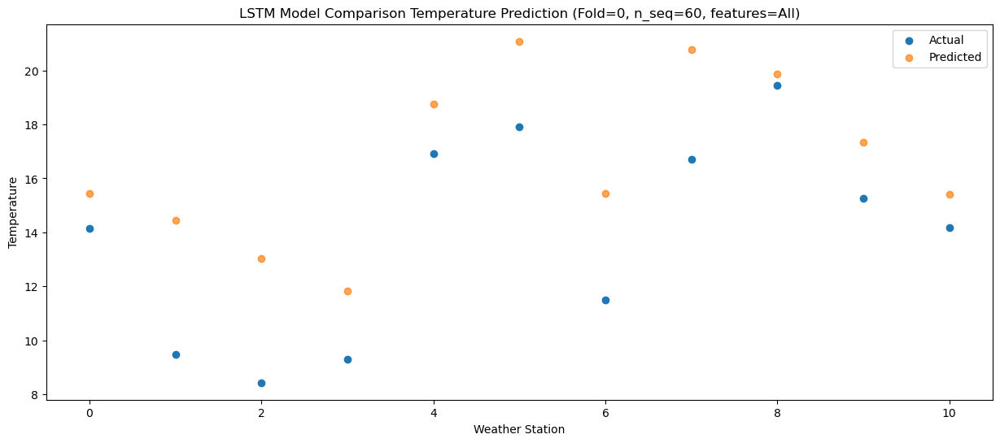

Predictions for (t+11):
    Weather_Station  Actual  Predicted
0                 0    7.63   8.719585
1                 1    6.86   7.721058
2                 2    4.71   6.333270
3                 3    5.25   5.124115
4                 4   12.03  12.046120
5                 5   13.81  14.370103
6                 6    7.48   8.739506
7                 7   12.86  14.053360
8                 8   12.20  13.147754
9                 9    8.88  10.618998
10               10    7.41   8.687923


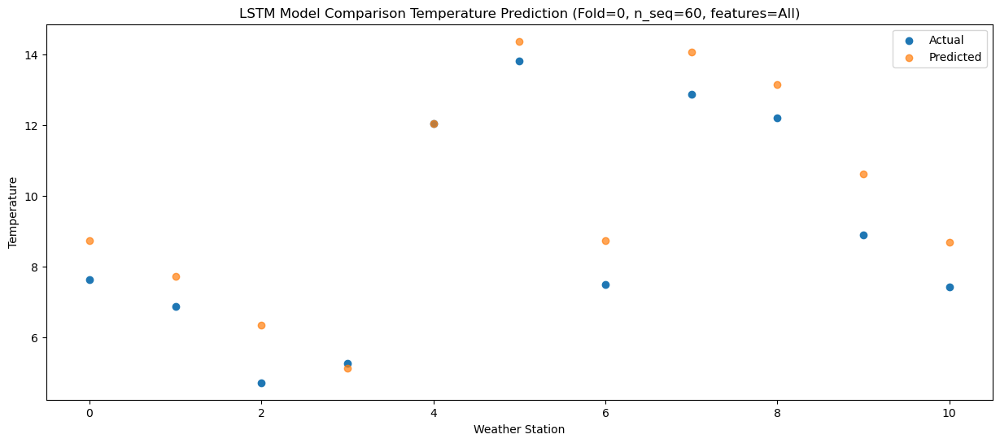

Predictions for (t+12):
    Weather_Station  Actual  Predicted
0                 0    4.39   5.208073
1                 1    3.44   4.209014
2                 2   -0.22   2.822556
3                 3    2.41   1.614351
4                 4    9.51   8.537569
5                 5    9.69  10.859521
6                 6    3.30   5.230404
7                 7    8.63  10.542999
8                 8    9.34   9.639801
9                 9    5.20   7.109197
10               10    3.93   5.178120


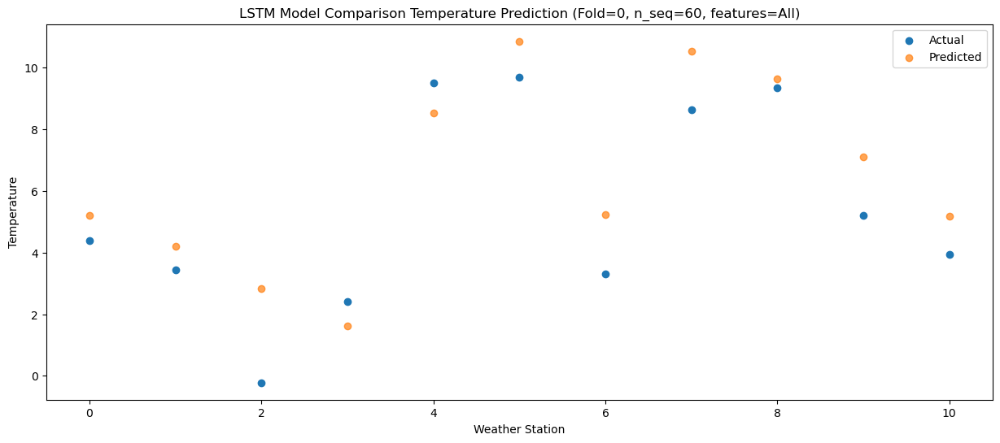

Predictions for (t+13):
    Weather_Station  Actual  Predicted
0                 0   -1.23  -1.263891
1                 1   -3.77  -2.269916
2                 2   -7.22  -3.658186
3                 3   -5.05  -4.866033
4                 4    3.04   2.061621
5                 5    2.94   4.381039
6                 6   -3.63  -1.249127
7                 7    1.70   4.060377
8                 8    2.63   3.160838
9                 9   -2.31   0.630084
10               10   -3.10  -1.298597


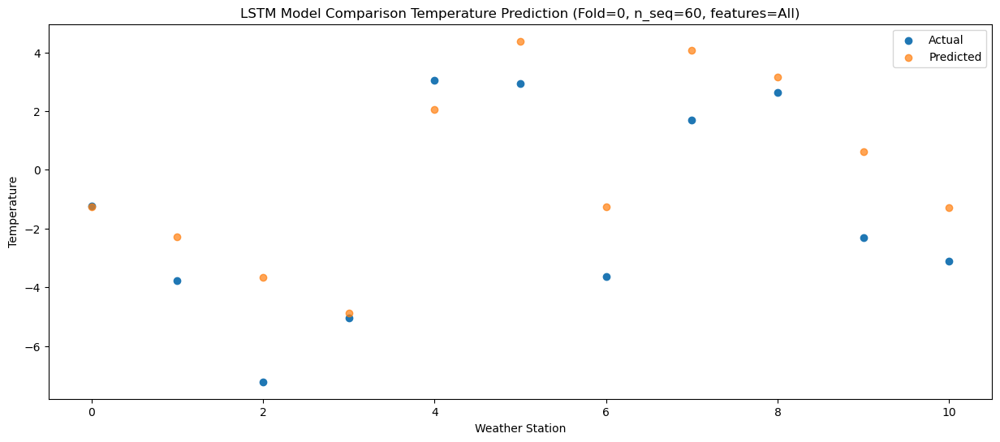

Predictions for (t+14):
    Weather_Station  Actual  Predicted
0                 0   -2.09  -2.561366
1                 1   -3.11  -3.569679
2                 2   -6.40  -4.958104
3                 3   -4.96  -6.165828
4                 4    2.16   0.761377
5                 5    1.16   3.074495
6                 6   -4.21  -2.555960
7                 7    0.76   2.751180
8                 8    1.84   1.859933
9                 9   -3.90  -0.673143
10               10   -4.71  -2.597281


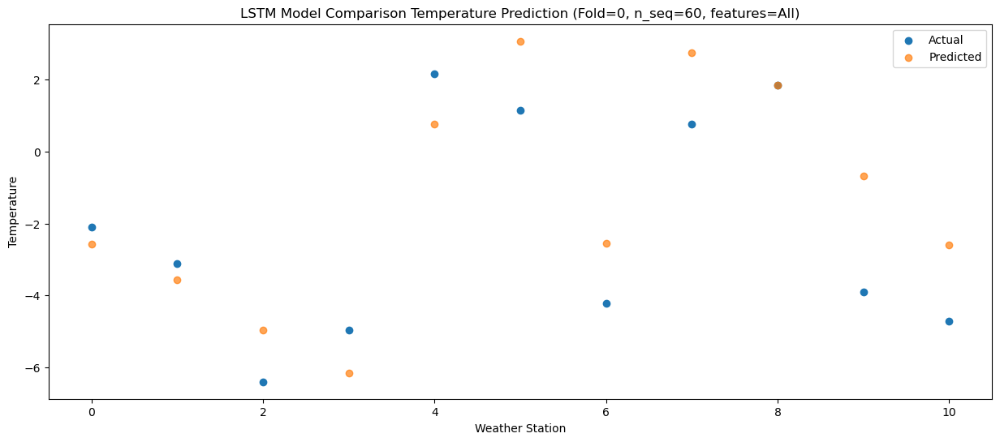

Predictions for (t+15):
    Weather_Station  Actual  Predicted
0                 0   -5.44  -5.961793
1                 1   -3.20  -6.967815
2                 2   -5.54  -8.355991
3                 3   -6.53  -9.566665
4                 4   -0.93  -2.641596
5                 5    1.81  -0.316350
6                 6   -3.57  -5.950624
7                 7    1.38  -0.645769
8                 8   -2.43  -1.540811
9                 9   -6.07  -4.076289
10               10   -9.02  -5.999134


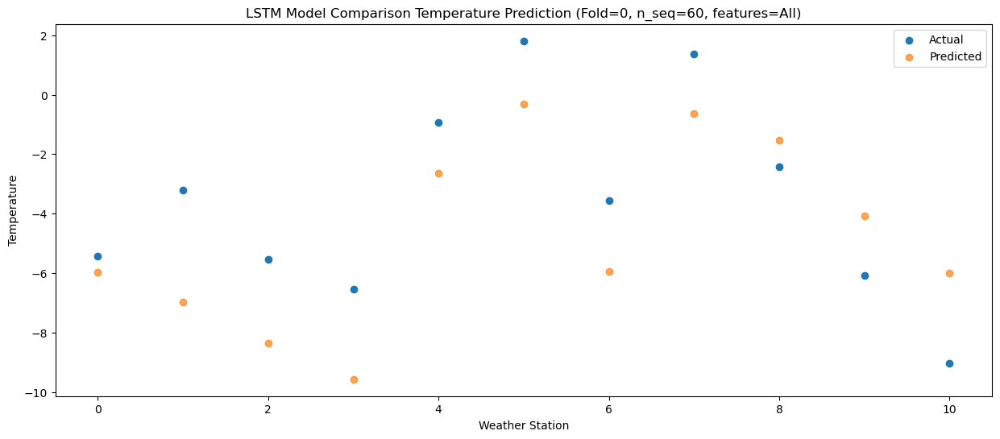

Predictions for (t+16):
    Weather_Station  Actual  Predicted
0                 0    5.63   3.914533
1                 1    1.86   2.907477
2                 2    0.44   1.514947
3                 3    1.38   0.304126
4                 4    8.97   7.229227
5                 5    6.71   9.543463
6                 6    3.41   3.910164
7                 7    7.90   9.214864
8                 8   10.04   8.330664
9                 9    4.68   5.794889
10               10    2.71   3.876594


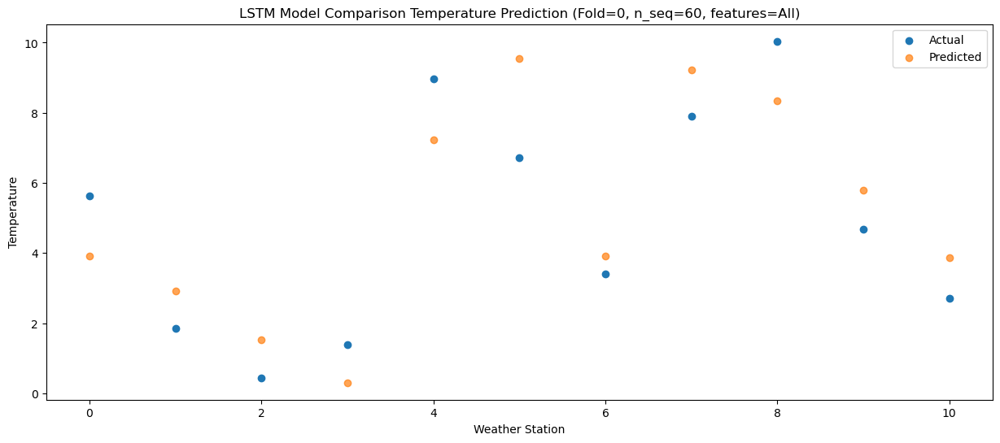

Predictions for (t+17):
    Weather_Station  Actual  Predicted
0                 0    7.16   7.726903
1                 1    3.26   6.708963
2                 2    2.08   5.315996
3                 3    3.17   4.108298
4                 4   10.90  11.029891
5                 5   10.08  13.342926
6                 6    4.44   7.717342
7                 7   11.53  13.022507
8                 8   12.64  12.134783
9                 9    7.74   9.601902
10               10    6.68   7.681404


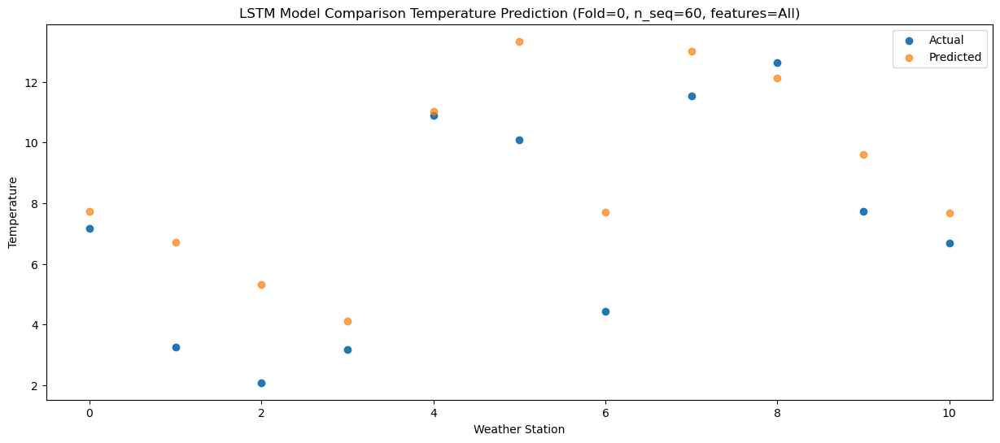

Predictions for (t+18):
    Weather_Station  Actual  Predicted
0                 0   11.66  12.223319
1                 1    7.28  11.201853
2                 2    6.06   9.809539
3                 3    7.14   8.596401
4                 4   14.76  15.514542
5                 5   13.59  17.833537
6                 6    8.15  12.208791
7                 7   14.55  17.515387
8                 8   17.33  16.632491
9                 9   12.21  14.101963
10               10   11.83  12.186753


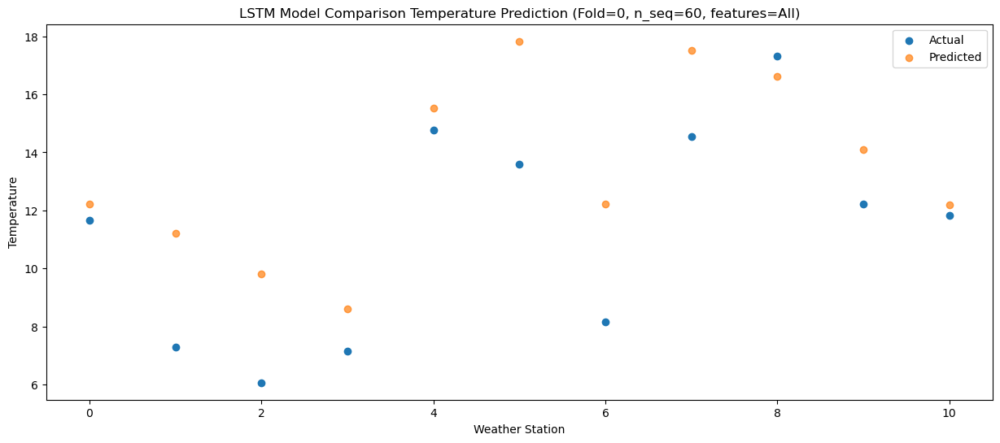

Predictions for (t+19):
    Weather_Station  Actual  Predicted
0                 0   16.33  18.921161
1                 1   10.76  17.906894
2                 2   10.20  16.515300
3                 3   10.42  15.301552
4                 4   19.96  22.212717
5                 5   18.16  24.535176
6                 6   12.48  18.916691
7                 7   19.34  24.223022
8                 8   23.52  23.337578
9                 9   18.69  20.812408
10               10   19.14  18.895610


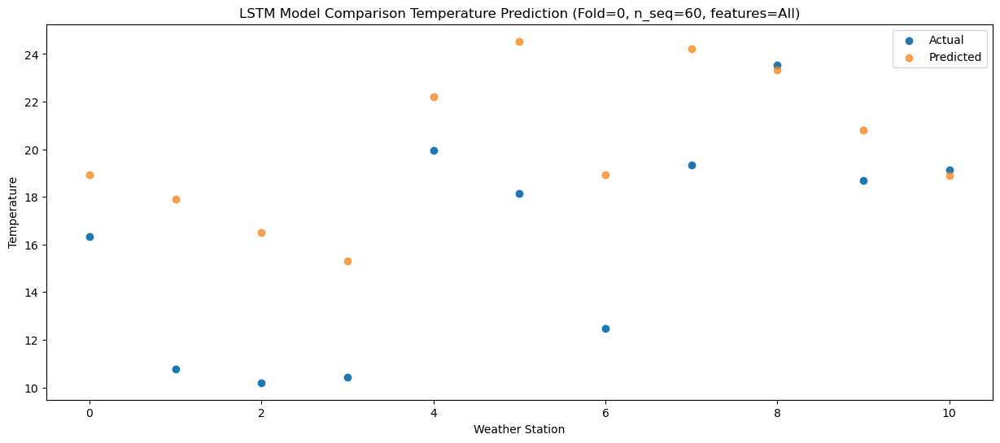

Predictions for (t+20):
    Weather_Station  Actual  Predicted
0                 0   17.92  19.868301
1                 1   11.98  18.851411
2                 2   11.96  17.456234
3                 3   11.05  16.245365
4                 4   20.39  23.157123
5                 5   20.15  25.476358
6                 6   14.10  19.859597
7                 7   21.46  25.167510
8                 8   24.09  24.286333
9                 9   19.70  21.755737
10               10   19.73  19.838637


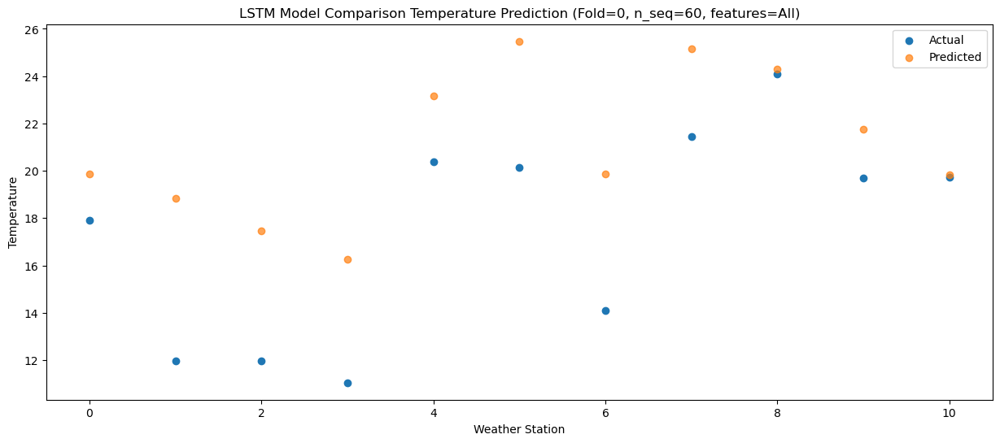

Predictions for (t+21):
    Weather_Station  Actual  Predicted
0                 0   18.03  19.657679
1                 1   12.32  18.639480
2                 2   12.24  17.241792
3                 3   11.10  16.030114
4                 4   21.15  22.939997
5                 5   20.63  25.258954
6                 6   14.04  19.641820
7                 7   21.41  24.944257
8                 8   24.03  24.067749
9                 9   20.30  21.538353
10               10   20.44  19.624971


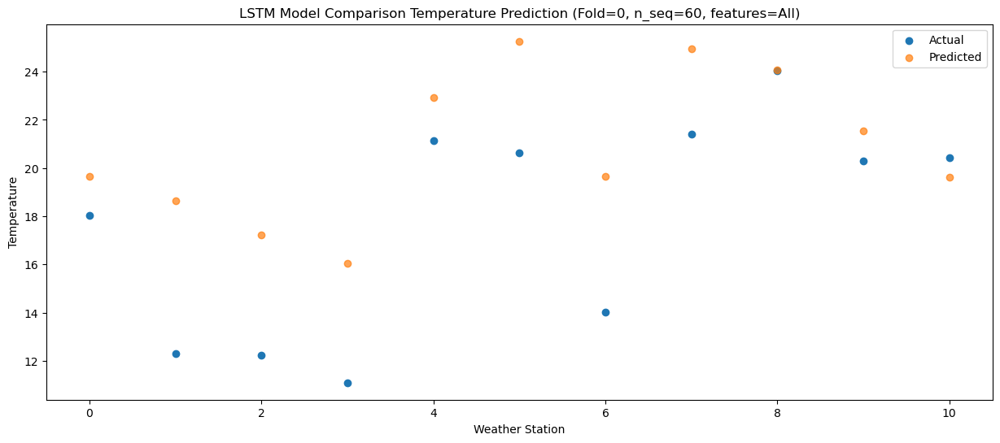

Predictions for (t+22):
    Weather_Station  Actual  Predicted
0                 0   14.45  15.821993
1                 1   10.19  14.808682
2                 2    8.67  13.408118
3                 3    8.59  12.198249
4                 4   19.14  19.108424
5                 5   17.62  21.429038
6                 6    9.99  15.811476
7                 7   16.90  21.113059
8                 8   20.29  20.232917
9                 9   16.44  17.697947
10               10   16.39  15.780144


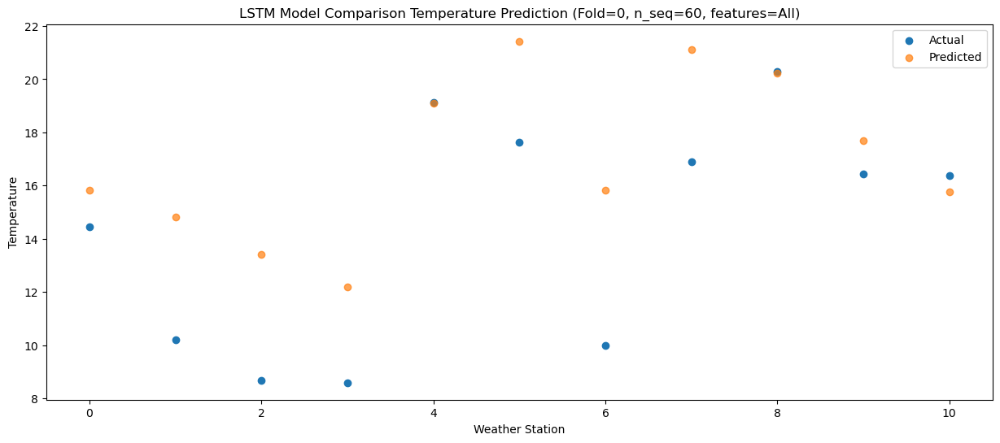

Predictions for (t+23):
    Weather_Station  Actual  Predicted
0                 0   10.43  10.755349
1                 1    7.56   9.749064
2                 2    4.79   8.353328
3                 3    6.28   7.141324
4                 4   14.79  14.045780
5                 5   14.02  16.374736
6                 6    6.76  10.755823
7                 7   13.05  16.059150
8                 8   16.33  15.175864
9                 9   11.97  12.645479
10               10   12.04  10.729147


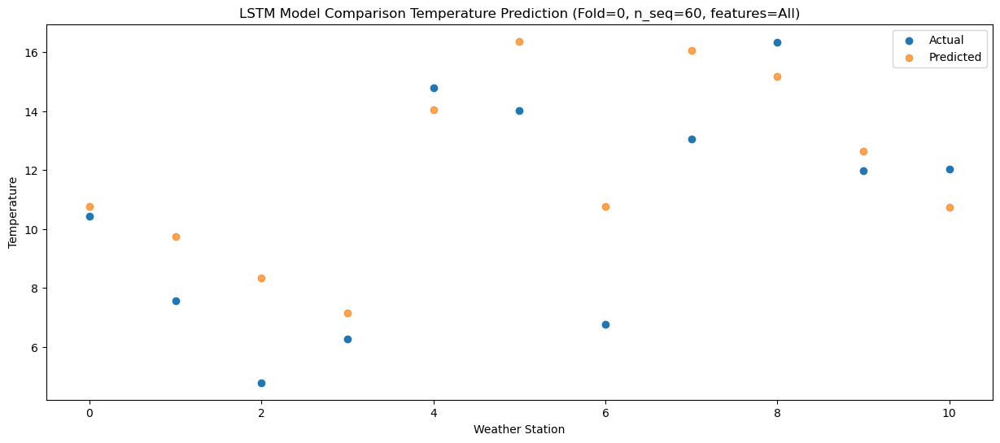

Predictions for (t+24):
    Weather_Station  Actual  Predicted
0                 0    1.67   2.394110
1                 1    2.05   1.384087
2                 2   -3.57  -0.011732
3                 3   -1.81  -1.225256
4                 4    7.22   5.680831
5                 5    5.85   8.011234
6                 6   -1.89   2.389378
7                 7    3.55   7.692200
8                 8    6.29   6.809218
9                 9    1.31   4.275353
10               10    1.18   2.354370


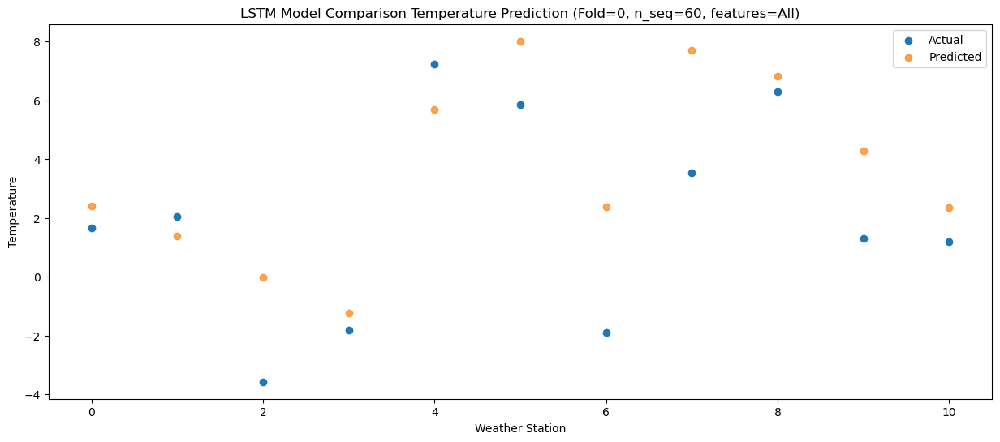

Predictions for (t+25):
    Weather_Station  Actual  Predicted
0                 0    5.05   0.988443
1                 1    1.81  -0.020053
2                 2   -1.39  -1.415175
3                 3    0.96  -2.624865
4                 4    9.55   4.283763
5                 5    6.90   6.604710
6                 6    0.05   0.985032
7                 7    5.61   6.283806
8                 8    8.09   5.406289
9                 9    2.54   2.867078
10               10    0.28   0.941992


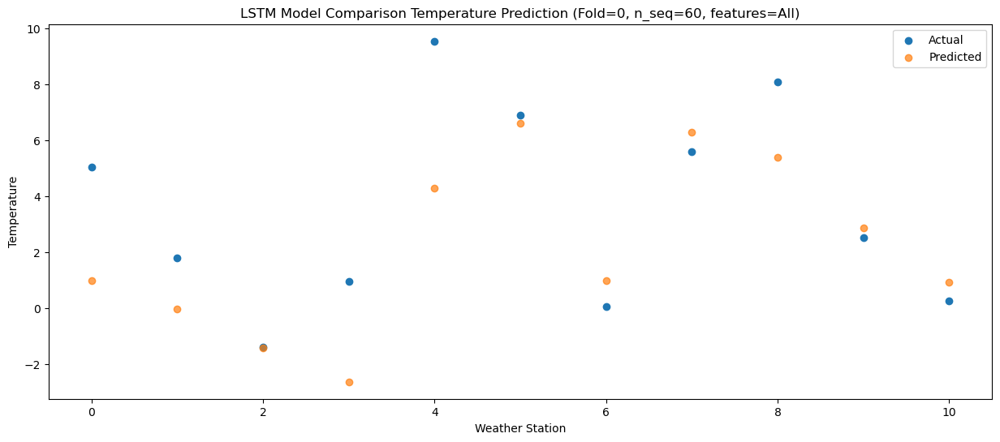

Predictions for (t+26):
    Weather_Station  Actual  Predicted
0                 0   -3.20  -6.577248
1                 1   -4.87  -7.586632
2                 2   -7.40  -8.978686
3                 3   -6.39 -10.189243
4                 4    1.10  -3.276934
5                 5    0.52  -0.959449
6                 6   -6.60  -6.576600
7                 7   -1.57  -1.275200
8                 8   -0.42  -2.151072
9                 9   -6.43  -4.687809
10               10   -8.67  -6.612931


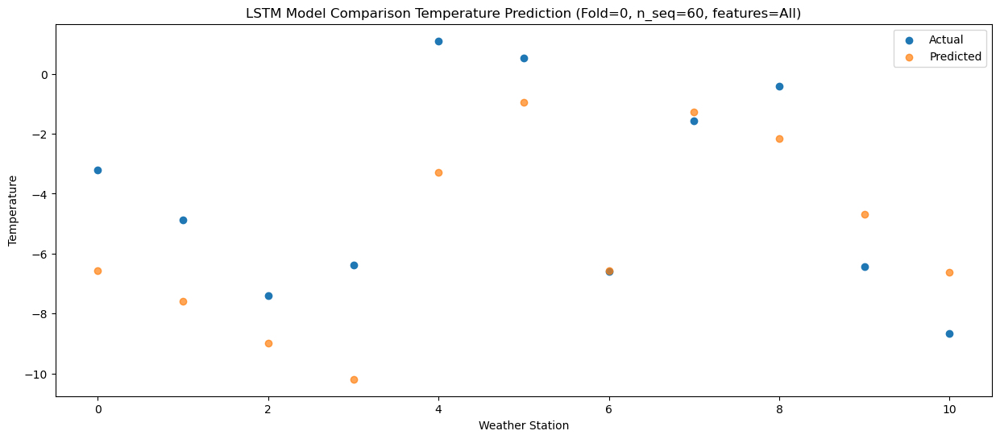

Predictions for (t+27):
    Weather_Station  Actual  Predicted
0                 0   -1.68  -4.040816
1                 1   -2.10  -5.049684
2                 2   -3.45  -6.433728
3                 3   -3.95  -7.649825
4                 4    0.87  -0.741129
5                 5    4.13   1.582161
6                 6   -2.62  -4.031179
7                 7    2.67   1.273186
8                 8    1.62   0.395927
9                 9   -2.85  -2.146183
10               10   -5.43  -4.069162


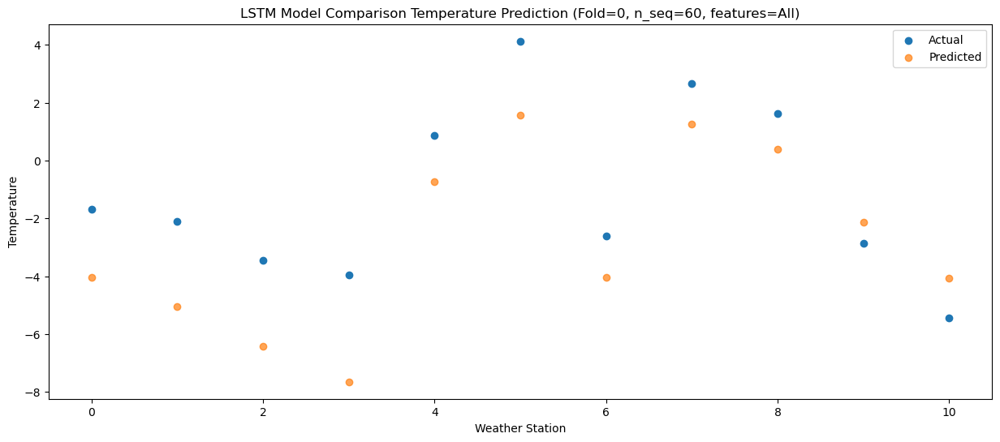

Predictions for (t+28):
    Weather_Station  Actual  Predicted
0                 0    3.90   2.251267
1                 1    1.76   1.234777
2                 2    0.05  -0.156072
3                 3   -0.16  -1.373152
4                 4    7.36   5.538471
5                 5    8.05   7.863535
6                 6    1.72   2.247813
7                 7    7.51   7.553504
8                 8    8.84   6.676759
9                 9    4.13   4.139177
10               10    1.48   2.219430


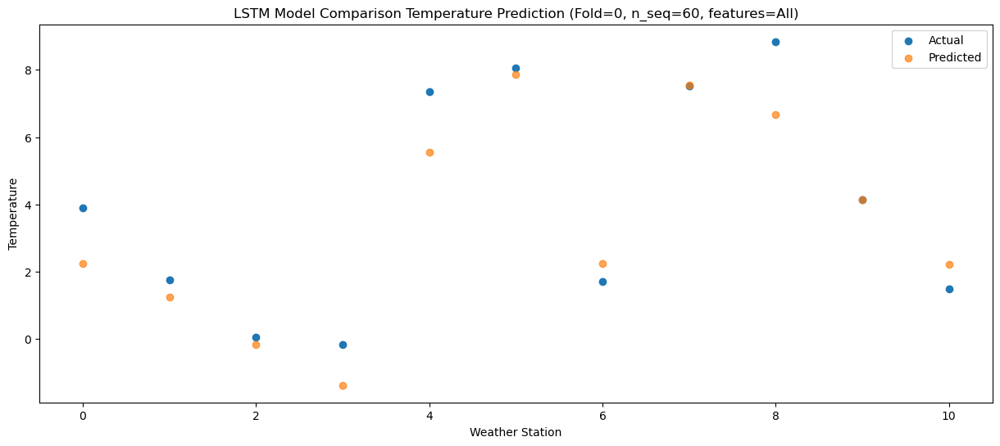

Predictions for (t+29):
    Weather_Station  Actual  Predicted
0                 0    8.03   6.254709
1                 1    4.73   5.236627
2                 2    2.79   3.839050
3                 3    4.63   2.621652
4                 4   13.40   9.537370
5                 5   10.92  11.860926
6                 6    4.64   6.241455
7                 7   10.83  11.546332
8                 8   12.79  10.669725
9                 9    6.86   8.125009
10               10    5.09   6.201023


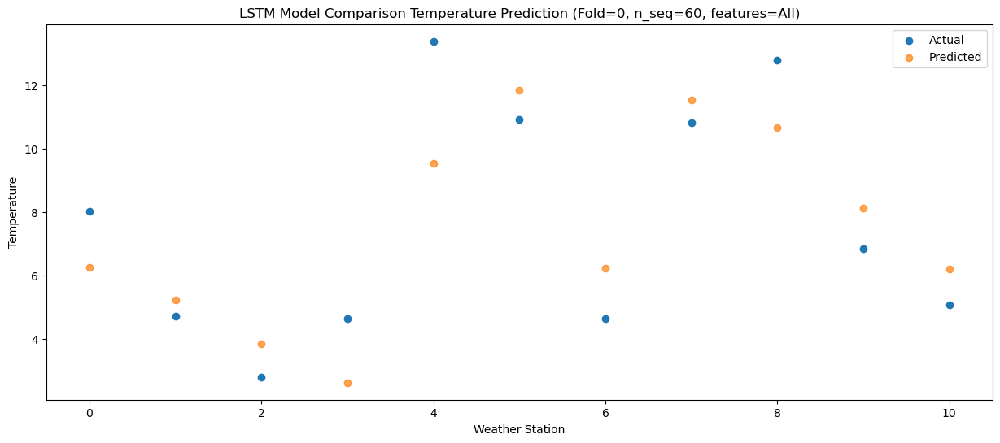

Predictions for (t+30):
    Weather_Station  Actual  Predicted
0                 0   14.22  13.005272
1                 1    9.04  11.985731
2                 2    8.55  10.585544
3                 3    9.15   9.360034
4                 4   18.11  16.270945
5                 5   15.55  18.599967
6                 6    9.71  12.980638
7                 7   15.81  18.285825
8                 8   19.63  17.411989
9                 9   15.03  14.873131
10               10   14.41  12.956783


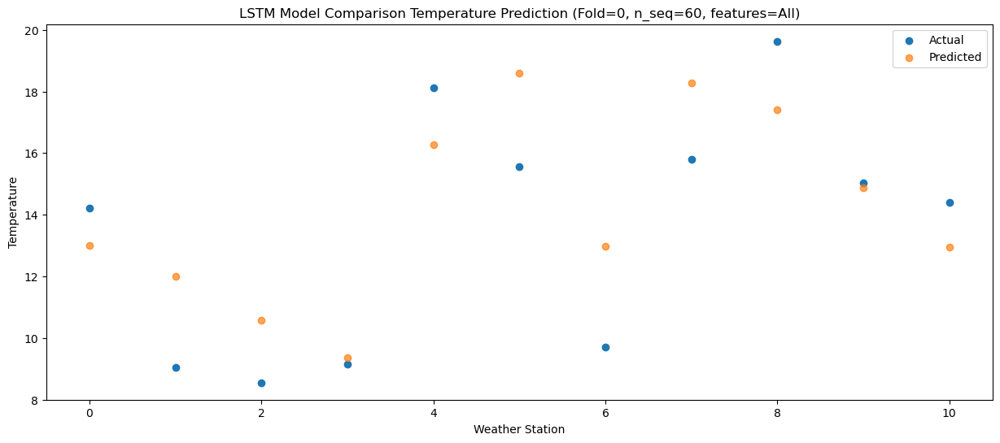

Predictions for (t+31):
    Weather_Station  Actual  Predicted
0                 0   17.43  18.015927
1                 1   12.73  16.988070
2                 2   12.33  15.589082
3                 3   11.58  14.358131
4                 4   22.45  21.276037
5                 5   19.12  23.607099
6                 6   13.62  17.982165
7                 7   19.81  23.286253
8                 8   24.15  22.414852
9                 9   18.93  19.871124
10               10   19.17  17.951524


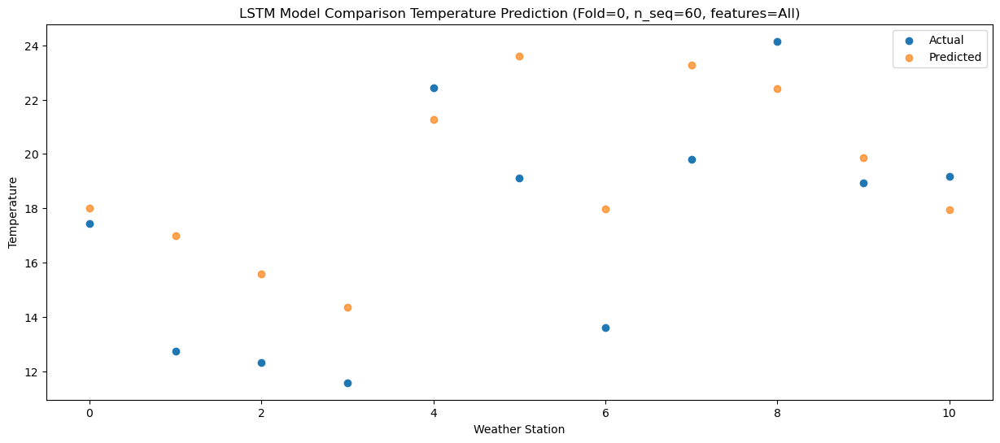

Predictions for (t+32):
    Weather_Station  Actual  Predicted
0                 0   19.65  21.102572
1                 1   12.87  20.065789
2                 2   13.25  18.665906
3                 3   11.56  17.424750
4                 4   24.81  24.344416
5                 5   21.26  26.680265
6                 6   14.72  21.048487
7                 7   21.68  26.352791
8                 8   26.48  25.484141
9                 9   20.96  22.940223
10               10   20.28  21.027119


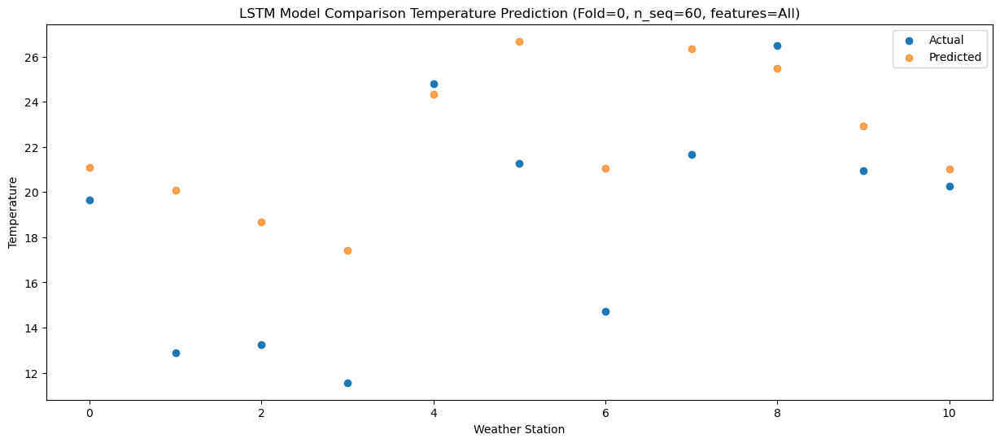

Predictions for (t+33):
    Weather_Station  Actual  Predicted
0                 0   17.47  19.849489
1                 1   12.32  18.822046
2                 2   12.02  17.422396
3                 3   10.37  16.179043
4                 4   22.45  23.098071
5                 5   20.41  25.433469
6                 6   13.43  19.808249
7                 7   20.00  25.113405
8                 8   23.60  24.240430
9                 9   19.05  21.695036
10               10   19.16  19.780624


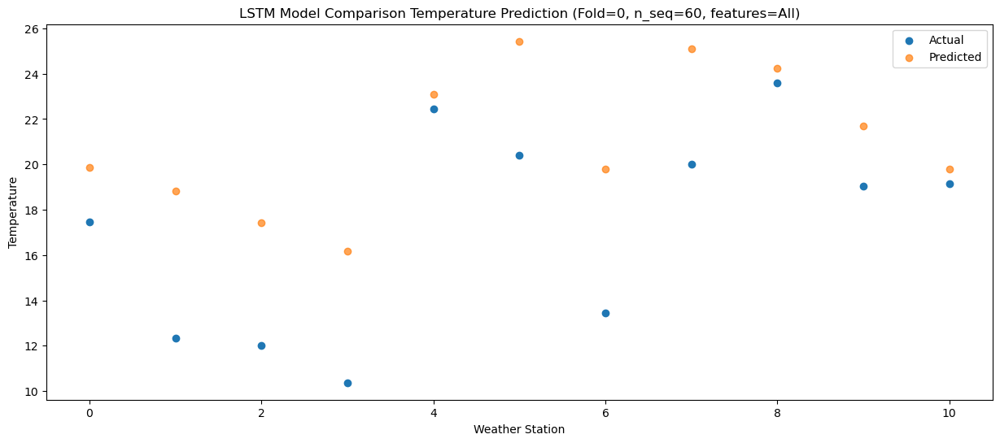

Predictions for (t+34):
    Weather_Station  Actual  Predicted
0                 0   14.50  15.517039
1                 1   11.30  14.493141
2                 2    8.90  13.092977
3                 3    9.13  11.849664
4                 4   19.50  18.768345
5                 5   17.76  21.108152
6                 6   10.37  15.483516
7                 7   16.30  20.789744
8                 8   19.96  19.912637
9                 9   15.32  17.364966
10               10   15.32  15.447219


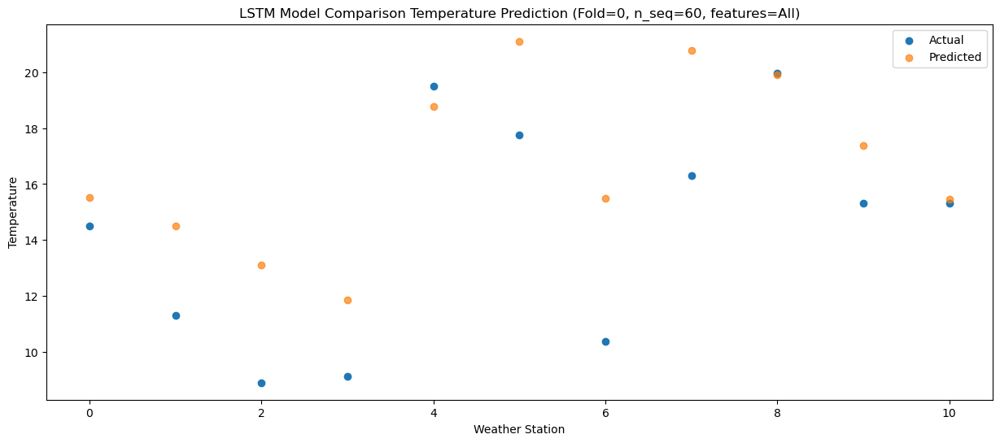

Predictions for (t+35):
    Weather_Station  Actual  Predicted
0                 0    8.82   8.751001
1                 1    5.70   7.726543
2                 2    1.76   6.331256
3                 3    3.51   5.083075
4                 4   13.58  11.999355
5                 5   11.20  14.344134
6                 6    3.43   8.718823
7                 7    9.11  14.027182
8                 8   13.40  13.145668
9                 9    8.28  10.603466
10               10    8.08   8.688222


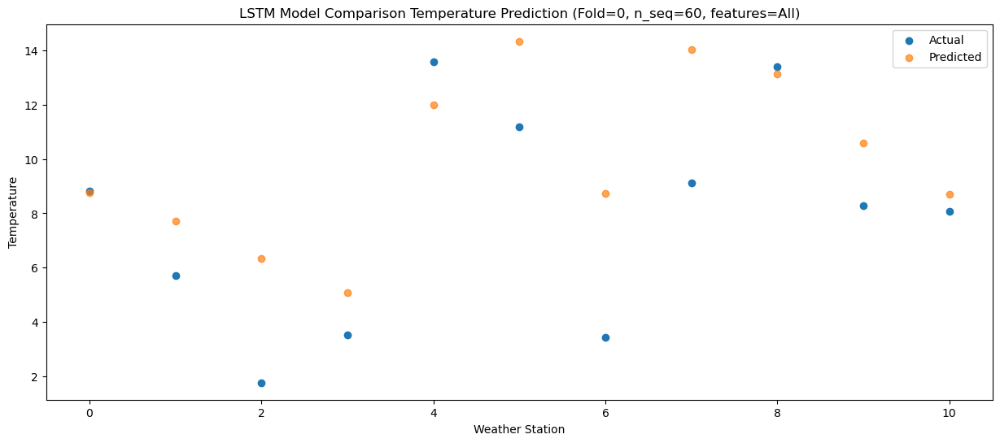

Predictions for (t+36):
    Weather_Station  Actual  Predicted
0                 0    1.87   2.278108
1                 1    3.01   1.248178
2                 2   -0.72  -0.146888
3                 3   -0.60  -1.401136
4                 4    6.65   5.513942
5                 5    9.51   7.865492
6                 6    1.20   2.241914
7                 7    6.91   7.550079
8                 8    7.43   6.669227
9                 9    3.26   4.131679
10               10    3.05   2.220799


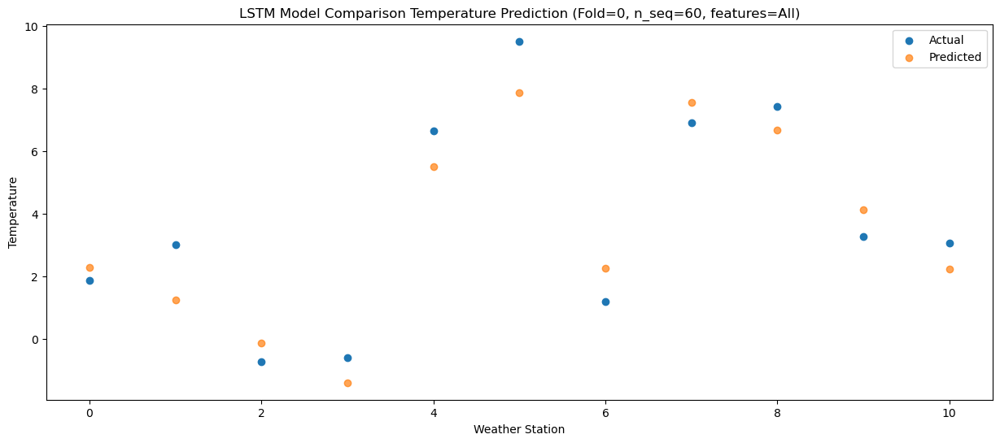

Predictions for (t+37):
    Weather_Station  Actual  Predicted
0                 0   -0.22  -3.352470
1                 1   -0.84  -4.383946
2                 2   -5.24  -5.782251
3                 3   -2.78  -7.037713
4                 4    3.92  -0.119523
5                 5    2.99   2.228522
6                 6   -5.31  -3.396323
7                 7   -0.26   1.908097
8                 8    2.14   1.029432
9                 9   -2.45  -1.514472
10               10   -3.13  -3.422706


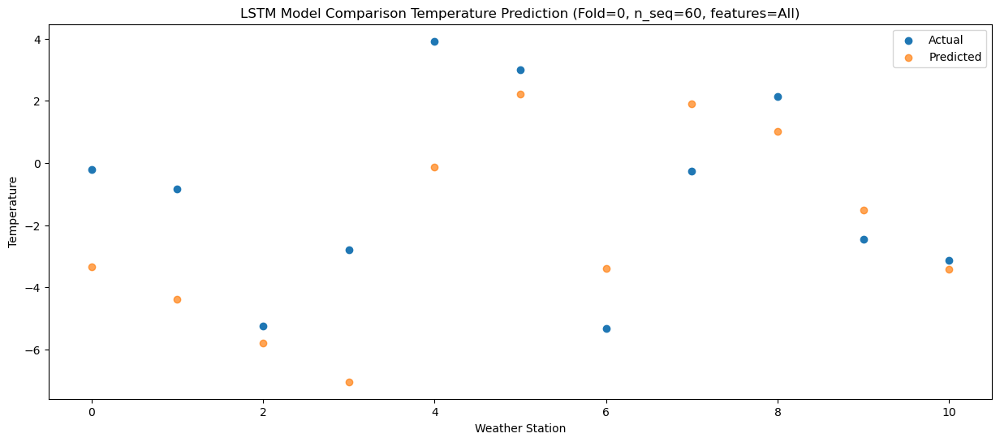

Predictions for (t+38):
    Weather_Station  Actual  Predicted
0                 0    1.42  -1.633419
1                 1   -0.05  -2.667174
2                 2   -3.29  -4.068277
3                 3   -1.34  -5.322261
4                 4    4.89   1.599549
5                 5    4.68   3.947314
6                 6   -2.12  -1.678334
7                 7    2.91   3.626384
8                 8    4.70   2.747200
9                 9   -0.56   0.203140
10               10   -2.00  -1.700071


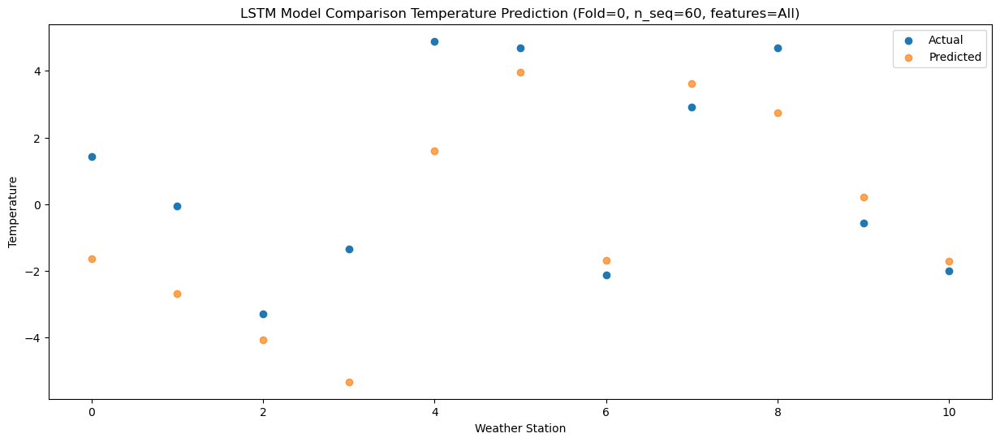

Predictions for (t+39):
    Weather_Station  Actual  Predicted
0                 0    2.95  -1.163215
1                 1    1.05  -2.193504
2                 2   -0.51  -3.588936
3                 3   -0.93  -4.841122
4                 4    5.02   2.078782
5                 5    6.17   4.429450
6                 6    0.88  -1.197399
7                 7    5.88   4.110900
8                 8    6.31   3.225122
9                 9    1.48   0.679360
10               10   -1.59  -1.233194


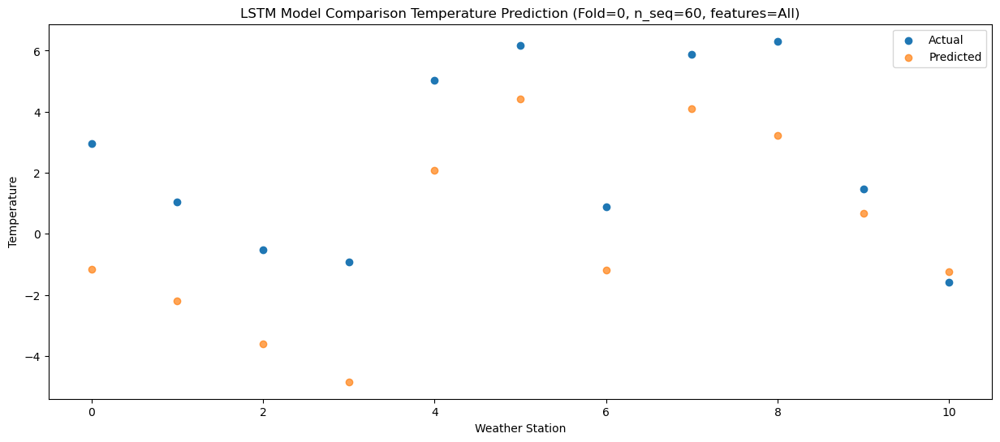

Predictions for (t+40):
    Weather_Station  Actual  Predicted
0                 0    5.32   1.841106
1                 1    2.64   0.810903
2                 2   -0.53  -0.587835
3                 3    2.59  -1.841849
4                 4    9.74   5.078081
5                 5    7.08   7.430828
6                 6    1.36   1.801960
7                 7    6.56   7.106721
8                 8    8.13   6.222394
9                 9    1.82   3.675448
10               10    0.27   1.758569


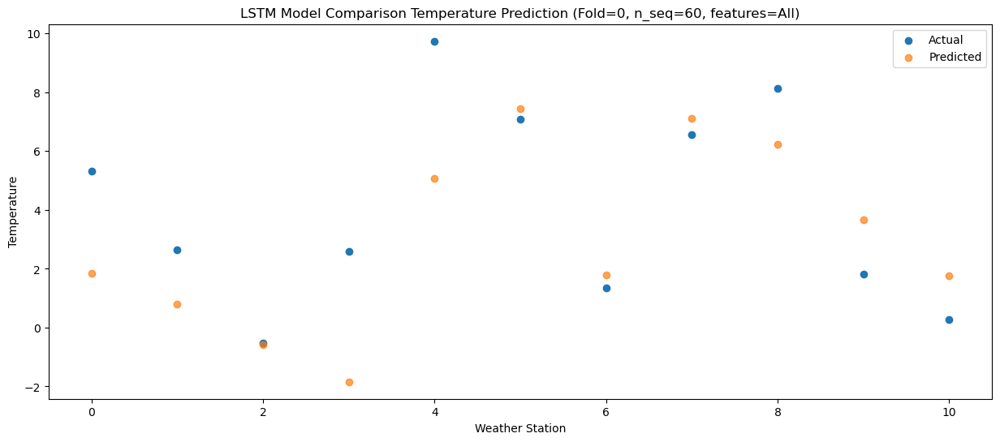

Predictions for (t+41):
    Weather_Station  Actual  Predicted
0                 0    7.94   7.639377
1                 1    4.79   6.607079
2                 2    2.54   5.209850
3                 3    4.01   3.952573
4                 4   11.24  10.871803
5                 5   11.76  13.226867
6                 6    4.92   7.596241
7                 7   11.18  12.900804
8                 8   13.91  12.018394
9                 9    8.10   9.469297
10               10    7.12   7.552911


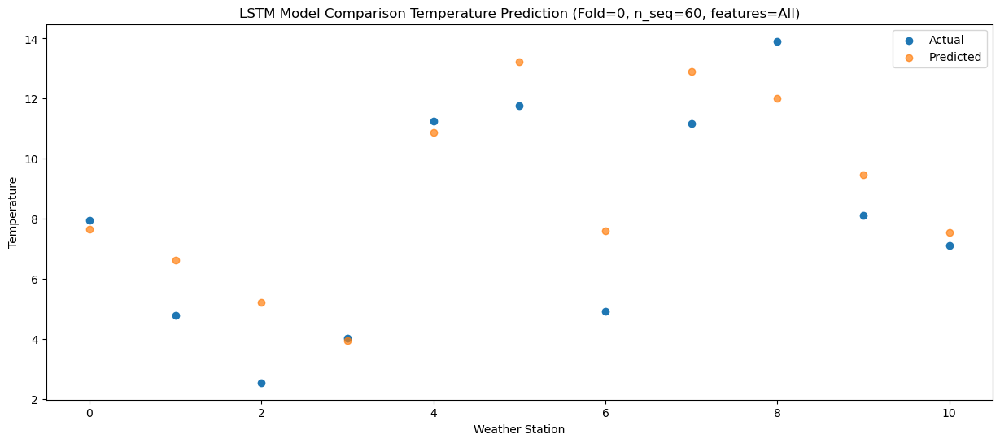

Predictions for (t+42):
    Weather_Station  Actual  Predicted
0                 0   13.41  13.404311
1                 1    7.97  12.375495
2                 2    5.95  10.976307
3                 3    8.44   9.717669
4                 4   16.77  16.632910
5                 5   13.28  18.988937
6                 6    7.61  13.359549
7                 7   13.47  18.664640
8                 8   19.50  17.780802
9                 9   13.06  15.229303
10               10   12.14  13.316140


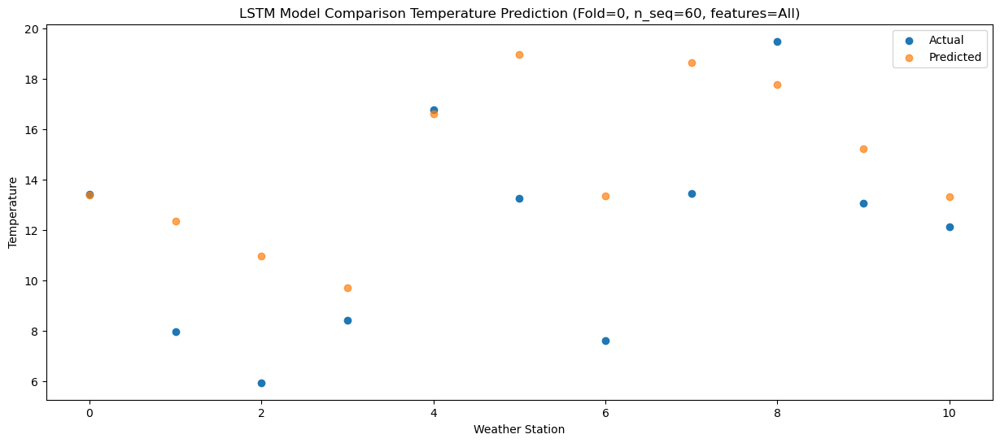

Predictions for (t+43):
    Weather_Station  Actual  Predicted
0                 0   17.19  17.811259
1                 1   11.05  16.778027
2                 2    9.27  15.380335
3                 3   12.19  14.122008
4                 4   21.32  21.032350
5                 5   17.10  23.390082
6                 6   10.96  17.764554
7                 7   17.22  23.069876
8                 8   23.37  22.189288
9                 9   16.90  19.638774
10               10   17.65  17.726535


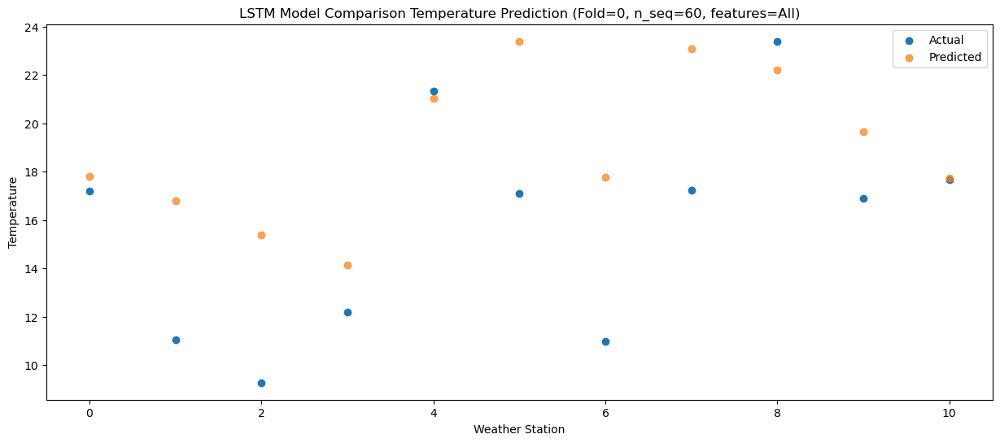

Predictions for (t+44):
    Weather_Station  Actual  Predicted
0                 0   18.73  20.688587
1                 1   12.88  19.649901
2                 2   12.37  18.253406
3                 3   13.31  16.985819
4                 4   24.31  23.895731
5                 5   20.93  26.259509
6                 6   14.67  20.631930
7                 7   21.36  25.937015
8                 8   24.86  25.053471
9                 9   19.73  22.504459
10               10   20.11  20.587279


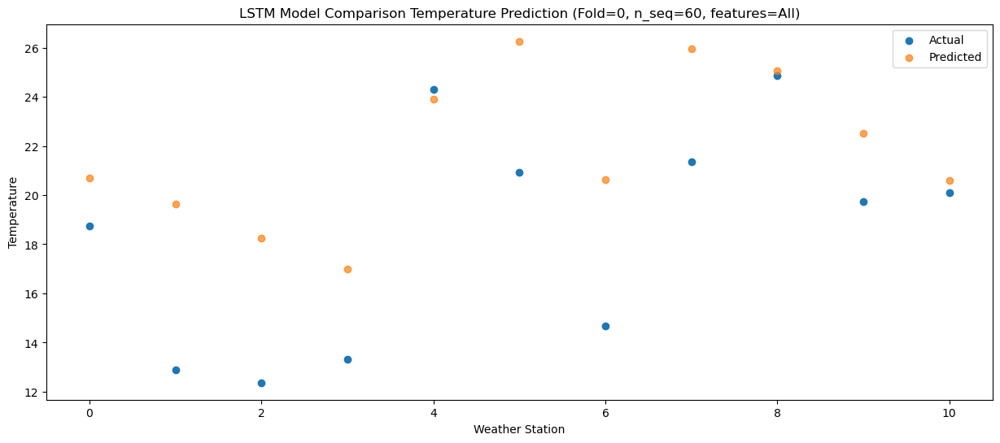

Predictions for (t+45):
    Weather_Station  Actual  Predicted
0                 0   19.45  20.074842
1                 1   14.47  19.031432
2                 2   11.98  17.635917
3                 3   14.84  16.368128
4                 4   26.05  23.281486
5                 5   20.45  25.634185
6                 6   13.98  20.009497
7                 7   20.22  25.308901
8                 8   23.60  24.428367
9                 9   18.93  21.873604
10               10   18.30  19.953571


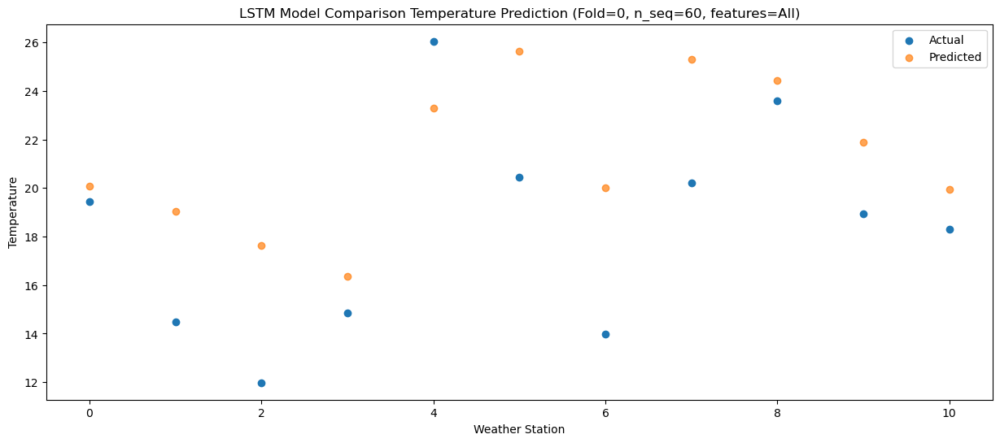

Predictions for (t+46):
    Weather_Station  Actual  Predicted
0                 0   15.22  16.549314
1                 1   11.09  15.502731
2                 2    8.53  14.106351
3                 3   11.40  12.837194
4                 4   21.57  19.751035
5                 5   16.93  22.107169
6                 6   10.47  16.483222
7                 7   16.46  21.782033
8                 8   20.43  20.895145
9                 9   16.32  18.343214
10               10   15.92  16.423496


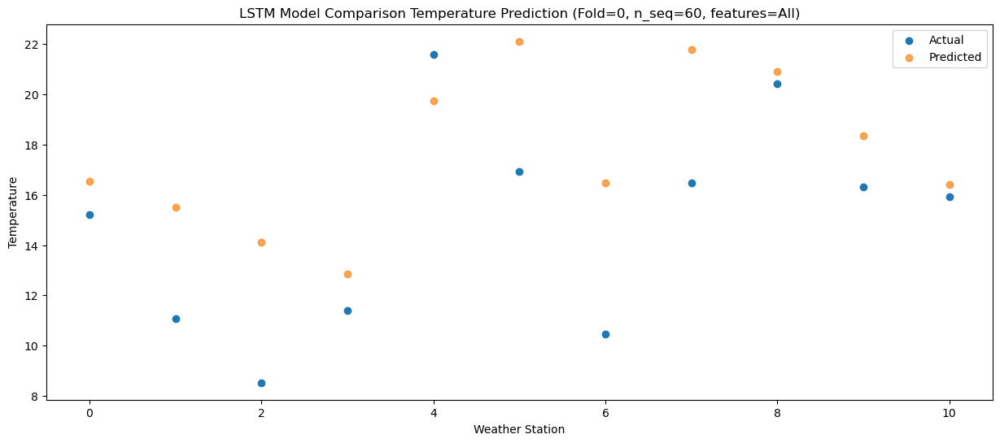

Predictions for (t+47):
    Weather_Station  Actual  Predicted
0                 0   10.16  10.023155
1                 1    5.98   8.984810
2                 2    2.55   7.591187
3                 3    5.15   6.322503
4                 4   13.91  13.236445
5                 5   12.58  15.599789
6                 6    5.26   9.973155
7                 7   11.07  15.275289
8                 8   14.83  14.383976
9                 9    9.74  11.829566
10               10    9.96   9.906690


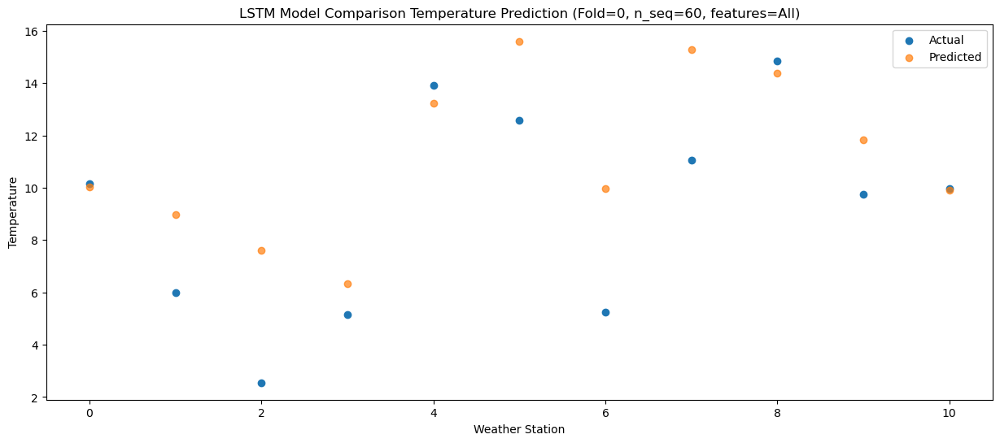

Predictions for (t+48):
    Weather_Station  Actual  Predicted
0                 0    3.30   2.962574
1                 1    0.74   1.915615
2                 2   -2.54   0.519570
3                 3   -0.71  -0.752360
4                 4    7.55   6.166598
5                 5    7.14   8.526512
6                 6   -0.61   2.902173
7                 7    4.62   8.201128
8                 8    7.84   7.312207
9                 9    3.24   4.753993
10               10    2.32   2.831662


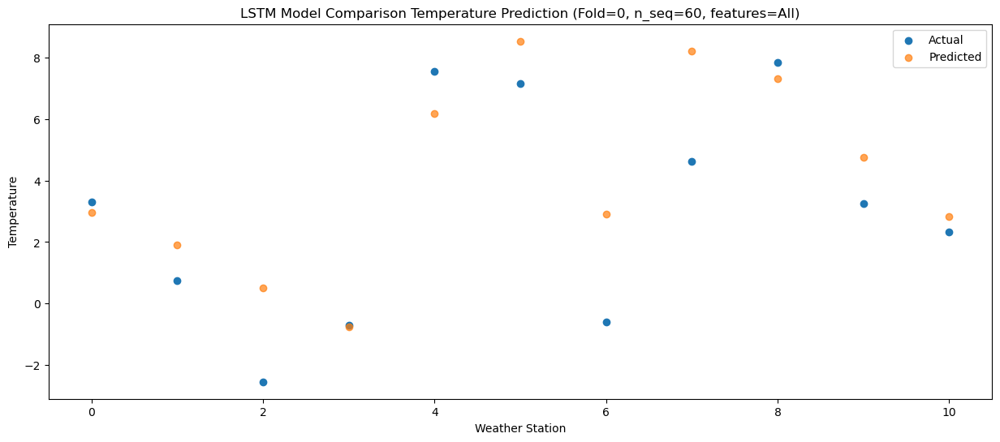

Predictions for (t+49):
    Weather_Station  Actual  Predicted
0                 0    0.70   1.180213
1                 1   -1.96   0.141729
2                 2   -5.57  -1.251680
3                 3   -3.50  -2.527784
4                 4    4.76   4.386655
5                 5    5.00   6.750423
6                 6   -2.90   1.126211
7                 7    3.03   6.425276
8                 8    5.28   5.534404
9                 9    0.81   2.976655
10               10    1.64   1.059871


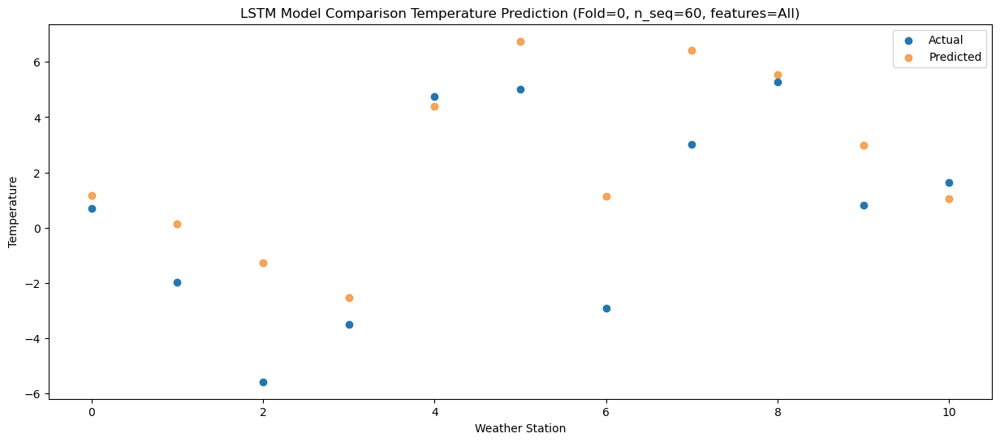

Predictions for (t+50):
    Weather_Station  Actual  Predicted
0                 0   -4.42  -4.575376
1                 1   -4.23  -5.615281
2                 2   -8.08  -7.012725
3                 3   -6.38  -8.281665
4                 4   -0.22  -1.371160
5                 5    3.73   0.989204
6                 6   -5.03  -4.637815
7                 7    0.33   0.660783
8                 8   -0.98  -0.230139
9                 9   -4.95  -2.790212
10               10   -5.28  -4.709075


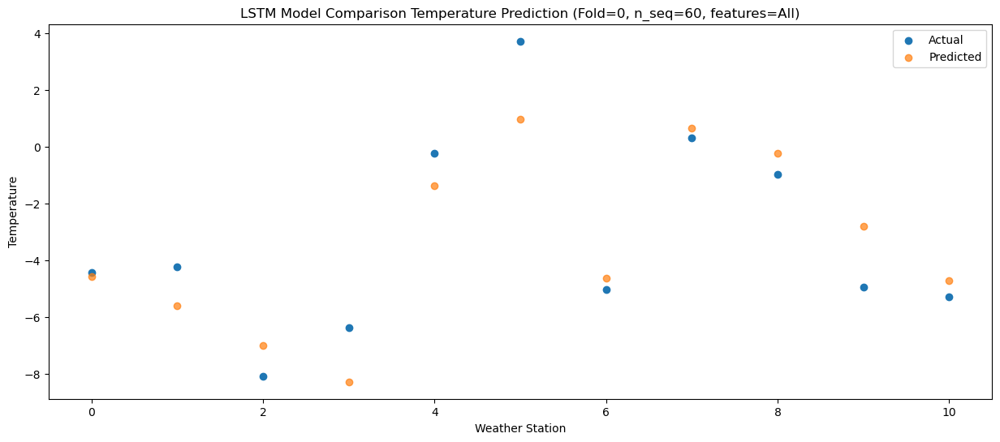

Predictions for (t+51):
    Weather_Station  Actual  Predicted
0                 0    3.46   1.155291
1                 1   -1.73   0.114795
2                 2   -3.57  -1.284385
3                 3   -1.73  -2.550415
4                 4    7.65   4.367254
5                 5    4.25   6.722314
6                 6   -1.47   1.087615
7                 7    3.47   6.388604
8                 8    7.64   5.499080
9                 9    1.19   2.939095
10               10   -0.27   1.022403


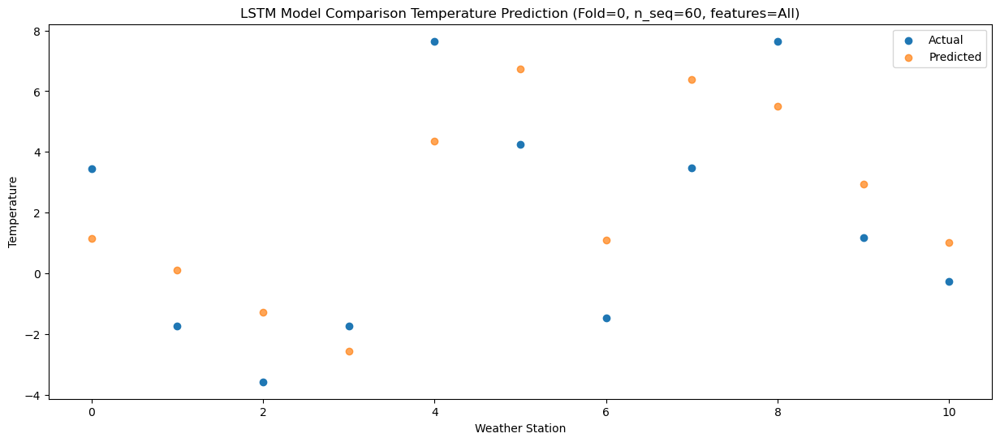

Predictions for (t+52):
    Weather_Station  Actual  Predicted
0                 0    5.21   4.254966
1                 1    1.57   3.212002
2                 2    0.81   1.810416
3                 3    1.21   0.548334
4                 4   10.20   7.463536
5                 5    8.30   9.816474
6                 6    2.37   4.181021
7                 7    7.62   9.481437
8                 8   10.92   8.594362
9                 9    4.51   6.033761
10               10    3.23   4.124325


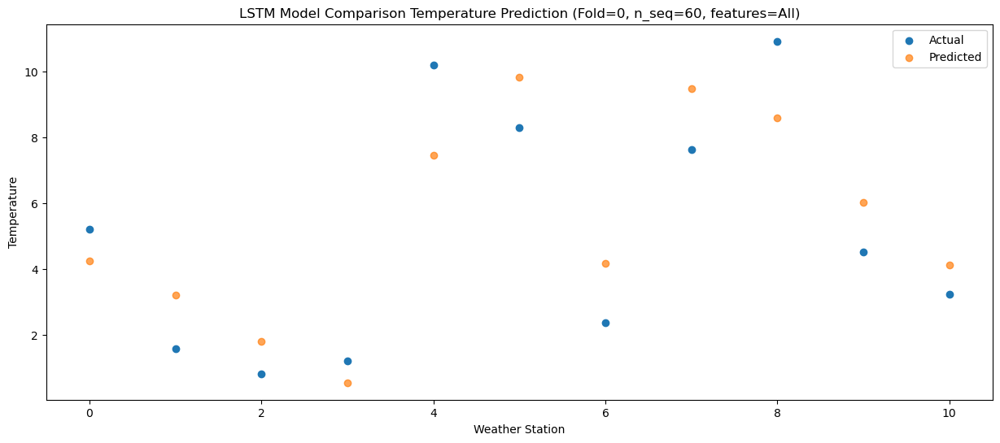

Predictions for (t+53):
    Weather_Station  Actual  Predicted
0                 0    9.98   8.819878
1                 1    4.45   7.769542
2                 2    4.50   6.359944
3                 3    4.78   5.107924
4                 4   13.47  12.016549
5                 5   11.52  14.365515
6                 6    5.96   8.731458
7                 7   12.10  14.030239
8                 8   15.80  13.144007
9                 9    9.73  10.579751
10               10    8.57   8.668231


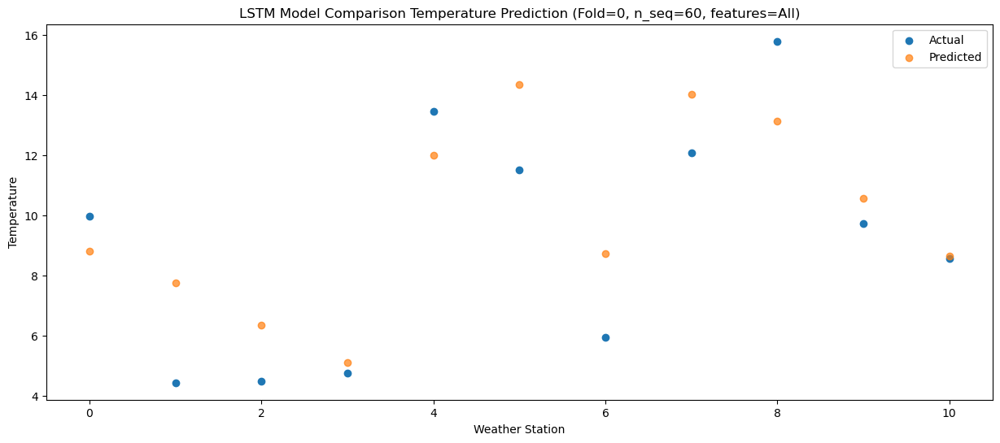

Predictions for (t+54):
    Weather_Station  Actual  Predicted
0                 0   14.89  13.886072
1                 1    8.94  12.820906
2                 2    8.98  11.408278
3                 3    9.17  10.154501
4                 4   18.05  17.072693
5                 5   16.33  19.418151
6                 6    9.96  13.783503
7                 7   16.06  19.080692
8                 8   20.87  18.199043
9                 9   15.53  15.634848
10               10   15.54  13.733209


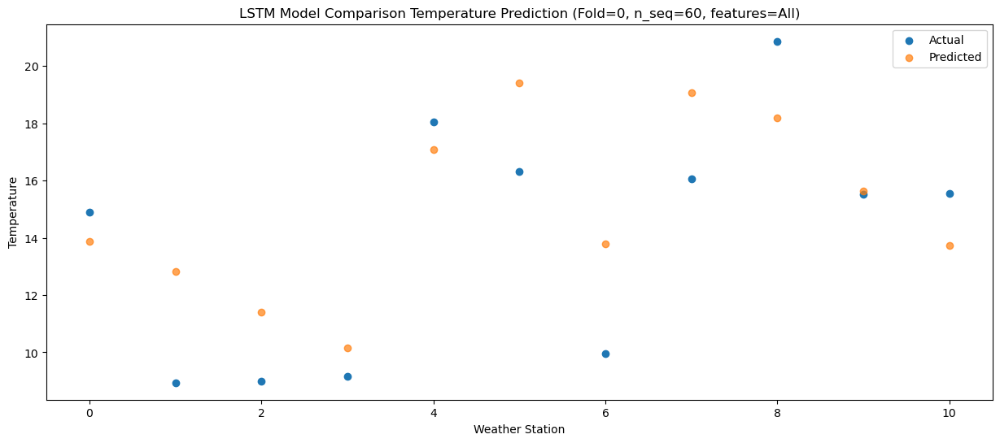

Predictions for (t+55):
    Weather_Station  Actual  Predicted
0                 0   17.50  18.782410
1                 1   11.87  17.710021
2                 2   13.22  16.296760
3                 3   11.29  15.042609
4                 4   21.55  21.965503
5                 5   19.76  24.304326
6                 6   13.87  18.671476
7                 7   20.08  23.967387
8                 8   23.80  23.091613
9                 9   19.29  20.524756
10               10   19.86  18.625383


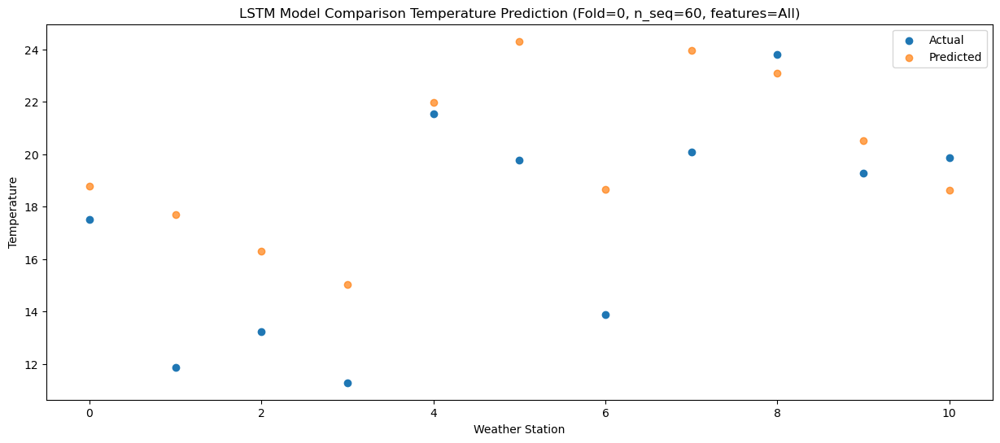

Predictions for (t+56):
    Weather_Station  Actual  Predicted
0                 0   18.38  20.511464
1                 1   13.00  19.431270
2                 2   13.49  18.012726
3                 3   11.23  16.757646
4                 4   21.41  23.688839
5                 5   21.42  26.029632
6                 6   15.13  20.388063
7                 7   21.30  25.682553
8                 8   24.35  24.805390
9                 9   20.13  22.239301
10               10   20.75  20.341255


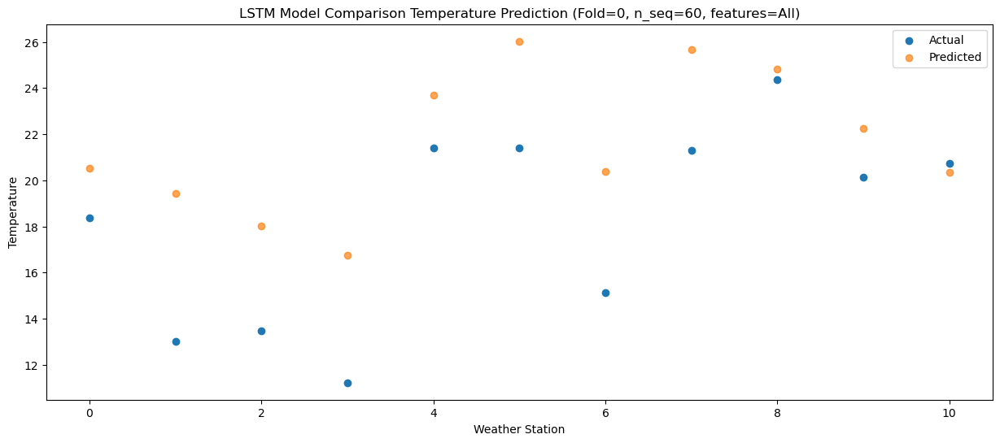

Predictions for (t+57):
    Weather_Station  Actual  Predicted
0                 0   18.72  19.962036
1                 1   13.39  18.876503
2                 2   11.81  17.456906
3                 3   12.04  16.198533
4                 4   23.09  23.130464
5                 5   20.15  25.468551
6                 6   13.38  19.827967
7                 7   19.46  25.118551
8                 8   24.29  24.241947
9                 9   19.80  21.675147
10               10   20.00  19.776264


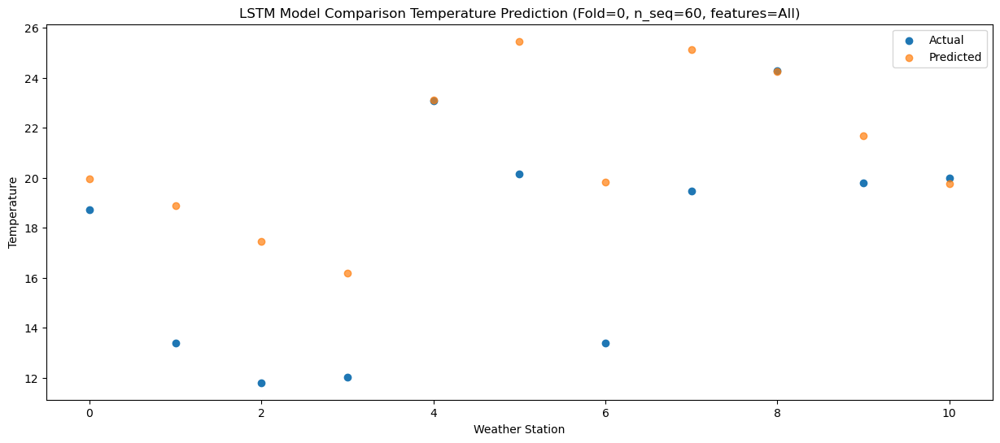

Predictions for (t+58):
    Weather_Station  Actual  Predicted
0                 0   14.58  16.655207
1                 1   10.15  15.561177
2                 2    9.04  14.143574
3                 3    9.45  12.889180
4                 4   19.17  19.820072
5                 5   18.21  22.153852
6                 6   10.95  16.514676
7                 7   16.53  21.807140
8                 8   20.67  20.932397
9                 9   17.61  18.369669
10               10   17.22  16.474522


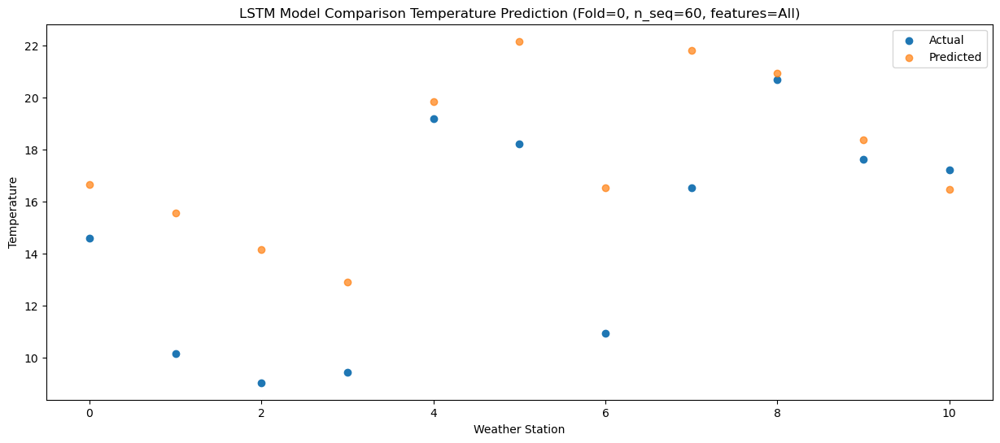

Predictions for (t+59):
    Weather_Station  Actual  Predicted
0                 0   11.31  11.337051
1                 1    6.83  10.241090
2                 2    3.14   8.822161
3                 3    5.31   7.567131
4                 4   16.72  14.505649
5                 5   13.18  16.838478
6                 6    5.68  11.196795
7                 7   10.70  16.489124
8                 8   15.24  15.611416
9                 9   10.87  13.045409
10               10   10.99  11.148356


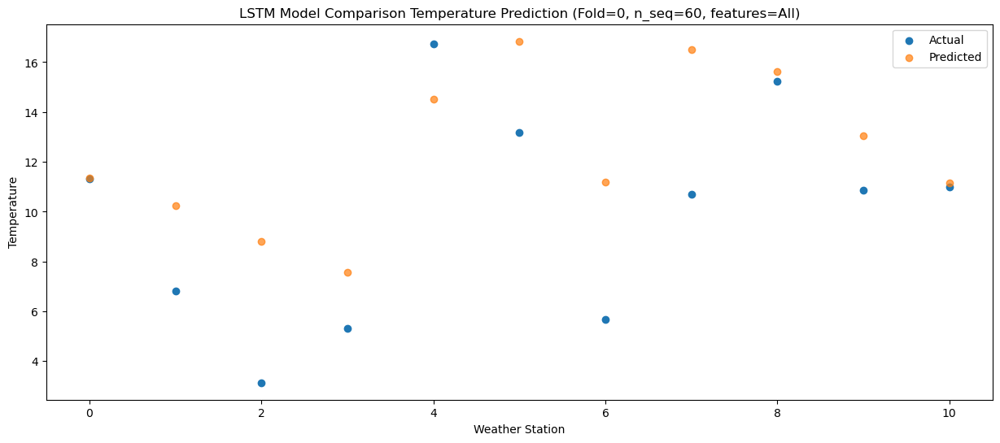

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (1, 1, 256)               2290688   
                                                                 
 dropout (Dropout)           (1, 1, 256)               0         
                                                                 
 lstm_1 (LSTM)               (1, 256)                  525312    
                                                                 
 dropout_1 (Dropout)         (1, 256)                  0         
                                                                 
 dense (Dense)               (1, 256)                  65792     
                                                                 
 dense_1 (Dense)             (1, 128)                  32896     
                                                                 
 dense_2 (Dense)             (1, 60)                   7

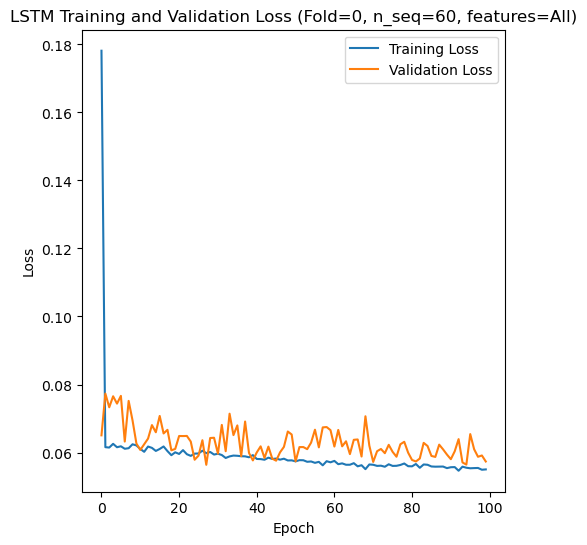

Epoch 1/100
84/84 [==============================] - 27s 99ms/step - loss: 0.1501 - accuracy: 0.3333 - mae: 0.1231 - rmse: 0.1501 - mape: inf - pearson: 0.6598 - val_loss: 0.0612 - val_accuracy: 0.6000 - val_mae: 0.0489 - val_rmse: 0.0612 - val_mape: 10.9599 - val_pearson: 0.8367
Epoch 2/100
84/84 [==============================] - 2s 23ms/step - loss: 0.0634 - accuracy: 0.5357 - mae: 0.0501 - rmse: 0.0634 - mape: inf - pearson: 0.8190 - val_loss: 0.0547 - val_accuracy: 0.6000 - val_mae: 0.0436 - val_rmse: 0.0547 - val_mape: 9.5015 - val_pearson: 0.8701
Epoch 3/100
84/84 [==============================] - 2s 25ms/step - loss: 0.0611 - accuracy: 0.4762 - mae: 0.0482 - rmse: 0.0611 - mape: inf - pearson: 0.8285 - val_loss: 0.0616 - val_accuracy: 0.6000 - val_mae: 0.0477 - val_rmse: 0.0616 - val_mape: 10.1510 - val_pearson: 0.8521
Epoch 4/100
84/84 [==============================] - 2s 24ms/step - loss: 0.0635 - accuracy: 0.4881 - mae: 0.0501 - rmse: 0.0635 - mape: inf - pearson: 0.8232 -

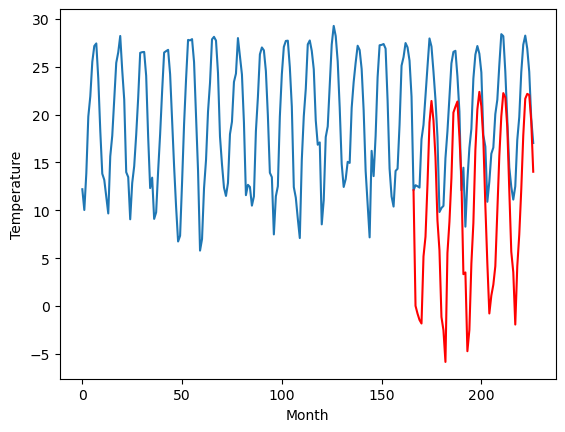

Weather Station 2:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-0.99		-1.41		-0.42
-1.90		-2.23		-0.33
-3.01		-2.89		0.12
-2.92		-3.26		-0.34
3.08		3.75		0.67
4.30		5.80		1.50
7.65		11.28		3.63
12.00		17.71		5.71
15.37		19.98		4.61
13.96		17.96		4.00
10.42		14.11		3.69
6.70		7.48		0.78
2.60		4.38		1.78
-4.29		-2.58		1.71
-4.49		-3.96		0.53
-3.83		-7.27		-3.44
2.94		4.12		1.18
5.08		7.35		2.27
8.81		11.94		3.13
12.95		18.79		5.84
14.33		19.39		5.06
14.60		19.93		5.33
10.86		16.28		5.42
7.08		11.84		4.76
-0.58		1.89		2.47
1.05		2.07		1.02
-5.68		-6.16		-0.48
-1.45		-3.92		-2.47
2.12		3.00		0.88
5.12		7.23		2.11
11.00		14.84		3.84
14.97		19.10		4.13
15.47		20.94		5.47
14.01		19.44		5.43
10.92		15.93		5.01
4.58		9.06		4.48
1.58		3.03		1.45
-4.23		-2.21		2.02
-2.04		-0.34		1.70
1.33		0.80		-0.53
2.10		2.74		0.64
5.37		8.46		3.09
8.65		14.26		5.61
11.84		18.39		6.55
15.44		20.82		5.38
14.90		20.36		5.46
11.39		17.26		5.87
6.38		10.64		4.26
0.76		4.24		3.48
-2.

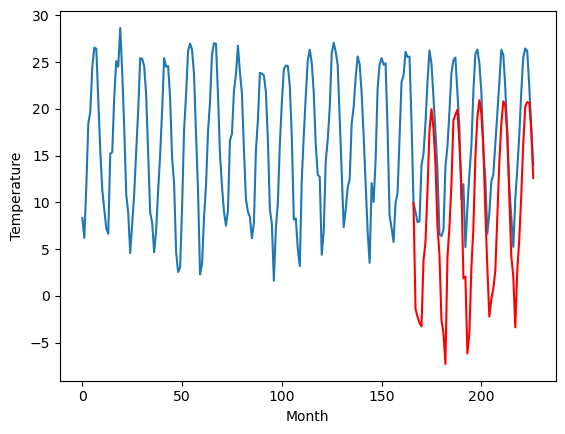

Weather Station 3:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-0.90		-0.17		0.73
-0.47		-0.99		-0.52
-1.00		-1.65		-0.65
-0.72		-2.02		-1.30
6.38		4.98		-1.40
5.41		7.03		1.62
9.56		12.51		2.95
13.79		18.94		5.15
15.26		21.21		5.95
15.25		19.19		3.94
12.45		15.34		2.89
8.10		8.72		0.62
3.30		5.61		2.31
-3.76		-1.35		2.41
-3.34		-2.74		0.60
-2.85		-6.05		-3.20
4.21		5.34		1.13
5.61		8.57		2.96
9.73		13.16		3.43
13.61		20.01		6.40
14.38		20.61		6.23
15.04		21.14		6.10
12.02		17.49		5.47
8.24		13.06		4.82
0.50		3.10		2.60
3.10		3.28		0.18
-3.79		-4.94		-1.15
-0.44		-2.71		-2.27
3.56		4.22		0.66
7.15		8.45		1.30
12.51		16.06		3.55
15.48		20.31		4.83
16.19		22.15		5.96
14.58		20.66		6.08
12.19		17.15		4.96
5.50		10.27		4.77
2.18		4.24		2.06
-0.98		-1.00		-0.02
0.02		0.88		0.86
2.61		2.02		-0.59
4.04		3.96		-0.08
6.73		9.68		2.95
9.97		15.48		5.51
13.72		19.61		5.89
16.09		22.04		5.95
16.53		21.58		5.05
13.57		18.47		4.90
7.53		11.85		4.32
0.97		5.46		4.49
-1

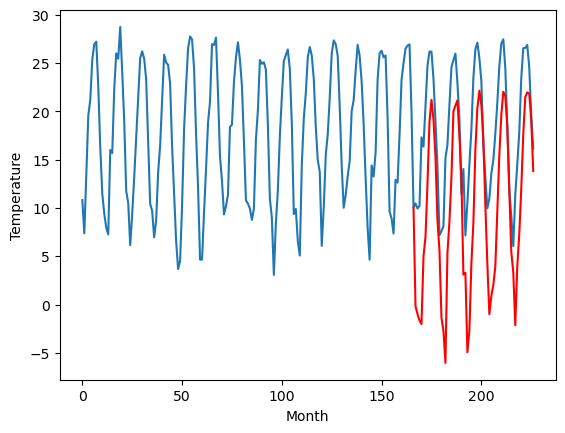

Weather Station 4:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
1.19		-1.14		-2.33
-0.23		-1.95		-1.72
0.52		-2.60		-3.12
-0.01		-2.99		-2.98
7.63		4.01		-3.62
7.51		6.06		-1.45
11.26		11.53		0.27
14.04		17.97		3.93
15.69		20.24		4.55
15.93		18.22		2.29
12.52		14.38		1.86
7.98		7.76		-0.22
5.08		4.65		-0.43
-1.10		-2.31		-1.21
-1.20		-3.69		-2.49
-2.79		-7.00		-4.21
4.58		4.40		-0.18
6.92		7.63		0.71
10.81		12.22		1.41
14.70		19.06		4.36
14.58		19.67		5.09
15.55		20.21		4.66
12.54		16.55		4.01
9.85		12.12		2.27
2.69		2.16		-0.53
6.06		2.35		-3.71
-1.99		-5.86		-3.87
-2.46		-3.62		-1.16
3.38		3.31		-0.07
9.38		7.54		-1.84
13.81		15.14		1.33
16.81		19.40		2.59
17.75		21.24		3.49
16.11		19.75		3.64
13.34		16.24		2.90
7.78		9.34		1.56
2.73		3.32		0.59
0.64		-1.92		-2.56
1.35		-0.05		-1.40
2.35		1.10		-1.25
6.18		3.05		-3.13
7.02		8.77		1.75
11.61		14.58		2.97
15.76		18.70		2.94
17.48		21.14		3.66
19.45		20.69		1.24
16.37		17.58		1.21
9.11		10.96		1.85
2.83		4

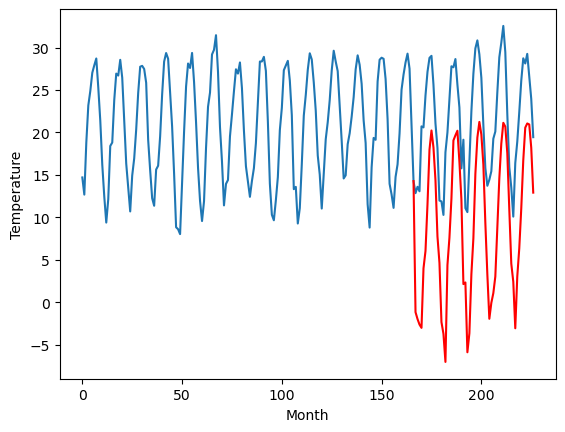

Weather Station 5:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
5.60		3.10		-2.50
3.71		2.29		-1.42
4.52		1.64		-2.88
4.14		1.26		-2.88
12.18		8.26		-3.92
11.92		10.29		-1.63
15.72		15.77		0.05
18.75		22.21		3.46
20.79		24.48		3.69
21.03		22.46		1.43
17.45		18.63		1.18
12.51		12.01		-0.50
9.41		8.90		-0.51
3.05		1.94		-1.11
3.04		0.56		-2.48
1.34		-2.75		-4.09
8.95		8.65		-0.30
11.25		11.89		0.64
15.37		16.48		1.11
18.84		23.33		4.49
18.93		23.93		5.00
19.90		24.47		4.57
16.32		20.82		4.50
13.28		16.38		3.10
5.73		6.43		0.70
9.61		6.62		-2.99
1.13		-1.59		-2.72
0.82		0.66		-0.16
6.60		7.59		0.99
12.87		11.83		-1.04
17.49		19.43		1.94
20.86		23.69		2.83
21.95		25.53		3.58
19.94		24.04		4.10
16.76		20.52		3.76
11.37		13.61		2.24
6.37		7.59		1.22
4.35		2.35		-2.00
4.83		4.23		-0.60
6.01		5.38		-0.63
9.83		7.33		-2.50
10.79		13.05		2.26
15.43		18.87		3.44
20.32		22.99		2.67
22.27		25.42		3.15
23.70		24.97		1.27
19.85		21.86		2.01
12.45		15.24		2.79
6.25		8.86

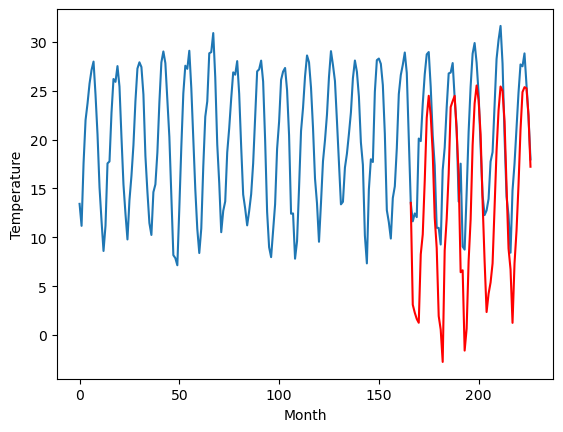

Weather Station 6:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
2.73		-0.74		-3.47
0.70		-1.57		-2.27
0.04		-2.22		-2.26
-0.48		-2.60		-2.12
6.87		4.40		-2.47
9.66		6.45		-3.21
14.85		11.93		-2.92
17.57		18.37		0.80
20.27		20.64		0.37
20.12		18.62		-1.50
12.59		14.78		2.19
9.75		8.16		-1.59
6.03		5.06		-0.97
-0.72		-1.90		-1.18
-2.23		-3.29		-1.06
-1.85		-6.60		-4.75
5.49		4.80		-0.69
7.76		8.05		0.29
13.35		12.64		-0.71
17.62		19.49		1.87
16.96		20.09		3.13
16.37		20.62		4.25
16.01		16.97		0.96
11.69		12.54		0.85
5.22		2.58		-2.64
5.48		2.78		-2.70
-1.84		-5.43		-3.59
-1.95		-3.18		-1.23
5.00		3.76		-1.24
11.91		7.99		-3.92
17.31		15.59		-1.72
19.37		19.85		0.48
20.29		21.69		1.40
17.44		20.20		2.76
14.39		16.69		2.30
8.31		9.80		1.49
1.35		3.77		2.42
0.23		-1.47		-1.70
0.69		0.40		-0.29
0.83		1.55		0.72
5.89		3.49		-2.40
9.05		9.22		0.17
13.66		15.03		1.37
20.35		19.15		-1.20
21.45		21.59		0.14
20.64		21.13		0.49
18.36		18.02		-0.34
10.76		11.40		0.64
4

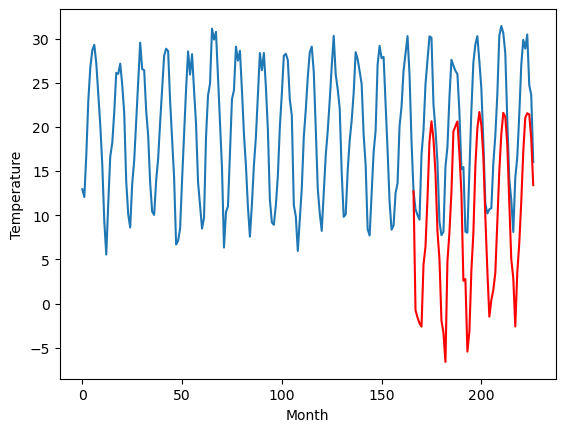

Weather Station 7:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
1.75		1.72		-0.03
1.02		0.90		-0.12
0.21		0.24		0.03
0.28		-0.14		-0.42
5.95		6.86		0.91
7.58		8.91		1.33
10.36		14.38		4.02
15.03		20.82		5.79
18.21		23.09		4.88
16.58		21.07		4.49
13.16		17.23		4.07
9.67		10.62		0.95
5.52		7.51		1.99
-1.69		0.55		2.24
-1.89		-0.84		1.05
-1.11		-4.14		-3.03
5.17		7.26		2.09
7.74		10.50		2.76
11.51		15.09		3.58
15.52		21.94		6.42
16.88		22.54		5.66
17.14		23.07		5.93
13.81		19.42		5.61
9.86		14.99		5.13
2.26		5.03		2.77
3.78		5.23		1.45
-2.61		-2.99		-0.38
1.20		-0.75		-1.95
5.04		6.18		1.14
7.80		10.41		2.61
13.72		18.02		4.30
17.30		22.28		4.98
18.04		24.12		6.08
16.54		22.63		6.09
13.65		19.12		5.47
7.31		12.23		4.92
4.42		6.20		1.78
-1.59		0.96		2.55
0.54		2.83		2.29
4.13		3.98		-0.15
4.80		5.92		1.12
8.06		11.65		3.59
11.06		17.45		6.39
14.34		21.58		7.24
17.79		24.01		6.22
17.37		23.56		6.19
14.20		20.45		6.25
9.19		13.83		4.64
3.50		7.44		3.94
0.76		5.

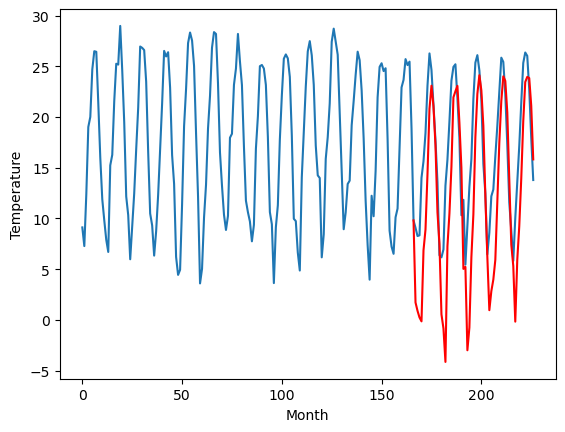

Weather Station 8:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
6.51		5.61		-0.90
5.89		4.80		-1.09
5.04		4.13		-0.91
5.72		3.75		-1.97
12.64		10.75		-1.89
13.78		12.80		-0.98
18.28		18.28		-0.00
23.84		24.71		0.87
26.38		26.99		0.61
24.36		24.97		0.61
21.06		21.13		0.07
14.29		14.51		0.22
10.62		11.40		0.78
4.02		4.44		0.42
3.71		3.05		-0.66
0.71		-0.25		-0.96
12.03		11.15		-0.88
13.74		14.39		0.65
18.40		18.98		0.58
24.48		25.82		1.34
25.47		26.43		0.96
26.69		26.96		0.27
22.98		23.31		0.33
17.78		18.88		1.10
8.48		8.92		0.44
10.89		9.11		-1.78
2.06		0.90		-1.16
4.11		3.14		-0.97
10.06		10.08		0.02
15.25		14.31		-0.94
20.72		21.92		1.20
24.78		26.18		1.40
28.91		28.02		-0.89
26.04		26.52		0.48
22.20		23.01		0.81
15.53		16.12		0.59
8.93		10.09		1.16
5.19		4.85		-0.34
6.38		6.72		0.34
7.88		7.87		-0.01
10.71		9.81		-0.90
15.11		15.53		0.42
20.46		21.34		0.88
24.27		25.47		1.20
26.57		27.91		1.34
27.07		27.45		0.38
23.45		24.34		0.89
17.14		17.71		0.57
9.7

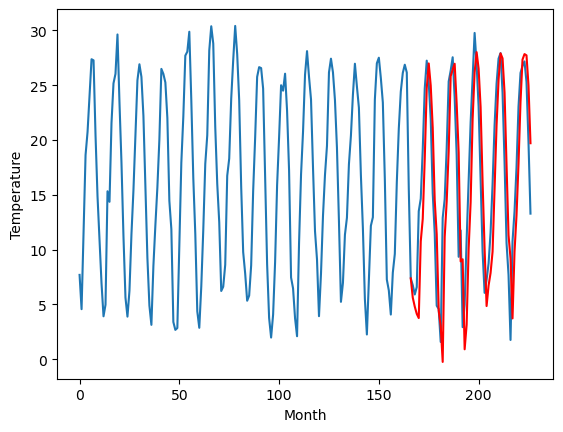

Weather Station 9:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
6.17		4.34		-1.83
4.32		3.51		-0.81
4.50		2.85		-1.65
3.99		2.47		-1.52
11.82		9.48		-2.34
13.20		11.53		-1.67
19.31		17.01		-2.30
24.42		23.45		-0.97
26.96		25.72		-1.24
26.03		23.71		-2.32
19.38		19.87		0.49
13.20		13.25		0.05
10.32		10.14		-0.18
3.64		3.18		-0.46
3.29		1.79		-1.50
-1.49		-1.52		-0.03
11.07		9.89		-1.18
12.87		13.13		0.26
17.68		17.72		0.04
23.71		24.56		0.85
25.22		25.16		-0.06
25.61		25.69		0.08
23.10		22.04		-1.06
16.85		17.61		0.76
9.10		7.65		-1.45
8.29		7.86		-0.43
0.67		-0.35		-1.02
1.65		1.90		0.25
8.90		8.84		-0.06
16.01		13.09		-2.92
21.37		20.69		-0.68
25.66		24.95		-0.71
29.81		26.78		-3.03
27.14		25.29		-1.85
23.31		21.79		-1.52
15.08		14.89		-0.19
7.23		8.86		1.63
3.60		3.61		0.01
4.46		5.49		1.03
4.83		6.64		1.81
9.26		8.58		-0.68
13.59		14.31		0.72
19.28		20.12		0.84
24.21		24.25		0.04
27.09		26.68		-0.41
28.90		26.23		-2.67
24.26		23.11		-1.15
15.68		16.48	

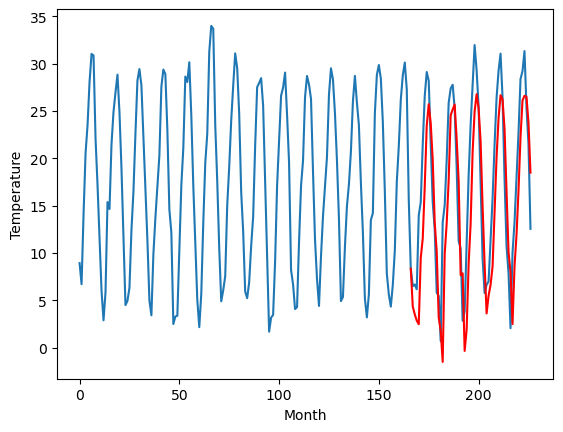

Weather Station 10:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
8.70		3.88		-4.82
7.34		3.04		-4.30
6.89		2.38		-4.51
5.65		2.01		-3.64
13.61		9.02		-4.59
15.92		11.07		-4.85
22.45		16.56		-5.89
28.83		23.01		-5.82
30.41		25.28		-5.13
29.18		23.26		-5.92
22.43		19.41		-3.02
15.83		12.79		-3.04
12.65		9.69		-2.96
5.38		2.72		-2.66
5.49		1.34		-4.15
1.12		-1.98		-3.10
11.83		9.43		-2.40
15.59		12.68		-2.91
20.14		17.27		-2.87
27.25		24.10		-3.15
27.92		24.71		-3.21
27.77		25.23		-2.54
25.82		21.59		-4.23
18.38		17.16		-1.22
12.13		7.20		-4.93
10.52		7.40		-3.12
3.60		-0.80		-4.40
3.66		1.45		-2.21
10.59		8.40		-2.19
17.07		12.66		-4.41
22.52		20.26		-2.26
27.09		24.52		-2.57
30.69		26.35		-4.34
27.86		24.85		-3.01
25.45		21.35		-4.10
16.91		14.46		-2.45
7.92		8.43		0.51
5.57		3.18		-2.39
5.85		5.06		-0.79
7.00		6.21		-0.79
10.73		8.14		-2.59
16.08		13.87		-2.21
21.19		19.69		-1.50
24.42		23.82		-0.60
29.04		26.25		-2.79
29.44		25.80		-3.64
25.92		22.68		-3

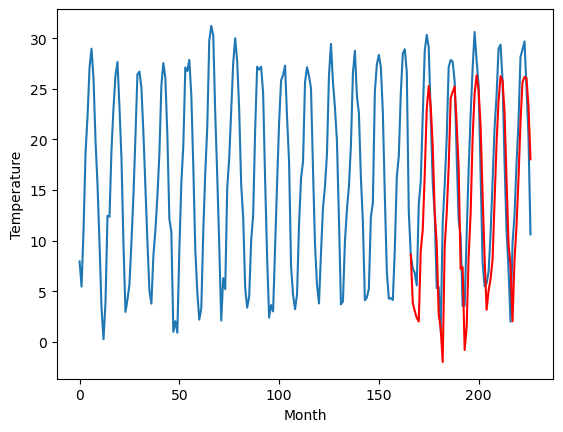

Weather Station 11:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-0.40		0.03		0.43
-3.21		-0.80		2.41
-2.87		-1.46		1.41
-2.13		-1.84		0.29
2.19		5.17		2.98
3.82		7.23		3.41
9.28		12.70		3.42
16.60		19.15		2.55
20.47		21.42		0.95
18.28		19.41		1.13
13.75		15.55		1.80
8.21		8.93		0.72
4.01		5.83		1.82
-3.00		-1.13		1.87
-4.84		-2.52		2.32
-5.80		-5.82		-0.02
1.42		5.57		4.15
6.07		8.82		2.75
10.61		13.42		2.81
16.70		20.26		3.56
18.93		20.87		1.94
18.71		21.41		2.70
15.01		17.77		2.76
10.59		13.34		2.75
1.27		3.38		2.11
0.50		3.58		3.08
-6.52		-4.63		1.89
-2.62		-2.39		0.23
1.94		4.55		2.61
5.29		8.80		3.51
12.27		16.41		4.14
16.66		20.67		4.01
20.60		22.50		1.90
20.06		21.01		0.95
15.15		17.52		2.37
7.05		10.64		3.59
3.54		4.61		1.07
-3.61		-0.64		2.97
-0.65		1.24		1.89
-0.97		2.39		3.36
0.15		4.33		4.18
7.37		10.05		2.68
9.93		15.86		5.93
14.30		19.98		5.68
19.44		22.42		2.98
17.70		21.96		4.26
14.51		18.85		4.34
9.16		12.22		3.06
1.22		5.81		4.59
-0.47	

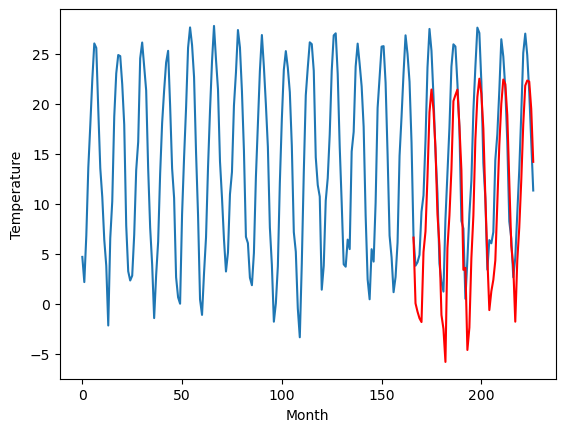

RangeIndex(start=1, stop=12, step=1)
[-0.6800000000000015, -0.9899999999999993, -0.9000000000000021, 1.1899999999999986, 5.599999999999998, 2.730000000000003, 1.7500000000000018, 6.510000000000002, 6.17, 8.7, -0.40000000000000036]
[0.02146827697753828, -1.412093696594238, -0.17124015808105497, -1.1394768142700196, 3.1037952423095696, -0.7418331146240238, 1.7200177383422854, 5.61437412261963, 4.337093276977539, 3.875648689270019, 0.03333007812499922]
Predictions for (t+0):
    Weather_Station  Actual  Predicted
0                 0   -0.68   0.021468
1                 1   -0.99  -1.412094
2                 2   -0.90  -0.171240
3                 3    1.19  -1.139477
4                 4    5.60   3.103795
5                 5    2.73  -0.741833
6                 6    1.75   1.720018
7                 7    6.51   5.614374
8                 8    6.17   4.337093
9                 9    8.70   3.875649
10               10   -0.40   0.033330


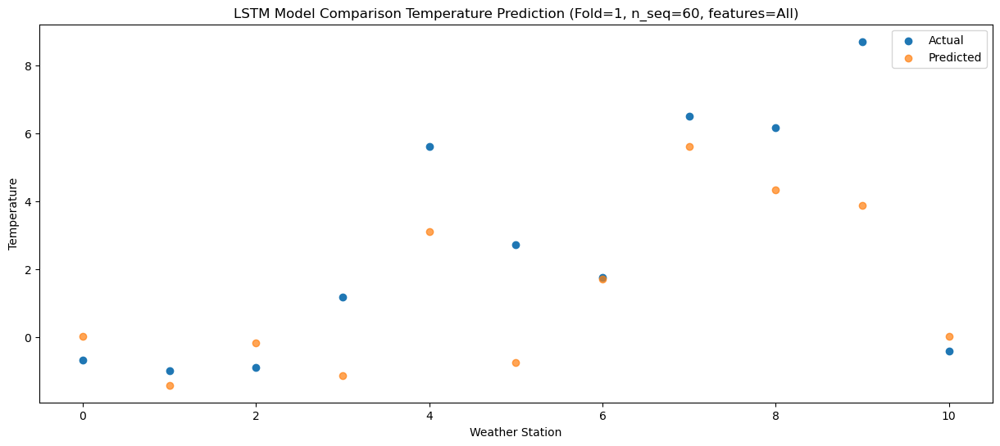

Predictions for (t+1):
    Weather_Station  Actual  Predicted
0                 0   -0.15  -0.790200
1                 1   -1.90  -2.227923
2                 2   -0.47  -0.985979
3                 3   -0.23  -1.950407
4                 4    3.71   2.291479
5                 5    0.70  -1.566686
6                 6    1.02   0.899839
7                 7    5.89   4.795683
8                 8    4.32   3.511107
9                 9    7.34   3.044490
10               10   -3.21  -0.796436


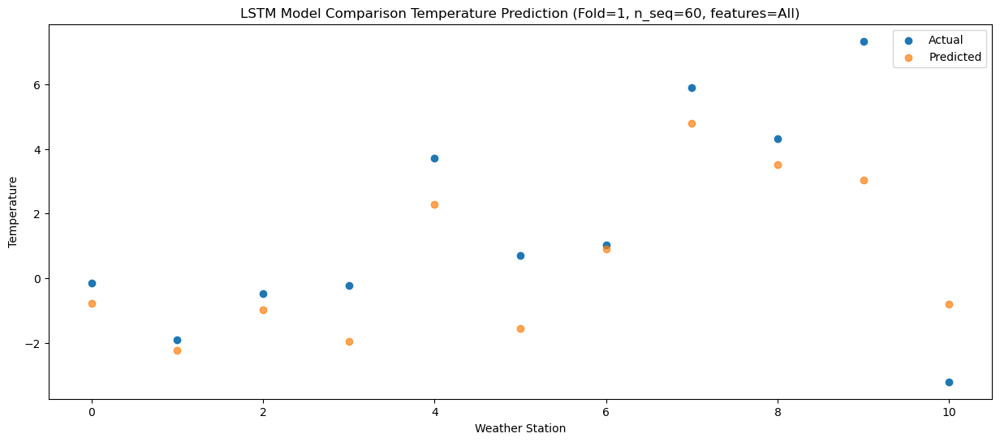

Predictions for (t+2):
    Weather_Station  Actual  Predicted
0                 0   -0.26  -1.453709
1                 1   -3.01  -2.890763
2                 2   -1.00  -1.645271
3                 3    0.52  -2.602031
4                 4    4.52   1.643603
5                 5    0.04  -2.216600
6                 6    0.21   0.240325
7                 7    5.04   4.133326
8                 8    4.50   2.850553
9                 9    6.89   2.383617
10               10   -2.87  -1.464786


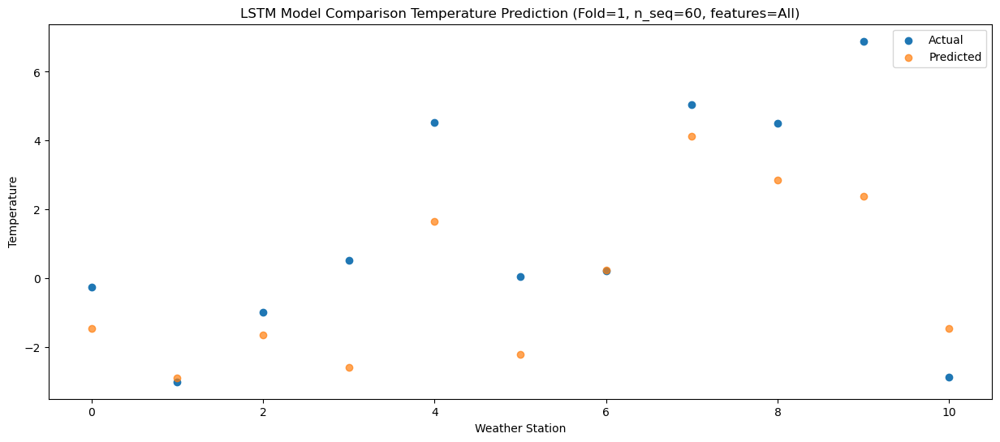

Predictions for (t+3):
    Weather_Station  Actual  Predicted
0                 0   -0.40  -1.826516
1                 1   -2.92  -3.261627
2                 2   -0.72  -2.020800
3                 3   -0.01  -2.989400
4                 4    4.14   1.256159
5                 5   -0.48  -2.599078
6                 6    0.28  -0.140971
7                 7    5.72   3.749054
8                 8    3.99   2.469514
9                 9    5.65   2.007612
10               10   -2.13  -1.836194


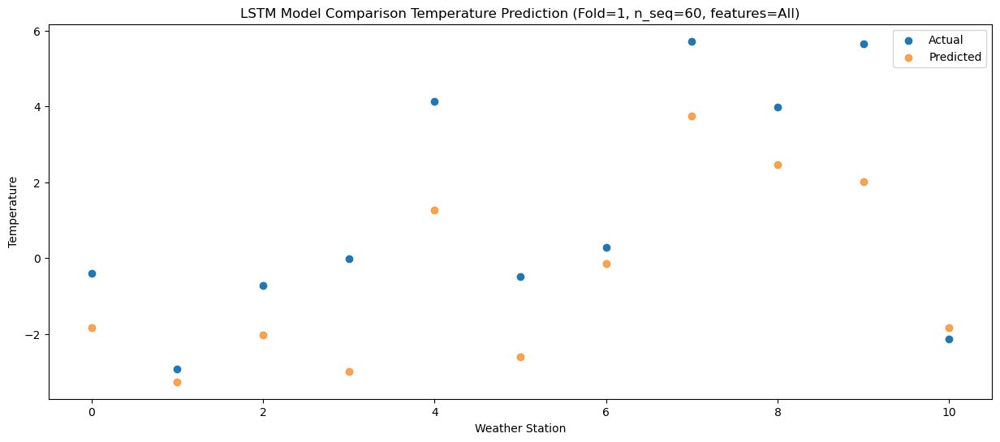

Predictions for (t+4):
    Weather_Station  Actual  Predicted
0                 0    4.66   5.182815
1                 1    3.08   3.746185
2                 2    6.38   4.984245
3                 3    7.63   4.013880
4                 4   12.18   8.256895
5                 5    6.87   4.401588
6                 6    5.95   6.858562
7                 7   12.64  10.750373
8                 8   11.82   9.476528
9                 9   13.61   9.015923
10               10    2.19   5.167170


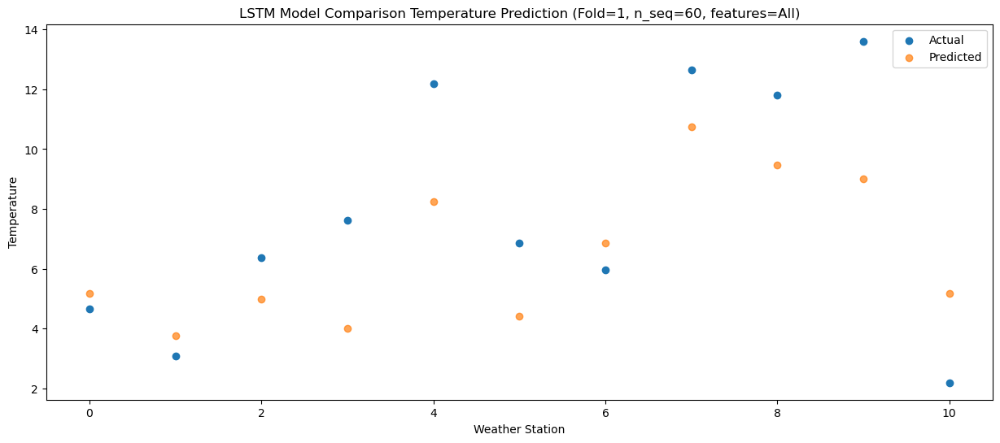

Predictions for (t+5):
    Weather_Station  Actual  Predicted
0                 0    6.15   7.237809
1                 1    4.30   5.801762
2                 2    5.41   7.031771
3                 3    7.51   6.056368
4                 4   11.92  10.291123
5                 5    9.66   6.447326
6                 6    7.58   8.905660
7                 7   13.78  12.797348
8                 8   13.20  11.527162
9                 9   15.92  11.074688
10               10    3.82   7.228762


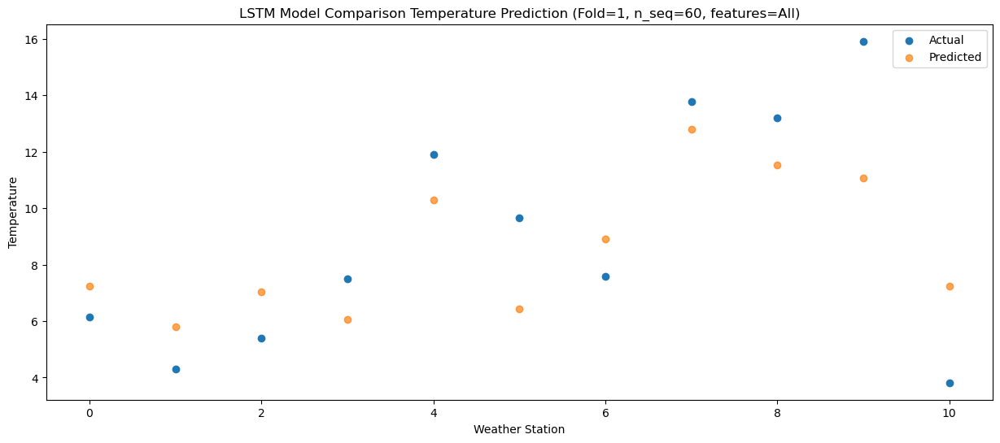

Predictions for (t+6):
    Weather_Station  Actual  Predicted
0                 0    9.23  12.720183
1                 1    7.65  11.278855
2                 2    9.56  12.506775
3                 3   11.26  11.534483
4                 4   15.72  15.770365
5                 5   14.85  11.929435
6                 6   10.36  14.380980
7                 7   18.28  18.276639
8                 8   19.31  17.010990
9                 9   22.45  16.562817
10               10    9.28  12.704771


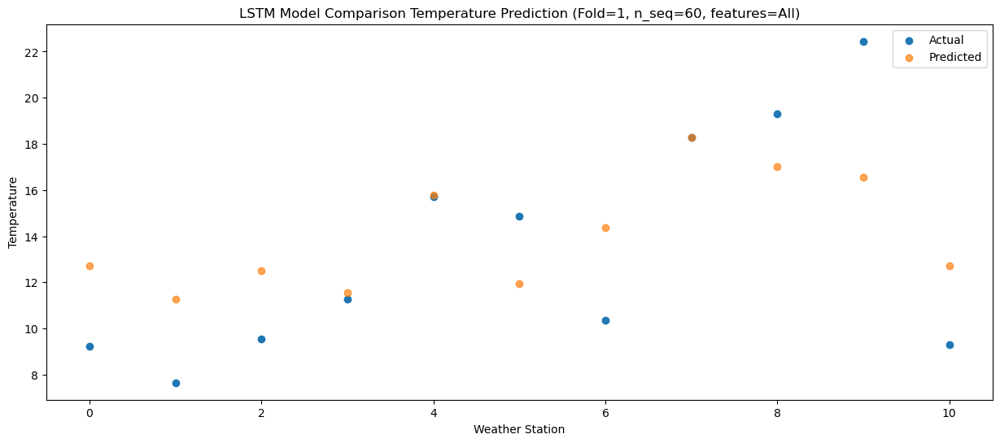

Predictions for (t+7):
    Weather_Station  Actual  Predicted
0                 0   12.23  19.154868
1                 1   12.00  17.710816
2                 2   13.79  18.938360
3                 3   14.04  17.971596
4                 4   18.75  22.211539
5                 5   17.57  18.365904
6                 6   15.03  20.817027
7                 7   23.84  24.710435
8                 8   24.42  23.449454
9                 9   28.83  23.005732
10               10   16.60  19.146806


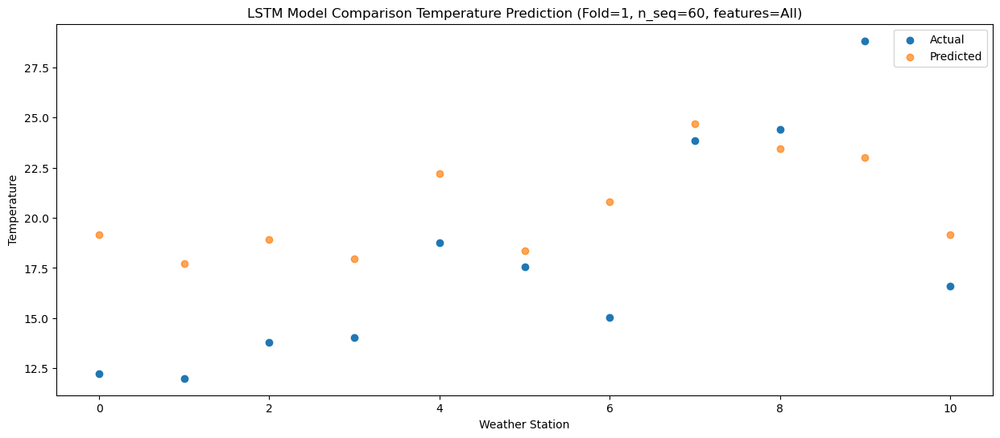

Predictions for (t+8):
    Weather_Station  Actual  Predicted
0                 0   15.18  21.421003
1                 1   15.37  19.979657
2                 2   15.26  21.207101
3                 3   15.69  20.236306
4                 4   20.79  24.475245
5                 5   20.27  20.636145
6                 6   18.21  23.090056
7                 7   26.38  26.986193
8                 8   26.96  25.723784
9                 9   30.41  25.281548
10               10   20.47  21.420351


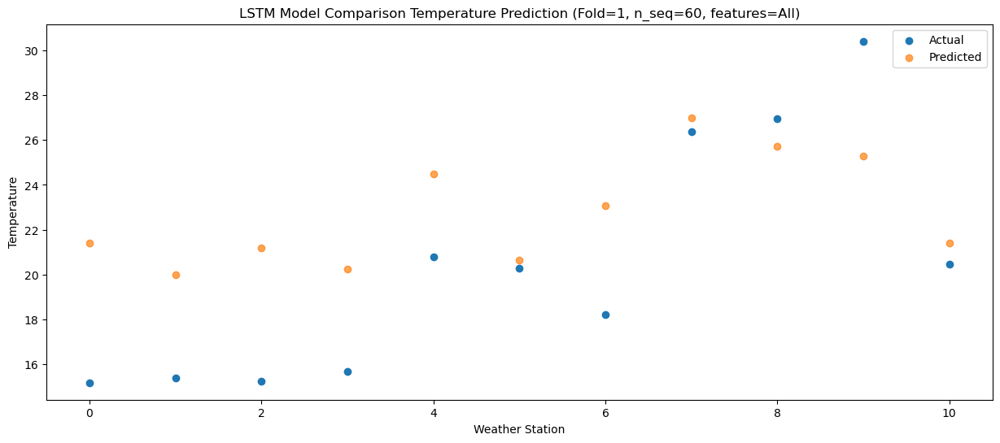

Predictions for (t+9):
    Weather_Station  Actual  Predicted
0                 0   14.34  19.397841
1                 1   13.96  17.959918
2                 2   15.25  19.187926
3                 3   15.93  18.223280
4                 4   21.03  22.464709
5                 5   20.12  18.620900
6                 6   16.58  21.073543
7                 7   24.36  24.969930
8                 8   26.03  23.711202
9                 9   29.18  23.264148
10               10   18.28  19.411019


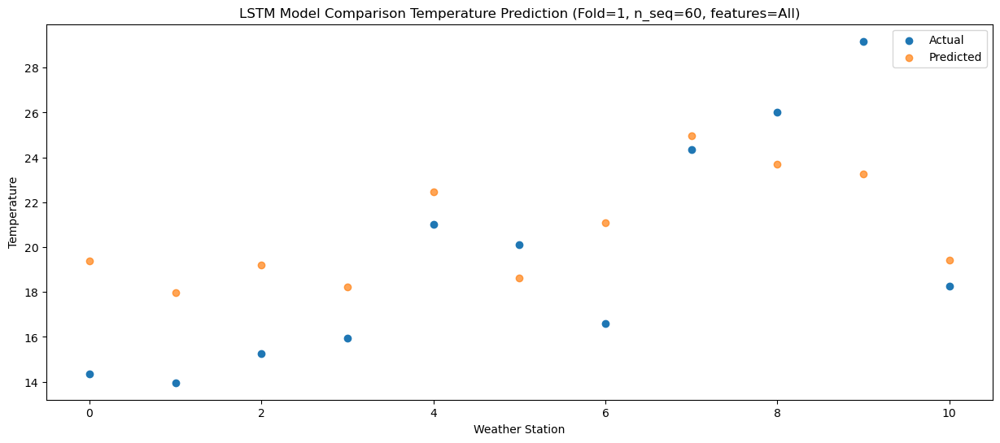

Predictions for (t+10):
    Weather_Station  Actual  Predicted
0                 0   11.72  15.549933
1                 1   10.42  14.111151
2                 2   12.45  15.344474
3                 3   12.52  14.383808
4                 4   17.45  18.628758
5                 5   12.59  14.781370
6                 6   13.16  17.230392
7                 7   21.06  21.128921
8                 8   19.38  19.868576
9                 9   22.43  19.414444
10               10   13.75  15.550977


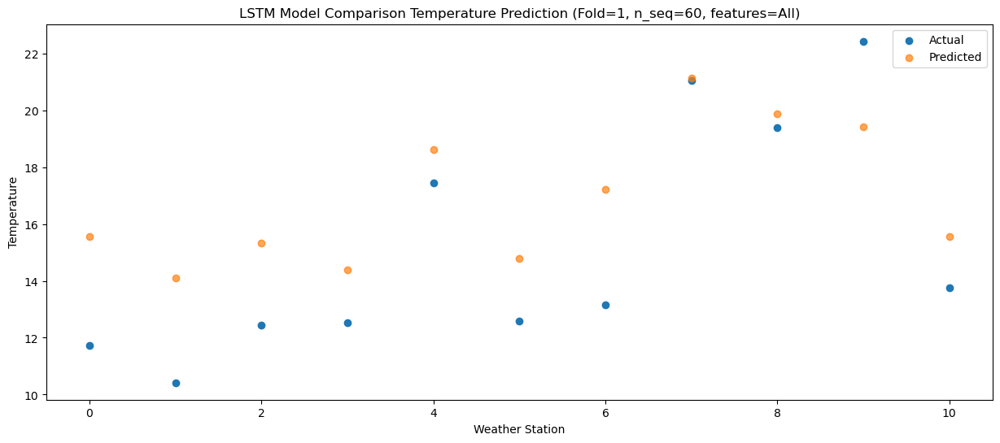

Predictions for (t+11):
    Weather_Station  Actual  Predicted
0                 0    8.79   8.921049
1                 1    6.70   7.484438
2                 2    8.10   8.718843
3                 3    7.98   7.764813
4                 4   12.51  12.014331
5                 5    9.75   8.164537
6                 6    9.67  10.615527
7                 7   14.29  14.506260
8                 8   13.20  13.247824
9                 9   15.83  12.788783
10               10    8.21   8.927875


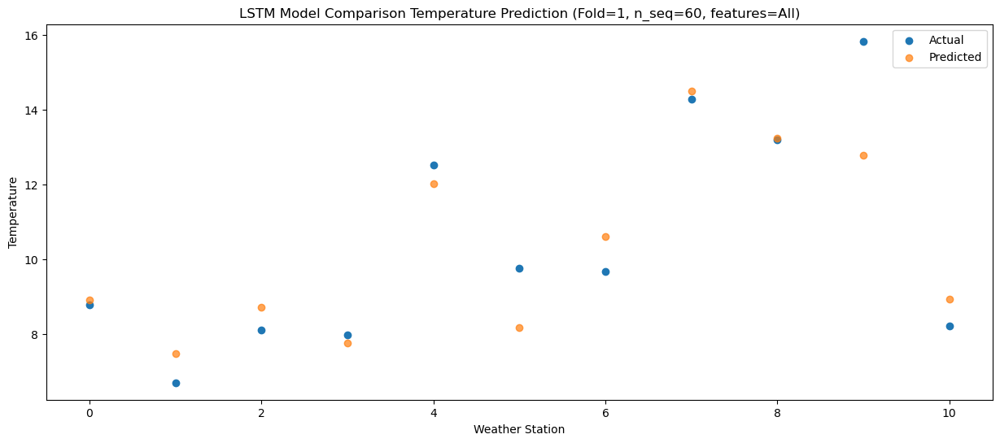

Predictions for (t+12):
    Weather_Station  Actual  Predicted
0                 0    4.89   5.815486
1                 1    2.60   4.380848
2                 2    3.30   5.608335
3                 3    5.08   4.649965
4                 4    9.41   8.898139
5                 5    6.03   5.056279
6                 6    5.52   7.510069
7                 7   10.62  11.397681
8                 8   10.32  10.143149
9                 9   12.65   9.686414
10               10    4.01   5.830312


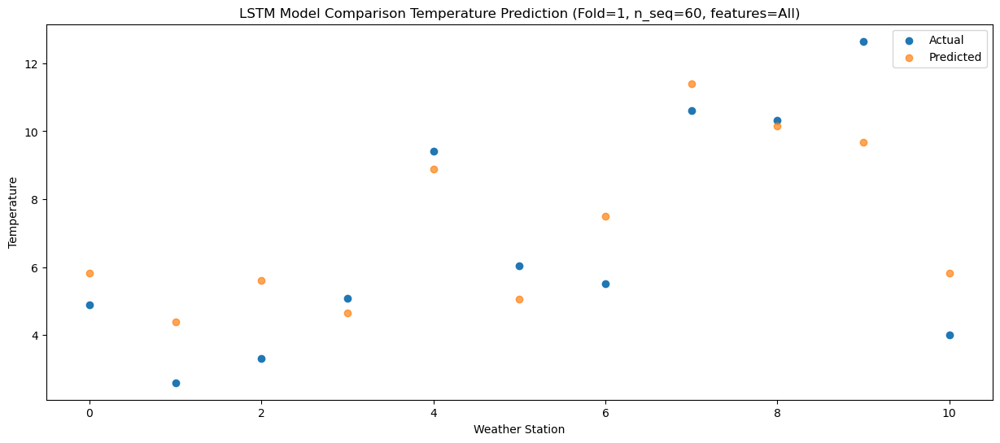

Predictions for (t+13):
    Weather_Station  Actual  Predicted
0                 0   -2.95  -1.147689
1                 1   -4.29  -2.579997
2                 2   -3.76  -1.354269
3                 3   -1.10  -2.308336
4                 4    3.05   1.940144
5                 5   -0.72  -1.904864
6                 6   -1.69   0.551111
7                 7    4.02   4.437000
8                 8    3.64   3.180483
9                 9    5.38   2.722882
10               10   -3.00  -1.129194


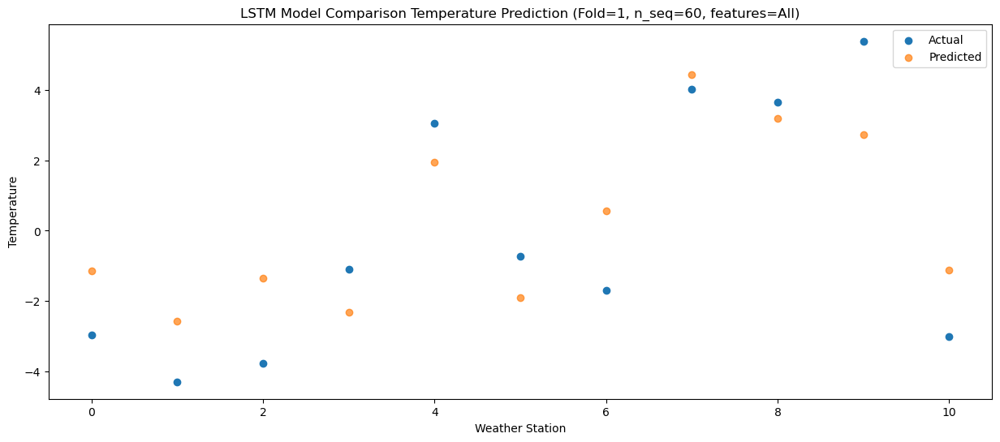

Predictions for (t+14):
    Weather_Station  Actual  Predicted
0                 0   -2.53  -2.530634
1                 1   -4.49  -3.963988
2                 2   -3.34  -2.740521
3                 3   -1.20  -3.690855
4                 4    3.04   0.556740
5                 5   -2.23  -3.290545
6                 6   -1.89  -0.836741
7                 7    3.71   3.050826
8                 8    3.29   1.794186
9                 9    5.49   1.337100
10               10   -4.84  -2.515712


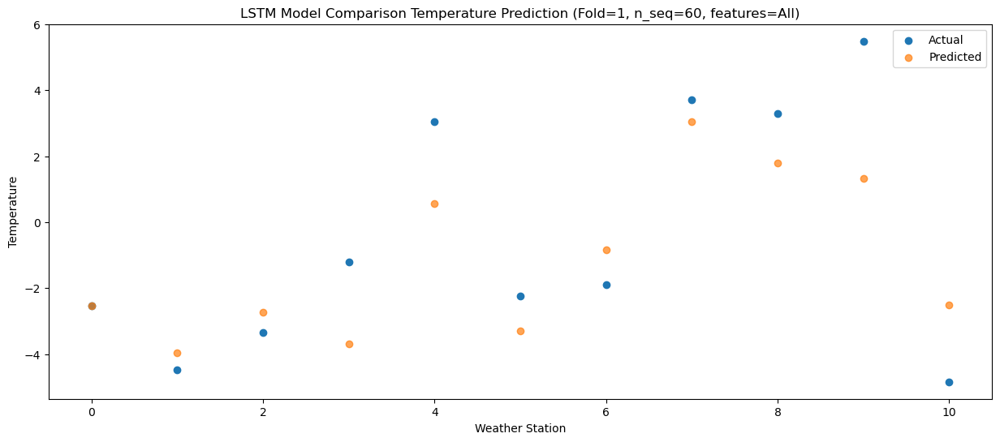

Predictions for (t+15):
    Weather_Station  Actual  Predicted
0                 0   -2.31  -5.839863
1                 1   -3.83  -7.273818
2                 2   -2.85  -6.046982
3                 3   -2.79  -6.998121
4                 4    1.34  -2.748678
5                 5   -1.85  -6.596940
6                 6   -1.11  -4.138497
7                 7    0.71  -0.253359
8                 8   -1.49  -1.516027
9                 9    1.12  -1.975564
10               10   -5.80  -5.823405


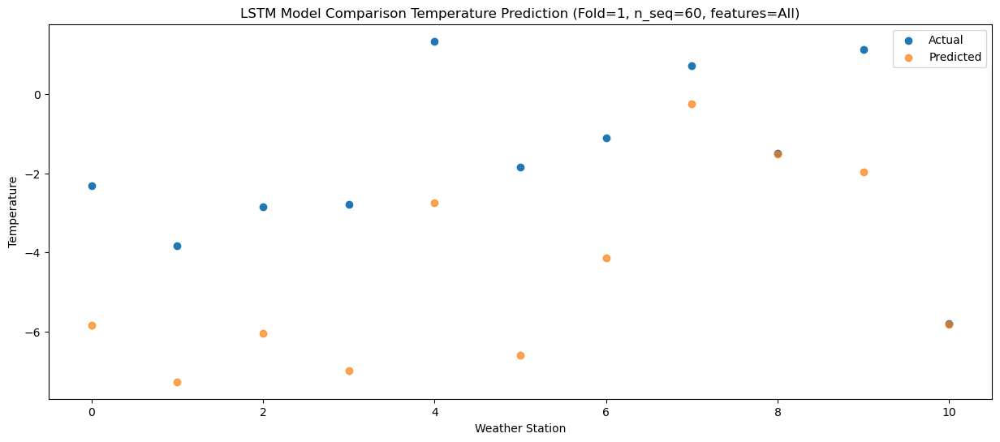

Predictions for (t+16):
    Weather_Station  Actual  Predicted
0                 0    2.67   5.549280
1                 1    2.94   4.115881
2                 2    4.21   5.343143
3                 3    4.58   4.398329
4                 4    8.95   8.652893
5                 5    5.49   4.803060
6                 6    5.17   7.261236
7                 7   12.03  11.148830
8                 8   11.07   9.887167
9                 9   11.83   9.426763
10               10    1.42   5.573734


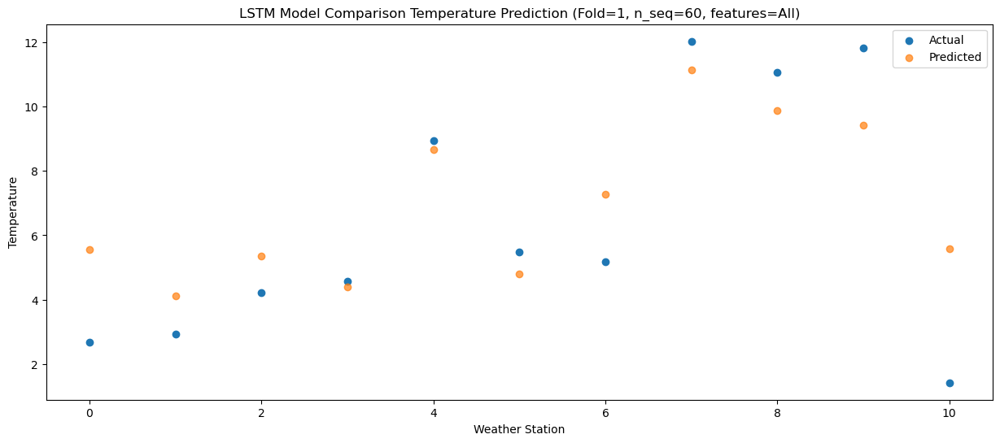

Predictions for (t+17):
    Weather_Station  Actual  Predicted
0                 0    5.48   8.788571
1                 1    5.08   7.351836
2                 2    5.61   8.573582
3                 3    6.92   7.629008
4                 4   11.25  11.890266
5                 5    7.76   8.048190
6                 6    7.74  10.500510
7                 7   13.74  14.390011
8                 8   12.87  13.132663
9                 9   15.59  12.676419
10               10    6.07   8.823177


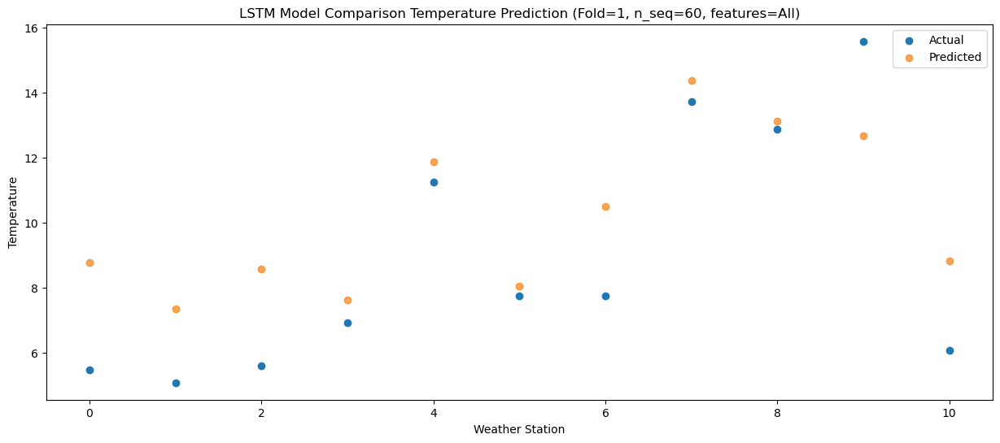

Predictions for (t+18):
    Weather_Station  Actual  Predicted
0                 0    9.09  13.372628
1                 1    8.81  11.943413
2                 2    9.73  13.164813
3                 3   10.81  12.221652
4                 4   15.37  16.483111
5                 5   13.35  12.642045
6                 6   11.51  15.094278
7                 7   18.40  18.980377
8                 8   17.68  17.722765
9                 9   20.14  17.266231
10               10   10.61  13.421611


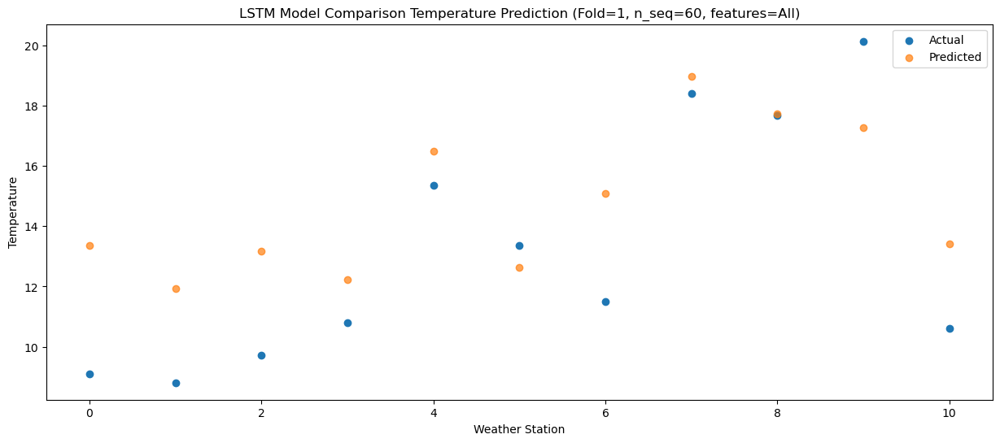

Predictions for (t+19):
    Weather_Station  Actual  Predicted
0                 0   12.58  20.216188
1                 1   12.95  18.788525
2                 2   13.61  20.006220
3                 3   14.70  19.061977
4                 4   18.84  23.325834
5                 5   17.62  19.488175
6                 6   15.52  21.941177
7                 7   24.48  25.821652
8                 8   23.71  24.560564
9                 9   27.25  24.100469
10               10   16.70  20.264099


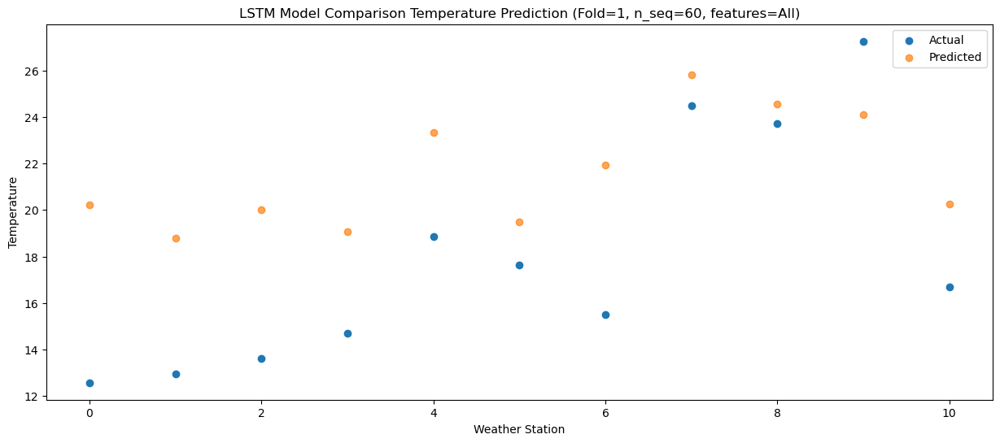

Predictions for (t+20):
    Weather_Station  Actual  Predicted
0                 0   13.78  20.822067
1                 1   14.33  19.389467
2                 2   14.38  20.606931
3                 3   14.58  19.666378
4                 4   18.93  23.928987
5                 5   16.96  20.086210
6                 6   16.88  22.539414
7                 7   25.47  26.425309
8                 8   25.22  25.162764
9                 9   27.92  24.706929
10               10   18.93  20.871578


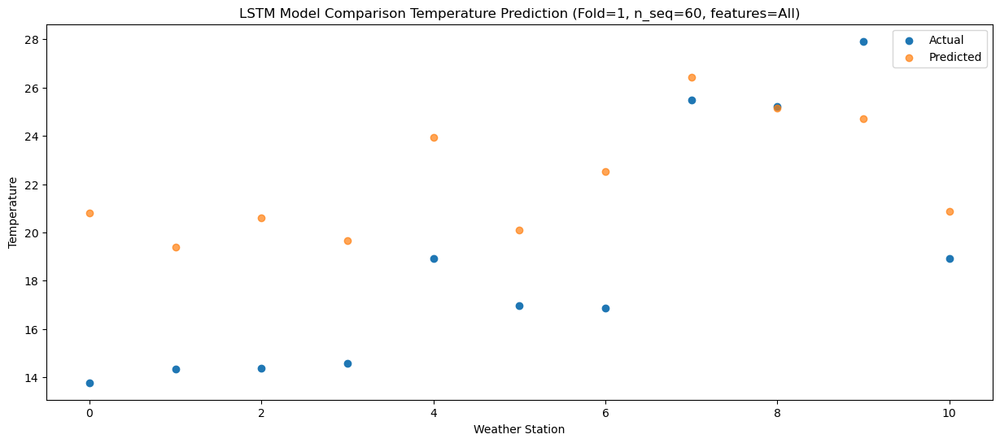

Predictions for (t+21):
    Weather_Station  Actual  Predicted
0                 0   13.89  21.364875
1                 1   14.60  19.927040
2                 2   15.04  21.141700
3                 3   15.55  20.205693
4                 4   19.90  24.469813
5                 5   16.37  20.620031
6                 6   17.14  23.073357
7                 7   26.69  26.960208
8                 8   25.61  25.690649
9                 9   27.77  25.228486
10               10   18.71  21.410259


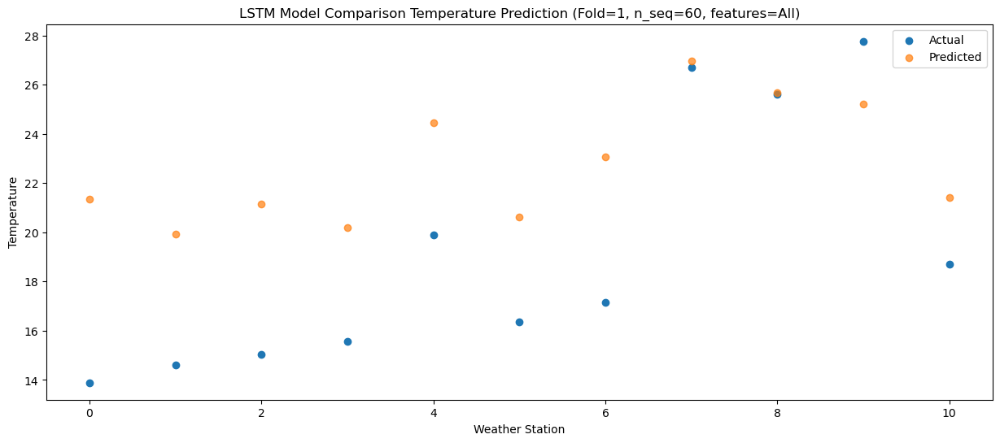

Predictions for (t+22):
    Weather_Station  Actual  Predicted
0                 0   11.24  17.717297
1                 1   10.86  16.275658
2                 2   12.02  17.489521
3                 3   12.54  16.552147
4                 4   16.32  20.819348
5                 5   16.01  16.971903
6                 6   13.81  19.421807
7                 7   22.98  23.311276
8                 8   23.10  22.043186
9                 9   25.82  21.585191
10               10   15.01  17.767040


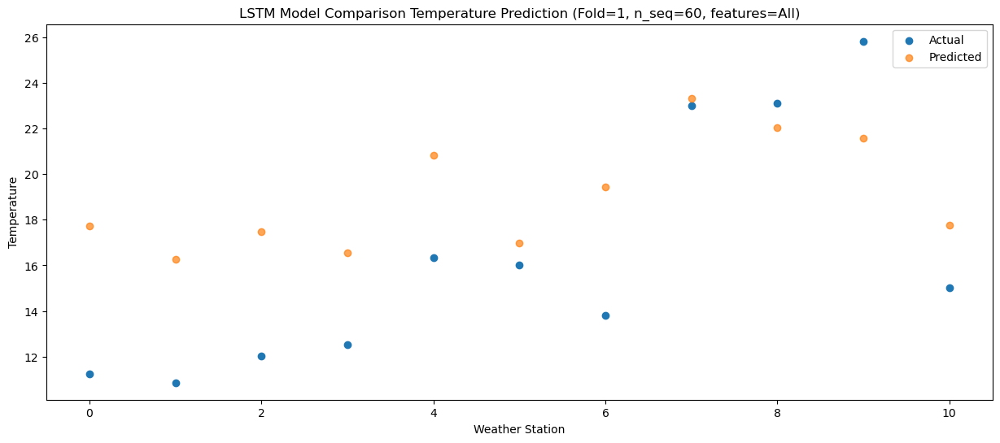

Predictions for (t+23):
    Weather_Station  Actual  Predicted
0                 0    7.54  13.282129
1                 1    7.08  11.843738
2                 2    8.24  13.056976
3                 3    9.85  12.117874
4                 4   13.28  16.382982
5                 5   11.69  12.538980
6                 6    9.86  14.989817
7                 7   17.78  18.880165
8                 8   16.85  17.614460
9                 9   18.38  17.161760
10               10   10.59  13.342649


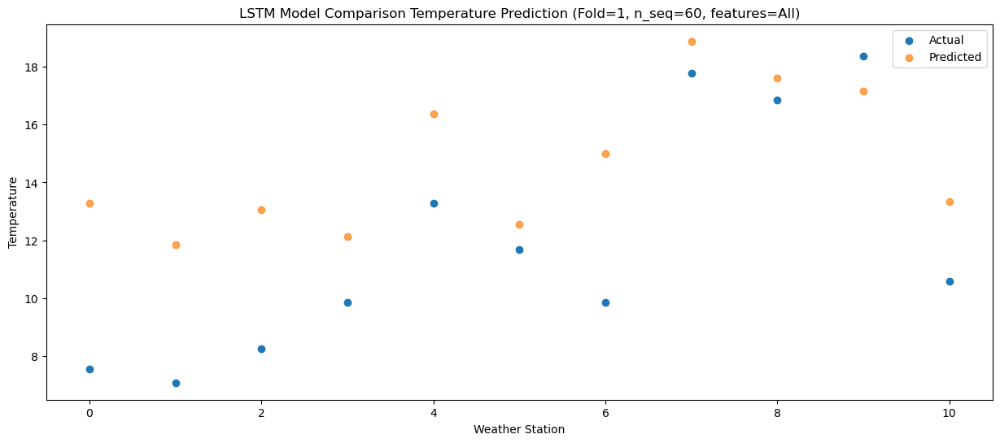

Predictions for (t+24):
    Weather_Station  Actual  Predicted
0                 0   -0.67   3.325315
1                 1   -0.58   1.885238
2                 2    0.50   3.095579
3                 3    2.69   2.160506
4                 4    5.73   6.426221
5                 5    5.22   2.581928
6                 6    2.26   5.031503
7                 7    8.48   8.917857
8                 8    9.10   7.653955
9                 9   12.13   7.198374
10               10    1.27   3.381994


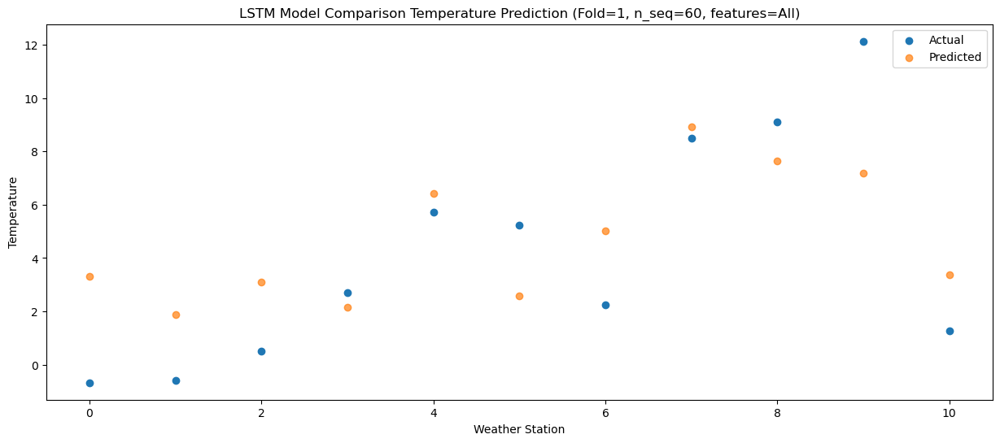

Predictions for (t+25):
    Weather_Station  Actual  Predicted
0                 0    1.68   3.508132
1                 1    1.05   2.069715
2                 2    3.10   3.283978
3                 3    6.06   2.352881
4                 4    9.61   6.624785
5                 5    5.48   2.780552
6                 6    3.78   5.227927
7                 7   10.89   9.114603
8                 8    8.29   7.855546
9                 9   10.52   7.400339
10               10    0.50   3.583446


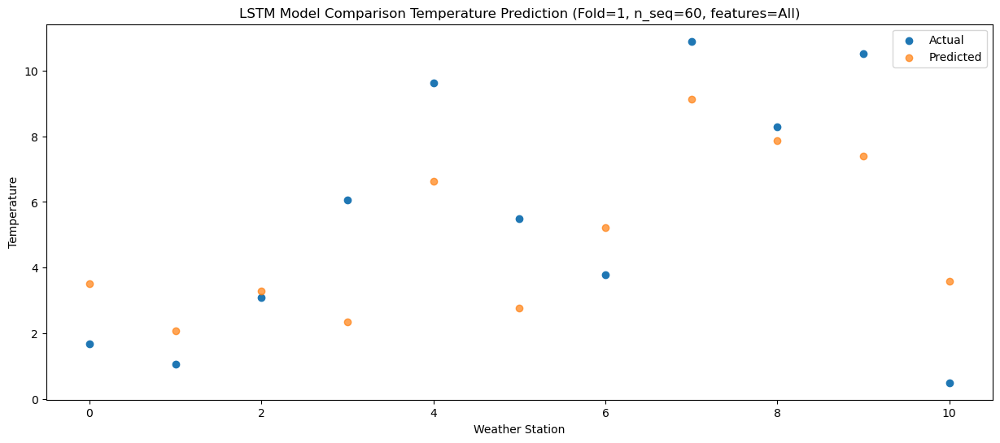

Predictions for (t+26):
    Weather_Station  Actual  Predicted
0                 0   -4.48  -4.720203
1                 1   -5.68  -6.155788
2                 2   -3.79  -4.941641
3                 3   -1.99  -5.862972
4                 4    1.13  -1.589819
5                 5   -1.84  -5.427983
6                 6   -2.61  -2.989751
7                 7    2.06   0.898520
8                 8    0.67  -0.353862
9                 9    3.60  -0.800192
10               10   -6.52  -4.628647


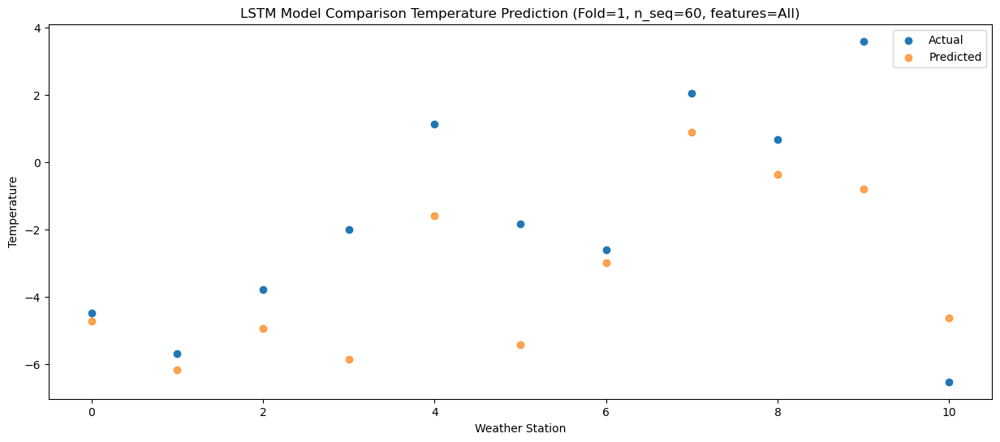

Predictions for (t+27):
    Weather_Station  Actual  Predicted
0                 0    0.36  -2.488610
1                 1   -1.45  -3.924524
2                 2   -0.44  -2.709156
3                 3   -2.46  -3.623415
4                 4    0.82   0.656719
5                 5   -1.95  -3.181547
6                 6    1.20  -0.750658
7                 7    4.11   3.140789
8                 8    1.65   1.896086
9                 9    3.66   1.449130
10               10   -2.62  -2.386203


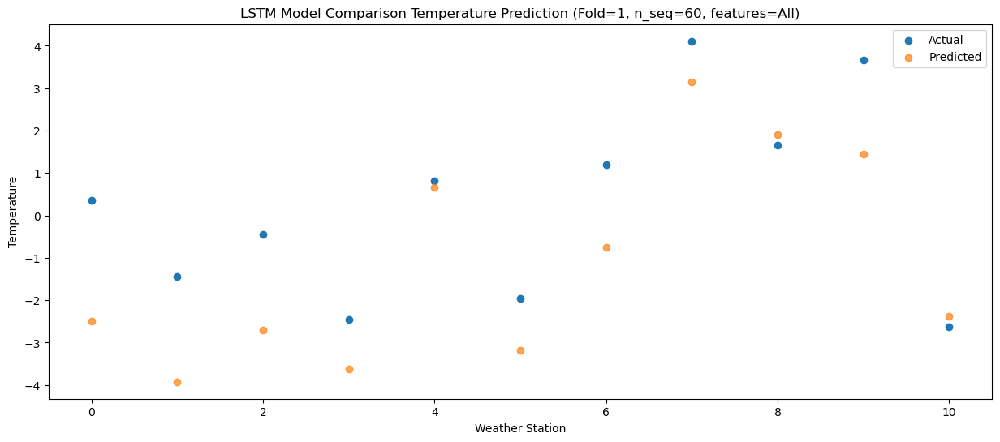

Predictions for (t+28):
    Weather_Station  Actual  Predicted
0                 0    3.75   4.434657
1                 1    2.12   2.998249
2                 2    3.56   4.216634
3                 3    3.38   3.309157
4                 4    6.60   7.594253
5                 5    5.00   3.755140
6                 6    5.04   6.179942
7                 7   10.06  10.078993
8                 8    8.90   8.843749
9                 9   10.59   8.403704
10               10    1.94   4.554360


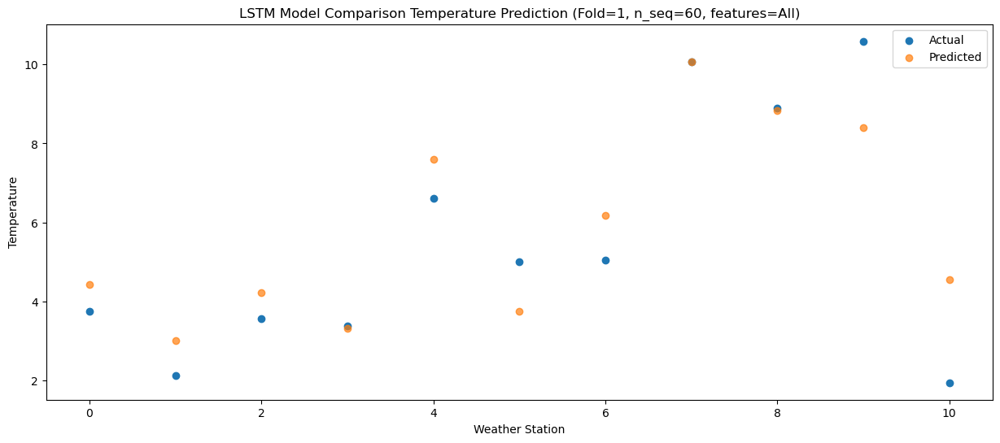

Predictions for (t+29):
    Weather_Station  Actual  Predicted
0                 0    5.74   8.670243
1                 1    5.12   7.230624
2                 2    7.15   8.447206
3                 3    9.38   7.542515
4                 4   12.87  11.827249
5                 5   11.91   7.994280
6                 6    7.80  10.413299
7                 7   15.25  14.314045
8                 8   16.01  13.086350
9                 9   17.07  12.656299
10               10    5.29   8.804018


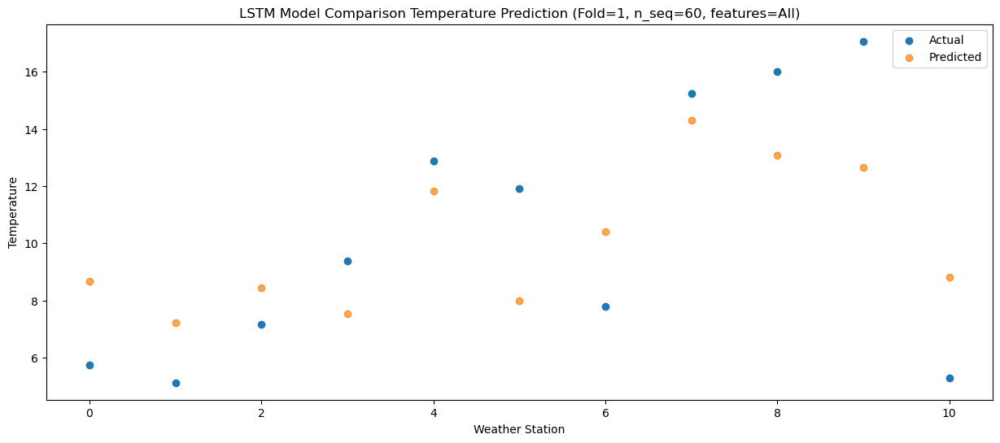

Predictions for (t+30):
    Weather_Station  Actual  Predicted
0                 0   10.99  16.284862
1                 1   11.00  14.843741
2                 2   12.51  16.056075
3                 3   13.81  15.144105
4                 4   17.49  19.426114
5                 5   17.31  15.591747
6                 6   13.72  18.016609
7                 7   20.72  21.916533
8                 8   21.37  20.688298
9                 9   22.52  20.255895
10               10   12.27  16.410530


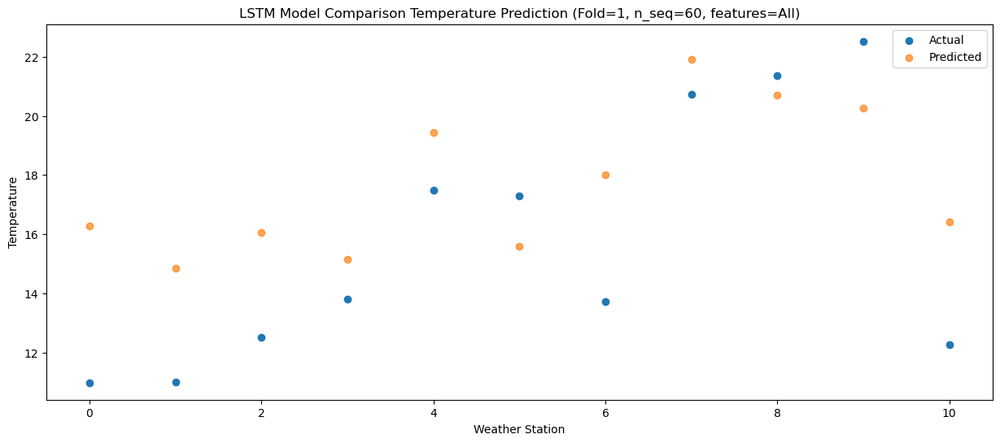

Predictions for (t+31):
    Weather_Station  Actual  Predicted
0                 0   13.49  20.538337
1                 1   14.97  19.100285
2                 2   15.48  20.313965
3                 3   16.81  19.404736
4                 4   20.86  23.685527
5                 5   19.37  19.852492
6                 6   17.30  22.281859
7                 7   24.78  26.178423
8                 8   25.66  24.949435
9                 9   27.09  24.521540
10               10   16.66  20.674003


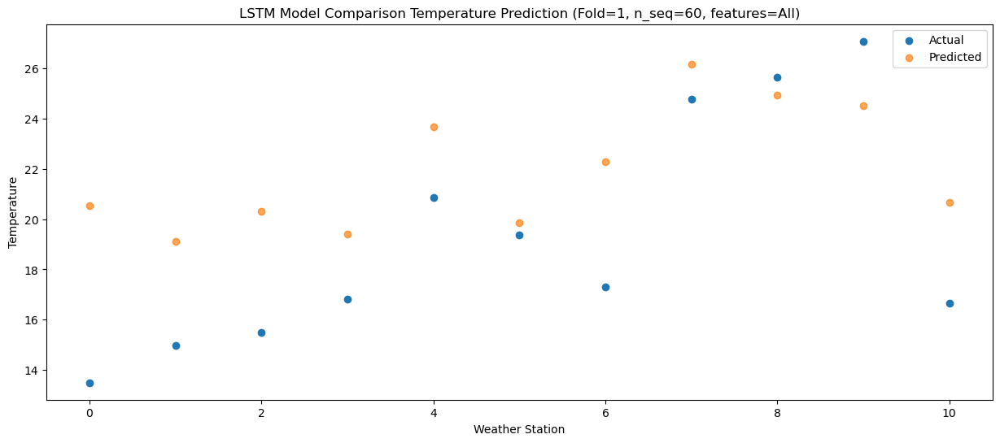

Predictions for (t+32):
    Weather_Station  Actual  Predicted
0                 0   14.39  22.371352
1                 1   15.47  20.936452
2                 2   16.19  22.150012
3                 3   17.75  21.243744
4                 4   21.95  25.527402
5                 5   20.29  21.687933
6                 6   18.04  24.119690
7                 7   28.91  28.015413
8                 8   29.81  26.784071
9                 9   30.69  26.346465
10               10   20.60  22.502733


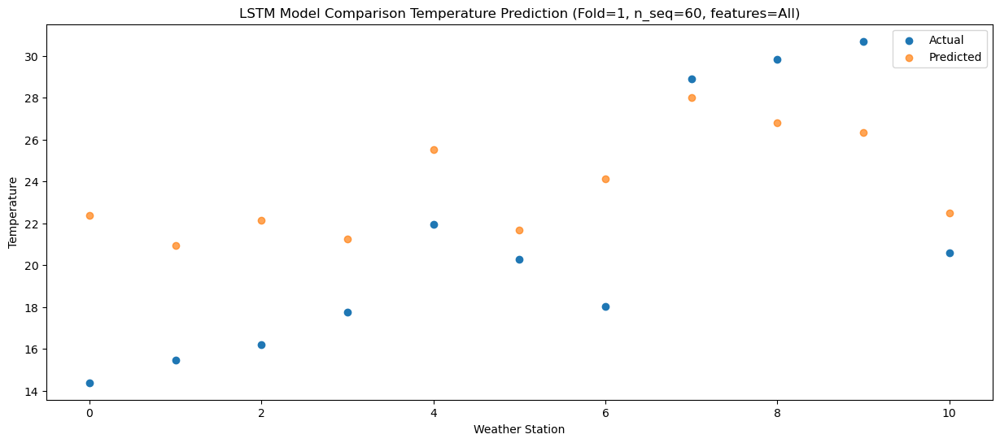

Predictions for (t+33):
    Weather_Station  Actual  Predicted
0                 0   13.59  20.874484
1                 1   14.01  19.442407
2                 2   14.58  20.657914
3                 3   16.11  19.751246
4                 4   19.94  24.035425
5                 5   17.44  20.195239
6                 6   16.54  22.629566
7                 7   26.04  26.521198
8                 8   27.14  25.287926
9                 9   27.86  24.849521
10               10   20.06  21.012977


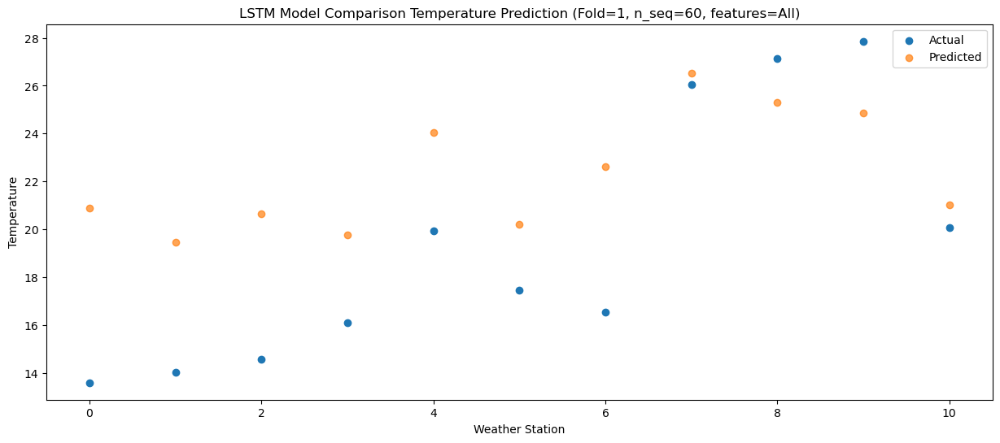

Predictions for (t+34):
    Weather_Station  Actual  Predicted
0                 0   11.63  17.368107
1                 1   10.92  15.934343
2                 2   12.19  17.146942
3                 3   13.34  16.236628
4                 4   16.76  20.518861
5                 5   14.39  16.689696
6                 6   13.65  19.120844
7                 7   22.20  23.013031
8                 8   23.31  21.785012
9                 9   25.45  21.352173
10               10   15.15  17.521041


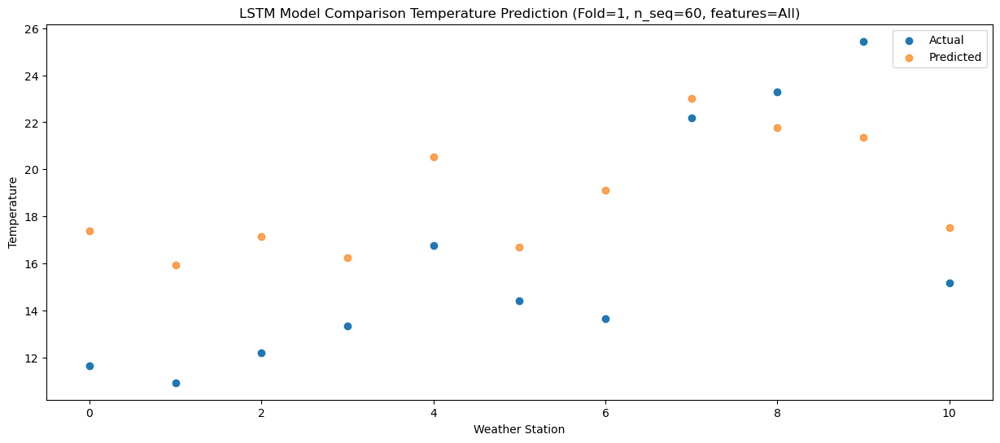

Predictions for (t+35):
    Weather_Station  Actual  Predicted
0                 0    5.08  10.488467
1                 1    4.58   9.056489
2                 2    5.50  10.266328
3                 3    7.78   9.338634
4                 4   11.37  13.614836
5                 5    8.31   9.796752
6                 6    7.31  12.228118
7                 7   15.53  16.117338
8                 8   15.08  14.889364
9                 9   16.91  14.463015
10               10    7.05  10.637065


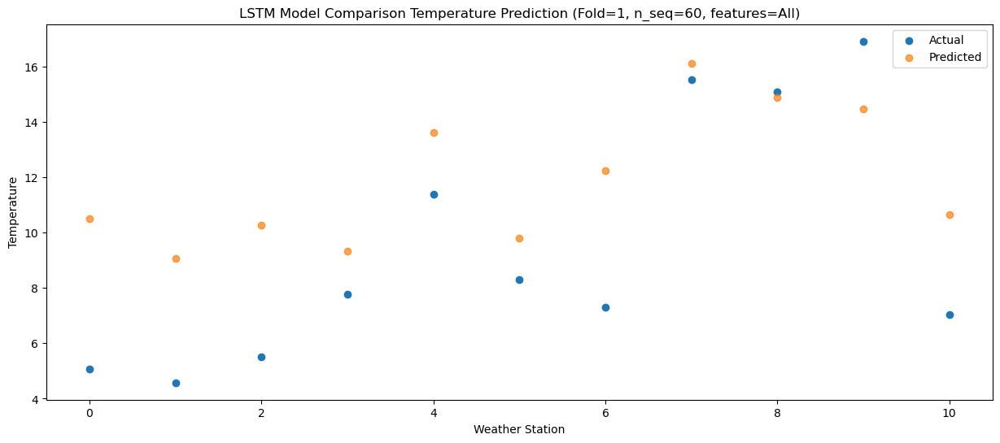

Predictions for (t+36):
    Weather_Station  Actual  Predicted
0                 0    3.88   4.458325
1                 1    1.58   3.029504
2                 2    2.18   4.242006
3                 3    2.73   3.315671
4                 4    6.37   7.589925
5                 5    1.35   3.770752
6                 6    4.42   6.204904
7                 7    8.93  10.089444
8                 8    7.23   8.860934
9                 9    7.92   8.432166
10               10    3.54   4.612825


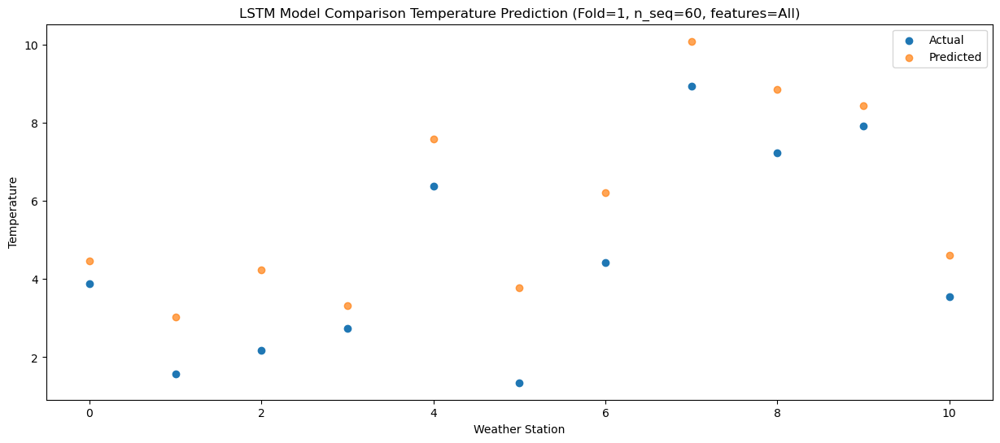

Predictions for (t+37):
    Weather_Station  Actual  Predicted
0                 0   -1.88  -0.778880
1                 1   -4.23  -2.212001
2                 2   -0.98  -0.995623
3                 3    0.64  -1.921829
4                 4    4.35   2.354860
5                 5    0.23  -1.473195
6                 6   -1.59   0.960728
7                 7    5.19   4.845756
8                 8    3.60   3.610419
9                 9    5.57   3.175711
10               10   -3.61  -0.640249


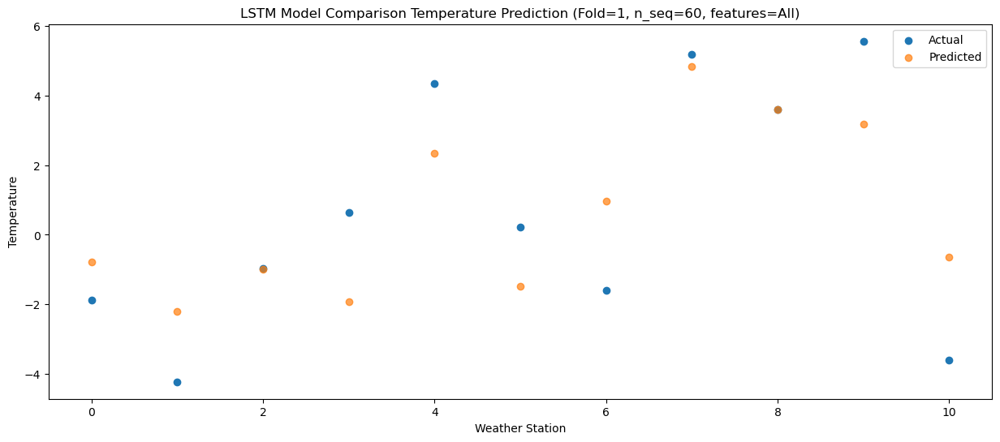

Predictions for (t+38):
    Weather_Station  Actual  Predicted
0                 0    0.23   1.092938
1                 1   -2.04  -0.339048
2                 2    0.02   0.878648
3                 3    1.35  -0.047101
4                 4    4.83   4.229345
5                 5    0.69   0.400555
6                 6    0.54   2.834036
7                 7    6.38   6.720536
8                 8    4.46   5.488311
9                 9    5.85   5.058506
10               10   -0.65   1.236992


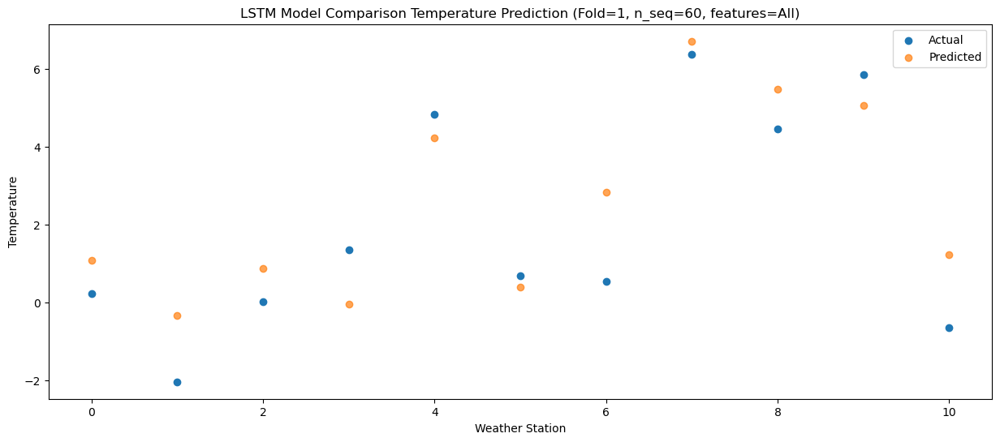

Predictions for (t+39):
    Weather_Station  Actual  Predicted
0                 0    3.14   2.224520
1                 1    1.33   0.798191
2                 2    2.61   2.015283
3                 3    2.35   1.097486
4                 4    6.01   5.379766
5                 5    0.83   1.550231
6                 6    4.13   3.977689
7                 7    7.88   7.867738
8                 8    4.83   6.636483
9                 9    7.00   6.210621
10               10   -0.97   2.385439


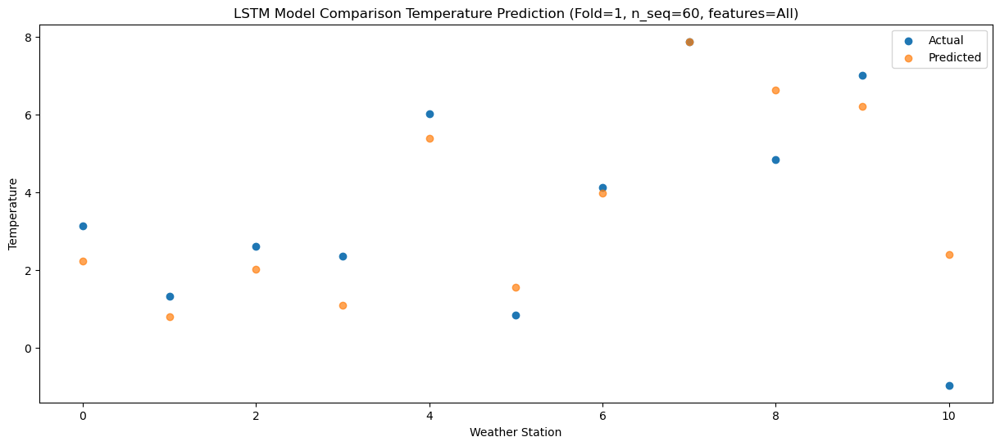

Predictions for (t+40):
    Weather_Station  Actual  Predicted
0                 0    3.78   4.160195
1                 1    2.10   2.735692
2                 2    4.04   3.955486
3                 3    6.18   3.045647
4                 4    9.83   7.329952
5                 5    5.89   3.490747
6                 6    4.80   5.921148
7                 7   10.71   9.810578
8                 8    9.26   8.580402
9                 9   10.73   8.144547
10               10    0.15   4.326231


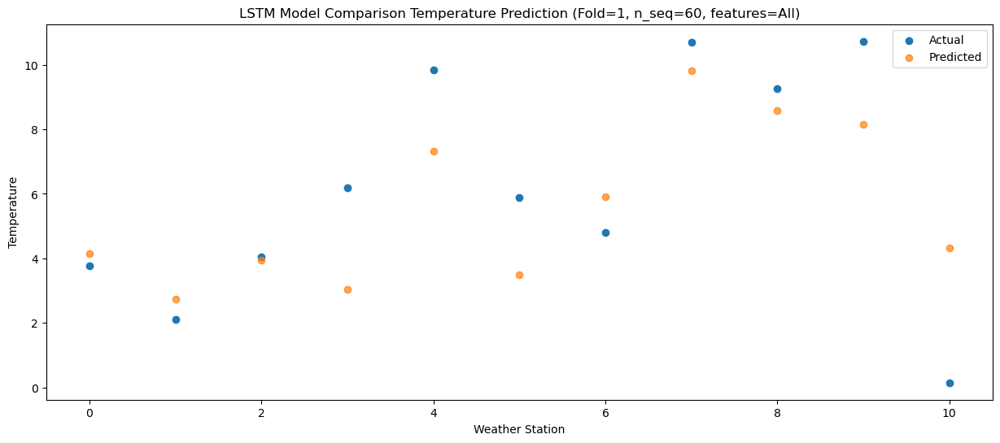

Predictions for (t+41):
    Weather_Station  Actual  Predicted
0                 0    7.28   9.877385
1                 1    5.37   8.458092
2                 2    6.73   9.680764
3                 3    7.02   8.770086
4                 4   10.79  13.054512
5                 5    9.05   9.216993
6                 6    8.06  11.647100
7                 7   15.11  15.531158
8                 8   13.59  14.306526
9                 9   16.08  13.869585
10               10    7.37  10.052490


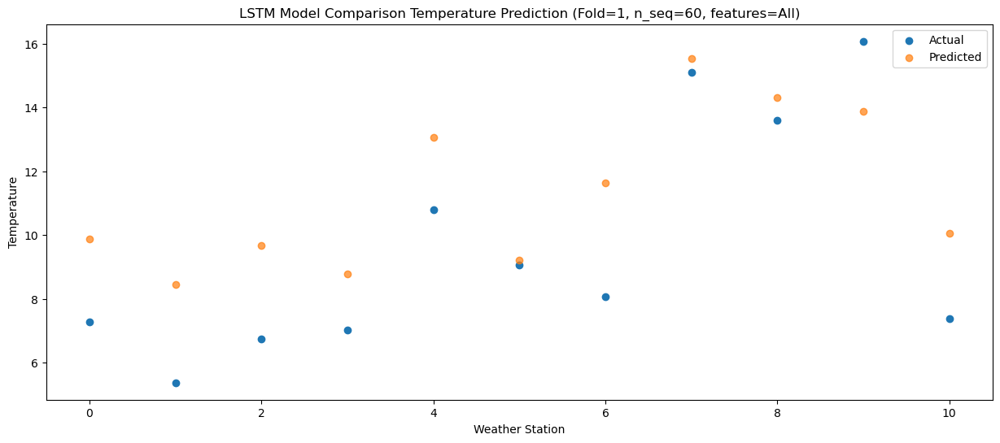

Predictions for (t+42):
    Weather_Station  Actual  Predicted
0                 0    8.78  15.677674
1                 1    8.65  14.257080
2                 2    9.97  15.477946
3                 3   11.61  14.582262
4                 4   15.43  18.871085
5                 5   13.66  15.032555
6                 6   11.06  17.451755
7                 7   20.46  21.343629
8                 8   19.28  20.123781
9                 9   21.19  19.688987
10               10    9.93  15.856069


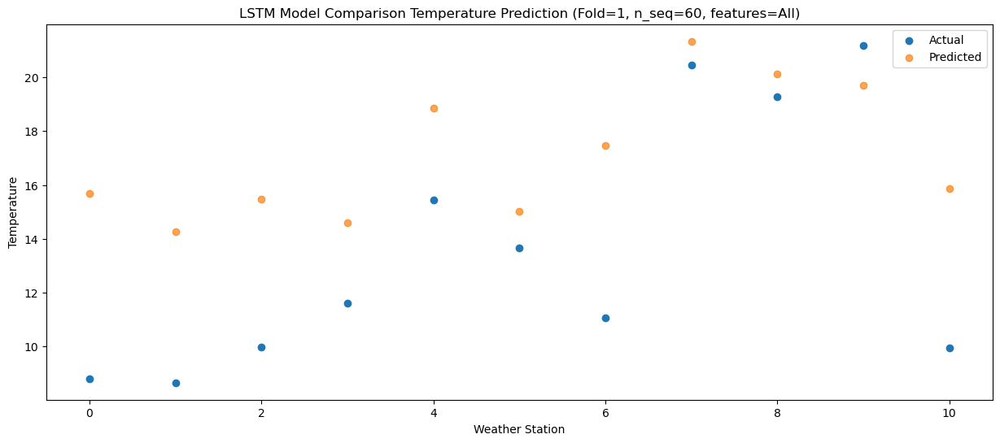

Predictions for (t+43):
    Weather_Station  Actual  Predicted
0                 0   12.40  19.811728
1                 1   11.84  18.392129
2                 2   13.72  19.608976
3                 3   15.76  18.704548
4                 4   20.32  22.988346
5                 5   20.35  19.153652
6                 6   14.34  21.576863
7                 7   24.27  25.474222
8                 8   24.21  24.251427
9                 9   24.42  23.820983
10               10   14.30  19.984664


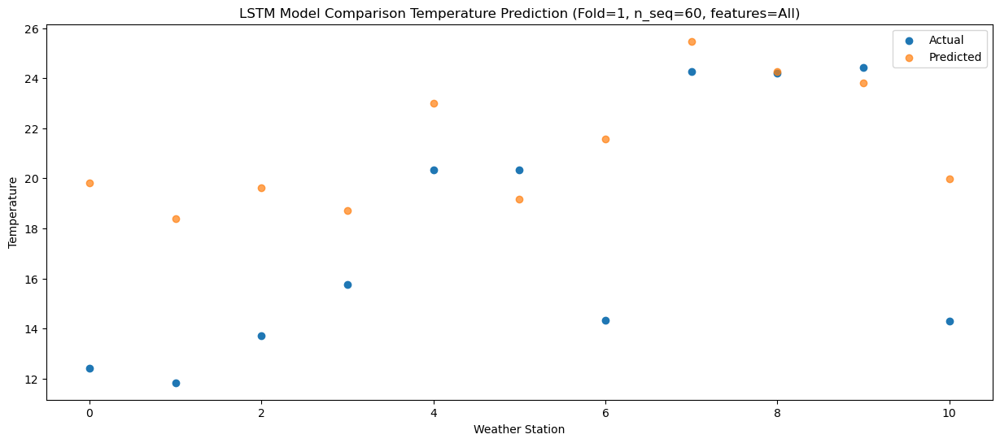

Predictions for (t+44):
    Weather_Station  Actual  Predicted
0                 0   15.63  22.241945
1                 1   15.44  20.822874
2                 2   16.09  22.038351
3                 3   17.48  21.138785
4                 4   22.27  25.424842
5                 5   21.45  21.591433
6                 6   17.79  24.011594
7                 7   26.57  27.905747
8                 8   27.09  26.681305
9                 9   29.04  26.251974
10               10   19.44  22.422252


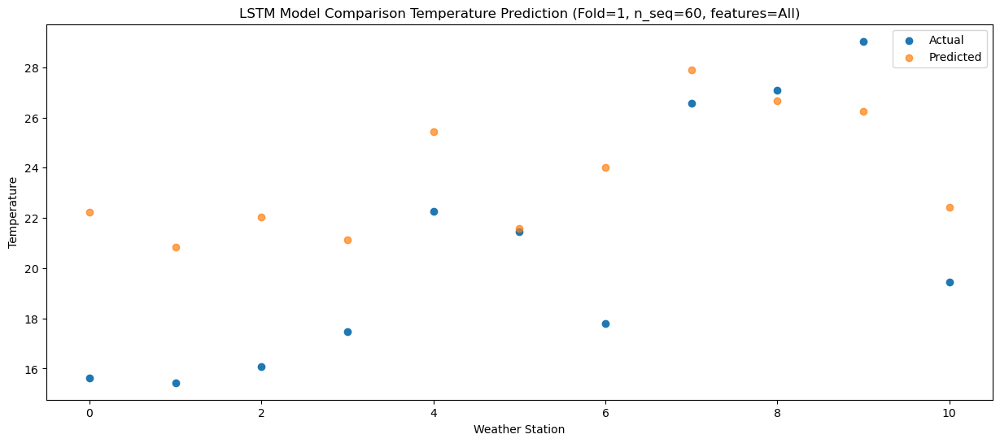

Predictions for (t+45):
    Weather_Station  Actual  Predicted
0                 0   15.42  21.787391
1                 1   14.90  20.364214
2                 2   16.53  21.582826
3                 3   19.45  20.685912
4                 4   23.70  24.973132
5                 5   20.64  21.133732
6                 6   17.37  23.558112
7                 7   27.07  27.450671
8                 8   28.90  26.225717
9                 9   29.44  25.795244
10               10   17.70  21.959705


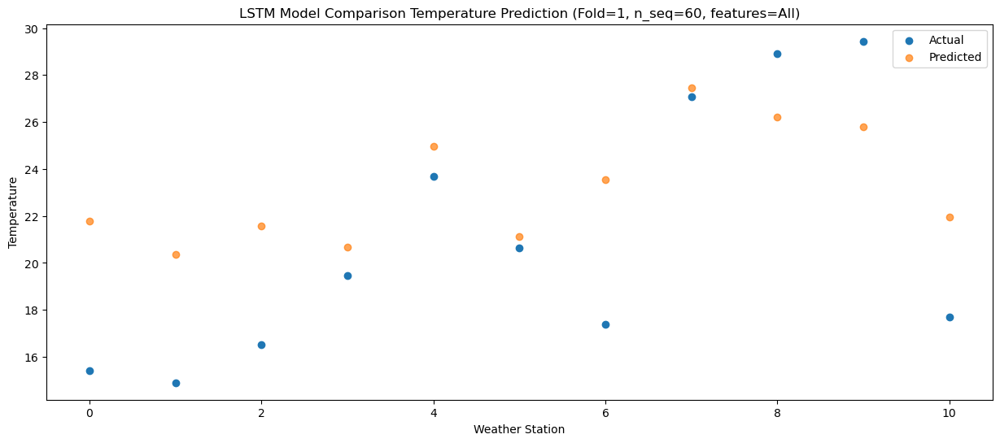

Predictions for (t+46):
    Weather_Station  Actual  Predicted
0                 0   11.73  18.677498
1                 1   11.39  17.257664
2                 2   13.57  18.474270
3                 3   16.37  17.576652
4                 4   19.85  21.860910
5                 5   18.36  18.023133
6                 6   14.20  20.447678
7                 7   23.45  24.337440
8                 8   24.26  23.112258
9                 9   25.92  22.683188
10               10   14.51  18.854364


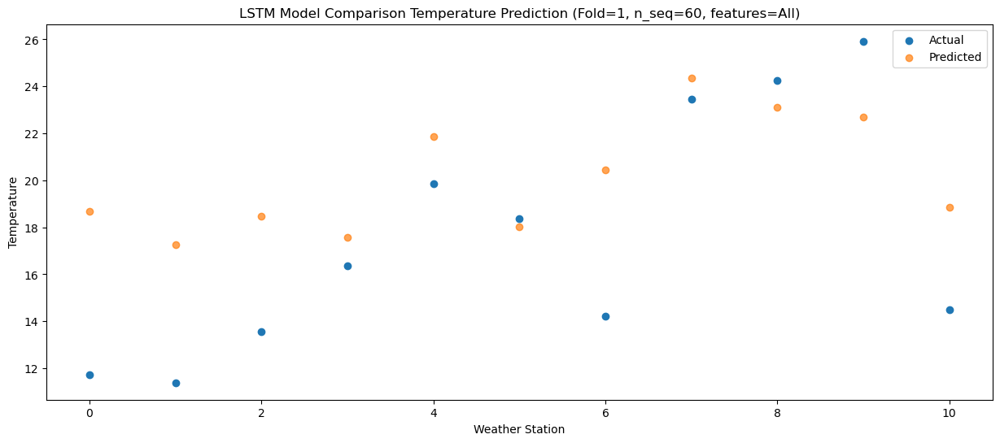

Predictions for (t+47):
    Weather_Station  Actual  Predicted
0                 0    6.85  12.060572
1                 1    6.38  10.636506
2                 2    7.53  11.852790
3                 3    9.11  10.955861
4                 4   12.45  15.239781
5                 5   10.76  11.400831
6                 6    9.19  13.825749
7                 7   17.14  17.711466
8                 8   15.68  16.480725
9                 9   17.82  16.047502
10               10    9.16  12.224201


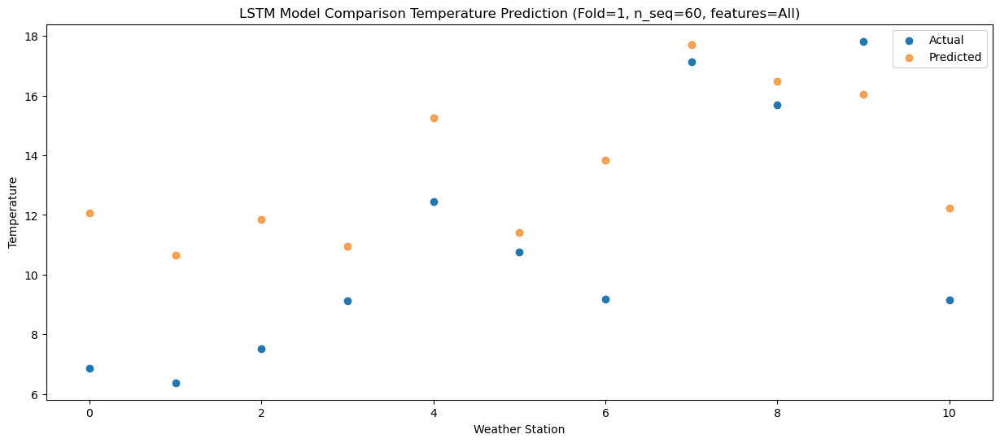

Predictions for (t+48):
    Weather_Station  Actual  Predicted
0                 0    1.70   5.663356
1                 1    0.76   4.241861
2                 2    0.97   5.459437
3                 3    2.83   4.570453
4                 4    6.25   8.855918
5                 5    4.10   5.011658
6                 6    3.50   7.435185
7                 7    9.74  11.320715
8                 8    8.56  10.085745
9                 9   11.07   9.647111
10               10    1.22   5.814023


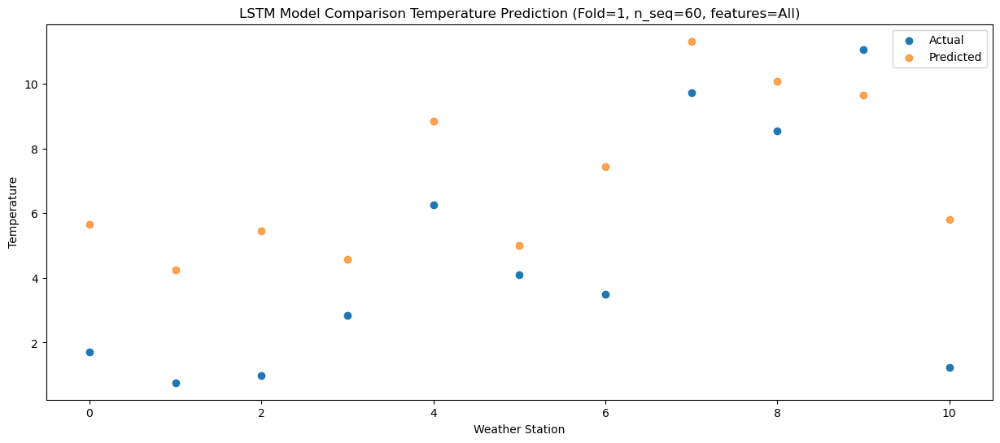

Predictions for (t+49):
    Weather_Station  Actual  Predicted
0                 0   -0.33   3.534908
1                 1   -2.38   2.111198
2                 2   -1.81   3.328931
3                 3    0.43   2.438614
4                 4    4.35   6.726429
5                 5    1.74   2.887049
6                 6    0.76   5.310202
7                 7    6.82   9.191682
8                 8    5.71   7.954515
9                 9    7.24   7.511443
10               10   -0.47   3.683958


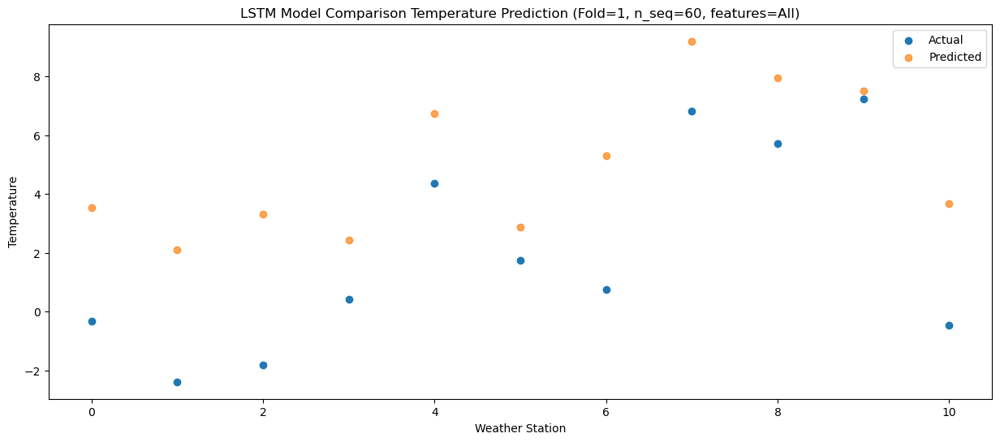

Predictions for (t+50):
    Weather_Station  Actual  Predicted
0                 0   -1.65  -1.934850
1                 1   -5.66  -3.361141
2                 2   -4.89  -2.141147
3                 3   -2.99  -3.038867
4                 4    0.50   1.246840
5                 5   -1.87  -2.586011
6                 6   -2.24  -0.168762
7                 7    0.89   3.715541
8                 8   -0.12   2.481982
9                 9    2.07   2.038857
10               10   -4.37  -1.799790


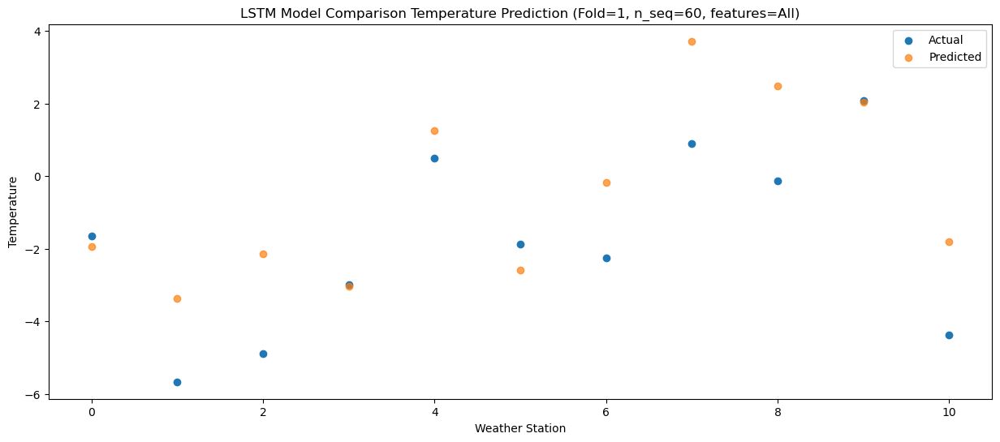

Predictions for (t+51):
    Weather_Station  Actual  Predicted
0                 0   -0.27   4.150548
1                 1   -0.58   2.730386
2                 2    0.45   3.949981
3                 3    3.32   3.052875
4                 4    6.87   7.340856
5                 5    4.25   3.512750
6                 6    1.97   5.923884
7                 7    9.89   9.809156
8                 8    7.83   8.584772
9                 9    9.78   8.145443
10               10   -2.42   4.298997


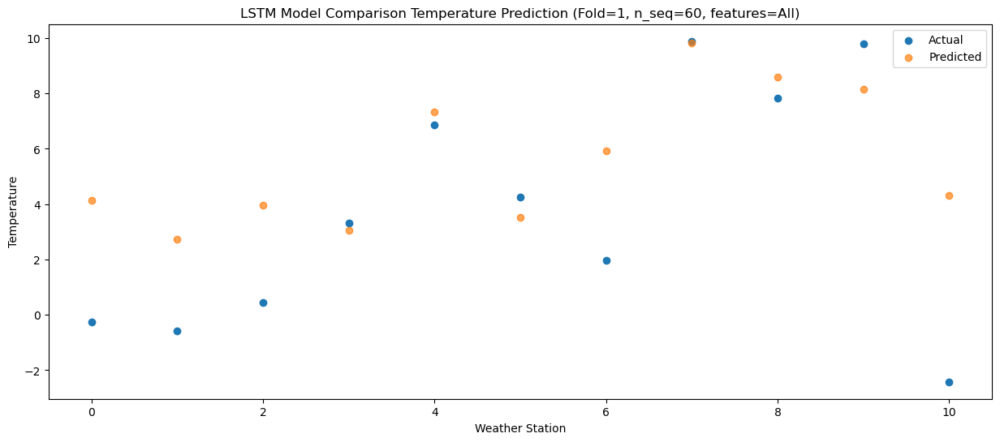

Predictions for (t+52):
    Weather_Station  Actual  Predicted
0                 0    4.58   7.468045
1                 1    2.64   6.047373
2                 2    3.55   7.272895
3                 3    5.83   6.369925
4                 4    9.61  10.659839
5                 5    6.60   6.831439
6                 6    5.63   9.246817
7                 7   12.61  13.129804
8                 8   11.07  11.903271
9                 9   12.61  11.455141
10               10    1.98   7.610590


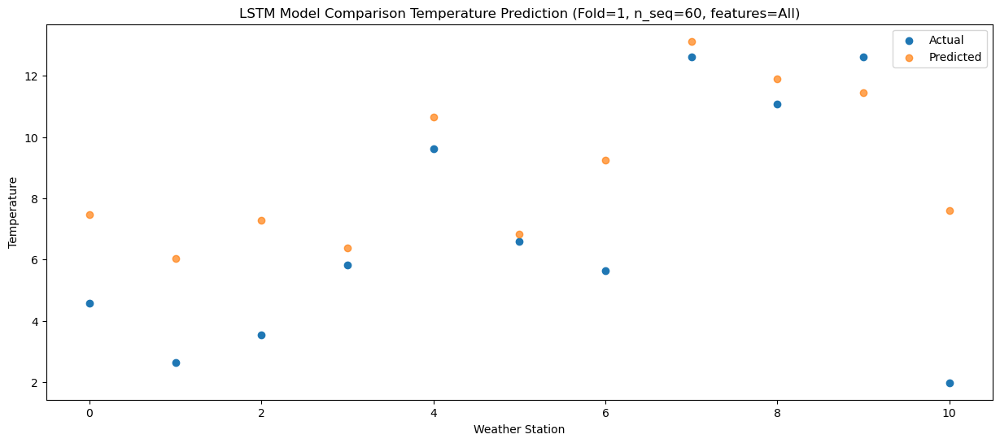

Predictions for (t+53):
    Weather_Station  Actual  Predicted
0                 0    6.98  12.163889
1                 1    6.31  10.746293
2                 2    6.89  11.972459
3                 3    9.31  11.059851
4                 4   13.17  15.347887
5                 5   11.40  11.531414
6                 6    9.10  13.949877
7                 7   16.65  17.829900
8                 8   15.75  16.604010
9                 9   17.68  16.152034
10               10    6.37  12.312673


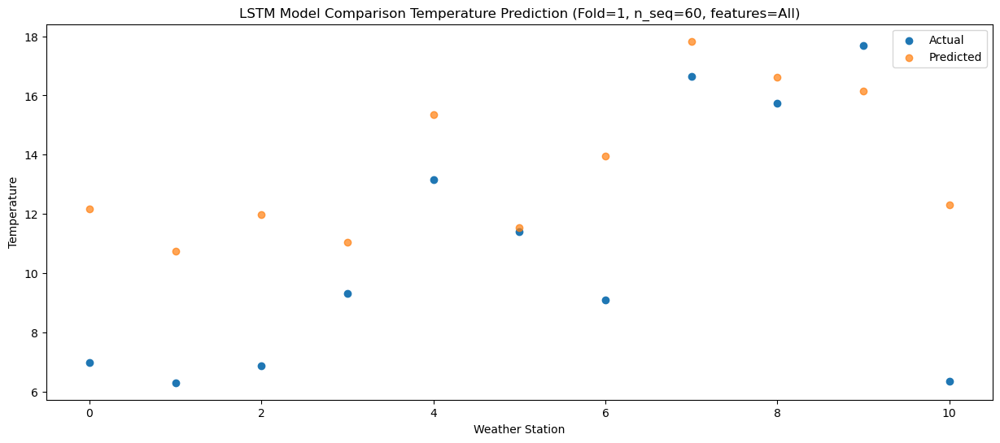

Predictions for (t+54):
    Weather_Station  Actual  Predicted
0                 0   11.65  17.793072
1                 1   10.88  16.374747
2                 2   12.50  17.599351
3                 3   13.01  16.698302
4                 4   16.87  20.989406
5                 5   17.02  17.169975
6                 6   13.34  19.585008
7                 7   22.19  23.463928
8                 8   20.51  22.239075
9                 9   21.82  21.784833
10               10   11.96  17.940664


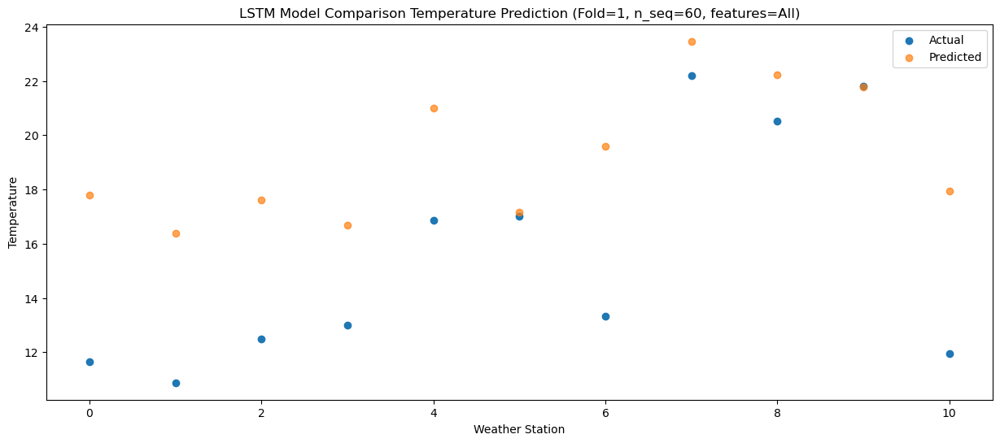

Predictions for (t+55):
    Weather_Station  Actual  Predicted
0                 0   14.52  21.657974
1                 1   14.64  20.242337
2                 2   15.61  21.464926
3                 3   15.64  20.568071
4                 4   19.76  24.856852
5                 5   19.88  21.037047
6                 6   17.27  23.451361
7                 7   25.26  27.336861
8                 8   26.21  26.115184
9                 9   28.23  25.670294
10               10   18.07  21.812513


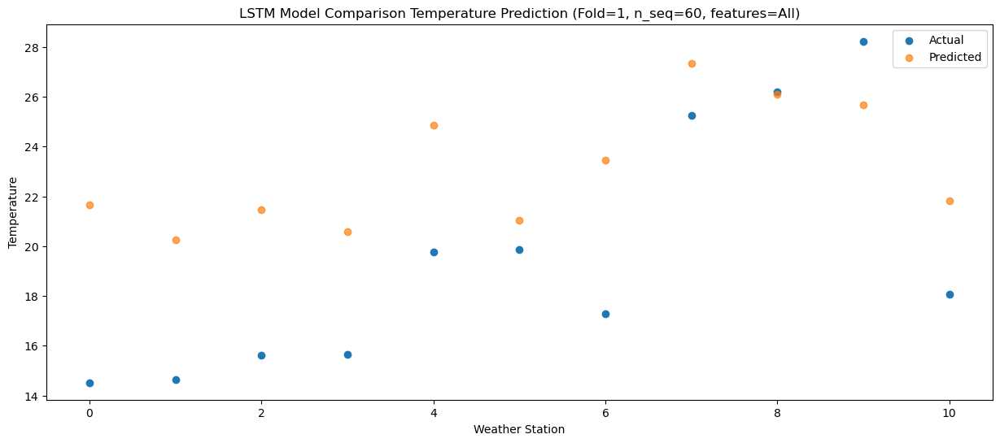

Predictions for (t+56):
    Weather_Station  Actual  Predicted
0                 0   15.48  22.162184
1                 1   15.57  20.745146
2                 2   15.63  21.966882
3                 3   15.03  21.063473
4                 4   19.57  25.355908
5                 5   18.88  21.546865
6                 6   18.30  23.956275
7                 7   25.90  27.840288
8                 8   27.06  26.619642
9                 9   28.96  26.178079
10               10   20.00  22.321364


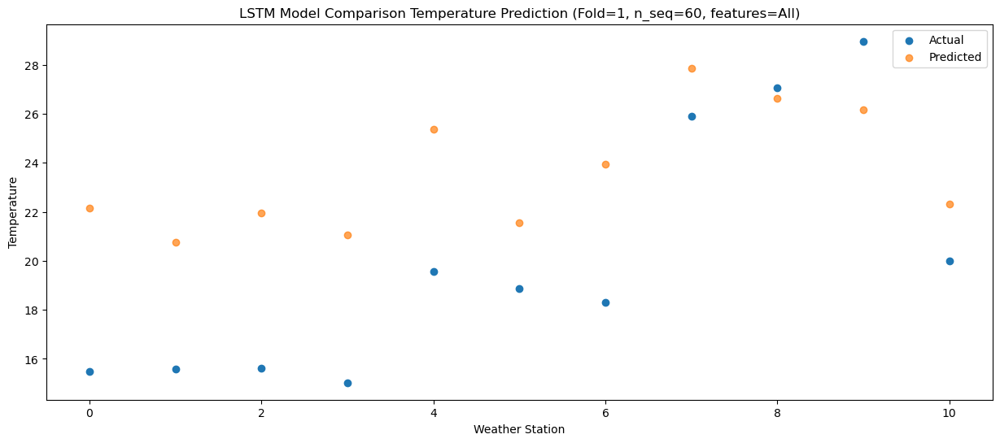

Predictions for (t+57):
    Weather_Station  Actual  Predicted
0                 0   14.13  22.042597
1                 1   15.29  20.627255
2                 2   15.94  21.850537
3                 3   16.16  20.945386
4                 4   20.89  25.239254
5                 5   20.48  21.422977
6                 6   17.97  23.836697
7                 7   26.31  27.724325
8                 8   29.17  26.507406
9                 9   29.76  26.063137
10               10   17.85  22.205184


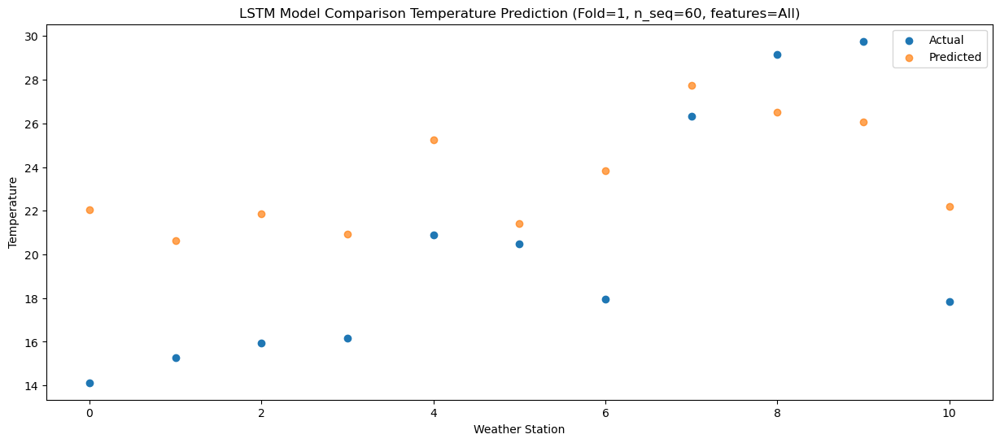

Predictions for (t+58):
    Weather_Station  Actual  Predicted
0                 0   11.69  19.324785
1                 1   11.57  17.903353
2                 2   13.63  19.122684
3                 3   13.56  18.211826
4                 4   17.60  22.502632
5                 5   14.77  18.689470
6                 6   14.67  21.105822
7                 7   24.44  24.991374
8                 8   23.20  23.772409
9                 9   25.20  23.328072
10               10   14.12  19.475554


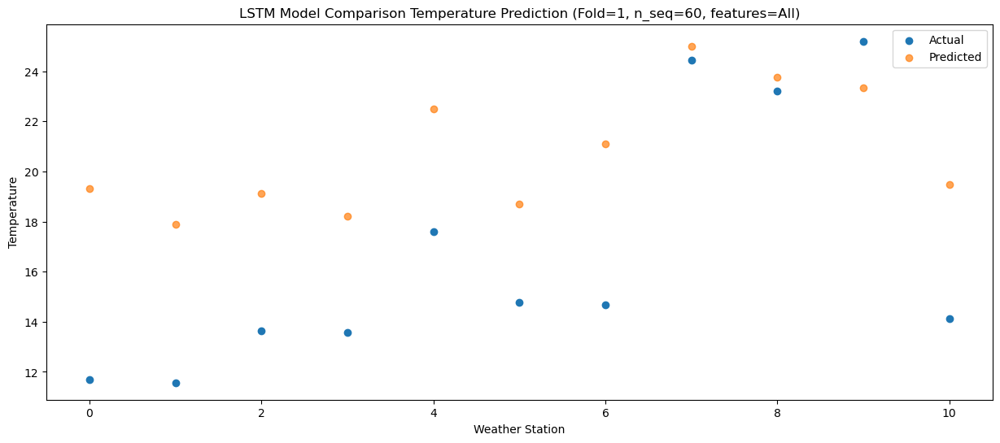

Predictions for (t+59):
    Weather_Station  Actual  Predicted
0                 0    6.81  14.027945
1                 1    7.12  12.606890
2                 2    8.63  13.827069
3                 3   10.87  12.922367
4                 4   14.45  17.217804
5                 5   13.62  13.410242
6                 6    9.87  15.822880
7                 7   18.97  19.706434
8                 8   19.34  18.492273
9                 9   20.35  18.047698
10               10    9.25  14.186325


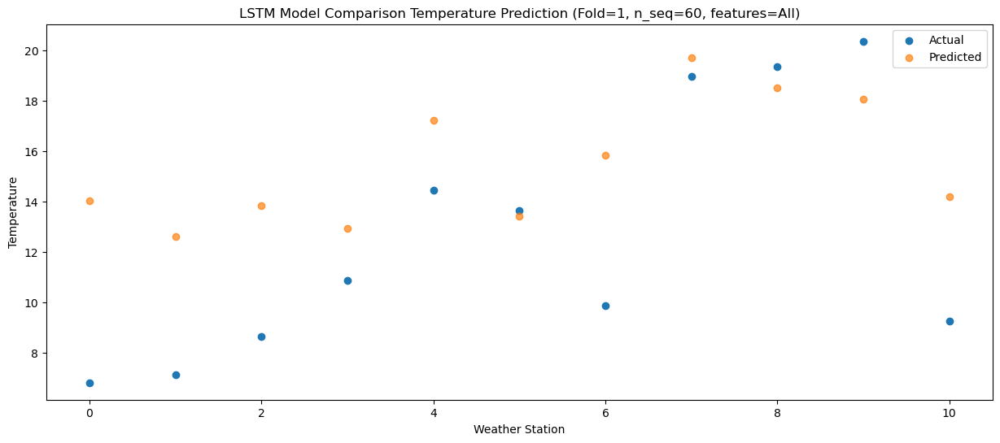

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_2 (LSTM)               (1, 1, 256)               2290688   
                                                                 
 dropout_2 (Dropout)         (1, 1, 256)               0         
                                                                 
 lstm_3 (LSTM)               (1, 256)                  525312    
                                                                 
 dropout_3 (Dropout)         (1, 256)                  0         
                                                                 
 dense_3 (Dense)             (1, 256)                  65792     
                                                                 
 dense_4 (Dense)             (1, 128)                  32896     
                                                                 
 dense_5 (Dense)             (1, 60)                  

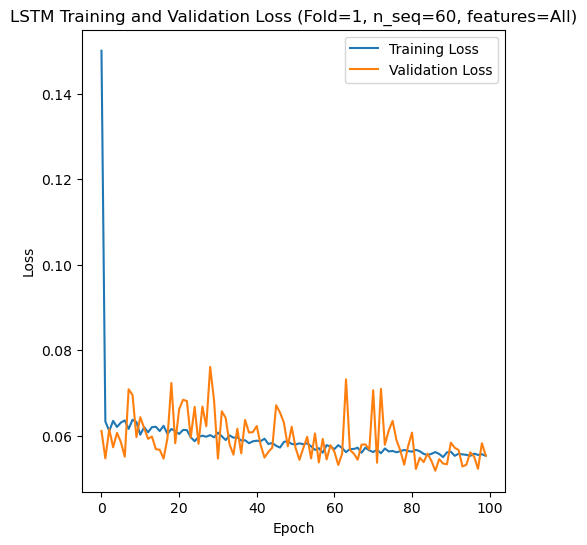

Epoch 1/100
84/84 [==============================] - 29s 112ms/step - loss: 0.1382 - accuracy: 0.3452 - mae: 0.1134 - rmse: 0.1382 - mape: inf - pearson: 0.6647 - val_loss: 0.0477 - val_accuracy: 0.6000 - val_mae: 0.0376 - val_rmse: 0.0477 - val_mape: 8.6100 - val_pearson: 0.8964
Epoch 2/100
84/84 [==============================] - 2s 25ms/step - loss: 0.0629 - accuracy: 0.4881 - mae: 0.0495 - rmse: 0.0629 - mape: inf - pearson: 0.8247 - val_loss: 0.0540 - val_accuracy: 0.6000 - val_mae: 0.0428 - val_rmse: 0.0540 - val_mape: 10.2992 - val_pearson: 0.8721
Epoch 3/100
84/84 [==============================] - 2s 24ms/step - loss: 0.0640 - accuracy: 0.4643 - mae: 0.0505 - rmse: 0.0640 - mape: inf - pearson: 0.8191 - val_loss: 0.0449 - val_accuracy: 0.6000 - val_mae: 0.0365 - val_rmse: 0.0449 - val_mape: 8.2942 - val_pearson: 0.9200
Epoch 4/100
84/84 [==============================] - 2s 25ms/step - loss: 0.0614 - accuracy: 0.5357 - mae: 0.0486 - rmse: 0.0614 - mape: inf - pearson: 0.8350 -

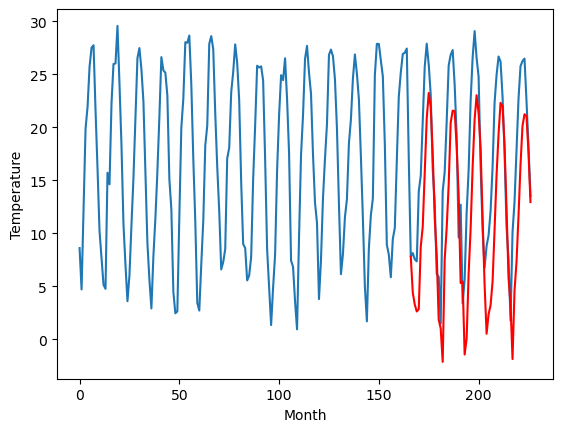

Weather Station 2:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
1.57		-0.95		-2.52
-0.71		-2.08		-1.37
-0.95		-2.74		-1.79
-1.68		-2.53		-0.85
6.33		3.35		-2.98
8.56		5.25		-3.31
15.36		10.35		-5.01
22.56		15.43		-7.13
22.59		17.85		-4.74
21.26		16.51		-4.75
15.13		12.12		-3.01
8.14		6.03		-2.11
5.02		2.54		-2.48
-1.61		-3.57		-1.96
-1.69		-4.39		-2.70
-5.73		-7.54		-1.81
4.46		2.12		-2.34
8.22		5.09		-3.13
13.40		9.17		-4.23
20.65		15.01		-5.64
21.34		16.16		-5.18
22.10		16.10		-6.00
19.86		12.75		-7.11
11.60		8.20		-3.40
4.89		-0.09		-4.98
2.50		0.04		-2.46
-2.19		-6.84		-4.65
-2.20		-5.31		-3.11
4.78		0.78		-4.00
11.46		5.03		-6.43
17.26		10.81		-6.45
21.06		15.32		-5.74
24.30		17.62		-6.68
21.99		15.91		-6.08
19.23		12.59		-6.64
10.85		6.05		-4.80
0.86		-0.25		-1.11
-1.85		-4.88		-3.03
-2.10		-3.02		-0.92
-0.50		-2.18		-1.68
3.57		0.04		-3.53
9.43		4.94		-4.49
14.92		10.09		-4.83
17.53		13.97		-3.56
21.63		16.91		-4.72
22.12		16.57		-5.55
19.25		12.89

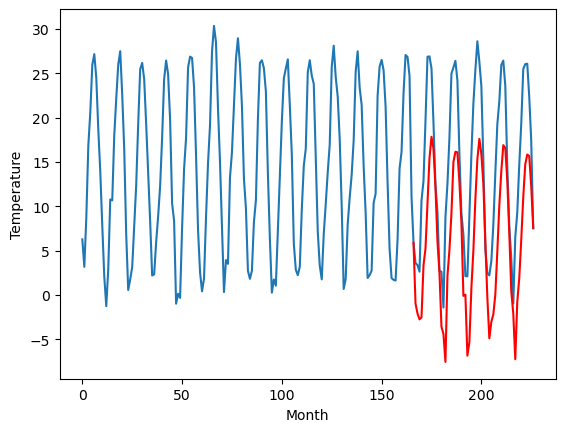

Weather Station 3:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
5.66		4.32		-1.34
4.54		3.19		-1.35
3.39		2.53		-0.86
4.43		2.74		-1.69
8.05		8.61		0.56
9.44		10.51		1.07
10.75		15.62		4.87
13.34		20.70		7.36
13.98		23.11		9.13
13.67		21.78		8.11
12.41		17.39		4.98
11.14		11.30		0.16
7.72		7.80		0.08
0.73		1.70		0.97
1.39		0.89		-0.50
4.12		-2.26		-6.38
5.93		7.39		1.46
7.74		10.36		2.62
11.32		14.43		3.11
12.54		20.25		7.71
13.33		21.40		8.07
13.38		21.34		7.96
12.10		17.98		5.88
10.96		13.44		2.48
4.11		5.15		1.04
5.01		5.29		0.28
0.75		-1.59		-2.34
3.08		-0.07		-3.15
6.55		6.01		-0.54
8.36		10.26		1.90
11.12		16.05		4.93
12.93		20.55		7.62
13.11		22.85		9.74
12.54		21.14		8.60
11.13		17.81		6.68
8.50		11.27		2.77
6.74		4.98		-1.76
2.64		0.35		-2.29
2.44		2.20		-0.24
5.50		3.04		-2.46
6.52		5.27		-1.25
9.06		10.16		1.10
10.04		15.30		5.26
12.45		19.18		6.73
14.36		22.11		7.75
14.54		21.78		7.24
12.59		18.08		5.49
9.01		12.12		3.11
5.03		5.61		0.58
3.10	

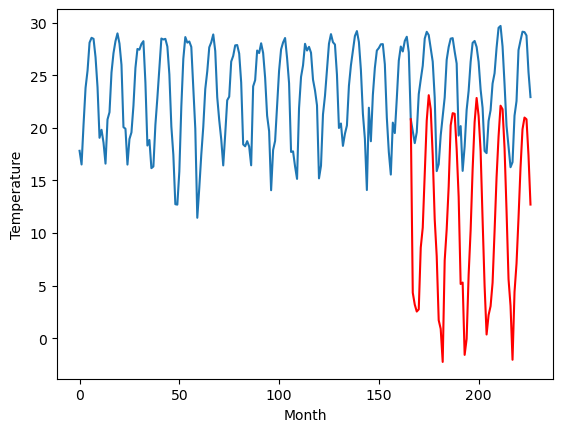

Weather Station 4:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-0.01		0.85		0.86
-3.07		-0.29		2.78
-2.80		-0.95		1.85
-2.65		-0.74		1.91
0.90		5.13		4.23
2.13		7.02		4.89
8.02		12.13		4.11
14.08		17.20		3.12
18.36		19.62		1.26
16.51		18.27		1.76
11.93		13.88		1.95
6.71		7.80		1.09
2.75		4.30		1.55
-4.08		-1.81		2.27
-7.16		-2.63		4.53
-7.14		-5.78		1.36
-3.03		3.88		6.91
1.47		6.85		5.38
6.73		10.91		4.18
12.30		16.73		4.43
14.30		17.88		3.58
15.36		17.82		2.46
12.19		14.47		2.28
8.36		9.93		1.57
0.28		1.64		1.36
-1.64		1.77		3.41
-7.79		-5.10		2.69
-5.47		-3.59		1.88
-1.61		2.49		4.10
2.83		6.74		3.91
8.17		12.53		4.36
12.41		17.03		4.62
17.03		19.32		2.29
16.95		17.62		0.67
11.91		14.29		2.38
6.47		7.75		1.28
2.67		1.46		-1.21
-3.50		-3.17		0.33
-2.21		-1.32		0.89
-4.09		-0.47		3.62
-1.65		1.76		3.41
4.07		6.65		2.58
7.70		11.80		4.10
11.49		15.67		4.18
17.06		18.61		1.55
15.05		18.26		3.21
12.63		14.57		1.94
7.61		8.61		1.00
-0.37		2.09		2.46
-1.11		

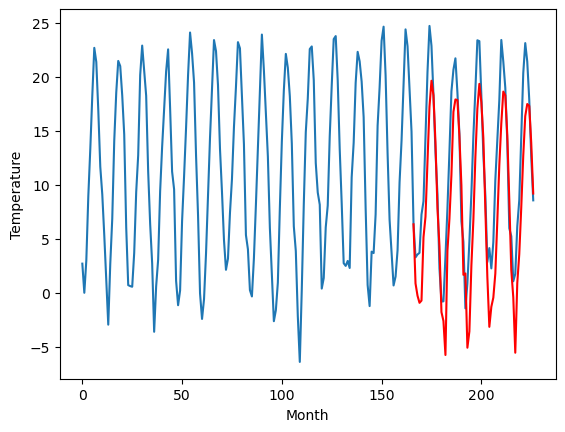

Weather Station 5:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-0.32		0.89		1.21
0.03		-0.25		-0.28
0.37		-0.91		-1.28
1.01		-0.70		-1.71
7.70		5.18		-2.52
7.17		7.07		-0.10
10.14		12.18		2.04
13.18		17.26		4.08
13.92		19.67		5.75
14.29		18.33		4.04
11.94		13.94		2.00
8.25		7.86		-0.39
4.13		4.36		0.23
-2.17		-1.74		0.43
-1.82		-2.56		-0.74
-2.56		-5.71		-3.15
4.77		3.94		-0.83
5.64		6.91		1.27
10.11		10.98		0.87
13.59		16.79		3.20
14.18		17.93		3.75
14.35		17.87		3.52
11.81		14.51		2.70
9.07		9.97		0.90
0.80		1.68		0.88
4.21		1.82		-2.39
-3.52		-5.05		-1.53
-0.38		-3.53		-3.15
3.38		2.54		-0.84
7.18		6.79		-0.39
12.34		12.58		0.24
14.93		17.09		2.16
14.76		19.38		4.62
13.94		17.68		3.74
11.97		14.36		2.39
5.78		7.82		2.04
2.71		1.53		-1.18
0.20		-3.11		-3.31
1.37		-1.26		-2.63
3.50		-0.41		-3.91
5.33		1.81		-3.52
7.25		6.70		-0.55
11.28		11.84		0.56
14.93		15.72		0.79
16.37		18.65		2.28
17.67		18.31		0.64
13.24		14.61		1.37
7.08		8.65		1.57
1.97		2.15		

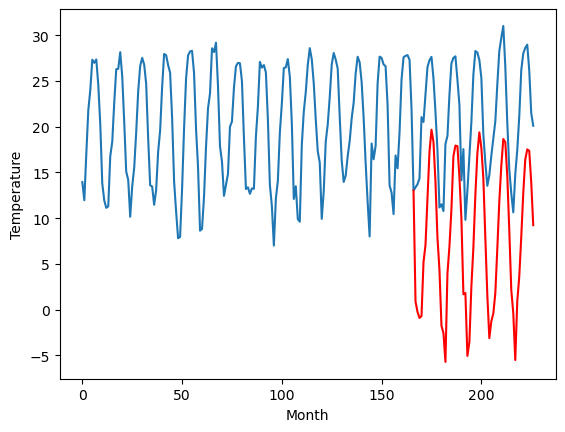

Weather Station 6:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-0.39		-1.44		-1.05
-1.82		-2.58		-0.76
-1.45		-3.24		-1.79
-2.21		-3.04		-0.83
5.88		2.84		-3.04
5.85		4.73		-1.12
9.69		9.84		0.15
13.30		14.91		1.61
15.00		17.32		2.32
15.30		15.98		0.68
10.90		11.60		0.70
6.43		5.52		-0.91
3.75		2.01		-1.74
-2.36		-4.09		-1.73
-2.95		-4.91		-1.96
-5.30		-8.05		-2.75
3.08		1.60		-1.48
5.20		4.57		-0.63
9.24		8.64		-0.60
13.79		14.45		0.66
13.87		15.60		1.73
14.98		15.55		0.57
12.24		12.20		-0.04
8.94		7.65		-1.29
1.30		-0.63		-1.93
4.54		-0.50		-5.04
-3.89		-7.37		-3.48
-4.27		-5.85		-1.58
1.85		0.23		-1.62
8.00		4.47		-3.53
12.60		10.26		-2.34
16.32		14.77		-1.55
17.68		17.05		-0.63
14.96		15.35		0.39
12.30		12.03		-0.27
6.73		5.49		-1.24
0.85		-0.80		-1.65
-1.38		-5.44		-4.06
-0.62		-3.60		-2.98
0.57		-2.76		-3.33
4.37		-0.54		-4.91
5.29		4.34		-0.95
10.37		9.48		-0.89
15.29		13.36		-1.93
17.45		16.29		-1.16
19.15		15.96		-3.19
14.67		12.26		-2.41
6.78		

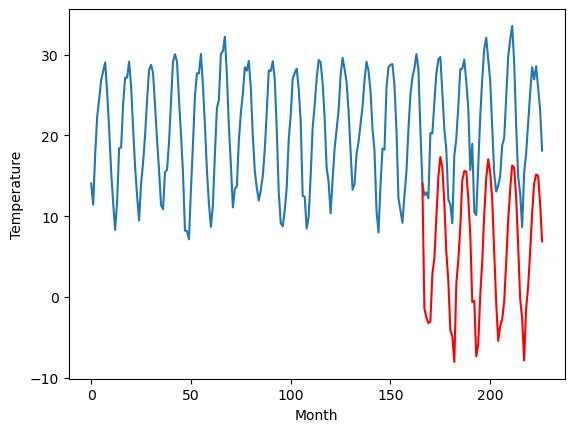

Weather Station 7:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
10.42		10.10		-0.32
8.61		8.96		0.35
8.96		8.30		-0.66
8.40		8.50		0.10
16.05		14.37		-1.68
16.36		16.27		-0.09
21.26		21.38		0.12
26.00		26.45		0.45
27.18		28.85		1.67
27.41		27.51		0.10
21.47		23.13		1.66
15.99		17.04		1.05
13.50		13.53		0.03
7.04		7.43		0.39
6.34		6.61		0.27
3.23		3.47		0.24
13.60		13.12		-0.48
15.30		16.09		0.79
19.38		20.16		0.78
24.94		25.97		1.03
25.83		27.12		1.29
26.39		27.07		0.68
24.12		23.72		-0.40
19.61		19.18		-0.43
11.64		10.90		-0.74
13.93		11.03		-2.90
5.45		4.16		-1.29
5.28		5.67		0.39
11.86		11.75		-0.11
18.13		15.99		-2.14
23.15		21.78		-1.37
27.86		26.28		-1.58
30.65		28.56		-2.09
27.84		26.87		-0.97
24.01		23.55		-0.46
17.63		17.00		-0.63
10.96		10.71		-0.25
8.34		6.07		-2.27
9.22		7.91		-1.31
9.41		8.75		-0.66
14.06		10.96		-3.10
15.88		15.85		-0.03
21.62		20.99		-0.63
25.77		24.87		-0.90
28.33		27.80		-0.53
30.67		27.47		-3.20
25.89		23.77		-2.12
17.17

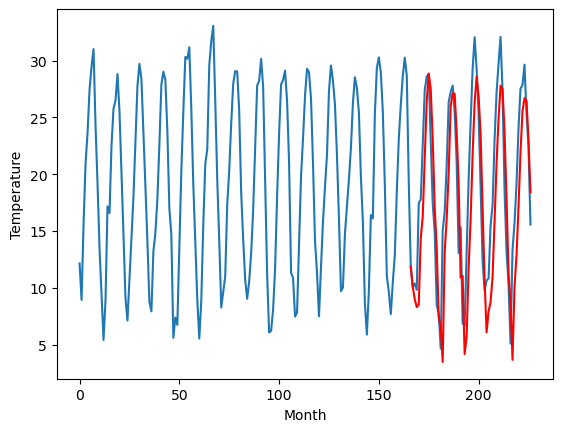

Weather Station 8:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-3.43		-5.04		-1.61
-7.96		-6.19		1.77
-6.71		-6.85		-0.14
-5.90		-6.64		-0.74
-1.40		-0.77		0.63
3.58		1.12		-2.46
9.87		6.24		-3.63
13.39		11.30		-2.09
15.49		13.72		-1.77
15.93		12.37		-3.56
9.68		7.98		-1.70
4.08		1.89		-2.19
-1.48		-1.63		-0.15
-9.13		-7.73		1.40
-8.59		-8.55		0.04
-5.67		-11.68		-6.01
-2.57		-2.03		0.54
4.09		0.93		-3.16
9.10		5.00		-4.10
14.09		10.83		-3.26
12.89		11.98		-0.91
12.37		11.92		-0.45
10.19		8.57		-1.62
3.63		4.03		0.40
-1.77		-4.24		-2.47
-5.12		-4.10		1.02
-8.12		-10.98		-2.86
-7.15		-9.46		-2.31
-2.09		-3.38		-1.29
5.10		0.86		-4.24
9.80		6.65		-3.15
13.66		11.15		-2.51
14.80		13.43		-1.37
11.78		11.74		-0.04
10.05		8.41		-1.64
1.84		1.86		0.02
-5.05		-4.43		0.62
-7.22		-9.07		-1.85
-7.93		-7.22		0.71
-6.72		-6.38		0.34
-2.02		-4.16		-2.14
3.62		0.73		-2.89
8.27		5.87		-2.40
12.93		9.74		-3.19
17.68		12.67		-5.01
14.68		12.33		-2.35
12.02		8.64		-3.38
5.

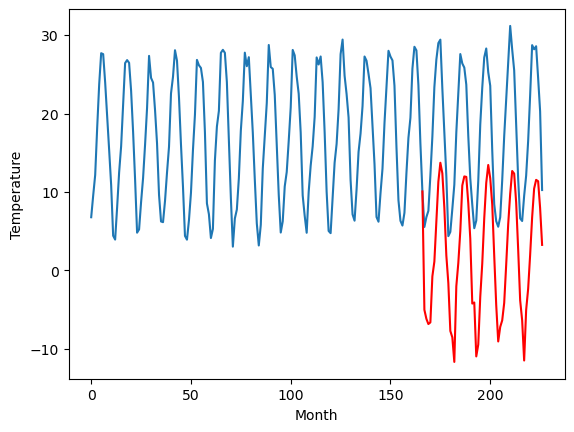

Weather Station 9:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
9.34		6.22		-3.12
5.80		5.06		-0.74
6.34		4.40		-1.94
8.45		4.61		-3.84
8.52		10.47		1.95
11.73		12.36		0.63
15.78		17.48		1.70
17.07		22.54		5.47
19.48		24.95		5.47
21.88		23.60		1.72
20.28		19.21		-1.07
17.04		13.12		-3.92
10.32		9.60		-0.72
8.27		3.49		-4.78
8.21		2.67		-5.54
7.29		-0.46		-7.75
6.89		9.19		2.30
10.75		12.16		1.41
12.97		16.22		3.25
17.21		22.05		4.84
20.19		23.20		3.01
19.79		23.14		3.35
18.01		19.80		1.79
13.03		15.25		2.22
11.77		6.98		-4.79
5.26		7.11		1.85
7.67		0.24		-7.43
8.54		1.76		-6.78
10.33		7.84		-2.49
12.45		12.08		-0.37
13.41		17.87		4.46
18.33		22.37		4.04
19.14		24.65		5.51
21.18		22.95		1.77
20.77		19.62		-1.15
14.50		13.08		-1.42
8.27		6.79		-1.48
5.57		2.14		-3.43
5.23		3.98		-1.25
4.91		4.82		-0.09
5.92		7.05		1.13
9.76		11.93		2.17
10.97		17.07		6.10
12.93		20.94		8.01
19.85		23.86		4.01
19.48		23.54		4.06
15.98		19.83		3.85
14.39		13.87		-0.52
10.00		

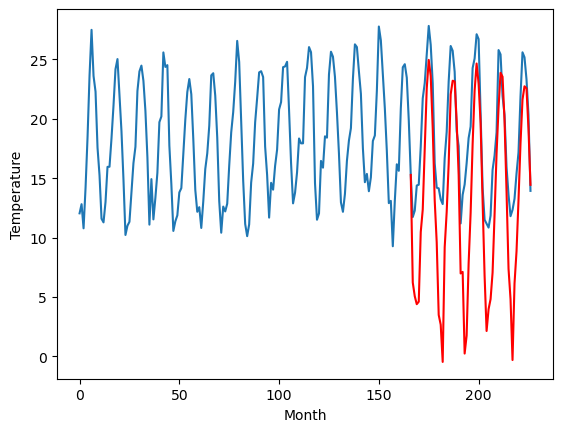

Weather Station 10:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
4.05		6.33		2.28
3.64		5.18		1.54
3.35		4.52		1.17
4.39		4.73		0.34
9.62		10.59		0.97
10.92		12.48		1.56
13.52		17.59		4.07
18.81		22.67		3.86
21.80		25.07		3.27
20.80		23.73		2.93
16.77		19.35		2.58
12.85		13.26		0.41
8.24		9.75		1.51
1.24		3.64		2.40
0.83		2.82		1.99
1.33		-0.32		-1.65
8.21		9.33		1.12
11.00		12.30		1.30
15.02		16.37		1.35
19.31		22.18		2.87
20.88		23.34		2.46
20.97		23.28		2.31
16.86		19.93		3.07
13.58		15.39		1.81
4.67		7.11		2.44
6.59		7.25		0.66
0.11		0.38		0.27
4.13		1.90		-2.23
8.24		7.98		-0.26
11.53		12.22		0.69
16.38		18.01		1.63
20.14		22.51		2.37
21.58		24.79		3.21
20.20		23.10		2.90
16.89		19.77		2.88
9.58		13.23		3.65
7.46		6.93		-0.53
0.93		2.28		1.35
4.13		4.13		-0.00
7.15		4.97		-2.18
7.60		7.20		-0.40
11.12		12.08		0.96
13.90		17.21		3.31
17.56		21.09		3.53
21.15		24.01		2.86
20.60		23.68		3.08
16.64		19.98		3.34
11.35		14.01		2.66
5.45		7.51		2.06
2.98		4

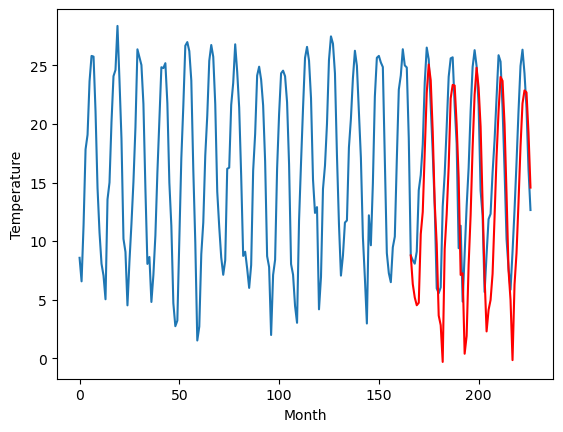

Weather Station 11:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
1.65		4.42		2.77
2.25		3.28		1.03
1.81		2.62		0.81
1.61		2.83		1.22
7.65		8.70		1.05
8.08		10.59		2.51
12.12		15.70		3.58
17.49		20.77		3.28
20.78		23.18		2.40
19.52		21.84		2.32
15.57		17.46		1.89
10.91		11.37		0.46
5.86		7.86		2.00
-1.20		1.75		2.95
-0.87		0.94		1.81
0.48		-2.21		-2.69
6.69		7.44		0.75
8.66		10.41		1.75
13.57		14.48		0.91
18.98		20.30		1.32
20.29		21.45		1.16
20.37		21.40		1.03
15.88		18.04		2.16
12.12		13.50		1.38
1.90		5.22		3.32
4.00		5.36		1.36
-2.87		-1.51		1.36
1.72		0.01		-1.71
6.27		6.10		-0.17
9.43		10.35		0.92
15.67		16.13		0.46
19.32		20.64		1.32
20.67		22.93		2.26
19.42		21.23		1.81
15.27		17.91		2.64
7.99		11.37		3.38
5.54		5.07		-0.47
0.08		0.43		0.35
2.00		2.27		0.27
4.79		3.12		-1.67
5.32		5.35		0.03
10.21		10.23		0.02
13.56		15.37		1.81
16.47		19.25		2.78
20.02		22.18		2.16
19.31		21.84		2.53
16.53		18.14		1.61
10.48		12.19		1.71
4.27		5.68		1.41
1.42		3.1

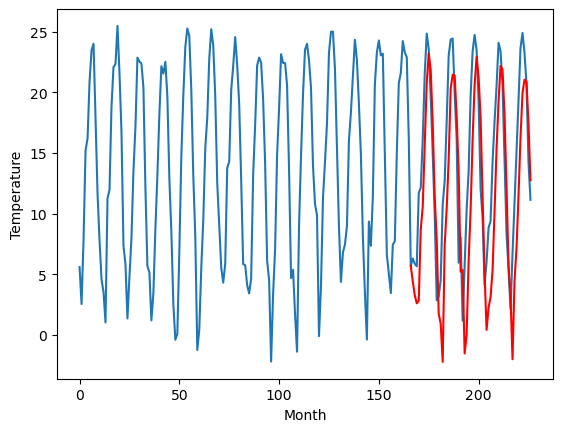

RangeIndex(start=1, stop=12, step=1)
[2.9200000000000017, 1.5699999999999985, 5.66, -0.009999999999999787, -0.3200000000000003, -0.39000000000000057, 10.42, -3.430000000000002, 9.339999999999996, 4.050000000000001, 1.6500000000000021]
[4.420508518218995, -0.9492754745483403, 4.321782150268554, 0.847023792266846, 0.8897226905822748, -1.4399301719665525, 10.10190279006958, -5.03895980834961, 6.217189254760742, 6.329950141906739, 4.422157897949219]
Predictions for (t+0):
    Weather_Station  Actual  Predicted
0                 0    2.92   4.420509
1                 1    1.57  -0.949275
2                 2    5.66   4.321782
3                 3   -0.01   0.847024
4                 4   -0.32   0.889723
5                 5   -0.39  -1.439930
6                 6   10.42  10.101903
7                 7   -3.43  -5.038960
8                 8    9.34   6.217189
9                 9    4.05   6.329950
10               10    1.65   4.422158


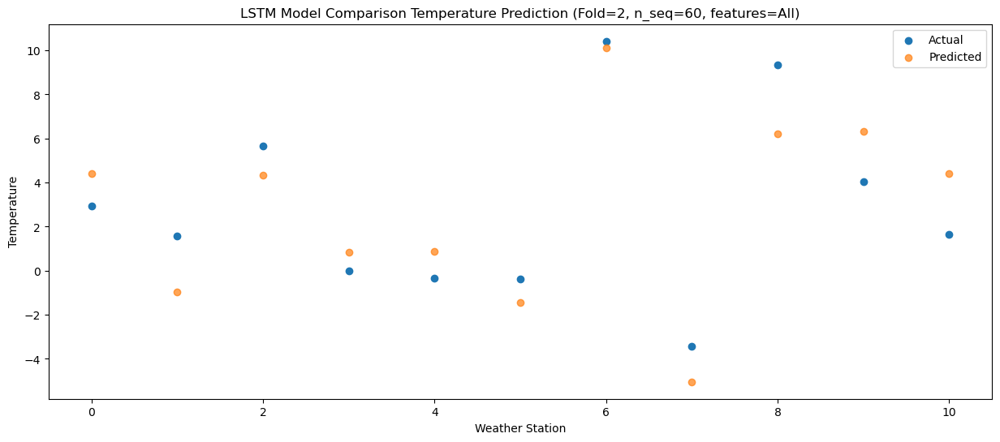

Predictions for (t+1):
    Weather_Station  Actual  Predicted
0                 0    3.26   3.294112
1                 1   -0.71  -2.077623
2                 2    4.54   3.190804
3                 3   -3.07  -0.288196
4                 4    0.03  -0.245311
5                 5   -1.82  -2.579829
6                 6    8.61   8.964629
7                 7   -7.96  -6.186730
8                 8    5.80   5.064696
9                 9    3.64   5.183025
10               10    2.25   3.282495


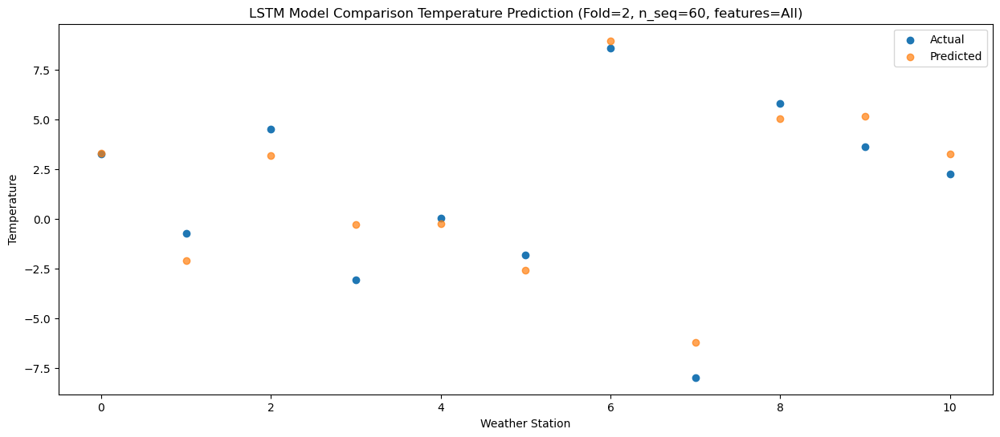

Predictions for (t+2):
    Weather_Station  Actual  Predicted
0                 0    2.67   2.634682
1                 1   -0.95  -2.736183
2                 2    3.39   2.530498
3                 3   -2.80  -0.948941
4                 4    0.37  -0.908742
5                 5   -1.45  -3.243600
6                 6    8.96   8.298815
7                 7   -6.71  -6.850284
8                 8    6.34   4.396634
9                 9    3.35   4.518391
10               10    1.81   2.619484


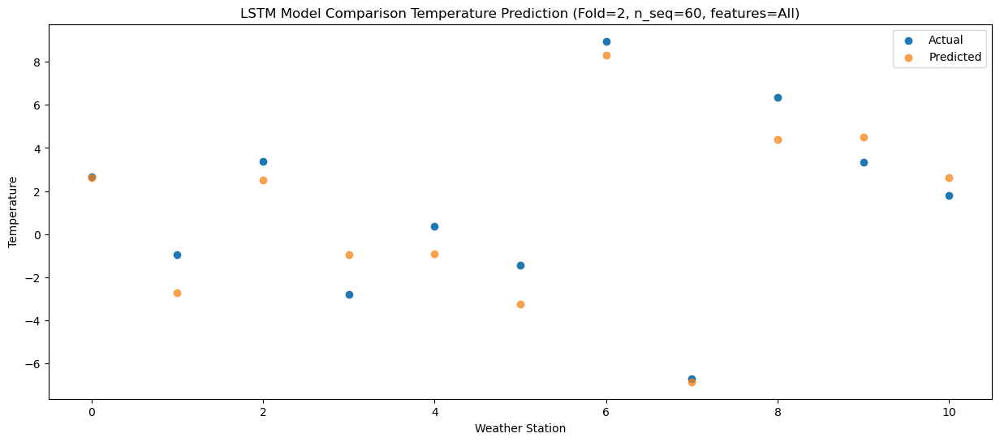

Predictions for (t+3):
    Weather_Station  Actual  Predicted
0                 0    2.48   2.847365
1                 1   -1.68  -2.527693
2                 2    4.43   2.741209
3                 3   -2.65  -0.739301
4                 4    1.01  -0.698939
5                 5   -2.21  -3.036891
6                 6    8.40   8.501819
7                 7   -5.90  -6.641254
8                 8    8.45   4.606867
9                 9    4.39   4.728311
10               10    1.61   2.828308


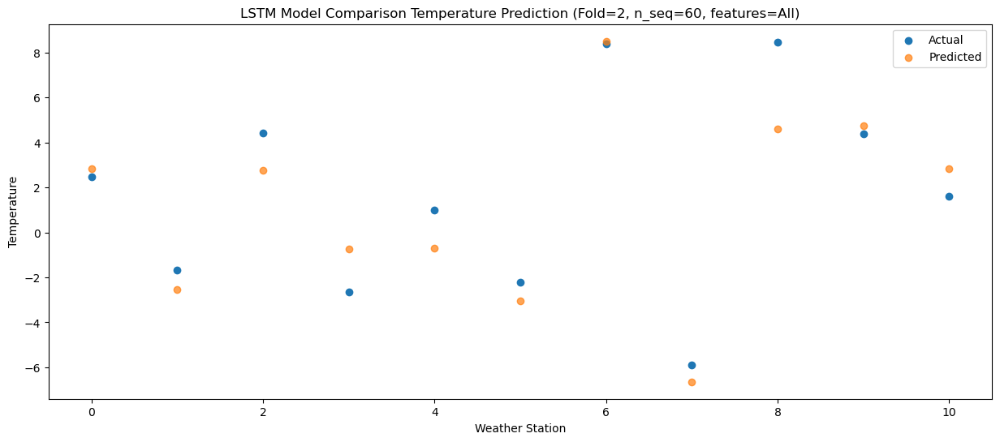

Predictions for (t+4):
    Weather_Station  Actual  Predicted
0                 0    9.07   8.727845
1                 1    6.33   3.348005
2                 2    8.05   8.614070
3                 3    0.90   5.129048
4                 4    7.70   5.176093
5                 5    5.88   2.837027
6                 6   16.05  14.371014
7                 7   -1.40  -0.767375
8                 8    8.52  10.470907
9                 9    9.62  10.590631
10               10    7.65   8.696603


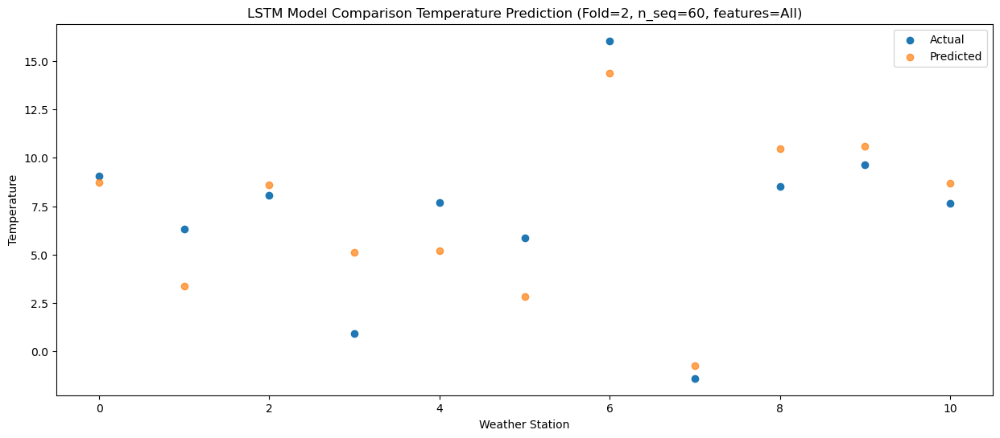

Predictions for (t+5):
    Weather_Station  Actual  Predicted
0                 0   10.55  10.629505
1                 1    8.56   5.247740
2                 2    9.44  10.510231
3                 3    2.13   7.020027
4                 4    7.17   7.068847
5                 5    5.85   4.732866
6                 6   16.36  16.269711
7                 7    3.58   1.120076
8                 8   11.73  12.358080
9                 9   10.92  12.481655
10               10    8.08  10.588677


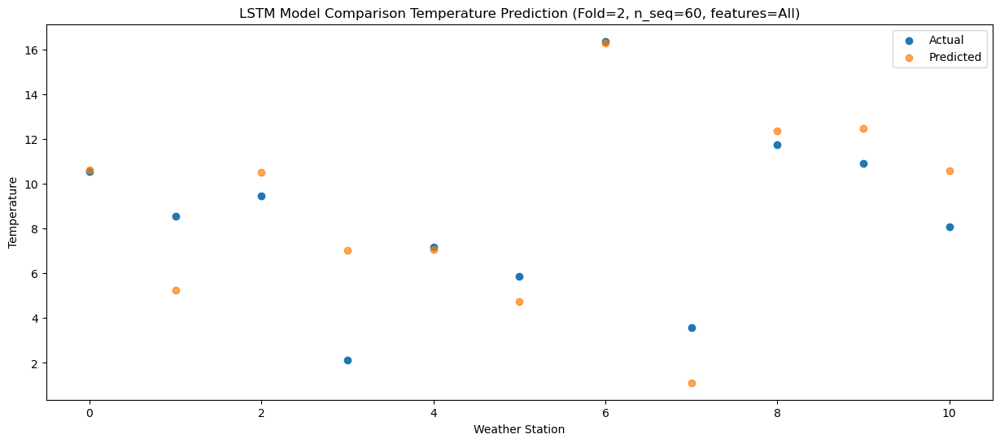

Predictions for (t+6):
    Weather_Station  Actual  Predicted
0                 0   15.84  15.735891
1                 1   15.36  10.351412
2                 2   10.75  15.618247
3                 3    8.02  12.132012
4                 4   10.14  12.181378
5                 5    9.69   9.844597
6                 6   21.26  21.378860
7                 7    9.87   6.238025
8                 8   15.78  17.477569
9                 9   13.52  17.592590
10               10   12.12  15.695283


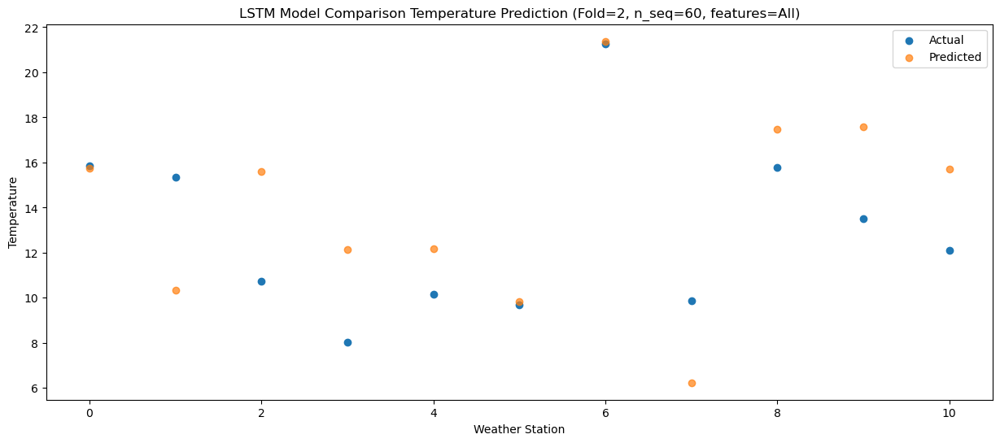

Predictions for (t+7):
    Weather_Station  Actual  Predicted
0                 0   20.84  20.821425
1                 1   22.56  15.431164
2                 2   13.34  20.695091
3                 3   14.08  17.203818
4                 4   13.18  17.256458
5                 5   13.30  14.914405
6                 6   26.00  26.446938
7                 7   13.39  11.301484
8                 8   17.07  22.542226
9                 9   18.81  22.666249
10               10   17.49  20.774732


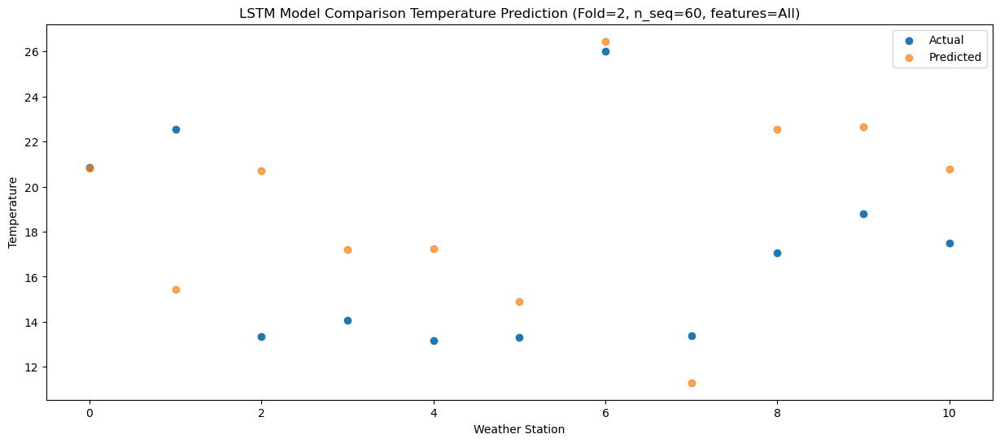

Predictions for (t+8):
    Weather_Station  Actual  Predicted
0                 0   23.00  23.238313
1                 1   22.59  17.847789
2                 2   13.98  23.110336
3                 3   18.36  19.615653
4                 4   13.92  19.665332
5                 5   15.00  17.324178
6                 6   27.18  28.854955
7                 7   15.49  13.718590
8                 8   19.48  24.950441
9                 9   21.80  25.074723
10               10   20.78  23.183667


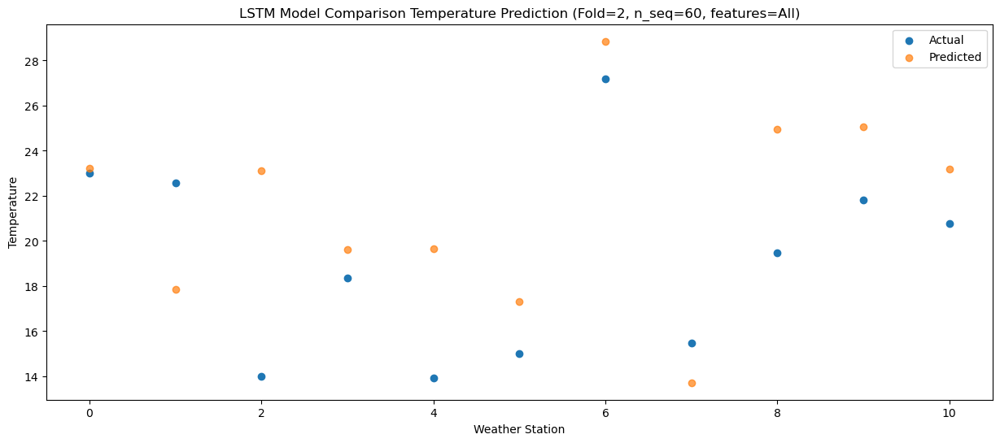

Predictions for (t+9):
    Weather_Station  Actual  Predicted
0                 0   21.02  21.908747
1                 1   21.26  16.506807
2                 2   13.67  21.776072
3                 3   16.51  18.266530
4                 4   14.29  18.325067
5                 5   15.30  15.979201
6                 6   27.41  27.507506
7                 7   15.93  12.366613
8                 8   21.88  23.598480
9                 9   20.80  23.730343
10               10   19.52  21.839997


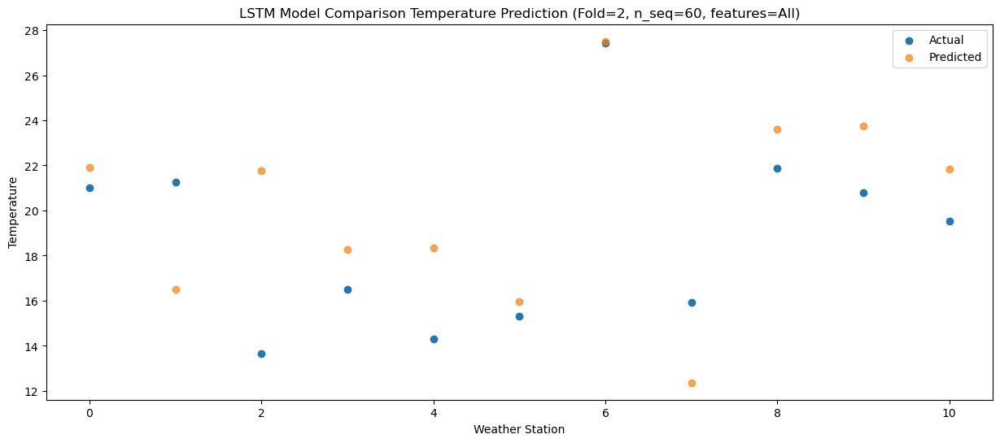

Predictions for (t+10):
    Weather_Station  Actual  Predicted
0                 0   18.18  17.530863
1                 1   15.13  12.123900
2                 2   12.41  17.385586
3                 3   11.93  13.880946
4                 4   11.94  13.944044
5                 5   10.90  11.601053
6                 6   21.47  23.126747
7                 7    9.68   7.984325
8                 8   20.28  19.214606
9                 9   16.77  19.349718
10               10   15.57  17.457084


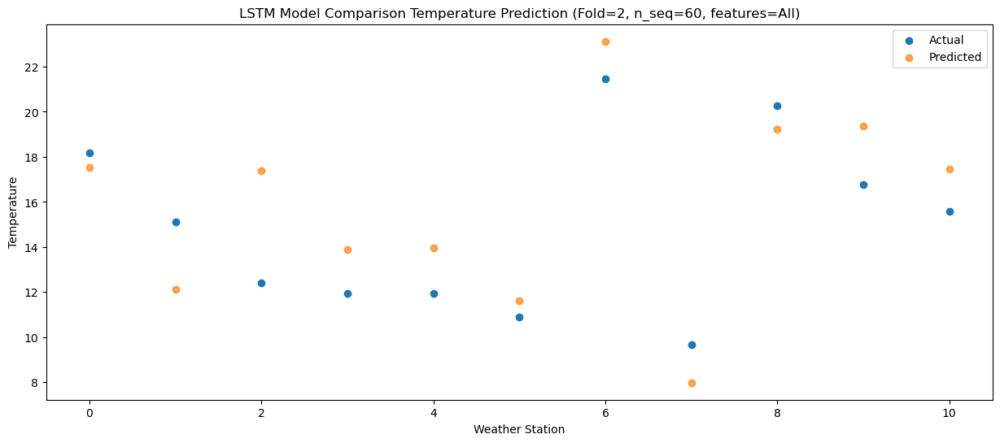

Predictions for (t+11):
    Weather_Station  Actual  Predicted
0                 0   11.17  11.458737
1                 1    8.14   6.034826
2                 2   11.14  11.300395
3                 3    6.71   7.799361
4                 4    8.25   7.861944
5                 5    6.43   5.517009
6                 6   15.99  17.039343
7                 7    4.08   1.888275
8                 8   17.04  13.117895
9                 9   12.85  13.261058
10               10   10.91  11.370974


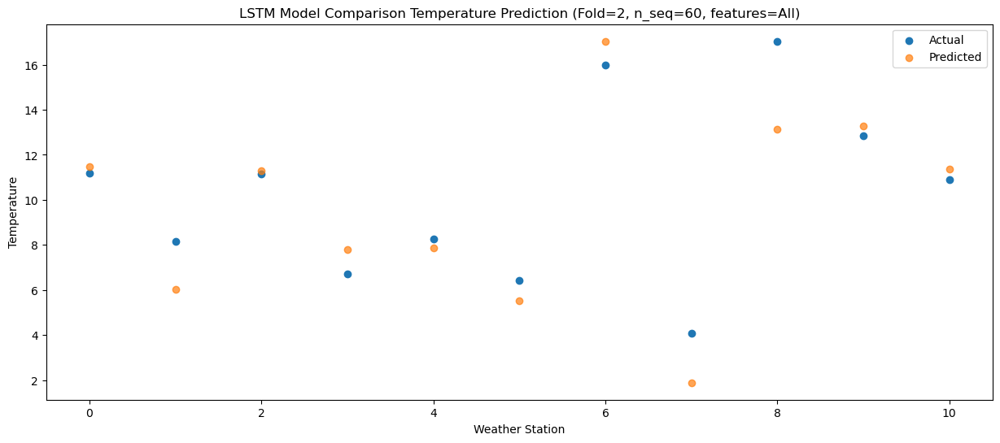

Predictions for (t+12):
    Weather_Station  Actual  Predicted
0                 0    8.04   7.963123
1                 1    5.02   2.535189
2                 2    7.72   7.797869
3                 3    2.75   4.296113
4                 4    4.13   4.358631
5                 5    3.75   2.010125
6                 6   13.50  13.529412
7                 7   -1.48  -1.626062
8                 8   10.32   9.598739
9                 9    8.24   9.745036
10               10    5.86   7.858664


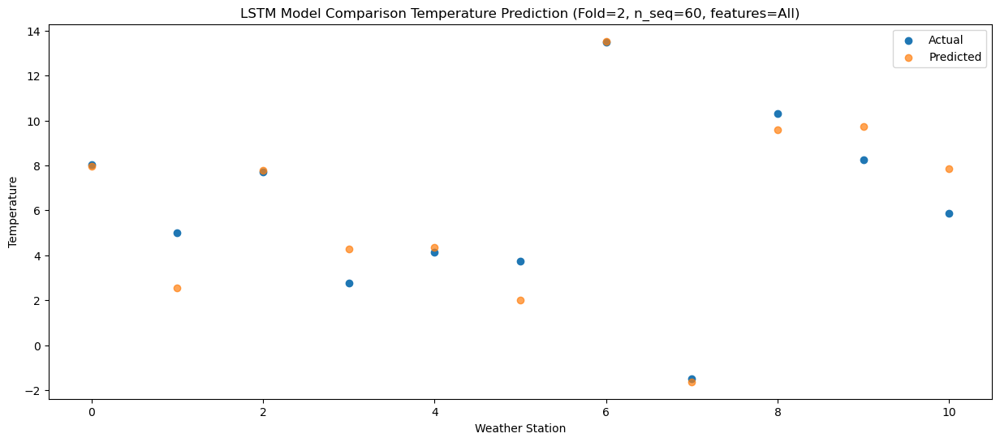

Predictions for (t+13):
    Weather_Station  Actual  Predicted
0                 0    1.28   1.860507
1                 1   -1.61  -3.566966
2                 2    0.73   1.700799
3                 3   -4.08  -1.807642
4                 4   -2.17  -1.741556
5                 5   -2.36  -4.091010
6                 6    7.04   7.426077
7                 7   -9.13  -7.731373
8                 8    8.27   3.491610
9                 9    1.24   3.638463
10               10   -1.20   1.752953


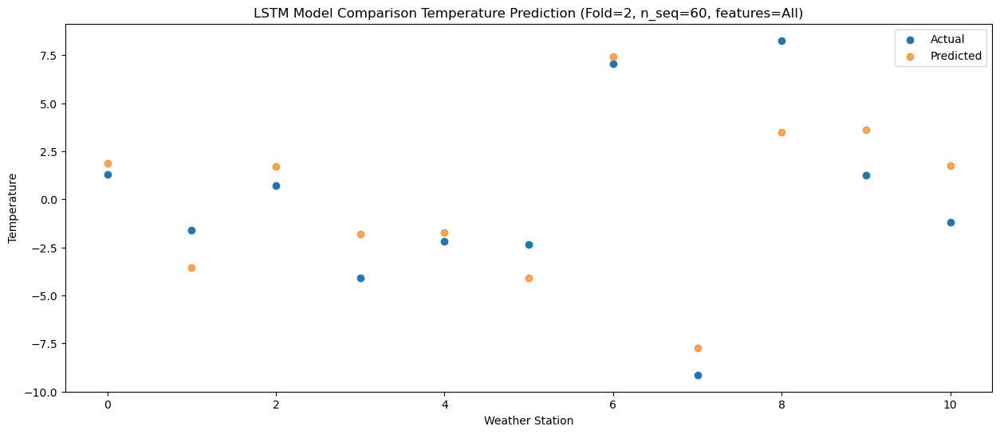

Predictions for (t+14):
    Weather_Station  Actual  Predicted
0                 0    1.02   1.031523
1                 1   -1.69  -4.392786
2                 2    1.39   0.886300
3                 3   -7.16  -2.627514
4                 4   -1.82  -2.562938
5                 5   -2.95  -4.911259
6                 6    6.34   6.609395
7                 7   -8.59  -8.546377
8                 8    8.21   2.672762
9                 9    0.83   2.820956
10               10   -0.87   0.935044


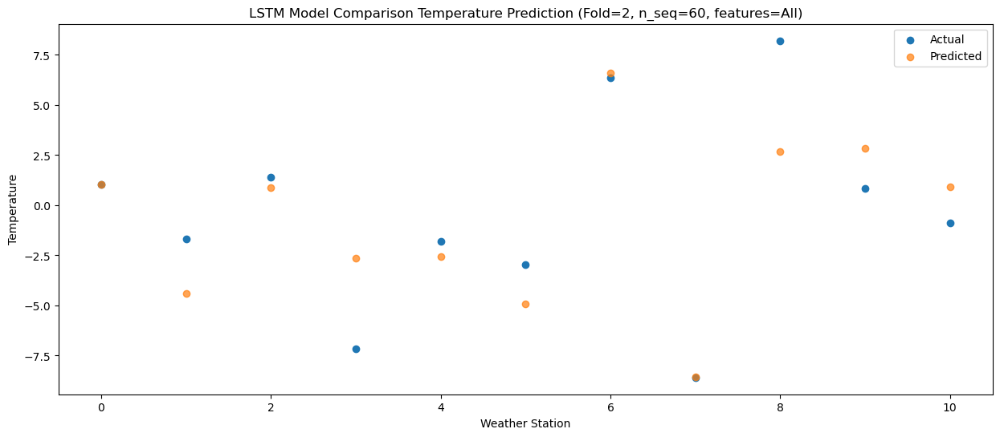

Predictions for (t+15):
    Weather_Station  Actual  Predicted
0                 0   -3.38  -2.120893
1                 1   -5.73  -7.538843
2                 2    4.12  -2.261654
3                 3   -7.14  -5.779044
4                 4   -2.56  -5.711707
5                 5   -5.30  -8.052913
6                 6    3.23   3.467133
7                 7   -5.67 -11.681572
8                 8    7.29  -0.462433
9                 9    1.33  -0.319980
10               10    0.48  -2.211036


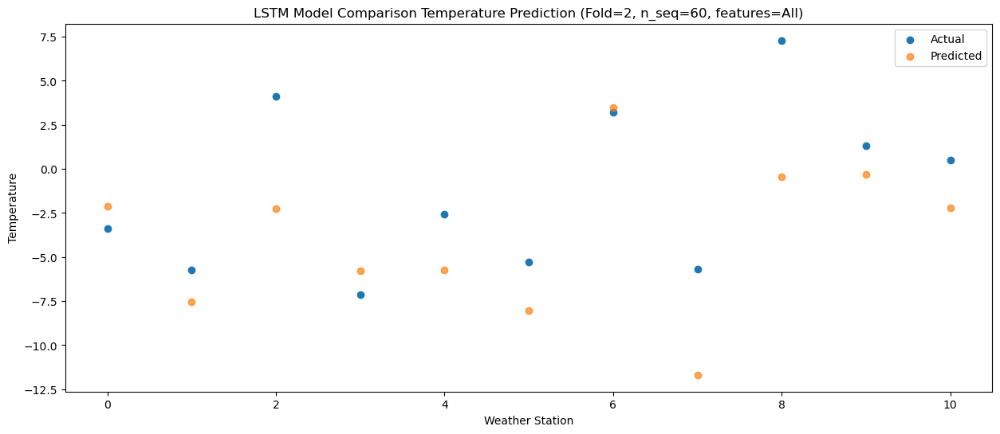

Predictions for (t+16):
    Weather_Station  Actual  Predicted
0                 0    9.04   7.539979
1                 1    4.46   2.122973
2                 2    5.93   7.390549
3                 3   -3.03   3.879335
4                 4    4.77   3.939370
5                 5    3.08   1.599765
6                 6   13.60  13.122593
7                 7   -2.57  -2.034483
8                 8    6.89   9.185965
9                 9    8.21   9.329674
10               10    6.69   7.440077


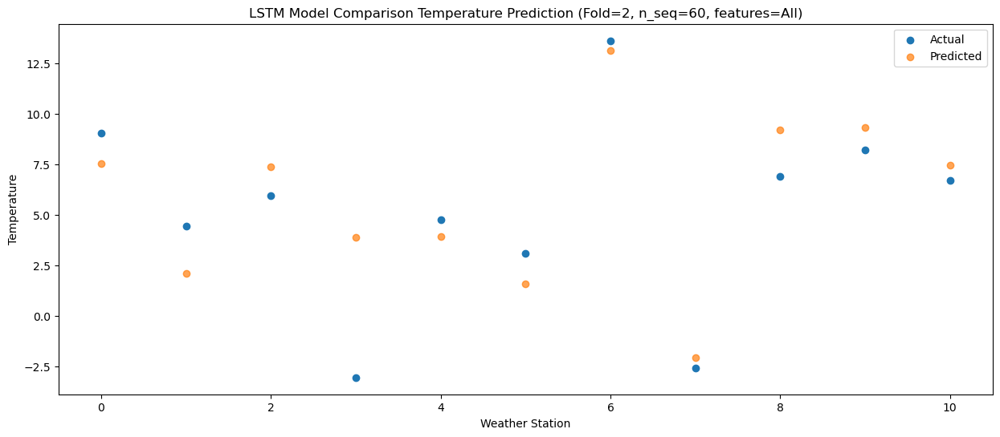

Predictions for (t+17):
    Weather_Station  Actual  Predicted
0                 0   10.91  10.502812
1                 1    8.22   5.090770
2                 2    7.74  10.356829
3                 3    1.47   6.845523
4                 4    5.64   6.909810
5                 5    5.20   4.568268
6                 6   15.30  16.086338
7                 7    4.09   0.934001
8                 8   10.75  12.155130
9                 9   11.00  12.297754
10               10    8.66  10.409432


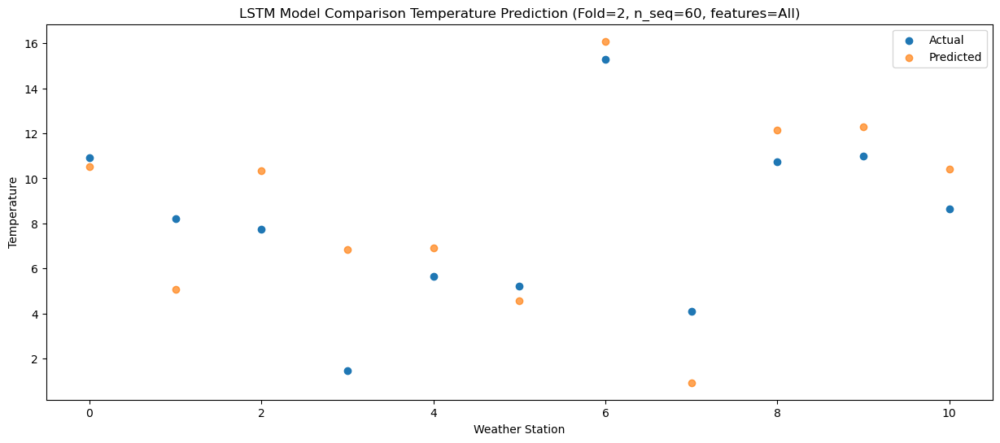

Predictions for (t+18):
    Weather_Station  Actual  Predicted
0                 0   15.69  14.588318
1                 1   13.40   9.171257
2                 2   11.32  14.430264
3                 3    6.73  10.912161
4                 4   10.11  10.976815
5                 5    9.24   8.641845
6                 6   19.38  20.156816
7                 7    9.10   4.998965
8                 8   12.97  16.224951
9                 9   15.02  16.369111
10               10   13.57  14.482618


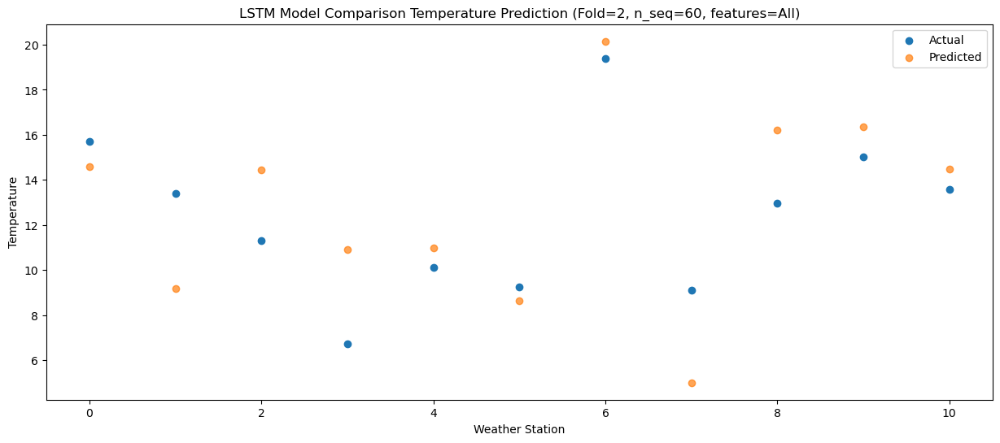

Predictions for (t+19):
    Weather_Station  Actual  Predicted
0                 0   20.94  20.415676
1                 1   20.65  15.007366
2                 2   12.54  20.249080
3                 3   12.30  16.734024
4                 4   13.59  16.786908
5                 5   13.79  14.452077
6                 6   24.94  25.973025
7                 7   14.09  10.826072
8                 8   17.21  22.048990
9                 9   19.31  22.184576
10               10   18.98  20.303998


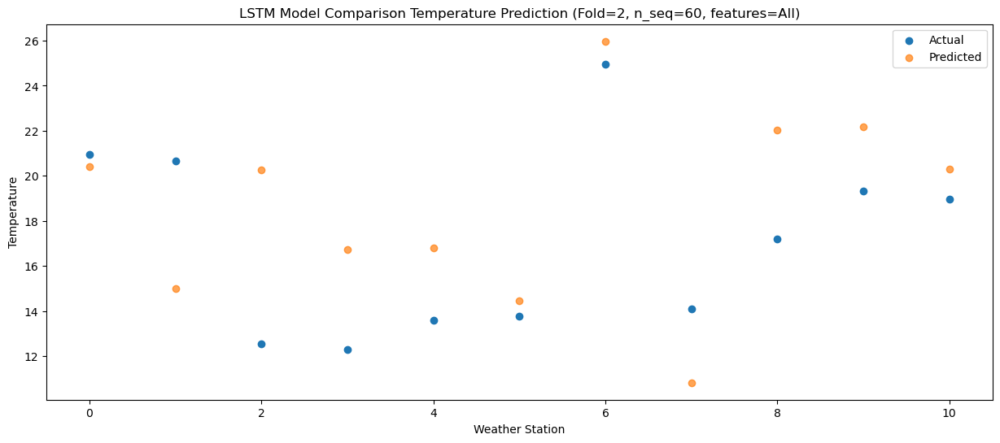

Predictions for (t+20):
    Weather_Station  Actual  Predicted
0                 0   21.95  21.565940
1                 1   21.34  16.156153
2                 2   13.33  21.401155
3                 3   14.30  17.883066
4                 4   14.18  17.931764
5                 5   13.87  15.597037
6                 6   25.83  27.122638
7                 7   12.89  11.975985
8                 8   20.19  23.198846
9                 9   20.88  23.335386
10               10   20.29  21.451233


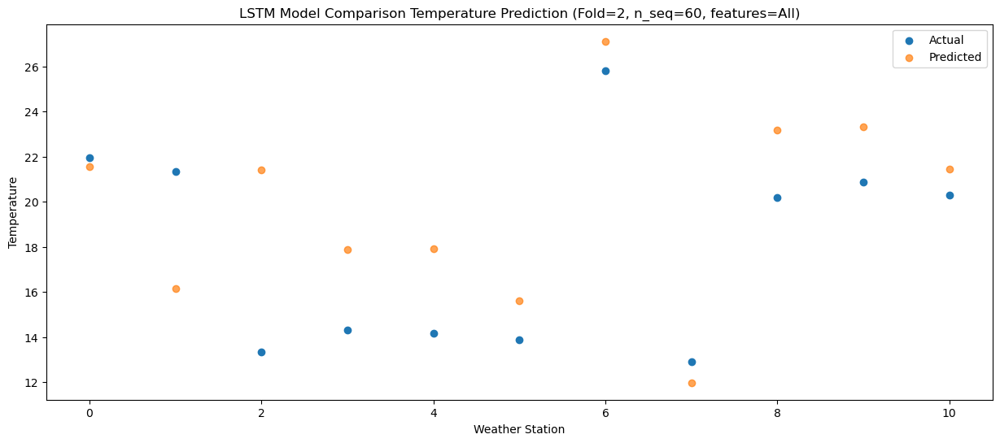

Predictions for (t+21):
    Weather_Station  Actual  Predicted
0                 0   22.40  21.519476
1                 1   22.10  16.101416
2                 2   13.38  21.342239
3                 3   15.36  17.823671
4                 4   14.35  17.870737
5                 5   14.98  15.545567
6                 6   26.39  27.074596
7                 7   12.37  11.917532
8                 8   19.79  23.141531
9                 9   20.97  23.280505
10               10   20.37  21.397879


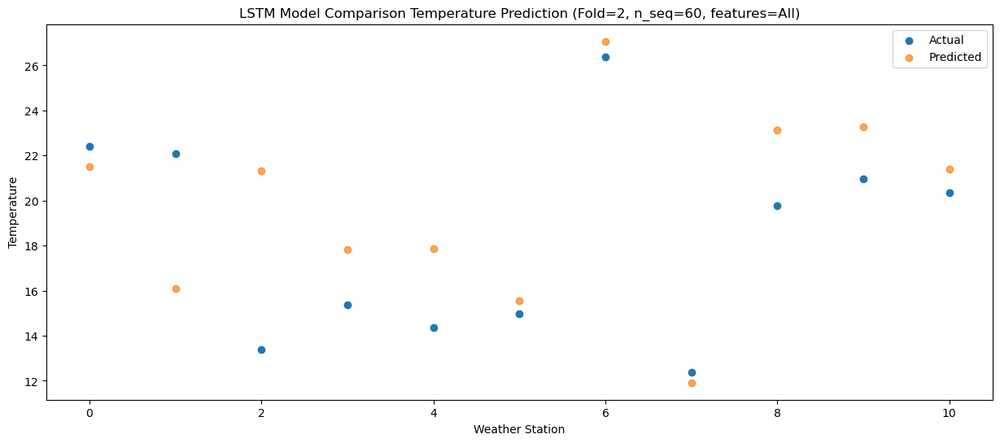

Predictions for (t+22):
    Weather_Station  Actual  Predicted
0                 0   19.10  18.159649
1                 1   19.86  12.746771
2                 2   12.10  17.981389
3                 3   12.19  14.465917
4                 4   11.81  14.512709
5                 5   12.24  12.195138
6                 6   24.12  23.724748
7                 7   10.19   8.571848
8                 8   18.01  19.796058
9                 9   16.86  19.928551
10               10   15.88  18.041148


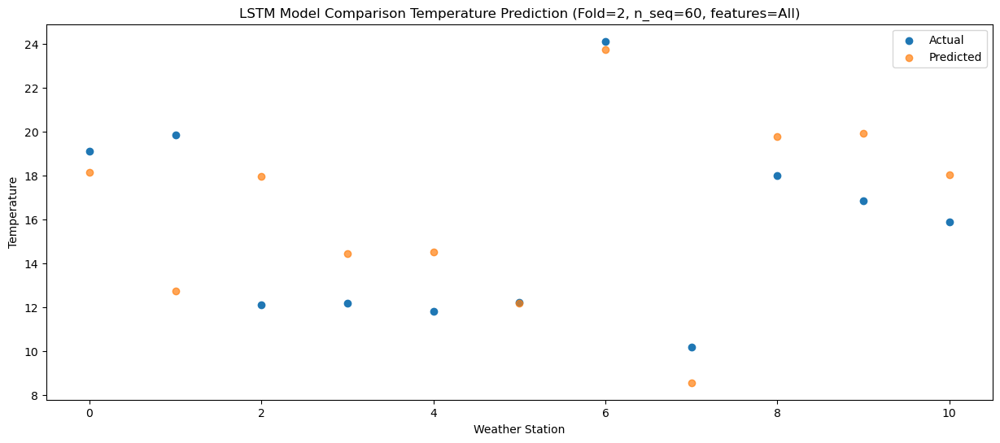

Predictions for (t+23):
    Weather_Station  Actual  Predicted
0                 0   14.35  13.612154
1                 1   11.60   8.201937
2                 2   10.96  13.439194
3                 3    8.36   9.925451
4                 4    9.07   9.968828
5                 5    8.94   7.649960
6                 6   19.61  19.177458
7                 7    3.63   4.034782
8                 8   13.03  15.252767
9                 9   13.58  15.391769
10               10   12.12  13.502675


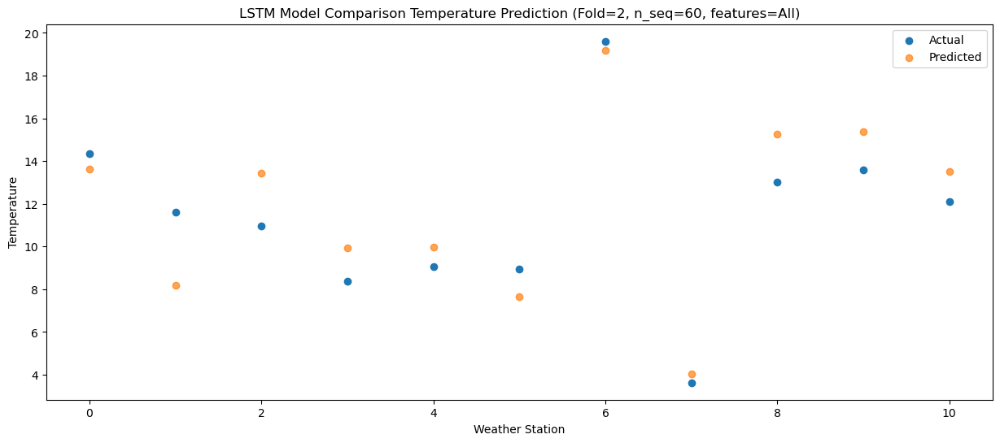

Predictions for (t+24):
    Weather_Station  Actual  Predicted
0                 0    4.73   5.309091
1                 1    4.89  -0.089322
2                 2    4.11   5.149259
3                 3    0.28   1.642956
4                 4    0.80   1.682340
5                 5    1.30  -0.631155
6                 6   11.64  10.895353
7                 7   -1.77  -4.238112
8                 8   11.77   6.980288
9                 9    4.67   7.107697
10               10    1.90   5.221670


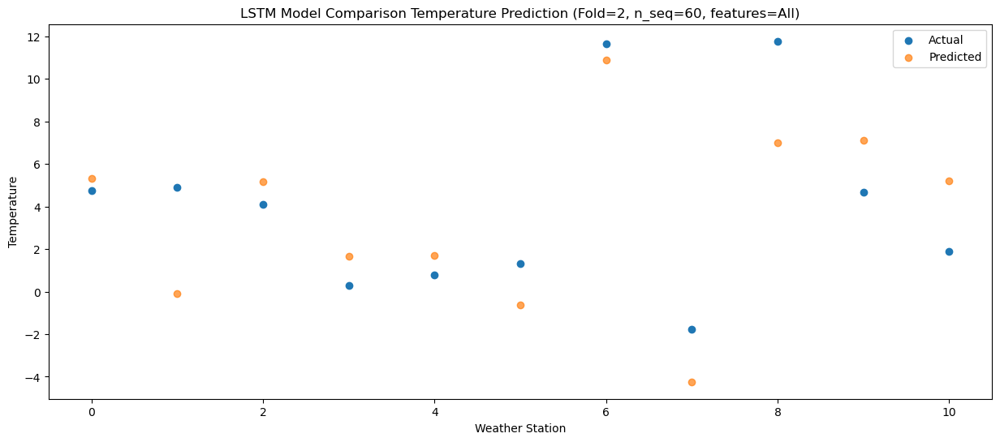

Predictions for (t+25):
    Weather_Station  Actual  Predicted
0                 0    7.82   5.445981
1                 1    2.50   0.039847
2                 2    5.01   5.287153
3                 3   -1.64   1.770852
4                 4    4.21   1.817482
5                 5    4.54  -0.496486
6                 6   13.93  11.032622
7                 7   -5.12  -4.104045
8                 8    5.26   7.112056
9                 9    6.59   7.247506
10               10    4.00   5.357848


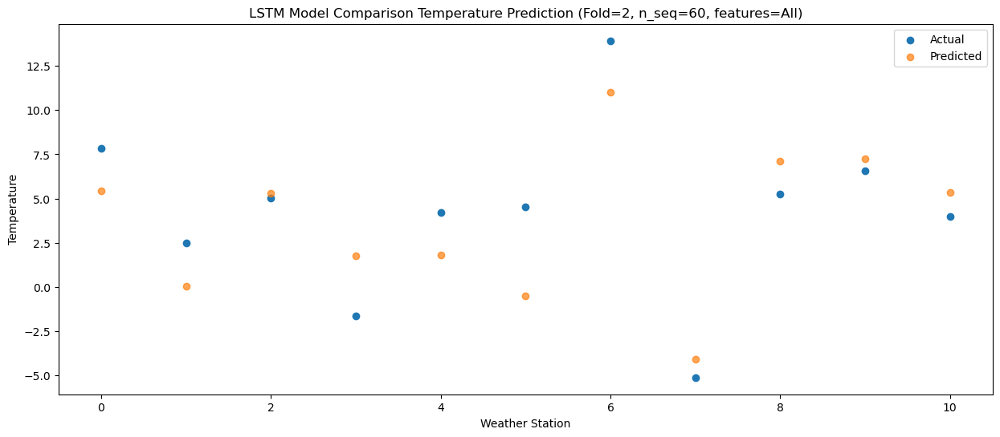

Predictions for (t+26):
    Weather_Station  Actual  Predicted
0                 0   -1.48  -1.423845
1                 1   -2.19  -6.835008
2                 2    0.75  -1.591444
3                 3   -7.79  -5.104741
4                 4   -3.52  -5.051606
5                 5   -3.89  -7.366457
6                 6    5.45   4.158693
7                 7   -8.12 -10.979149
8                 8    7.67   0.241836
9                 9    0.11   0.378566
10               10   -2.87  -1.512680


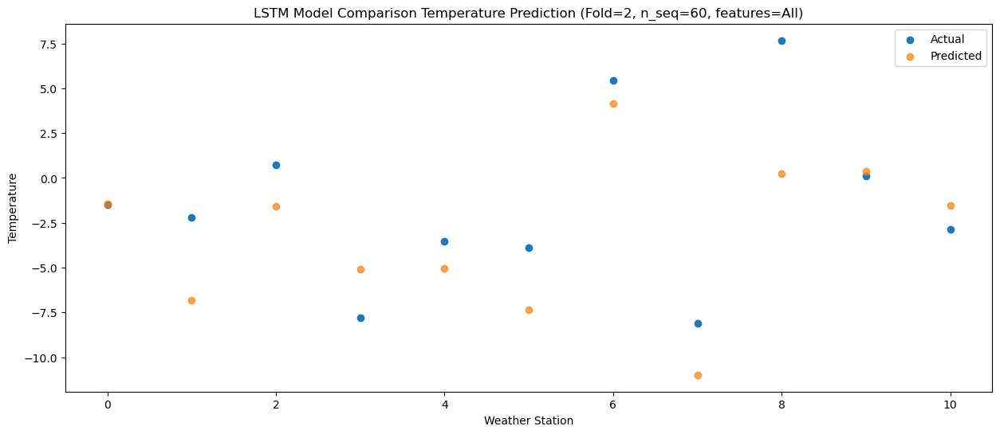

Predictions for (t+27):
    Weather_Station  Actual  Predicted
0                 0    0.76   0.100878
1                 1   -2.20  -5.312088
2                 2    3.08  -0.067303
3                 3   -5.47  -3.588159
4                 4   -0.38  -3.532569
5                 5   -4.27  -5.849926
6                 6    5.28   5.673131
7                 7   -7.15  -9.463973
8                 8    8.54   1.756240
9                 9    4.13   1.895255
10               10    1.72   0.010272


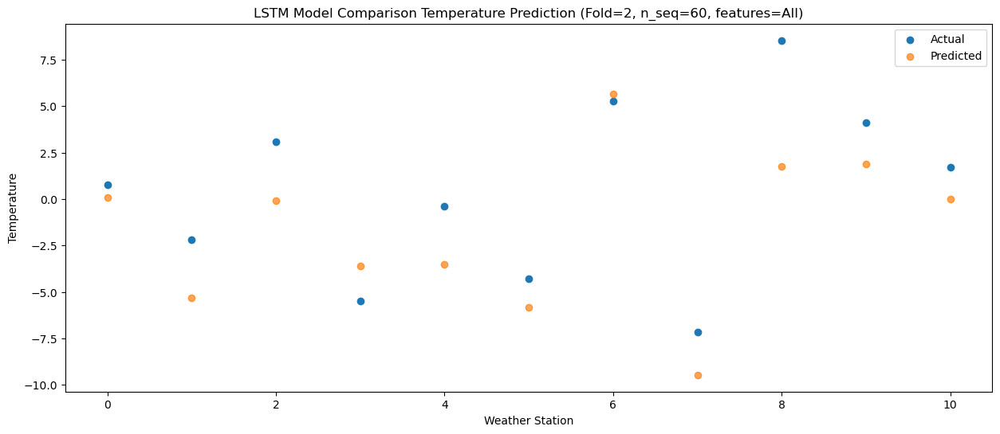

Predictions for (t+28):
    Weather_Station  Actual  Predicted
0                 0    7.05   6.183153
1                 1    4.78   0.777906
2                 2    6.55   6.014983
3                 3   -1.61   2.491349
4                 4    3.38   2.542576
5                 5    1.85   0.225811
6                 6   11.86  11.751297
7                 7   -2.09  -3.381459
8                 8   10.33   7.835862
9                 9    8.24   7.978730
10               10    6.27   6.100352


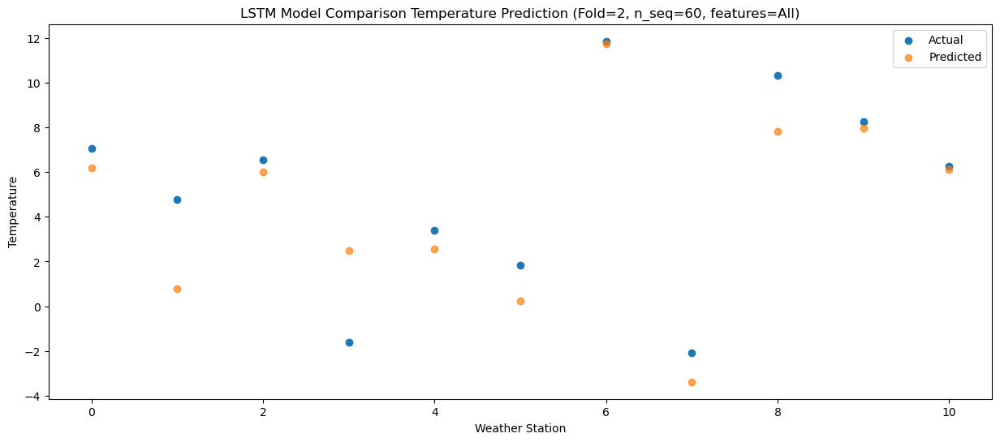

Predictions for (t+29):
    Weather_Station  Actual  Predicted
0                 0   11.08  10.432112
1                 1   11.46   5.026926
2                 2    8.36  10.262603
3                 3    2.83   6.736038
4                 4    7.18   6.792393
5                 5    8.00   4.472580
6                 6   18.13  15.992293
7                 7    5.10   0.862514
8                 8   12.45  12.076165
9                 9   11.53  12.221869
10               10    9.43  10.345824


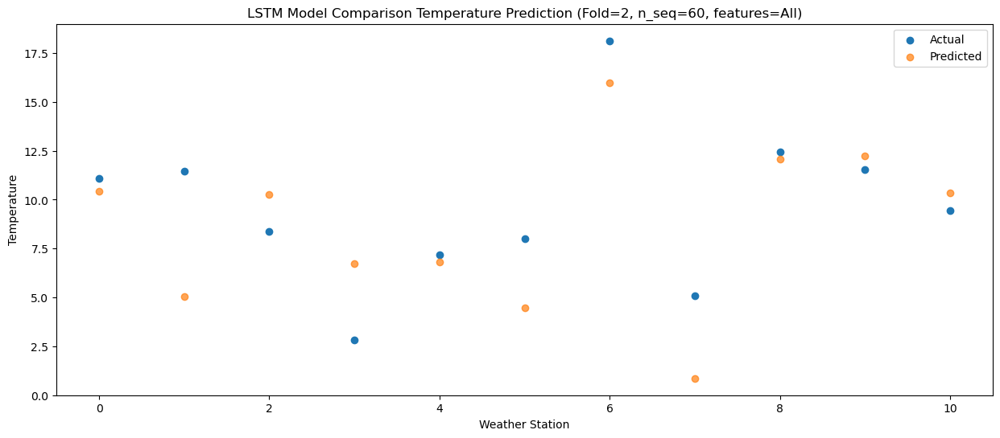

Predictions for (t+30):
    Weather_Station  Actual  Predicted
0                 0   17.63  16.220116
1                 1   17.26  10.813874
2                 2   11.12  16.049289
3                 3    8.17  12.530319
4                 4   12.34  12.577250
5                 5   12.60  10.257786
6                 6   23.15  21.776108
7                 7    9.80   6.652242
8                 8   13.41  17.868678
9                 9   16.38  18.009231
10               10   15.67  16.134134


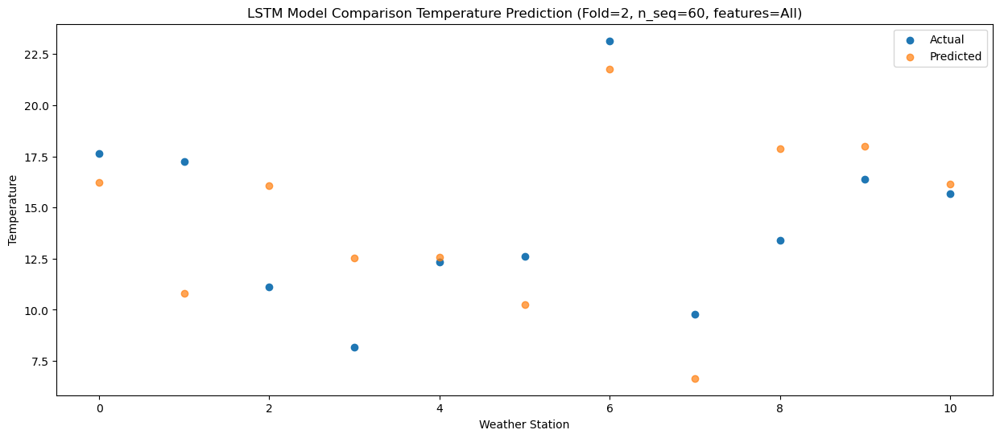

Predictions for (t+31):
    Weather_Station  Actual  Predicted
0                 0   21.68  20.720099
1                 1   21.06  15.315899
2                 2   12.93  20.549950
3                 3   12.41  17.027205
4                 4   14.93  17.086669
5                 5   16.32  14.766514
6                 6   27.86  26.280393
7                 7   13.66  11.153173
8                 8   18.33  22.371441
9                 9   20.14  22.511773
10               10   19.32  20.639624


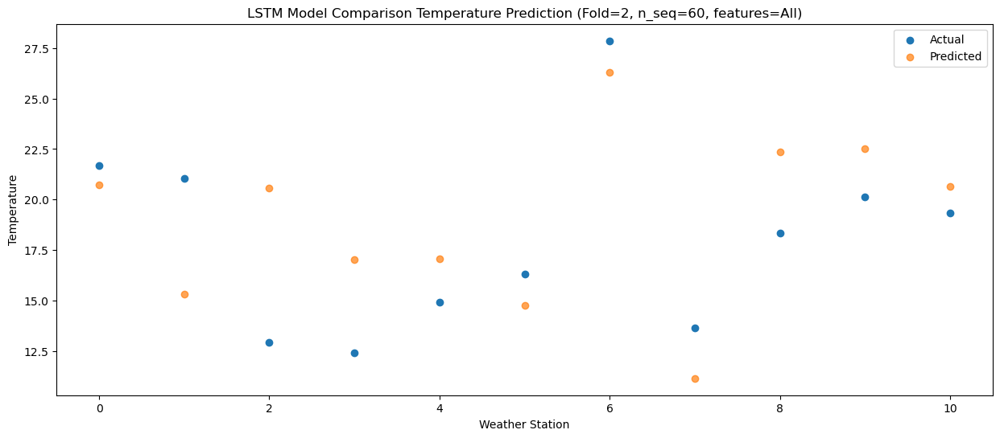

Predictions for (t+32):
    Weather_Station  Actual  Predicted
0                 0   24.18  23.020262
1                 1   24.30  17.618415
2                 2   13.11  22.846083
3                 3   17.03  19.324722
4                 4   14.76  19.377232
5                 5   17.68  17.049553
6                 6   30.65  28.564216
7                 7   14.80  13.434468
8                 8   19.14  24.647487
9                 9   21.58  24.794237
10               10   20.67  22.930783


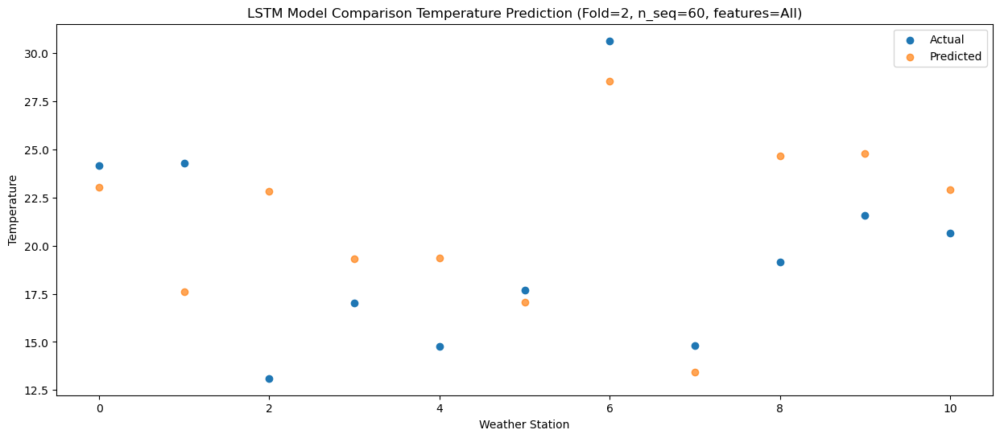

Predictions for (t+33):
    Weather_Station  Actual  Predicted
0                 0   21.63  21.311886
1                 1   21.99  15.914777
2                 2   12.54  21.137082
3                 3   16.95  17.621629
4                 4   13.94  17.679975
5                 5   14.96  15.352344
6                 6   27.84  26.867560
7                 7   11.78  11.736028
8                 8   21.18  22.951397
9                 9   20.20  23.097370
10               10   19.42  21.231353


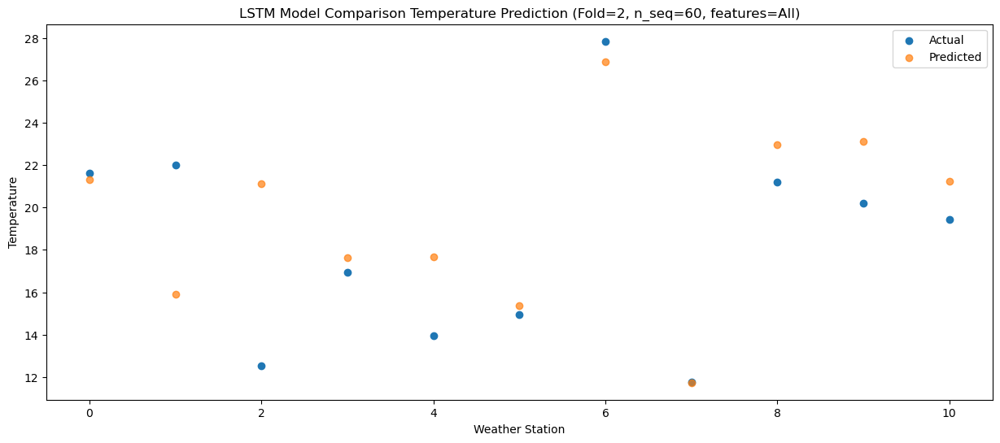

Predictions for (t+34):
    Weather_Station  Actual  Predicted
0                 0   19.88  17.993968
1                 1   19.23  12.590961
2                 2   11.13  17.809795
3                 3   11.91  14.292328
4                 4   11.97  14.360465
5                 5   12.30  12.034008
6                 6   24.01  23.547510
7                 7   10.05   8.410074
8                 8   20.77  19.624502
9                 9   16.89  19.773406
10               10   15.27  17.909366


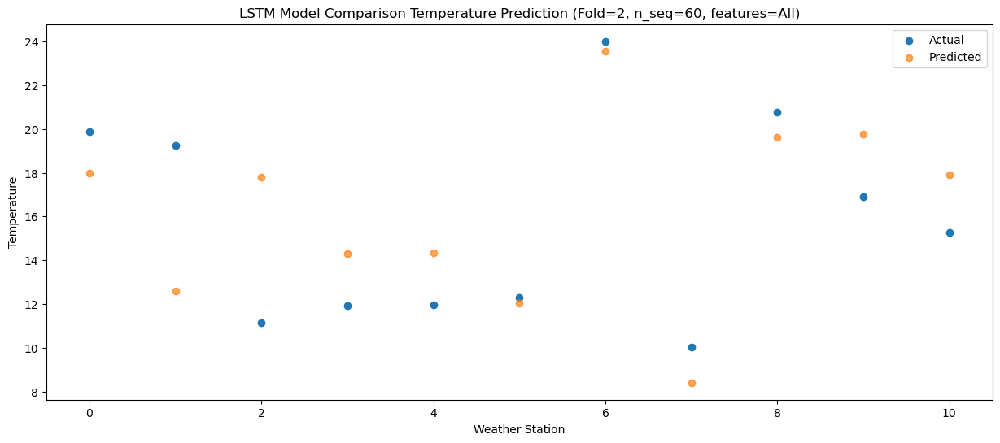

Predictions for (t+35):
    Weather_Station  Actual  Predicted
0                 0   11.54  11.455042
1                 1   10.85   6.045945
2                 2    8.50  11.269330
3                 3    6.47   7.753913
4                 4    5.78   7.823791
5                 5    6.73   5.491813
6                 6   17.63  17.001001
7                 7    1.84   1.863723
8                 8   14.50  13.079796
9                 9    9.58  13.226093
10               10    7.99  11.365551


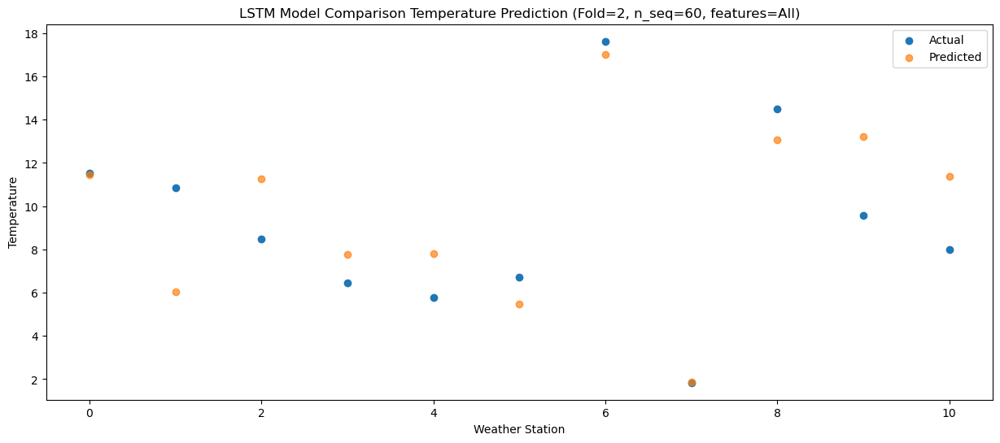

Predictions for (t+36):
    Weather_Station  Actual  Predicted
0                 0    5.41   5.160334
1                 1    0.86  -0.251244
2                 2    6.74   4.976462
3                 3    2.67   1.459678
4                 4    2.71   1.533080
5                 5    0.85  -0.802290
6                 6   10.96  10.705223
7                 7   -5.05  -4.432393
8                 8    8.27   6.786695
9                 9    7.46   6.933048
10               10    5.54   5.072101


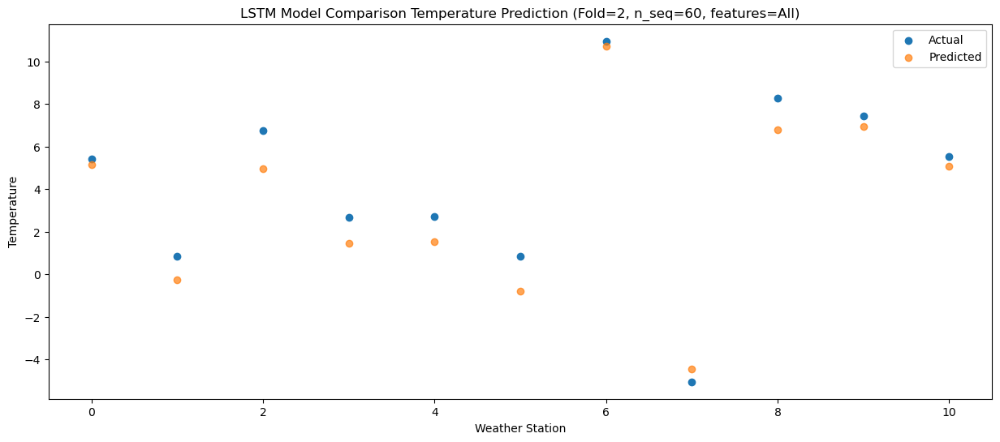

Predictions for (t+37):
    Weather_Station  Actual  Predicted
0                 0    1.90   0.532150
1                 1   -1.85  -4.879632
2                 2    2.64   0.346385
3                 3   -3.50  -3.171534
4                 4    0.20  -3.105133
5                 5   -1.38  -5.443036
6                 6    8.34   6.068456
7                 7   -7.22  -9.072602
8                 8    5.57   2.140360
9                 9    0.93   2.284371
10               10    0.08   0.426972


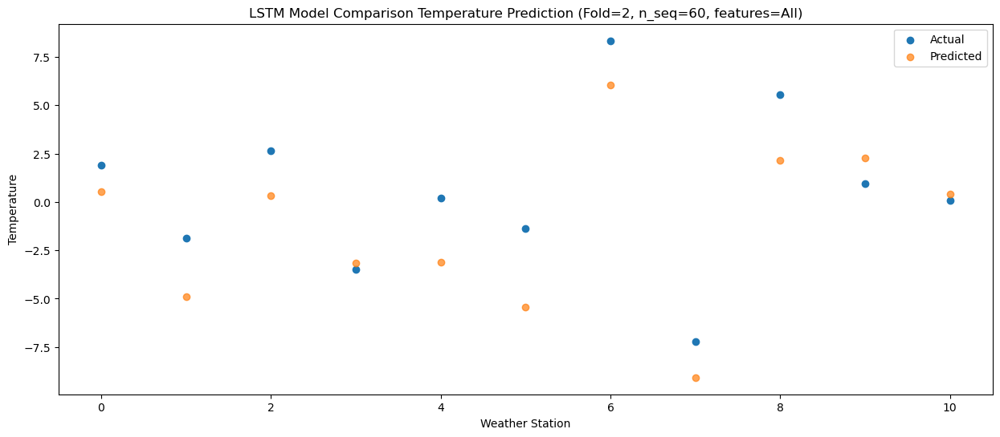

Predictions for (t+38):
    Weather_Station  Actual  Predicted
0                 0    3.92   2.381986
1                 1   -2.10  -3.023664
2                 2    2.44   2.198224
3                 3   -2.21  -1.317879
4                 4    1.37  -1.264837
5                 5   -0.62  -3.604794
6                 6    9.22   7.910501
7                 7   -7.93  -7.223179
8                 8    5.23   3.980341
9                 9    4.13   4.129568
10               10    2.00   2.274560


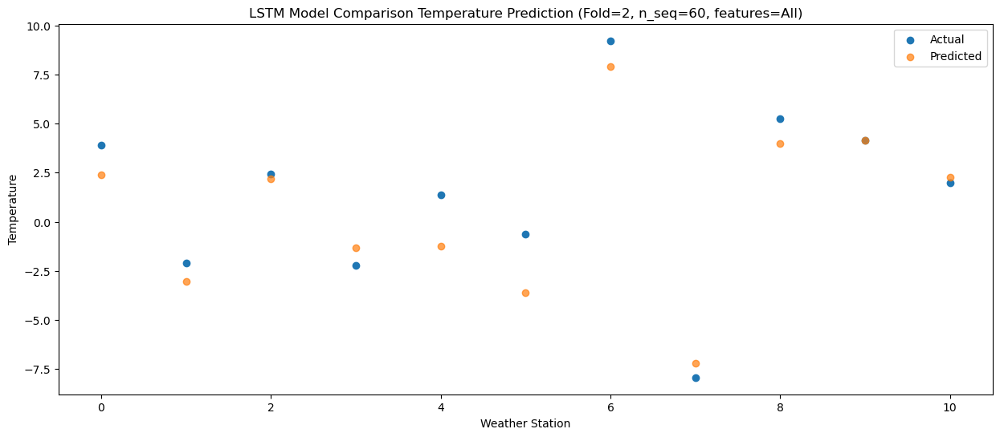

Predictions for (t+39):
    Weather_Station  Actual  Predicted
0                 0    4.94   3.224099
1                 1   -0.50  -2.181747
2                 2    5.50   3.043628
3                 3   -4.09  -0.466045
4                 4    3.50  -0.414063
5                 5    0.57  -2.763617
6                 6    9.41   8.745507
7                 7   -6.72  -6.380880
8                 8    4.91   4.822603
9                 9    7.15   4.971866
10               10    4.79   3.119802


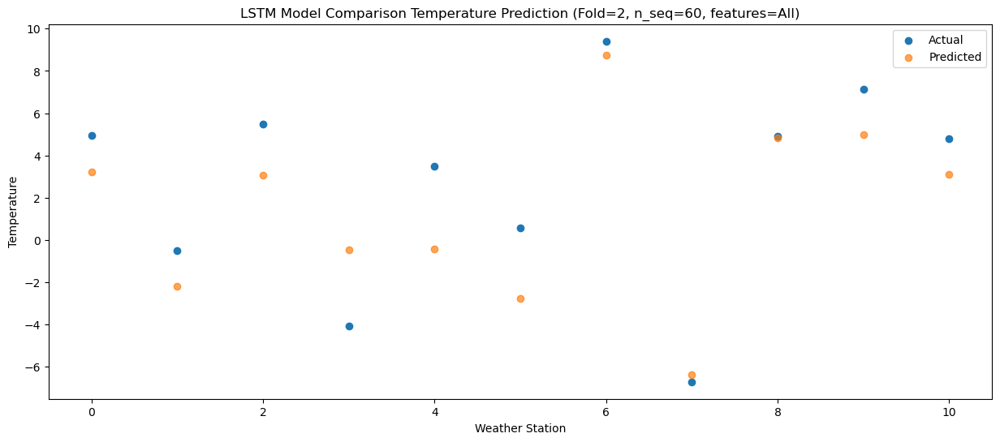

Predictions for (t+40):
    Weather_Station  Actual  Predicted
0                 0    7.21   5.446742
1                 1    3.57   0.044314
2                 2    6.52   5.266636
3                 3   -1.65   1.759988
4                 4    5.33   1.807152
5                 5    4.37  -0.544902
6                 6   14.06  10.961818
7                 7   -2.02  -4.158305
8                 8    5.92   7.048073
9                 9    7.60   7.199809
10               10    5.32   5.349549


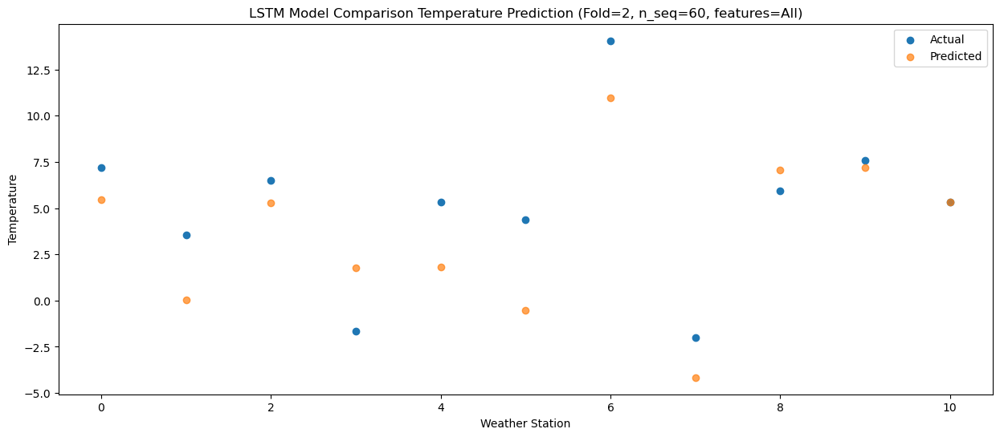

Predictions for (t+41):
    Weather_Station  Actual  Predicted
0                 0   11.36  10.334561
1                 1    9.43   4.938918
2                 2    9.06  10.157869
3                 3    4.07   6.654253
4                 4    7.25   6.698324
5                 5    5.29   4.343450
6                 6   15.88  15.847407
7                 7    3.62   0.730818
8                 8    9.76  11.933107
9                 9   11.12  12.080954
10               10   10.21  10.234848


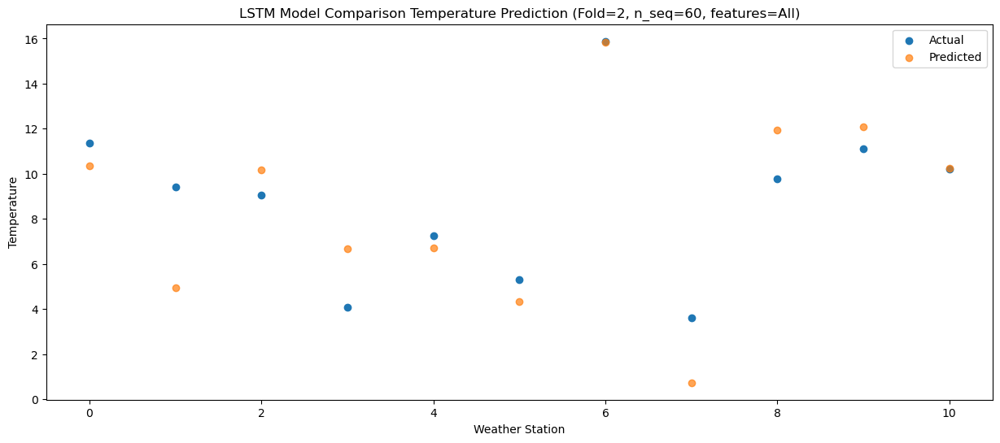

Predictions for (t+42):
    Weather_Station  Actual  Predicted
0                 0   17.41  15.480420
1                 1   14.92  10.091543
2                 2   10.04  15.299545
3                 3    7.70  11.795263
4                 4   11.28  11.836295
5                 5   10.37   9.484162
6                 6   21.62  20.992674
7                 7    8.27   5.865391
8                 8   10.97  17.070906
9                 9   13.90  17.213031
10               10   13.56  15.369476


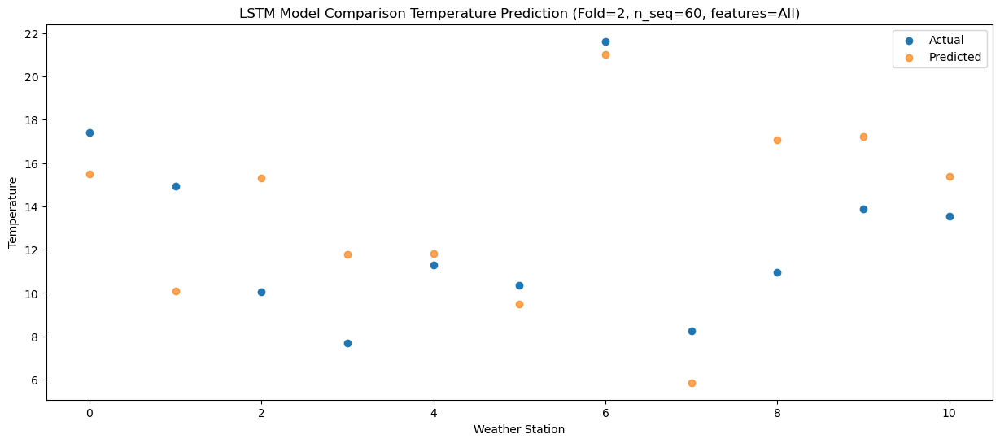

Predictions for (t+43):
    Weather_Station  Actual  Predicted
0                 0   20.04  19.363035
1                 1   17.53  13.974505
2                 2   12.45  19.180597
3                 3   11.49  15.671230
4                 4   14.93  15.715117
5                 5   15.29  13.362646
6                 6   25.77  24.871815
7                 7   12.93   9.737470
8                 8   12.93  20.939670
9                 9   17.56  21.086148
10               10   16.47  19.247314


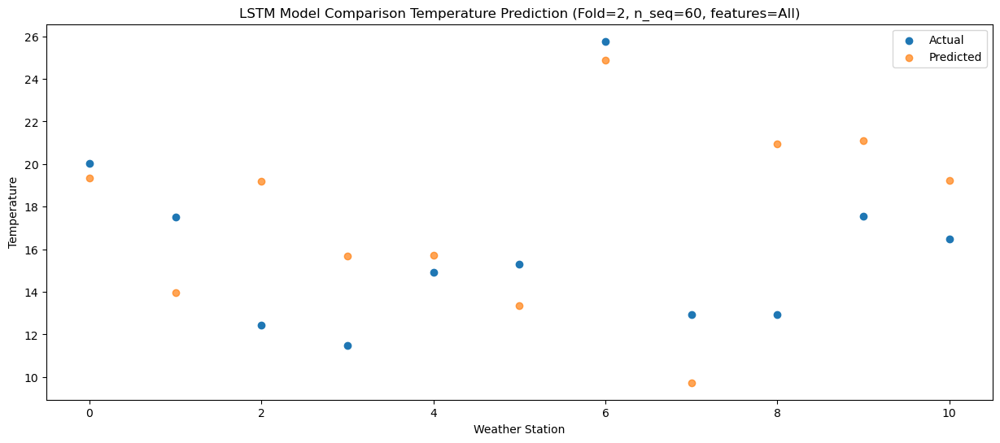

Predictions for (t+44):
    Weather_Station  Actual  Predicted
0                 0   21.79  22.297612
1                 1   21.63  16.905562
2                 2   14.36  22.112125
3                 3   17.06  18.610579
4                 4   16.37  18.647284
5                 5   17.45  16.291684
6                 6   28.33  27.800311
7                 7   17.68  12.667952
8                 8   19.85  23.863759
9                 9   21.15  24.014234
10               10   20.02  22.178622


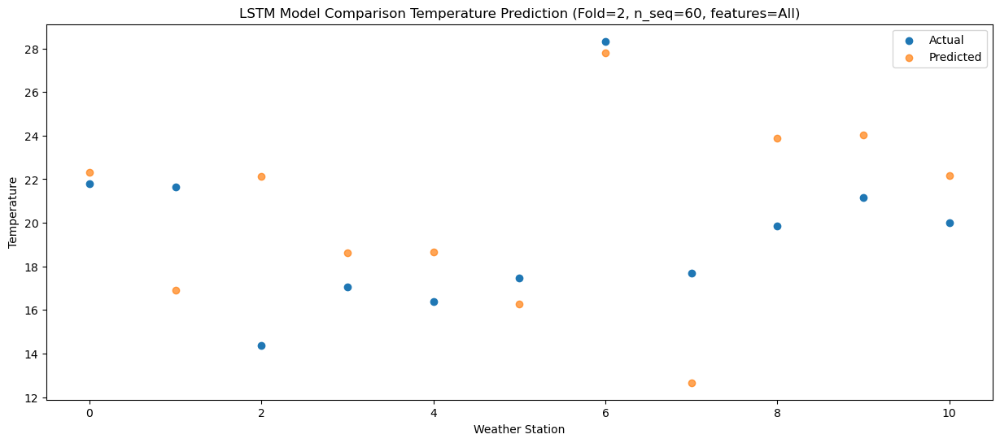

Predictions for (t+45):
    Weather_Station  Actual  Predicted
0                 0   21.30  21.957285
1                 1   22.12  16.572827
2                 2   14.54  21.776280
3                 3   15.05  18.263931
4                 4   17.67  18.307209
5                 5   19.15  15.958805
6                 6   30.67  27.468315
7                 7   14.68  12.334850
8                 8   19.48  23.536040
9                 9   20.60  23.676364
10               10   19.31  21.837947


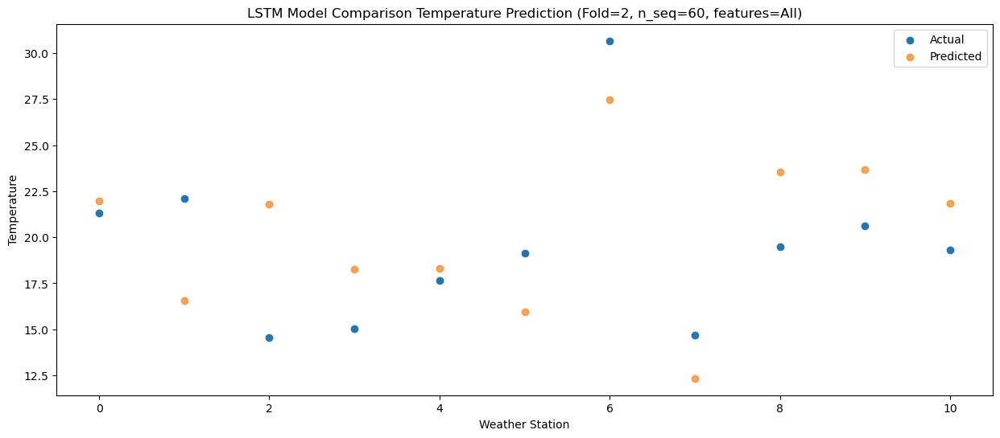

Predictions for (t+46):
    Weather_Station  Actual  Predicted
0                 0   18.01  18.273784
1                 1   19.25  12.889607
2                 2   12.59  18.082106
3                 3   12.63  14.568632
4                 4   13.24  14.609379
5                 5   14.67  12.255415
6                 6   25.89  23.769862
7                 7   12.02   8.635087
8                 8   15.98  19.829502
9                 9   16.64  19.975735
10               10   16.53  18.143904


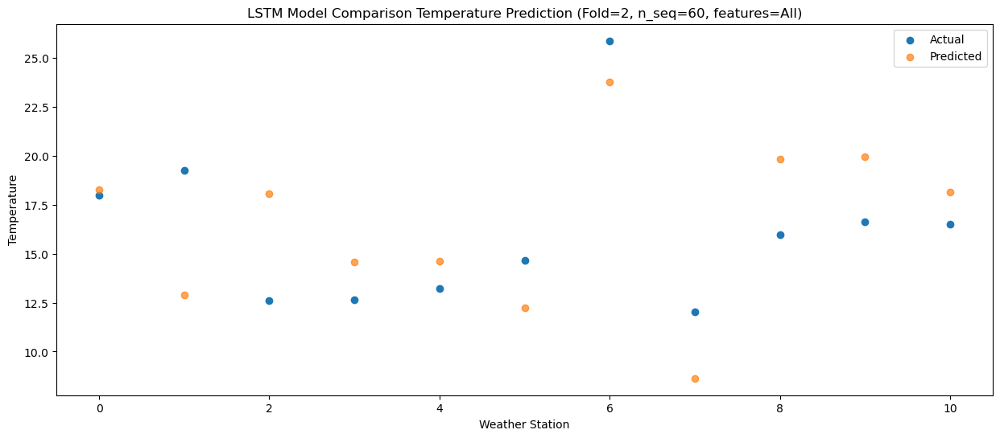

Predictions for (t+47):
    Weather_Station  Actual  Predicted
0                 0   12.85  12.319560
1                 1   10.21   6.933827
2                 2    9.01  12.116683
3                 3    7.61   8.607784
4                 4    7.08   8.651643
5                 5    6.78   6.297939
6                 6   17.17  17.811707
7                 7    5.28   2.673174
8                 8   14.39  13.868868
9                 9   11.35  14.013163
10               10   10.48  12.185165


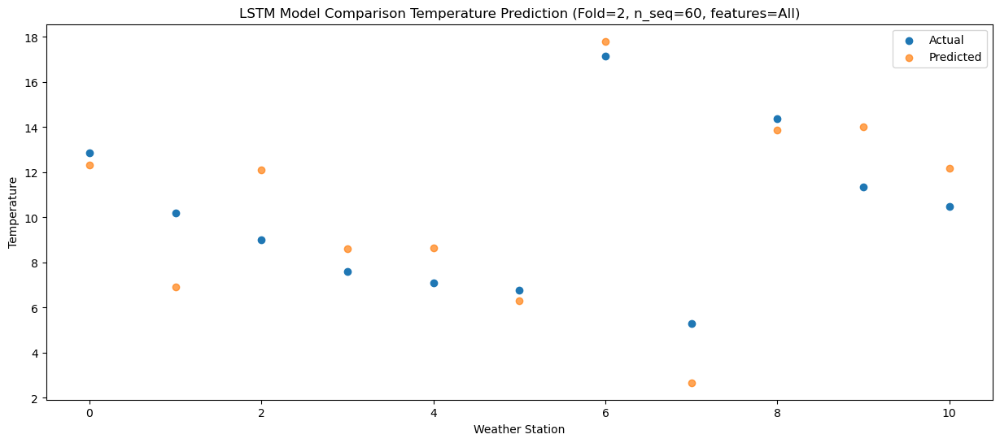

Predictions for (t+48):
    Weather_Station  Actual  Predicted
0                 0    5.74   5.808642
1                 1    3.49   0.426352
2                 2    5.03   5.610073
3                 3   -0.37   2.091095
4                 4    1.97   2.146148
5                 5    0.50  -0.209957
6                 6   11.83  11.305721
7                 7   -1.83  -3.830950
8                 8   10.00   7.369440
9                 9    5.45   7.506179
10               10    4.27   5.677481


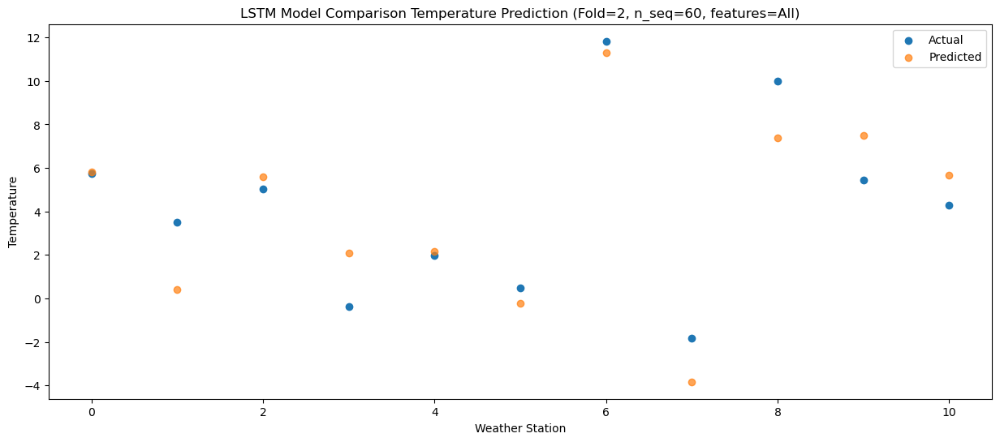

Predictions for (t+49):
    Weather_Station  Actual  Predicted
0                 0    2.68   3.280374
1                 1   -0.18  -2.104992
2                 2    3.10   3.076314
3                 3   -1.11  -0.439772
4                 4   -0.63  -0.381420
5                 5   -1.61  -2.740520
6                 6    8.85   8.773375
7                 7   -6.87  -6.373834
8                 8    7.67   4.823888
9                 9    2.98   4.966515
10               10    1.42   3.143142


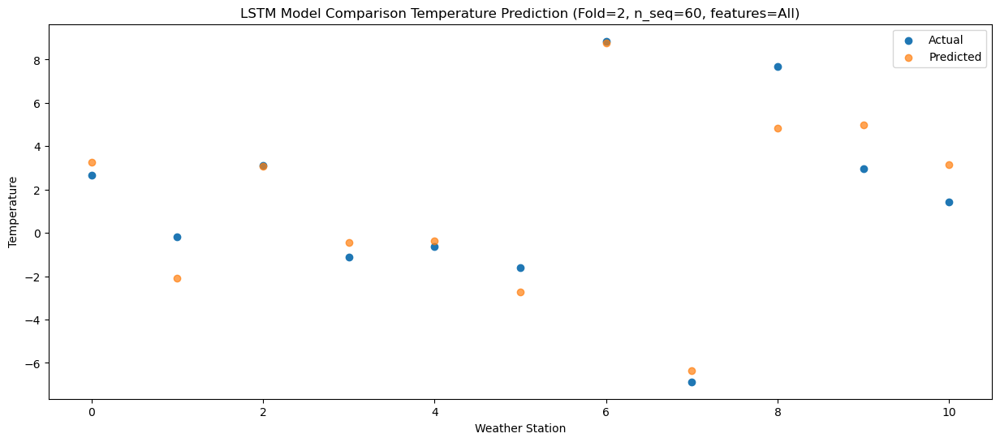

Predictions for (t+50):
    Weather_Station  Actual  Predicted
0                 0   -3.11  -1.851234
1                 1   -5.27  -7.232851
2                 2    1.10  -2.056784
3                 3   -5.28  -5.568789
4                 4   -2.71  -5.507978
5                 5   -5.76  -7.866638
6                 6    3.67   3.647735
7                 7   -7.20 -11.501510
8                 8    5.87  -0.302506
9                 9    1.13  -0.166287
10               10   -1.90  -1.990008


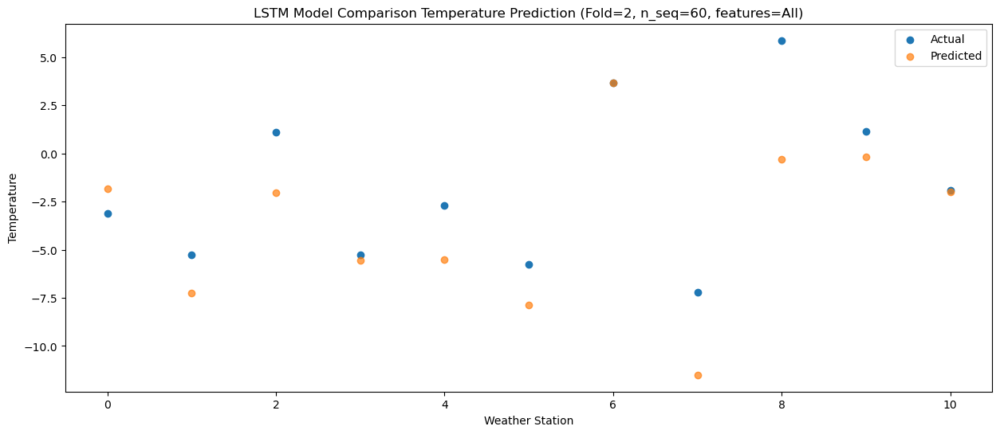

Predictions for (t+51):
    Weather_Station  Actual  Predicted
0                 0    5.21   4.603398
1                 1    2.21  -0.775395
2                 2    1.58   4.390187
3                 3   -4.60   0.878481
4                 4    1.45   0.934222
5                 5    1.00  -1.415613
6                 6   11.93  10.099894
7                 7   -3.99  -5.056651
8                 8    6.40   6.142151
9                 9    4.35   6.275901
10               10    2.64   4.455801


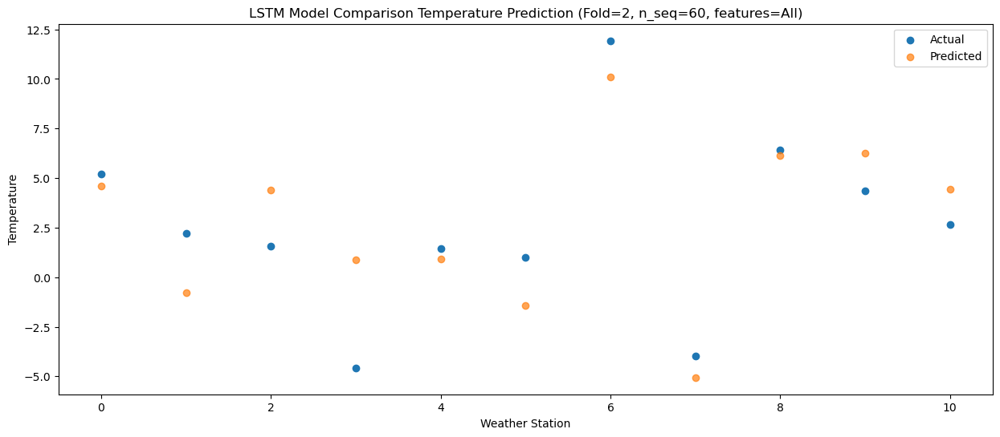

Predictions for (t+52):
    Weather_Station  Actual  Predicted
0                 0    8.10   7.301187
1                 1    4.98   1.920510
2                 2    6.00   7.085923
3                 3   -0.20   3.559821
4                 4    4.12   3.626416
5                 5    3.37   1.272835
6                 6   14.28  12.791945
7                 7   -1.42  -2.365669
8                 8    7.34   8.830940
9                 9    7.91   8.970346
10               10    6.81   7.151251


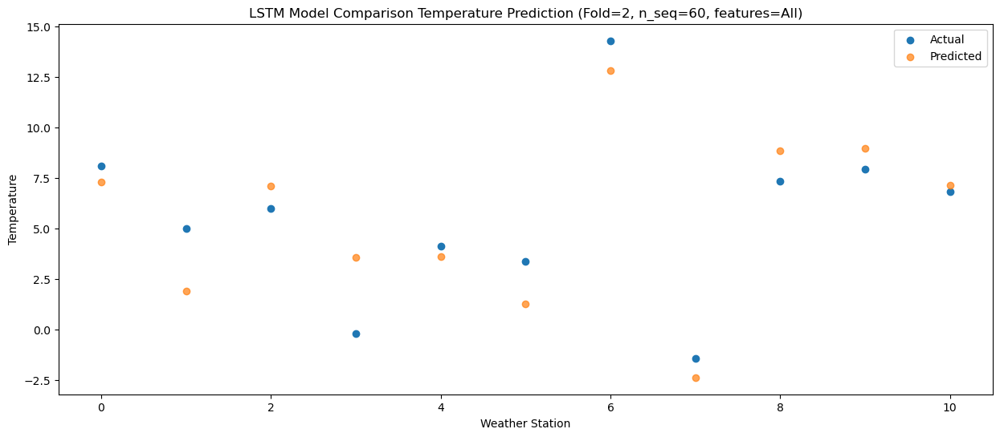

Predictions for (t+53):
    Weather_Station  Actual  Predicted
0                 0   12.86  11.643532
1                 1   10.39   6.265635
2                 2    7.39  11.419909
3                 3    2.23   7.892005
4                 4    7.78   7.957125
5                 5    7.11   5.600548
6                 6   17.73  17.120424
7                 7    2.99   1.969376
8                 8    9.45  13.164467
9                 9   11.97  13.303859
10               10   10.79  11.482601


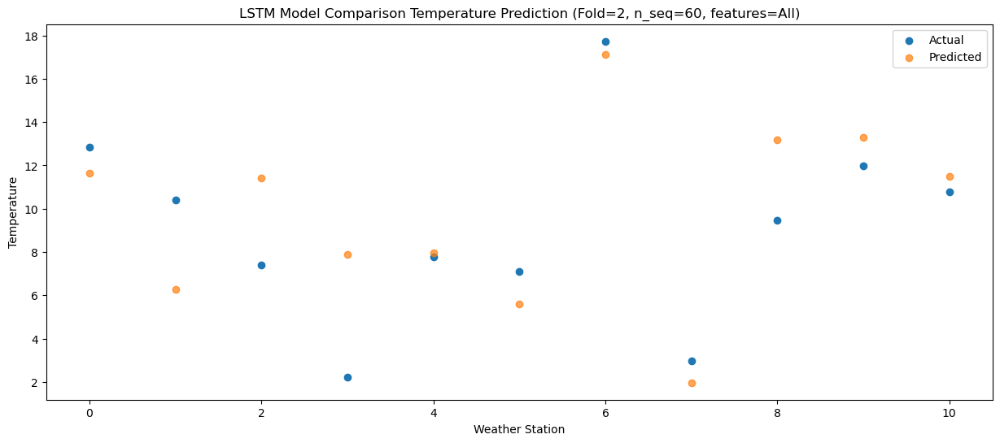

Predictions for (t+54):
    Weather_Station  Actual  Predicted
0                 0   17.79  16.437030
1                 1   15.00  11.050160
2                 2   12.24  16.194430
3                 3    8.02  12.674211
4                 4   12.83  12.730181
5                 5   10.81  10.377876
6                 6   22.62  21.897307
7                 7    8.81   6.744200
8                 8   11.25  17.932684
9                 9   16.35  18.072294
10               10   15.25  16.252153


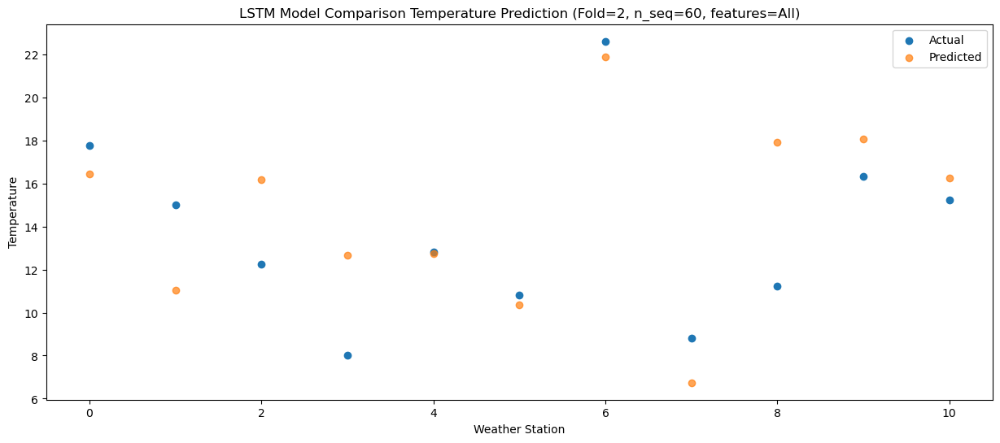

Predictions for (t+55):
    Weather_Station  Actual  Predicted
0                 0   20.87  20.122348
1                 1   21.17  14.734209
2                 2   13.15  19.871751
3                 3   13.99  16.345965
4                 4   14.66  16.408252
5                 5   14.04  14.057396
6                 6   26.12  25.581493
7                 7   15.23  10.423770
8                 8   15.93  21.610272
9                 9   20.23  21.751202
10               10   19.60  19.926454


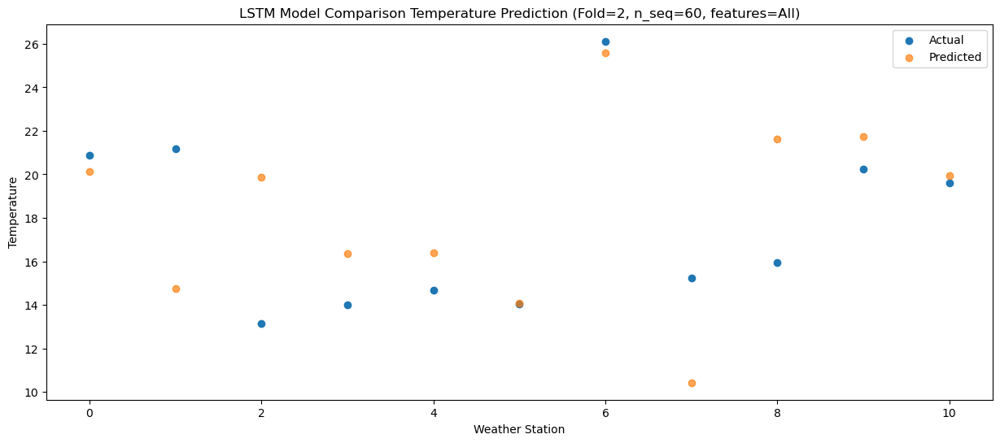

Predictions for (t+56):
    Weather_Station  Actual  Predicted
0                 0   21.36  21.226556
1                 1   21.72  15.845799
2                 2   13.99  20.983041
3                 3   16.77  17.457768
4                 4   15.27  17.518484
5                 5   12.52  15.163184
6                 6   26.43  26.686702
7                 7   14.70  11.536609
8                 8   19.66  22.730034
9                 9   21.62  22.864073
10               10   20.83  21.039513


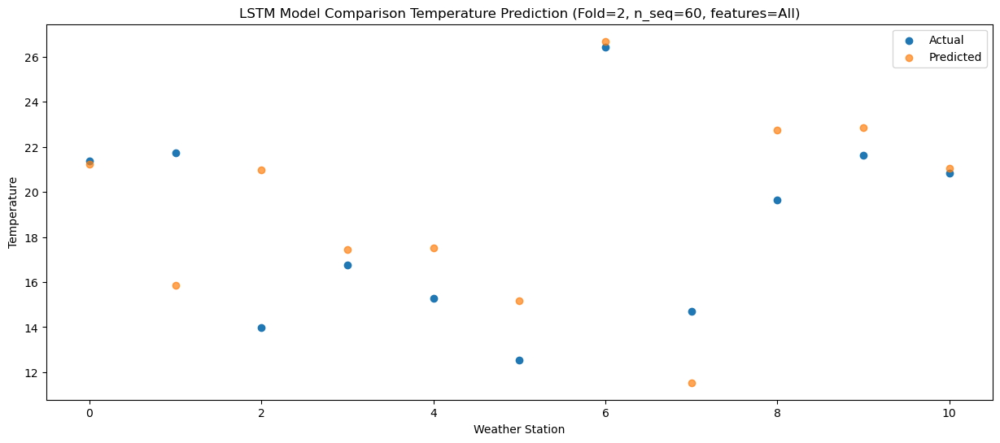

Predictions for (t+57):
    Weather_Station  Actual  Predicted
0                 0   21.59  21.047618
1                 1   21.77  15.672790
2                 2   13.95  20.820950
3                 3   15.06  17.289601
4                 4   15.62  17.356795
5                 5   14.17  14.990393
6                 6   28.23  26.509620
7                 7   15.09  11.367272
8                 8   19.24  22.559141
9                 9   19.60  22.694038
10               10   19.21  20.870621


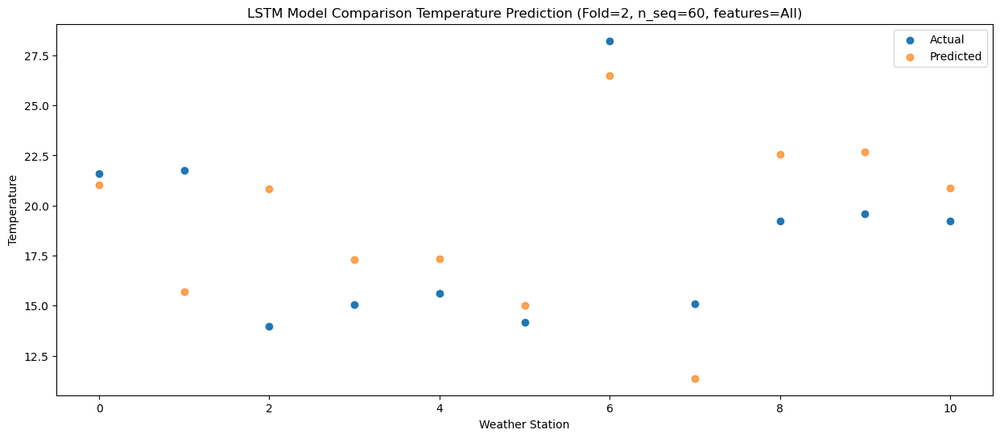

Predictions for (t+58):
    Weather_Station  Actual  Predicted
0                 0   17.61  17.625752
1                 1   18.04  12.248800
2                 2   13.63  17.394450
3                 3   11.54  13.862034
4                 4   12.82  13.924611
5                 5   11.44  11.561482
6                 6   24.00  23.082497
7                 7   11.06   7.940647
8                 8   17.39  19.134978
9                 9   16.64  19.267192
10               10   16.62  17.446200


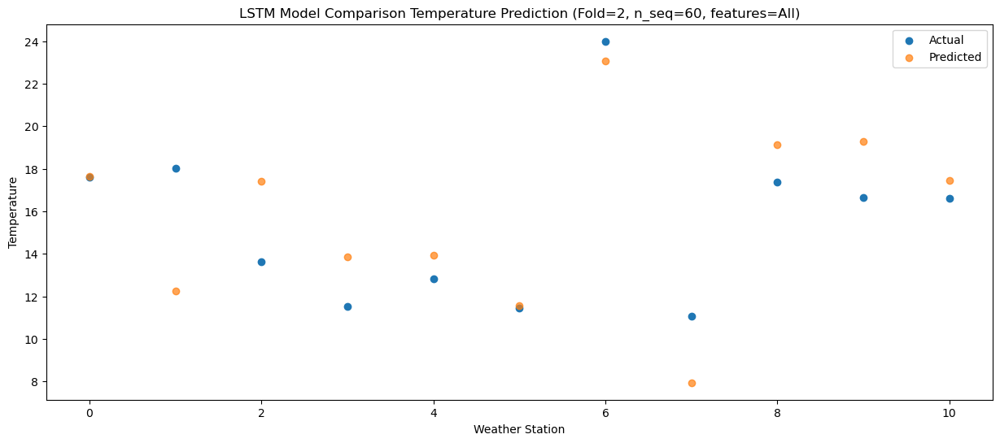

Predictions for (t+59):
    Weather_Station  Actual  Predicted
0                 0   13.34  12.944781
1                 1   13.07   7.561339
2                 2   10.16  12.707687
3                 3    6.28   9.171635
4                 4    8.13   9.233446
5                 5    8.79   6.876898
6                 6   21.03  18.397066
7                 7    6.80   3.243793
8                 8   14.40  14.438232
9                 9   11.42  14.566162
10               10   10.20  12.750029


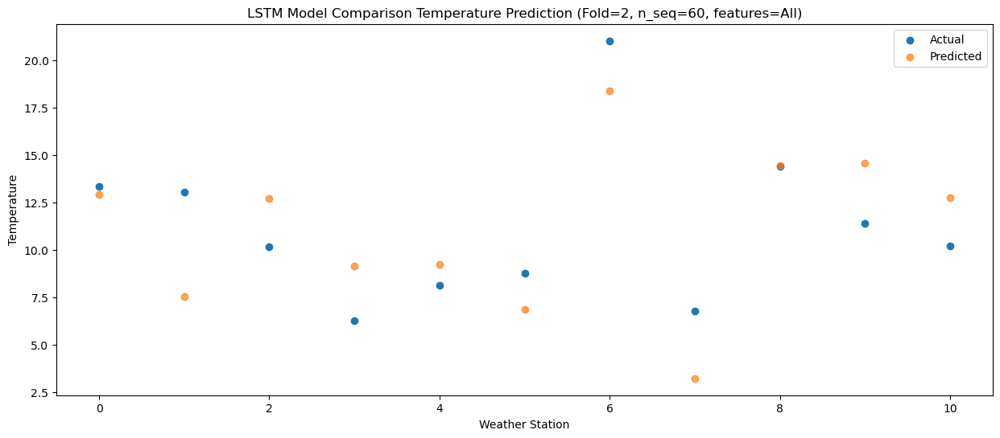

Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_4 (LSTM)               (1, 1, 256)               2290688   
                                                                 
 dropout_4 (Dropout)         (1, 1, 256)               0         
                                                                 
 lstm_5 (LSTM)               (1, 256)                  525312    
                                                                 
 dropout_5 (Dropout)         (1, 256)                  0         
                                                                 
 dense_6 (Dense)             (1, 256)                  65792     
                                                                 
 dense_7 (Dense)             (1, 128)                  32896     
                                                                 
 dense_8 (Dense)             (1, 60)                  

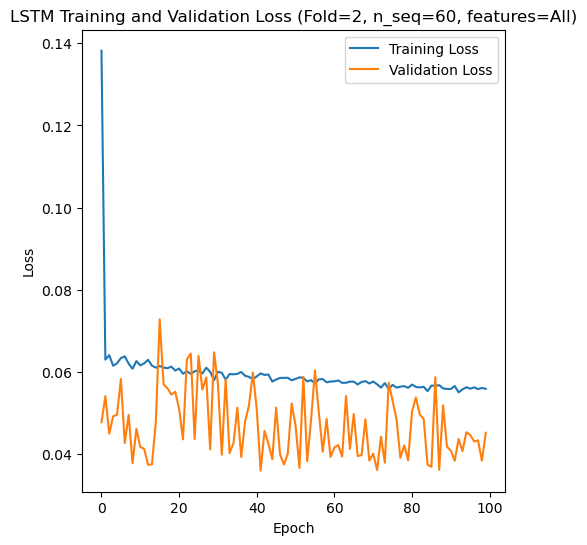

Epoch 1/100
84/84 [==============================] - 28s 94ms/step - loss: 0.1423 - accuracy: 0.4286 - mae: 0.1148 - rmse: 0.1423 - mape: 26.1026 - pearson: 0.6875 - val_loss: 0.0775 - val_accuracy: 0.5000 - val_mae: 0.0610 - val_rmse: 0.0775 - val_mape: 13.3960 - val_pearson: 0.7861
Epoch 2/100
84/84 [==============================] - 2s 23ms/step - loss: 0.0619 - accuracy: 0.5476 - mae: 0.0490 - rmse: 0.0619 - mape: 11.5872 - pearson: 0.8426 - val_loss: 0.0995 - val_accuracy: 0.0000e+00 - val_mae: 0.0794 - val_rmse: 0.0995 - val_mape: 17.9120 - val_pearson: 0.6171
Epoch 3/100
84/84 [==============================] - 2s 26ms/step - loss: 0.0622 - accuracy: 0.5476 - mae: 0.0492 - rmse: 0.0622 - mape: 11.5934 - pearson: 0.8432 - val_loss: 0.0798 - val_accuracy: 0.5000 - val_mae: 0.0628 - val_rmse: 0.0798 - val_mape: 14.4869 - val_pearson: 0.7561
Epoch 4/100
84/84 [==============================] - 2s 24ms/step - loss: 0.0602 - accuracy: 0.5119 - mae: 0.0477 - rmse: 0.0602 - mape: 11.242

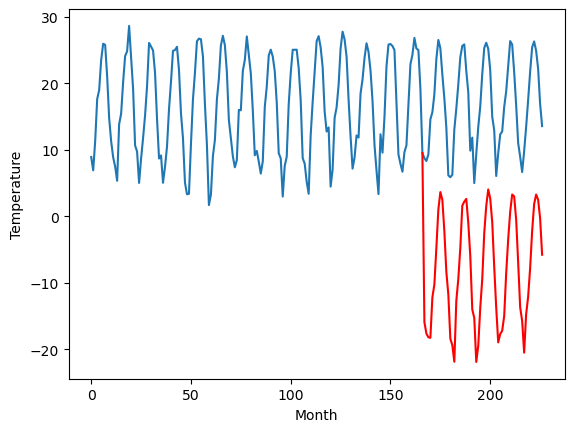

Weather Station 2:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
2.89		1.88		-1.01
1.54		0.16		-1.38
0.70		-0.41		-1.11
0.85		-0.48		-1.33
8.34		5.58		-2.76
9.26		7.55		-1.71
13.66		13.04		-0.62
20.76		18.82		-1.94
22.62		21.44		-1.18
20.76		20.28		-0.48
17.09		15.58		-1.51
9.98		9.44		-0.54
7.16		6.03		-1.13
0.61		-0.63		-1.24
-0.54		-1.62		-1.08
-4.26		-4.11		0.15
7.71		5.05		-2.66
9.57		8.35		-1.22
13.79		13.02		-0.77
20.50		19.38		-1.12
21.81		19.99		-1.82
22.38		20.38		-2.00
19.65		16.78		-2.87
13.05		11.79		-1.26
5.34		3.73		-1.61
6.65		2.47		-4.18
-2.18		-4.16		-1.98
-0.96		-1.72		-0.76
5.82		3.97		-1.85
10.67		8.29		-2.38
16.10		15.22		-0.88
21.25		19.29		-1.96
25.29		21.76		-3.53
22.21		20.40		-1.81
18.35		16.84		-1.51
11.80		10.10		-1.70
4.57		3.94		-0.63
0.52		-1.26		-1.78
1.22		-0.01		-1.23
3.18		0.50		-2.68
5.78		2.71		-3.07
10.83		9.17		-1.66
16.14		14.26		-1.88
20.47		18.40		-2.07
22.73		20.99		-1.74
22.91		20.73		-2.18
18.86		17.22		-1.64
1

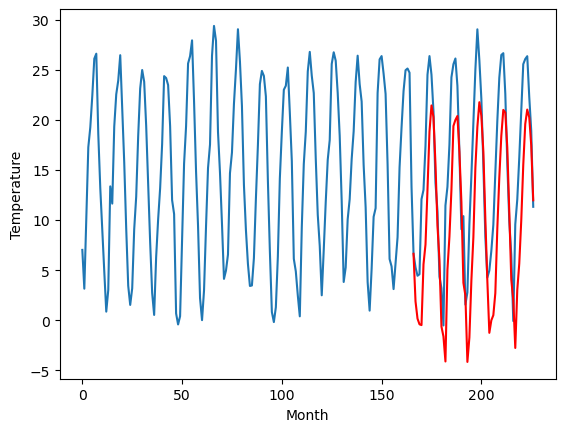

Weather Station 3:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
4.73		1.34		-3.39
2.20		-0.37		-2.57
0.98		-0.93		-1.91
3.40		-1.01		-4.41
5.19		5.05		-0.14
9.85		7.02		-2.83
15.04		12.50		-2.54
18.39		18.28		-0.11
21.17		20.89		-0.28
21.70		19.72		-1.98
17.37		15.03		-2.34
11.88		8.91		-2.97
3.23		5.49		2.26
0.03		-1.15		-1.18
1.29		-2.14		-3.43
3.59		-4.63		-8.22
4.74		4.54		-0.20
10.47		7.84		-2.63
15.27		12.51		-2.76
20.12		18.87		-1.25
23.25		19.48		-3.77
21.05		19.86		-1.19
17.74		16.26		-1.48
9.08		11.27		2.19
4.74		3.22		-1.52
0.82		1.94		1.12
0.49		-4.67		-5.16
2.19		-2.23		-4.42
6.90		3.46		-3.44
9.97		7.79		-2.18
14.21		14.71		0.50
19.60		18.78		-0.82
22.17		21.26		-0.91
22.35		19.90		-2.45
19.53		16.33		-3.20
12.35		9.59		-2.76
1.62		3.42		1.80
0.66		-1.77		-2.43
2.05		-0.53		-2.58
1.20		-0.02		-1.22
4.07		2.18		-1.89
9.70		8.64		-1.06
14.14		13.71		-0.43
16.94		17.84		0.90
22.60		20.44		-2.16
20.91		20.17		-0.74
17.14		16.66		-0.48
11.83		10.

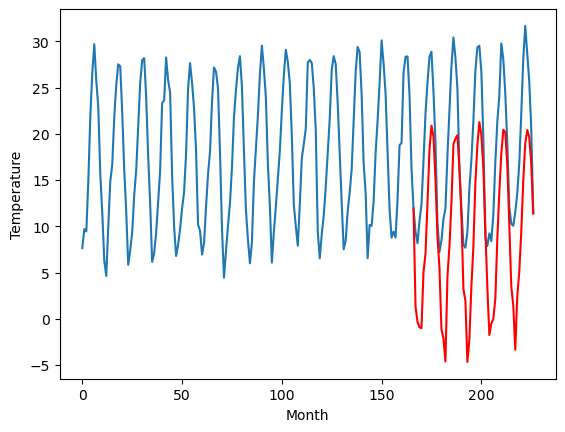

Weather Station 4:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-7.31		-4.50		2.81
-7.30		-6.22		1.08
-7.85		-6.79		1.06
-8.20		-6.86		1.34
-1.29		-0.80		0.49
-0.65		1.17		1.82
3.92		6.65		2.73
9.74		12.44		2.70
13.54		15.05		1.51
11.12		13.89		2.77
7.06		9.19		2.13
1.64		3.05		1.41
-2.28		-0.36		1.92
-9.48		-7.01		2.47
-10.94		-8.00		2.94
-12.26		-10.49		1.77
-2.05		-1.32		0.73
0.30		1.98		1.68
4.37		6.65		2.28
10.29		13.01		2.72
11.28		13.62		2.34
11.80		14.01		2.21
7.67		10.40		2.73
4.09		5.41		1.32
-5.57		-2.64		2.93
-4.08		-3.92		0.16
-13.03		-10.53		2.50
-8.51		-8.09		0.42
-2.76		-2.39		0.37
0.25		1.92		1.67
7.03		8.85		1.82
10.51		12.92		2.41
12.06		15.39		3.33
10.99		14.03		3.04
7.01		10.47		3.46
-0.26		3.73		3.99
-3.38		-2.42		0.96
-8.65		-7.62		1.03
-6.90		-6.37		0.53
-4.56		-5.87		-1.31
-4.32		-3.66		0.66
1.92		2.80		0.88
4.61		7.88		3.27
8.35		12.01		3.66
11.97		14.60		2.63
10.86		14.33		3.47
8.13		10.82		2.69
2.69		4.38		1.69
-3.70		-2.36		1.

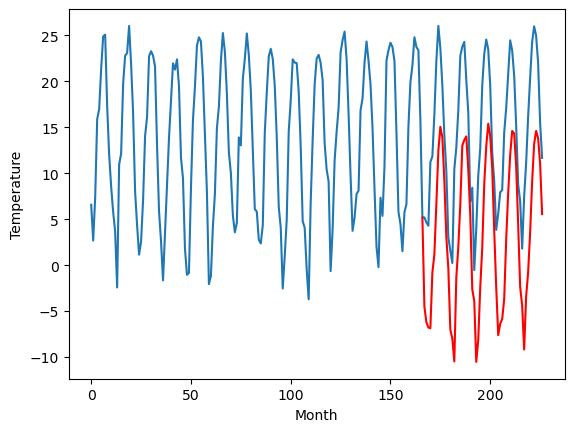

Weather Station 5:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
5.64		1.20		-4.44
2.38		-0.53		-2.91
-0.49		-1.09		-0.60
0.66		-1.16		-1.82
8.07		4.90		-3.17
11.10		6.87		-4.23
17.17		12.36		-4.81
24.22		18.15		-6.07
25.68		20.76		-4.92
23.12		19.60		-3.52
19.05		14.90		-4.15
11.32		8.76		-2.56
8.50		5.36		-3.14
1.33		-1.30		-2.63
-0.14		-2.30		-2.16
-4.01		-4.79		-0.78
9.07		4.38		-4.69
12.36		7.69		-4.67
16.93		12.35		-4.58
24.41		18.71		-5.70
24.41		19.32		-5.09
24.53		19.72		-4.81
21.17		16.10		-5.07
15.75		11.12		-4.63
6.01		3.06		-2.95
5.65		1.78		-3.87
-3.82		-4.83		-1.01
-1.30		-2.40		-1.10
7.16		3.30		-3.86
11.29		7.61		-3.68
18.86		14.54		-4.32
24.31		18.61		-5.70
25.43		21.08		-4.35
23.61		19.72		-3.89
19.29		16.17		-3.12
12.02		9.43		-2.59
6.13		3.27		-2.86
0.16		-1.93		-2.09
1.88		-0.68		-2.56
8.40		-0.18		-8.58
5.44		2.02		-3.42
12.65		8.48		-4.17
18.65		13.56		-5.09
22.75		17.69		-5.06
24.45		20.29		-4.16
23.16		20.02		-3.14
19.80		16.52		-

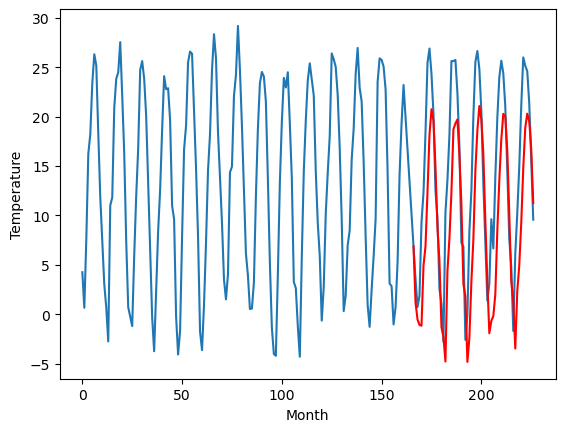

Weather Station 6:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-3.05		-0.68		2.37
-2.84		-2.41		0.43
-4.26		-2.97		1.29
-4.67		-3.04		1.63
2.19		3.02		0.83
4.46		4.99		0.53
9.87		10.48		0.61
16.86		16.27		-0.59
18.75		18.87		0.12
16.24		17.71		1.47
12.61		13.01		0.40
6.61		6.88		0.27
2.67		3.47		0.80
-4.94		-3.19		1.75
-6.39		-4.18		2.21
-9.11		-6.68		2.43
2.22		2.50		0.28
5.67		5.80		0.13
9.95		10.47		0.52
16.66		16.83		0.17
17.04		17.44		0.40
17.36		17.83		0.47
14.10		14.22		0.12
9.52		9.24		-0.28
-1.33		1.18		2.51
-0.28		-0.10		0.18
-9.10		-6.71		2.39
-5.91		-4.27		1.64
1.05		1.42		0.37
4.90		5.73		0.83
12.70		12.66		-0.04
16.64		16.73		0.09
18.63		19.20		0.57
16.98		17.84		0.86
13.03		14.28		1.25
6.99		7.54		0.55
0.44		1.38		0.94
-5.10		-3.81		1.29
-2.96		-2.56		0.40
-1.24		-2.05		-0.81
-0.34		0.15		0.49
5.89		6.60		0.71
11.30		11.69		0.39
14.76		15.82		1.06
18.02		18.41		0.39
16.47		18.14		1.67
13.01		14.64		1.63
7.36		8.20		0.84
0.88		1.46		0.58
-1

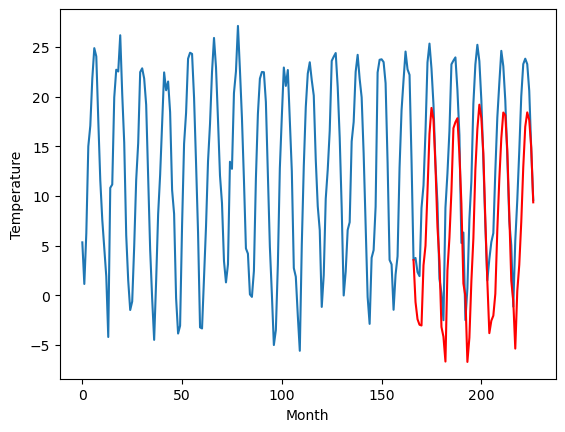

Weather Station 7:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-4.14		-0.05		4.09
-9.81		-1.77		8.04
-9.90		-2.33		7.57
-9.71		-2.41		7.30
-4.78		3.65		8.43
-1.80		5.62		7.42
5.31		11.11		5.80
9.52		16.88		7.36
11.51		19.50		7.99
12.26		18.33		6.07
6.76		13.63		6.87
3.02		7.50		4.48
-4.17		4.09		8.26
-9.87		-2.56		7.31
-9.60		-3.55		6.05
-9.50		-6.04		3.46
-6.53		3.13		9.66
-1.75		6.44		8.19
3.30		11.10		7.80
10.69		17.46		6.77
12.53		18.08		5.55
10.61		18.46		7.85
8.74		14.86		6.12
0.77		9.87		9.10
-1.97		1.82		3.79
-6.73		0.54		7.27
-9.02		-6.08		2.94
-10.74		-3.64		7.10
-6.20		2.06		8.26
-1.88		6.37		8.25
4.03		13.31		9.28
9.80		17.38		7.58
11.72		19.85		8.13
10.96		18.49		7.53
8.80		14.92		6.12
0.54		8.18		7.64
-7.14		2.02		9.16
-9.31		-3.17		6.14
-10.04		-1.93		8.11
-10.01		-1.43		8.58
-8.22		0.77		8.99
-2.88		7.23		10.11
4.33		12.30		7.97
8.91		16.43		7.52
15.05		19.03		3.98
12.46		18.76		6.30
8.31		15.25		6.94
2.18		8.80		6.62
-3.68		2.07		5.75
-7

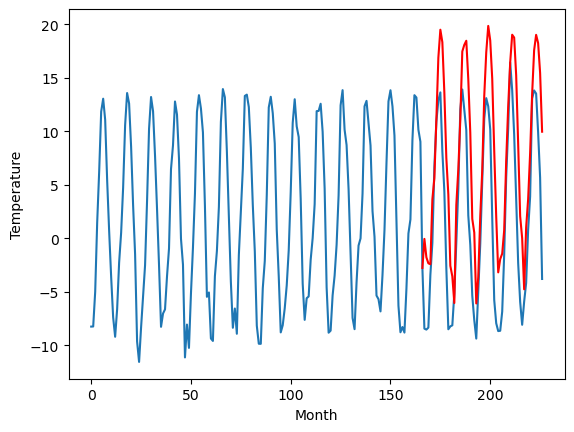

Weather Station 8:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
1.65		-1.13		-2.78
-3.08		-2.85		0.23
-1.92		-3.42		-1.50
-0.41		-3.50		-3.09
2.70		2.57		-0.13
8.61		4.54		-4.07
15.88		10.02		-5.86
19.34		15.80		-3.54
23.57		18.41		-5.16
23.68		17.24		-6.44
18.87		12.55		-6.32
11.93		6.42		-5.51
3.12		3.01		-0.11
-2.57		-3.62		-1.05
-2.02		-4.61		-2.59
0.83		-7.09		-7.92
2.43		2.06		-0.37
10.40		5.37		-5.03
14.83		10.04		-4.79
22.47		16.39		-6.08
23.55		17.01		-6.54
22.32		17.39		-4.93
18.35		13.79		-4.56
8.00		8.80		0.80
5.48		0.75		-4.73
-1.79		-0.53		1.26
-1.86		-7.15		-5.29
0.18		-4.71		-4.89
4.89		0.99		-3.90
9.52		5.31		-4.21
14.19		12.24		-1.95
20.67		16.31		-4.36
22.90		18.79		-4.11
21.31		17.42		-3.89
18.95		13.85		-5.10
11.06		7.12		-3.94
-0.36		0.95		1.31
-2.69		-4.24		-1.55
-3.20		-3.00		0.20
-2.29		-2.50		-0.21
0.54		-0.31		-0.85
8.49		6.14		-2.35
14.29		11.21		-3.08
16.79		15.34		-1.45
25.15		17.94		-7.21
20.52		17.67		-2.85
15.82		14.16		-1

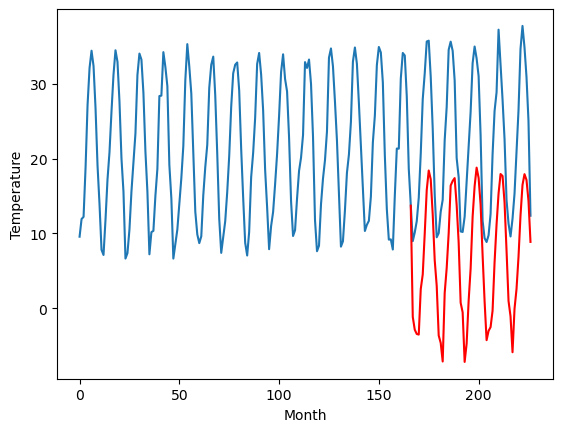

Weather Station 9:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-0.04		-3.46		-3.42
-1.29		-5.18		-3.89
-1.92		-5.74		-3.82
0.10		-5.81		-5.91
-0.46		0.25		0.71
3.16		2.22		-0.94
5.56		7.71		2.15
8.10		13.48		5.38
7.29		16.09		8.80
9.17		14.93		5.76
8.59		10.24		1.65
6.37		4.11		-2.26
-0.79		0.70		1.49
-2.84		-5.94		-3.10
-1.62		-6.92		-5.30
-0.69		-9.40		-8.71
-0.91		-0.25		0.66
1.28		3.06		1.78
5.57		7.73		2.16
7.27		14.08		6.81
6.45		14.70		8.25
7.00		15.08		8.08
6.45		11.48		5.03
3.69		6.49		2.80
0.87		-1.56		-2.43
-2.83		-2.84		-0.01
-2.21		-9.45		-7.24
-1.25		-7.01		-5.76
0.98		-1.30		-2.28
2.42		3.01		0.59
5.41		9.94		4.53
8.56		14.02		5.46
6.91		16.49		9.58
8.33		15.13		6.80
8.56		11.56		3.00
3.83		4.82		0.99
-1.90		-1.35		0.55
-3.10		-6.54		-3.44
-1.43		-5.30		-3.87
-3.23		-4.80		-1.57
-1.77		-2.60		-0.83
2.31		3.86		1.55
3.34		8.92		5.58
5.24		13.05		7.81
8.25		15.64		7.39
9.28		15.38		6.10
6.67		11.85		5.18
5.21		5.42		0.21
1.17		-1.32		-2.49
-

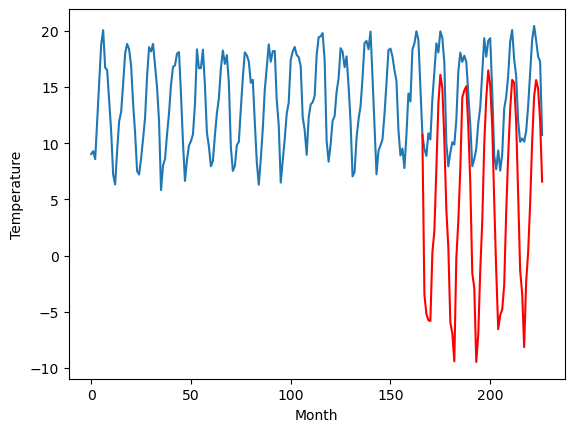

Weather Station 10:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-3.08		-2.37		0.71
-5.84		-4.10		1.74
-5.81		-4.67		1.14
-5.37		-4.74		0.63
-1.79		1.32		3.11
-0.35		3.29		3.64
5.21		8.78		3.57
12.19		14.57		2.38
16.14		17.18		1.04
14.96		16.01		1.05
10.62		11.32		0.70
5.30		5.19		-0.11
1.23		1.78		0.55
-5.11		-4.86		0.25
-8.13		-5.84		2.29
-8.25		-8.33		-0.08
-3.25		0.83		4.08
1.37		4.13		2.76
6.20		8.80		2.60
12.07		15.15		3.08
14.21		15.77		1.56
14.83		16.15		1.32
11.51		12.55		1.04
7.07		7.57		0.50
-1.85		-0.48		1.37
-3.45		-1.76		1.69
-10.00		-8.38		1.62
-7.24		-5.94		1.30
-3.28		-0.24		3.04
1.01		4.08		3.07
6.80		11.01		4.21
11.12		15.09		3.97
15.67		17.56		1.89
15.59		16.20		0.61
10.68		12.63		1.95
4.42		5.89		1.47
0.46		-0.26		-0.72
-5.90		-5.46		0.44
-3.92		-4.21		-0.29
-5.65		-3.71		1.94
-3.68		-1.51		2.17
2.37		4.94		2.57
6.01		10.01		4.00
10.00		14.14		4.14
15.68		16.74		1.06
13.43		16.47		3.04
10.86		12.95		2.09
5.43		6.52		1.09
-2.42		-0.22	

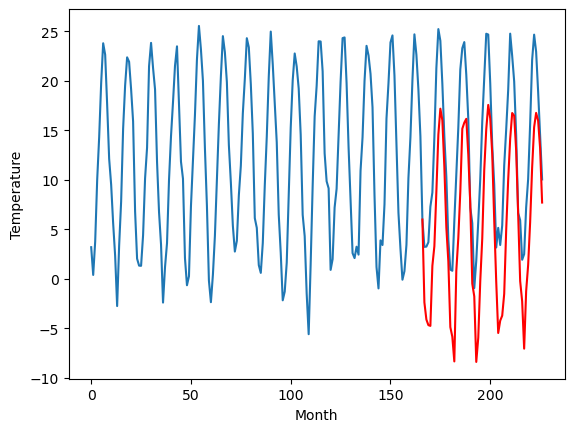

Weather Station 11:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-17.90		-15.94		1.96
-20.86		-17.66		3.20
-20.45		-18.23		2.22
-19.53		-18.30		1.23
-15.12		-12.24		2.88
-13.18		-10.27		2.91
-7.41		-4.78		2.63
-0.69		1.00		1.69
3.08		3.61		0.53
1.21		2.45		1.24
-3.76		-2.25		1.51
-9.25		-8.38		0.87
-13.53		-11.78		1.75
-20.35		-18.43		1.92
-21.91		-19.40		2.51
-22.71		-21.89		0.82
-15.52		-12.73		2.79
-10.65		-9.43		1.22
-6.39		-4.76		1.63
-0.22		1.59		1.81
1.42		2.20		0.78
1.15		2.59		1.44
-3.11		-1.02		2.09
-7.23		-6.00		1.23
-17.45		-14.05		3.40
-17.86		-15.33		2.53
-24.84		-21.94		2.90
-21.03		-19.50		1.53
-15.85		-13.80		2.05
-12.03		-9.49		2.54
-5.25		-2.56		2.69
-1.26		1.51		2.77
2.52		3.98		1.46
1.65		2.62		0.97
-3.58		-0.94		2.64
-11.19		-7.68		3.51
-14.31		-13.83		0.48
-21.34		-19.03		2.31
-18.69		-17.78		0.91
-18.48		-17.28		1.20
-16.92		-15.08		1.84
-9.35		-8.62		0.73
-6.88		-3.55		3.33
-2.95		0.58		3.53
1.89		3.18		1.29
-0.08		2.90		2.98
-3.3

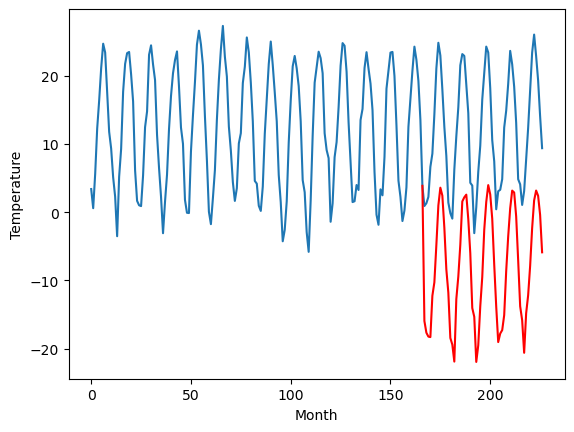

RangeIndex(start=1, stop=12, step=1)
[-17.9, 2.8899999999999997, 4.729999999999999, -7.31, 5.640000000000001, -3.0500000000000007, -4.139999999999999, 1.6500000000000012, -0.03999999999999826, -3.08, -17.9]
[-15.934396018981934, 1.8794058036804202, 1.3411035919189445, -4.500363159179687, 1.198573970794678, -0.6785044479370121, -0.046421623229980113, -1.1340276527404782, -3.45845890045166, -2.3745655250549316, -15.939891567230225]
Predictions for (t+0):
    Weather_Station  Actual  Predicted
0                 0  -17.90 -15.934396
1                 1    2.89   1.879406
2                 2    4.73   1.341104
3                 3   -7.31  -4.500363
4                 4    5.64   1.198574
5                 5   -3.05  -0.678504
6                 6   -4.14  -0.046422
7                 7    1.65  -1.134028
8                 8   -0.04  -3.458459
9                 9   -3.08  -2.374566
10               10  -17.90 -15.939892


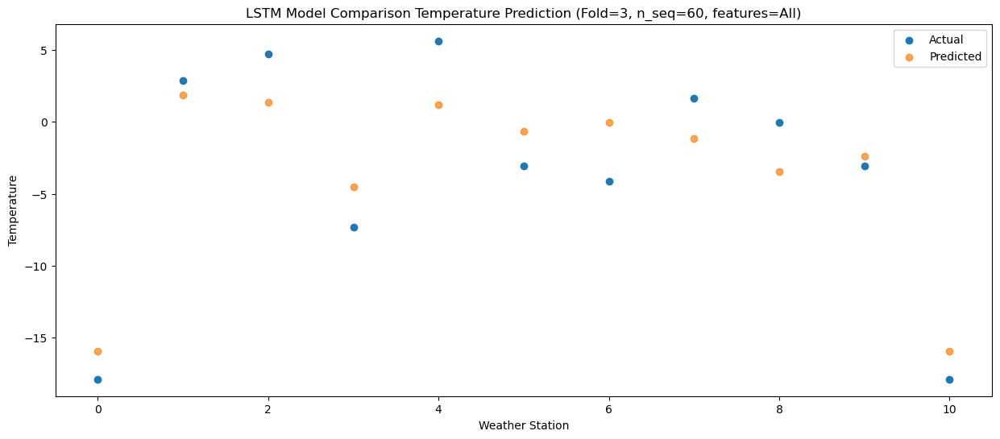

Predictions for (t+1):
    Weather_Station  Actual  Predicted
0                 0  -18.68 -17.651739
1                 1    1.54   0.161477
2                 2    2.20  -0.372435
3                 3   -7.30  -6.224094
4                 4    2.38  -0.525898
5                 5   -2.84  -2.405903
6                 6   -9.81  -1.768952
7                 7   -3.08  -2.851961
8                 8   -1.29  -5.176629
9                 9   -5.84  -4.102680
10               10  -20.86 -17.661858


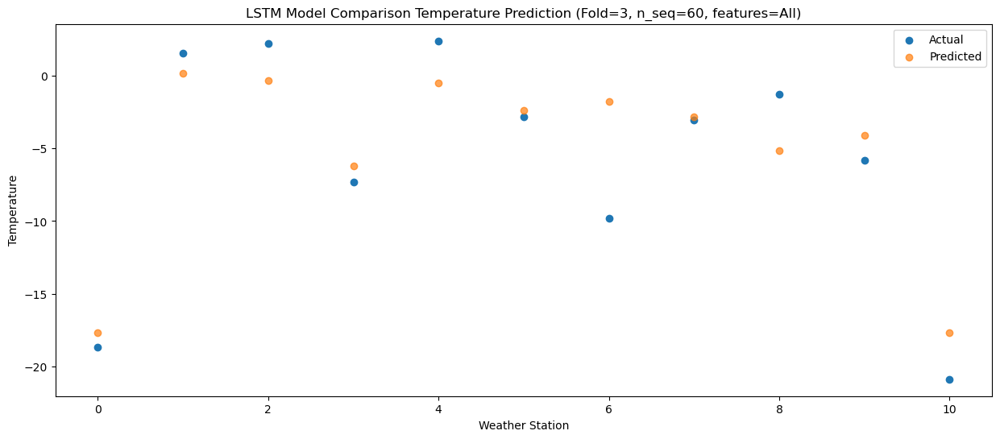

Predictions for (t+2):
    Weather_Station  Actual  Predicted
0                 0  -19.10 -18.224282
1                 1    0.70  -0.406044
2                 2    0.98  -0.933895
3                 3   -7.85  -6.788990
4                 4   -0.49  -1.090375
5                 5   -4.26  -2.968491
6                 6   -9.90  -2.330666
7                 7   -1.92  -3.416166
8                 8   -1.92  -5.737098
9                 9   -5.81  -4.665612
10               10  -20.45 -18.228540


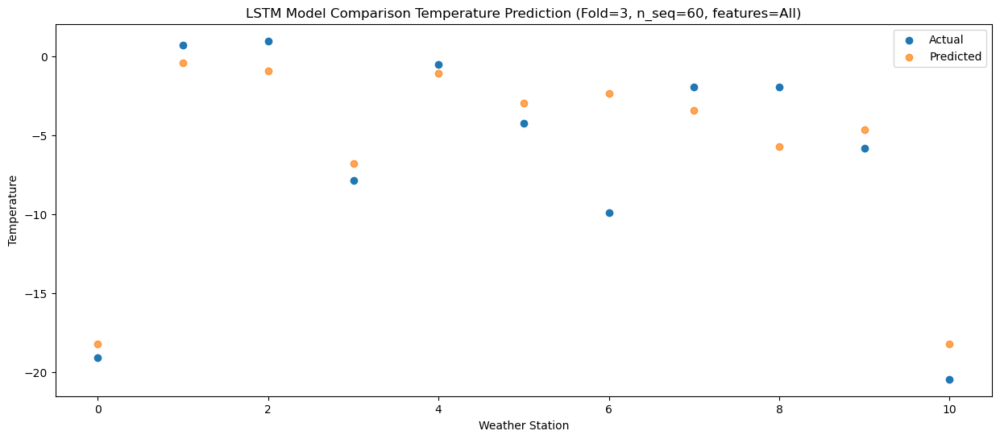

Predictions for (t+3):
    Weather_Station  Actual  Predicted
0                 0  -18.09 -18.300270
1                 1    0.85  -0.480994
2                 2    3.40  -1.012843
3                 3   -8.20  -6.864263
4                 4    0.66  -1.161745
5                 5   -4.67  -3.039501
6                 6   -9.71  -2.410913
7                 7   -0.41  -3.500613
8                 8    0.10  -5.814849
9                 9   -5.37  -4.740161
10               10  -19.53 -18.302488


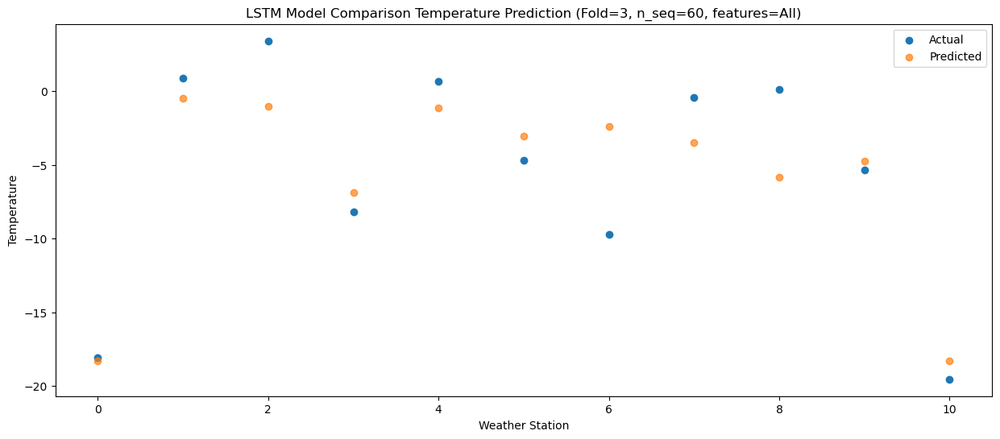

Predictions for (t+4):
    Weather_Station  Actual  Predicted
0                 0  -12.83 -12.235918
1                 1    8.34   5.582980
2                 2    5.19   5.049921
3                 3   -1.29  -0.802890
4                 4    8.07   4.898291
5                 5    2.19   3.016190
6                 6   -4.78   3.650054
7                 7    2.70   2.569524
8                 8   -0.46   0.254819
9                 9   -1.79   1.320379
10               10  -15.12 -12.244011


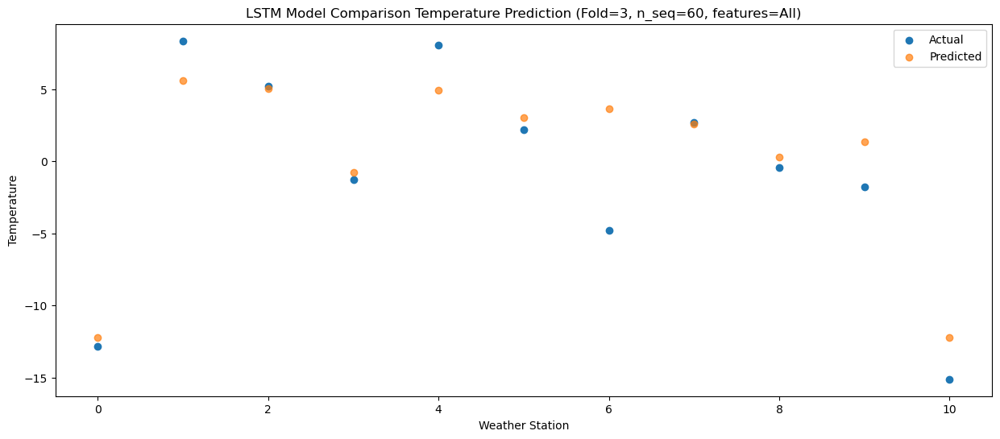

Predictions for (t+5):
    Weather_Station  Actual  Predicted
0                 0  -11.76 -10.265923
1                 1    9.26   7.551100
2                 2    9.85   7.015982
3                 3   -0.65   1.165831
4                 4   11.10   6.869087
5                 5    4.46   4.989895
6                 6   -1.80   5.622057
7                 7    8.61   4.540982
8                 8    3.16   2.224754
9                 9   -0.35   3.293631
10               10  -13.18 -10.272838


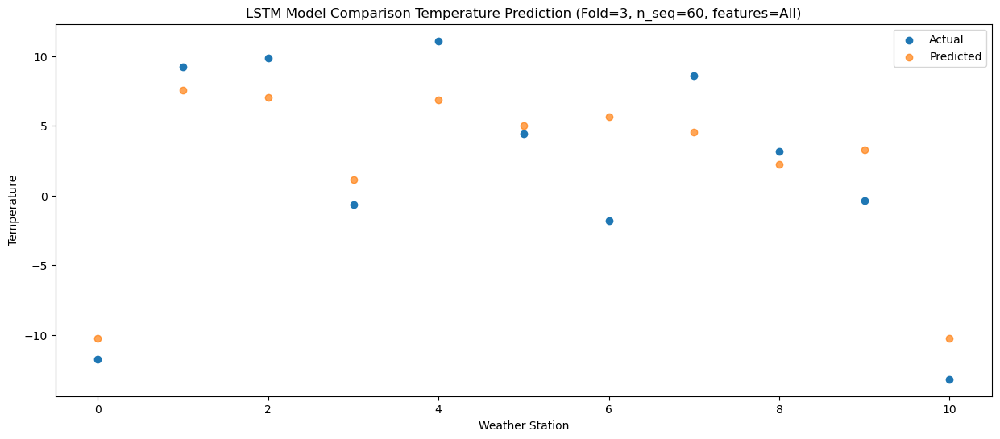

Predictions for (t+6):
    Weather_Station  Actual  Predicted
0                 0   -9.07  -4.778762
1                 1   13.66  13.038572
2                 2   15.04  12.500512
3                 3    3.92   6.654456
4                 4   17.17  12.358806
5                 5    9.87  10.481181
6                 6    5.31  11.107866
7                 7   15.88  10.020758
8                 8    5.56   7.706466
9                 9    5.21   8.783793
10               10   -7.41  -4.781575


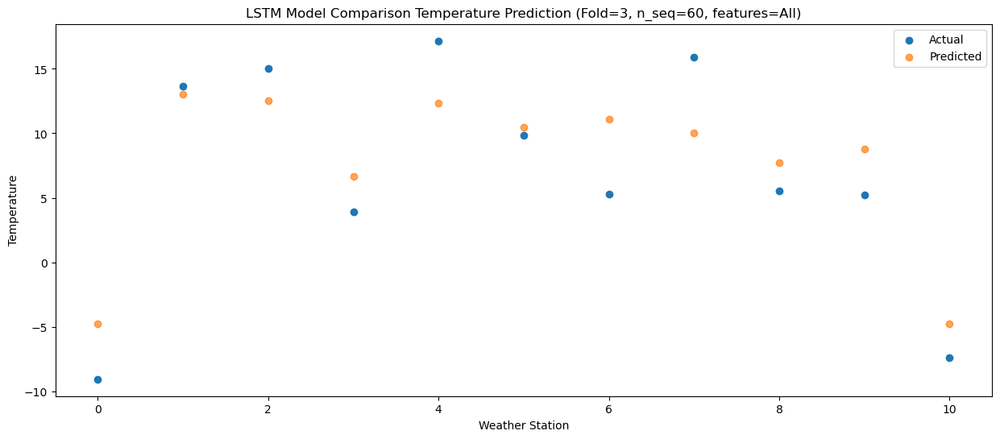

Predictions for (t+7):
    Weather_Station  Actual  Predicted
0                 0   -3.75   1.005375
1                 1   20.76  18.821624
2                 2   18.39  18.275695
3                 3    9.74  12.437353
4                 4   24.22  18.148074
5                 5   16.86  16.265982
6                 6    9.52  16.884170
7                 7   19.34  15.797294
8                 8    8.10  13.480321
9                 9   12.19  14.567777
10               10   -0.69   1.000752


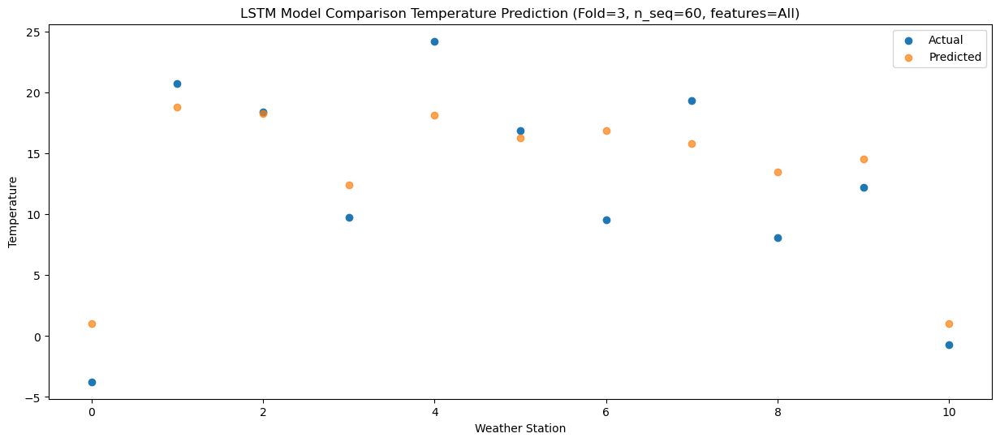

Predictions for (t+8):
    Weather_Station  Actual  Predicted
0                 0   -0.89   3.619971
1                 1   22.62  21.435782
2                 2   21.17  20.888079
3                 3   13.54  15.047217
4                 4   25.68  20.755541
5                 5   18.75  18.871865
6                 6   11.51  19.495484
7                 7   23.57  18.407192
8                 8    7.29  16.092546
9                 9   16.14  17.176483
10               10    3.08   3.610404


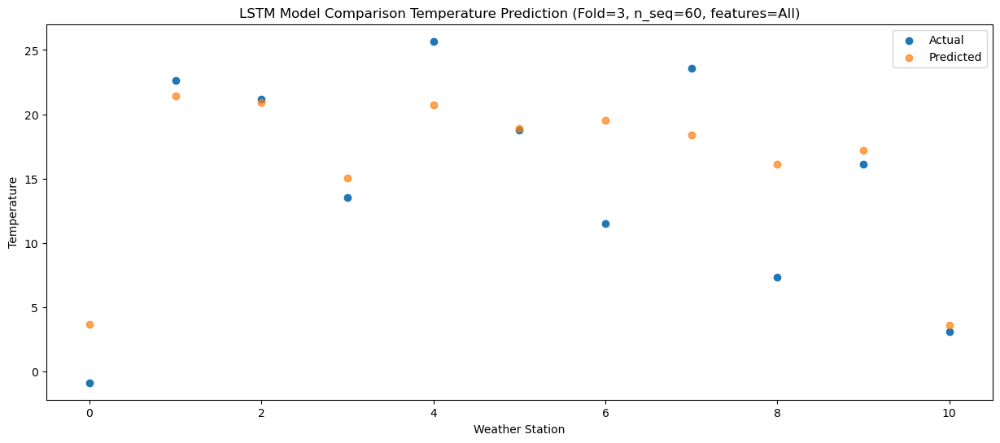

Predictions for (t+9):
    Weather_Station  Actual  Predicted
0                 0   -2.12   2.459504
1                 1   20.76  20.276837
2                 2   21.70  19.723364
3                 3   11.12  13.886003
4                 4   23.12  19.597353
5                 5   16.24  17.711877
6                 6   12.26  18.328605
7                 7   23.68  17.239964
8                 8    9.17  14.928905
9                 9   14.96  16.014560
10               10    1.21   2.445864


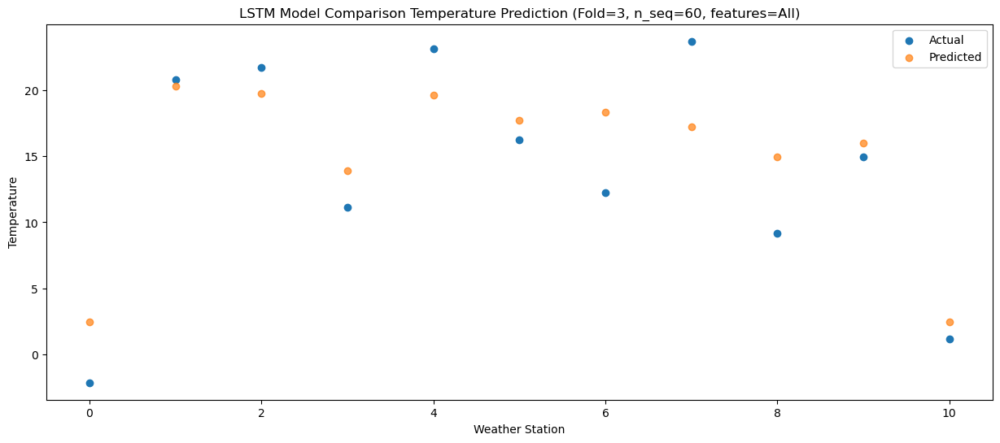

Predictions for (t+10):
    Weather_Station  Actual  Predicted
0                 0   -6.09  -2.235656
1                 1   17.09  15.578988
2                 2   17.37  15.031486
3                 3    7.06   9.188180
4                 4   19.05  14.901295
5                 5   12.61  13.011257
6                 6    6.76  13.631317
7                 7   18.87  12.551328
8                 8    8.59  10.241476
9                 9   10.62  11.321652
10               10   -3.76  -2.250320


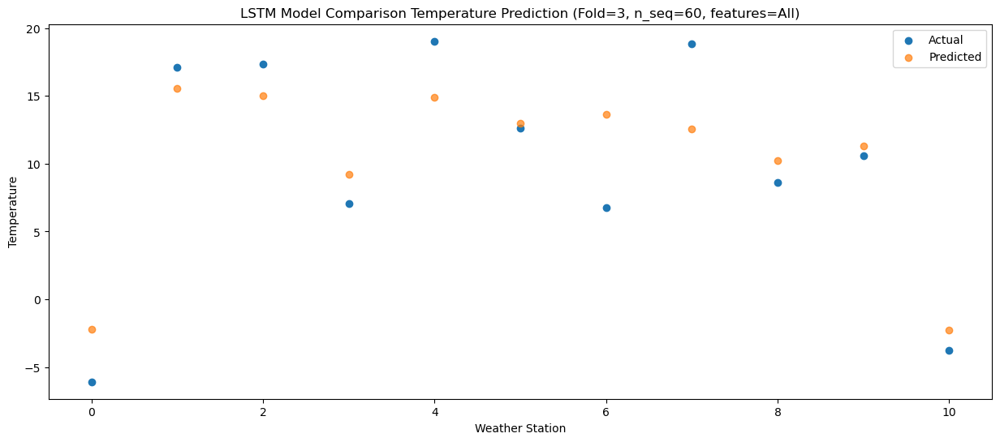

Predictions for (t+11):
    Weather_Station  Actual  Predicted
0                 0   -9.66  -8.370728
1                 1    9.98   9.444023
2                 2   11.88   8.906330
3                 3    1.64   3.051067
4                 4   11.32   8.762109
5                 5    6.61   6.876641
6                 6    3.02   7.503177
7                 7   11.93   6.424986
8                 8    6.37   4.110513
9                 9    5.30   5.189046
10               10   -9.25  -8.376025


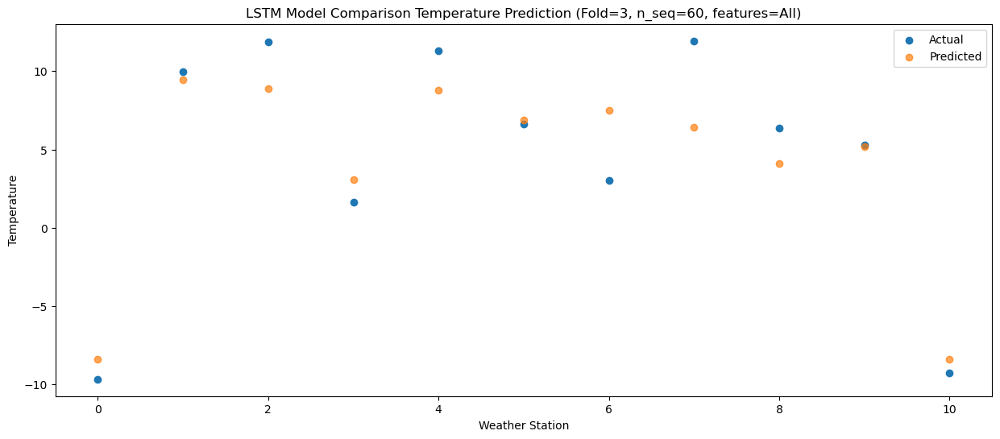

Predictions for (t+12):
    Weather_Station  Actual  Predicted
0                 0  -14.08 -11.783245
1                 1    7.16   6.028728
2                 2    3.23   5.494275
3                 3   -2.28  -0.359429
4                 4    8.50   5.357012
5                 5    2.67   3.469734
6                 6   -4.17   4.089658
7                 7    3.12   3.013801
8                 8   -0.79   0.696603
9                 9    1.23   1.779454
10               10  -13.53 -11.784539


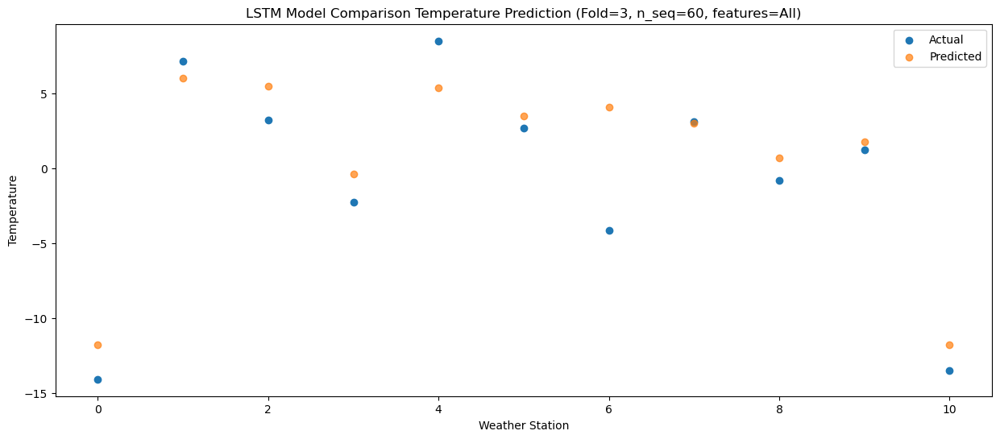

Predictions for (t+13):
    Weather_Station  Actual  Predicted
0                 0  -21.26 -18.430771
1                 1    0.61  -0.630711
2                 2    0.03  -1.150074
3                 3   -9.48  -7.012319
4                 4    1.33  -1.304267
5                 5   -4.94  -3.188650
6                 6   -9.87  -2.561964
7                 7   -2.57  -3.624287
8                 8   -2.84  -5.936579
9                 9   -5.11  -4.863756
10               10  -20.35 -18.426163


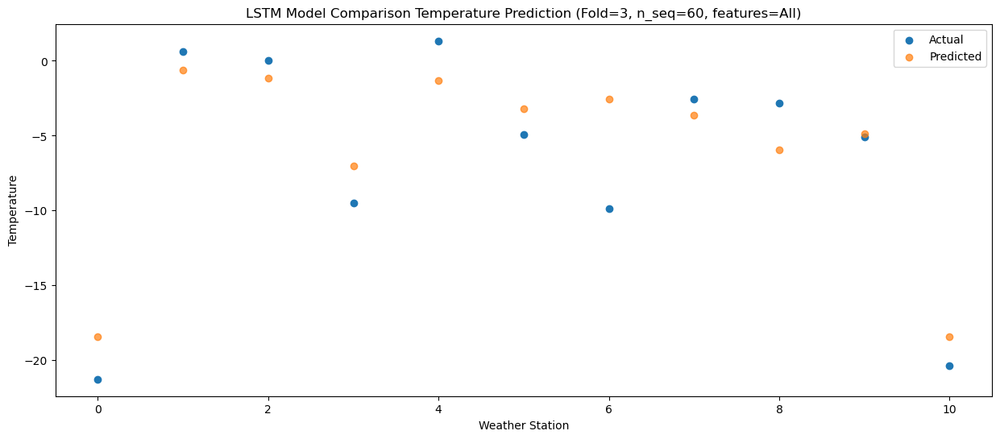

Predictions for (t+14):
    Weather_Station  Actual  Predicted
0                 0  -21.54 -19.411370
1                 1   -0.54  -1.620352
2                 2    1.29  -2.135111
3                 3  -10.94  -7.995659
4                 4   -0.14  -2.295051
5                 5   -6.39  -4.176830
6                 6   -9.60  -3.545570
7                 7   -2.02  -4.608369
8                 8   -1.62  -6.916379
9                 9   -8.13  -5.840340
10               10  -21.91 -19.404663


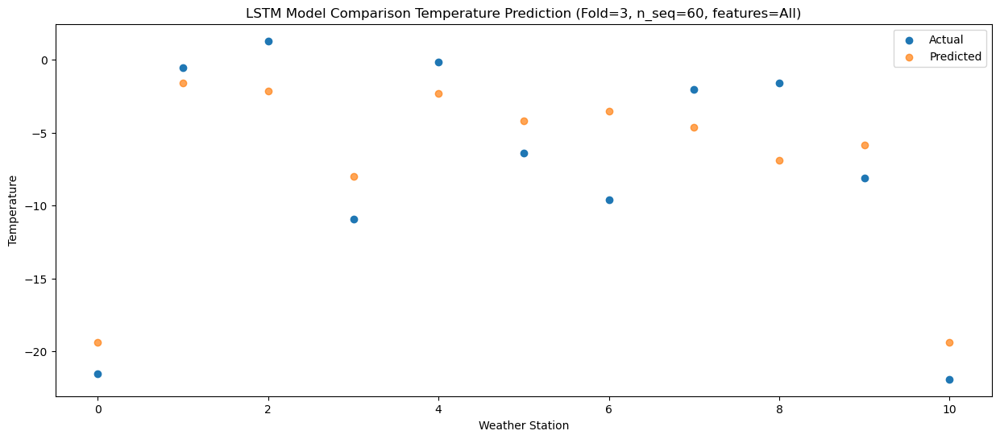

Predictions for (t+15):
    Weather_Station  Actual  Predicted
0                 0  -21.17 -21.900063
1                 1   -4.26  -4.114676
2                 2    3.59  -4.627229
3                 3  -12.26 -10.486601
4                 4   -4.01  -4.791451
5                 5   -9.11  -6.675005
6                 6   -9.50  -6.036734
7                 7    0.83  -7.092984
8                 8   -0.69  -9.404093
9                 9   -8.25  -8.328901
10               10  -22.71 -21.893779


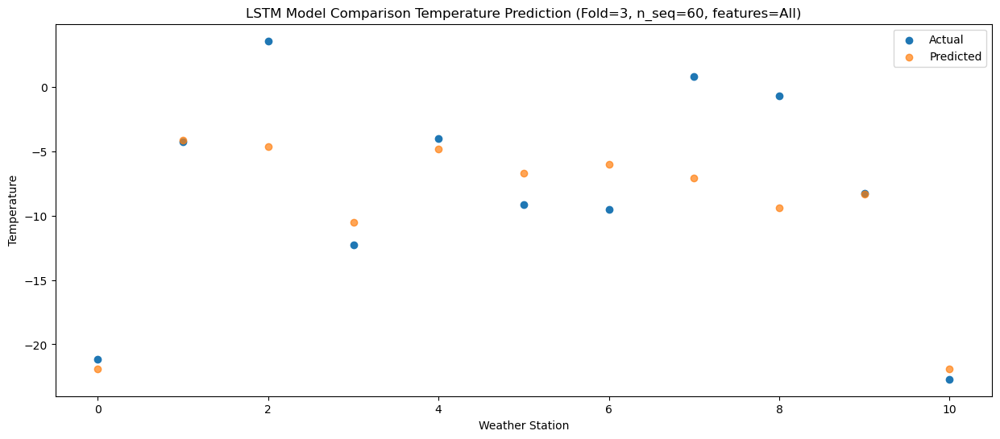

Predictions for (t+16):
    Weather_Station  Actual  Predicted
0                 0  -14.37 -12.740806
1                 1    7.71   5.053182
2                 2    4.74   4.535977
3                 3   -2.05  -1.322272
4                 4    9.07   4.381458
5                 5    2.22   2.496998
6                 6   -6.53   3.128454
7                 7    2.43   2.062249
8                 8   -0.91  -0.254143
9                 9   -3.25   0.828727
10               10  -15.52 -12.734834


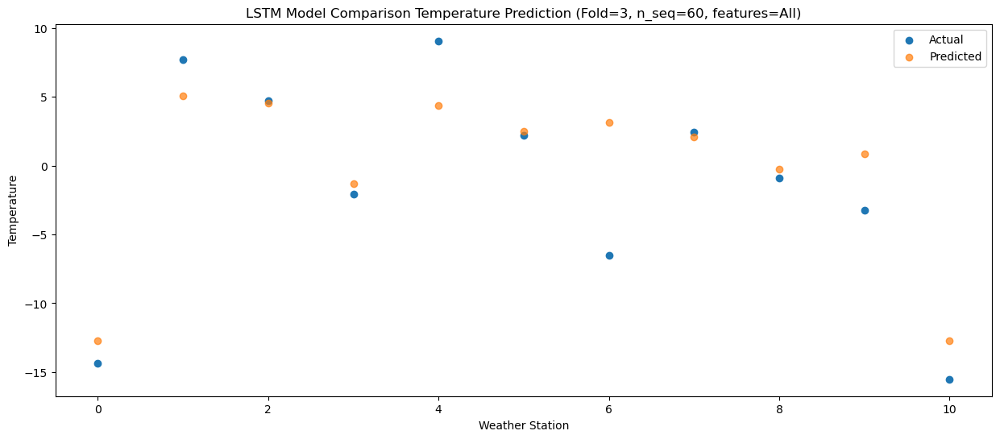

Predictions for (t+17):
    Weather_Station  Actual  Predicted
0                 0  -11.21  -9.440735
1                 1    9.57   8.352132
2                 2   10.47   7.841215
3                 3    0.30   1.982861
4                 4   12.36   7.686285
5                 5    5.67   5.803712
6                 6   -1.75   6.437449
7                 7   10.40   5.370756
8                 8    1.28   3.056573
9                 9    1.37   4.134382
10               10  -10.65  -9.428269


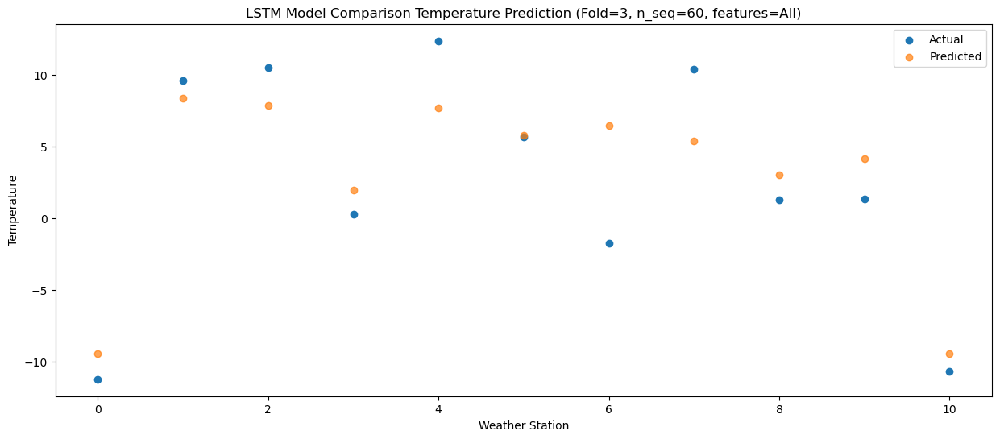

Predictions for (t+18):
    Weather_Station  Actual  Predicted
0                 0   -7.55  -4.775666
1                 1   13.79  13.015536
2                 2   15.27  12.508141
3                 3    4.37   6.649596
4                 4   16.93  12.351637
5                 5    9.95  10.471726
6                 6    3.30  11.102037
7                 7   14.83  10.035564
8                 8    5.57   7.726211
9                 9    6.20   8.799511
10               10   -6.39  -4.764850


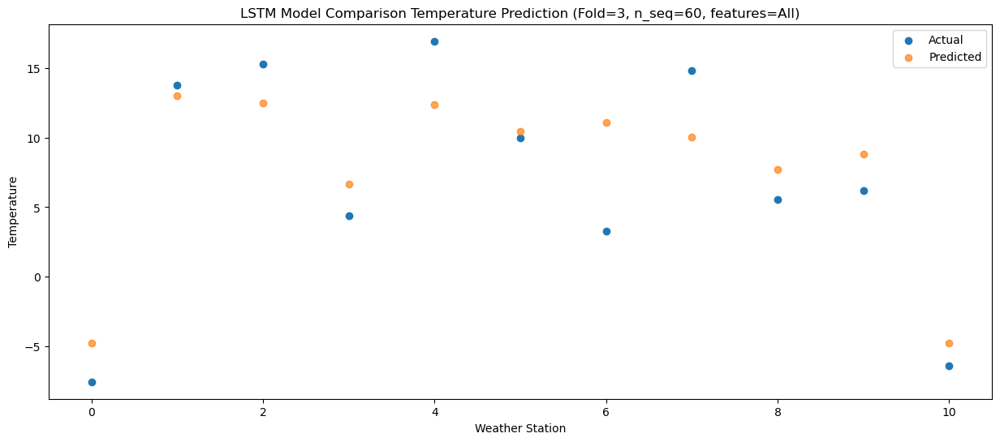

Predictions for (t+19):
    Weather_Station  Actual  Predicted
0                 0   -3.49   1.582912
1                 1   20.50  19.384101
2                 2   20.12  18.869963
3                 3   10.29  13.007021
4                 4   24.41  18.714862
5                 5   16.66  16.831052
6                 6   10.69  17.463432
7                 7   22.47  16.394536
8                 8    7.27  14.079083
9                 9   12.07  15.151241
10               10   -0.22   1.586695


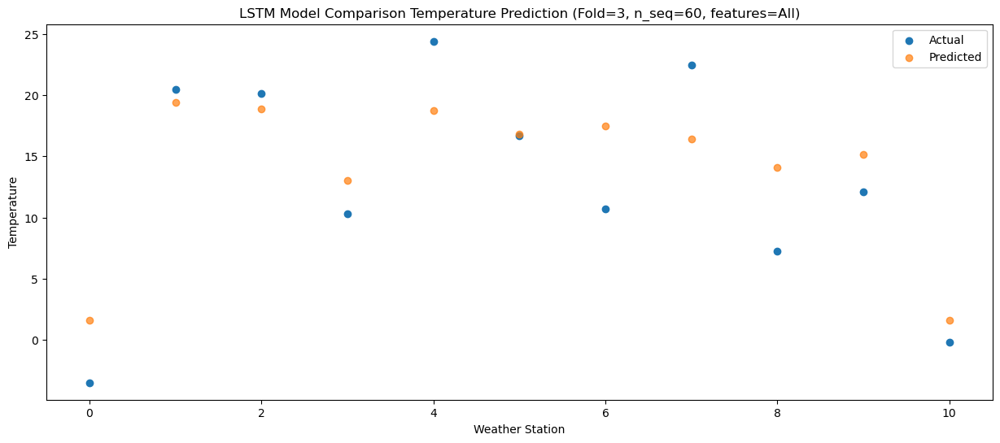

Predictions for (t+20):
    Weather_Station  Actual  Predicted
0                 0   -1.78   2.193790
1                 1   21.81  19.990835
2                 2   23.25  19.483052
3                 3   11.28  13.616561
4                 4   24.41  19.320615
5                 5   17.04  17.437331
6                 6   12.53  18.079817
7                 7   23.55  17.013486
8                 8    6.45  14.702449
9                 9   14.21  15.766355
10               10    1.42   2.197809


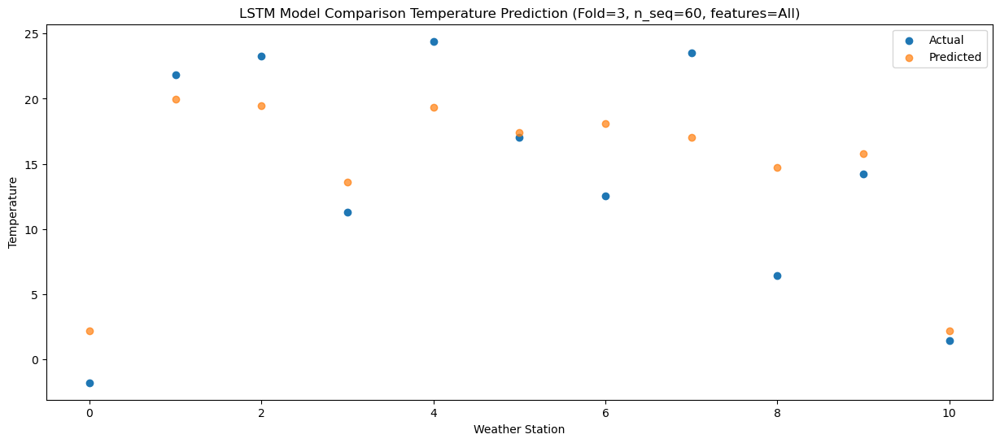

Predictions for (t+21):
    Weather_Station  Actual  Predicted
0                 0   -1.56   2.594088
1                 1   22.38  20.383717
2                 2   21.05  19.863469
3                 3   11.80  14.009101
4                 4   24.53  19.717509
5                 5   17.36  17.834224
6                 6   10.61  18.464750
7                 7   22.32  17.392066
8                 8    7.00  15.078652
9                 9   14.83  16.154576
10               10    1.15   2.587940


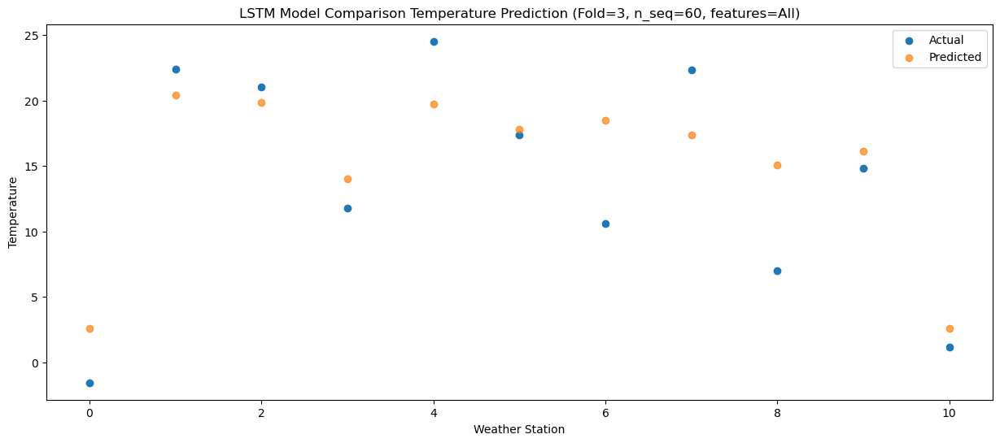

Predictions for (t+22):
    Weather_Station  Actual  Predicted
0                 0   -5.55  -1.008977
1                 1   19.65  16.777617
2                 2   17.74  16.262553
3                 3    7.67  10.401225
4                 4   21.17  16.101434
5                 5   14.10  14.223334
6                 6    8.74  14.861066
7                 7   18.35  13.789223
8                 8    6.45  11.479984
9                 9   11.51  12.550111
10               10   -3.11  -1.016647


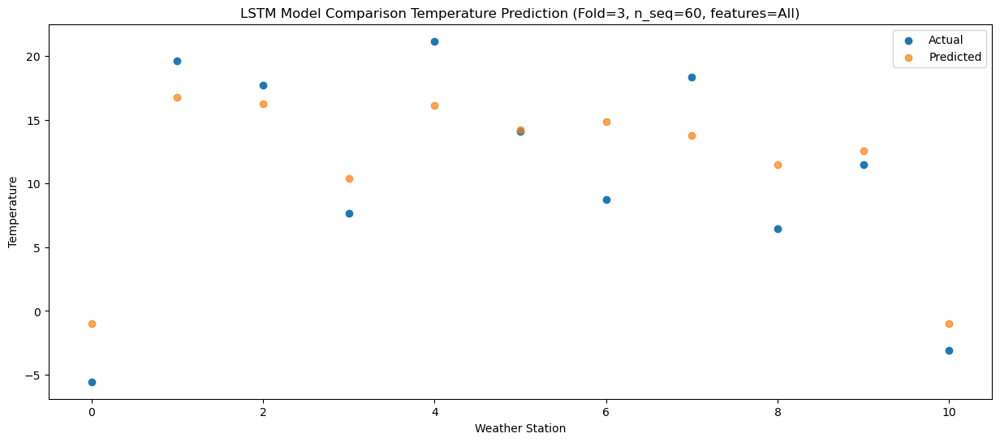

Predictions for (t+23):
    Weather_Station  Actual  Predicted
0                 0   -8.78  -5.990078
1                 1   13.05  11.786800
2                 2    9.08  11.270189
3                 3    4.09   5.414549
4                 4   15.75  11.115806
5                 5    9.52   9.240605
6                 6    0.77   9.869722
7                 7    8.00   8.798268
8                 8    3.69   6.489638
9                 9    7.07   7.565411
10               10   -7.23  -5.995003


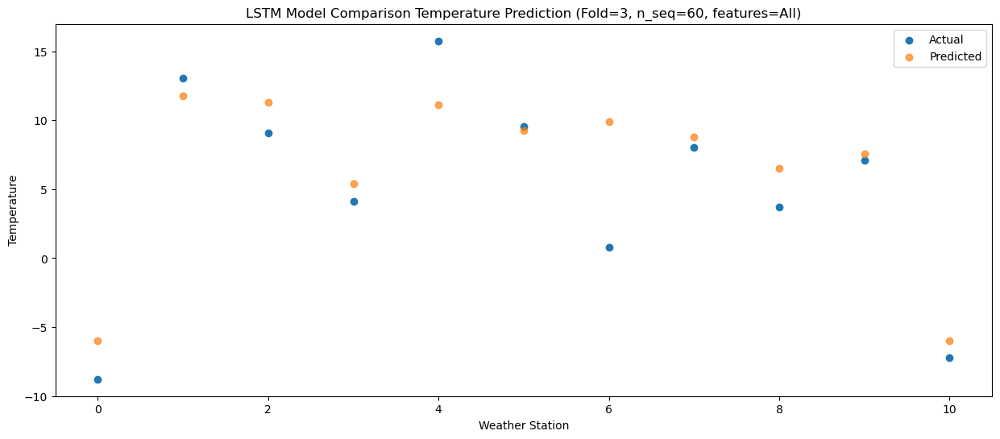

Predictions for (t+24):
    Weather_Station  Actual  Predicted
0                 0  -17.54 -14.035307
1                 1    5.34   3.734560
2                 2    4.74   3.224328
3                 3   -5.57  -2.637488
4                 4    6.01   3.060667
5                 5   -1.33   1.184349
6                 6   -1.97   1.821661
7                 7    5.48   0.752811
8                 8    0.87  -1.555258
9                 9   -1.85  -0.482819
10               10  -17.45 -14.045311


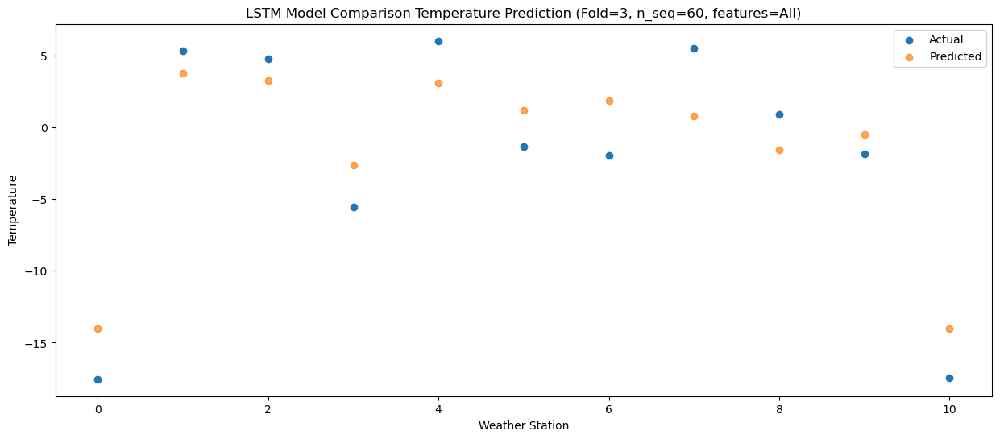

Predictions for (t+25):
    Weather_Station  Actual  Predicted
0                 0  -15.58 -15.308768
1                 1    6.65   2.466563
2                 2    0.82   1.944600
3                 3   -4.08  -3.918179
4                 4    5.65   1.783559
5                 5   -0.28  -0.095662
6                 6   -6.73   0.539492
7                 7   -1.79  -0.532175
8                 8   -2.83  -2.839178
9                 9   -3.45  -1.764941
10               10  -17.86 -15.325785


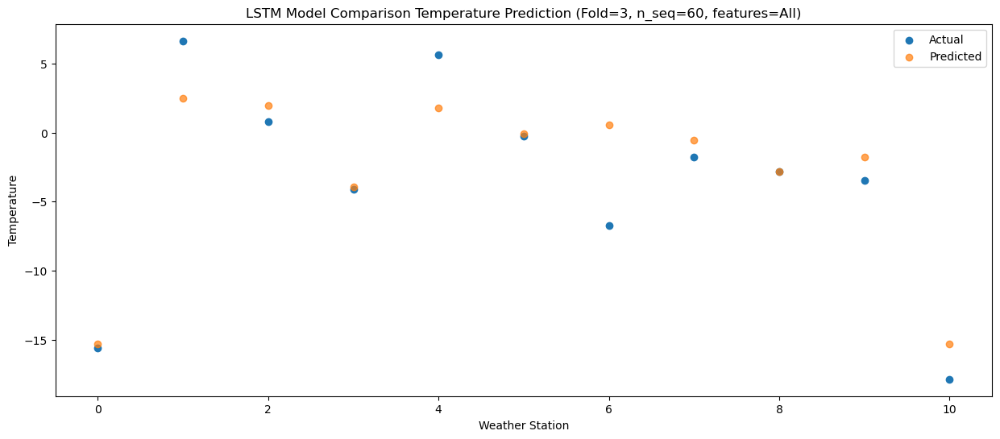

Predictions for (t+26):
    Weather_Station  Actual  Predicted
0                 0  -22.42 -21.924862
1                 1   -2.18  -4.158349
2                 2    0.49  -4.673637
3                 3  -13.03 -10.532034
4                 4   -3.82  -4.831572
5                 5   -9.10  -6.710743
6                 6   -9.02  -6.079004
7                 7   -1.86  -7.148852
8                 8   -2.21  -9.452980
9                 9  -10.00  -8.377998
10               10  -24.84 -21.942003


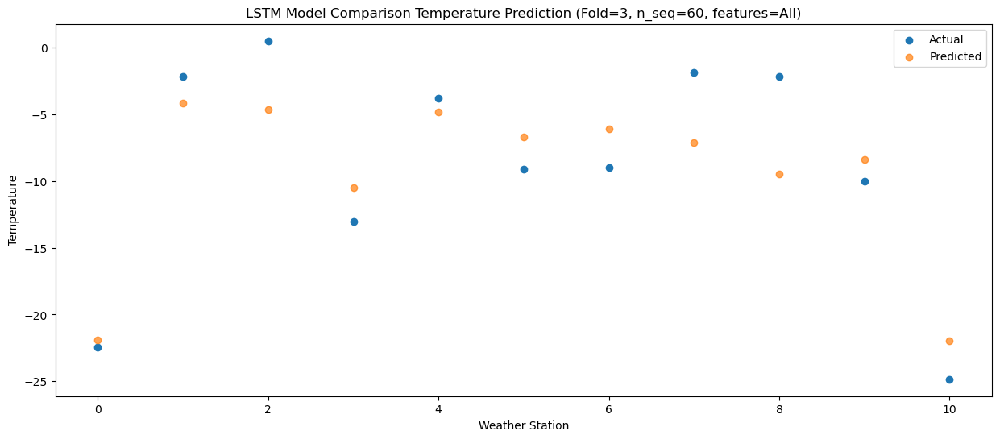

Predictions for (t+27):
    Weather_Station  Actual  Predicted
0                 0  -18.04 -19.474631
1                 1   -0.96  -1.723813
2                 2    2.19  -2.234614
3                 3   -8.51  -8.093142
4                 4   -1.30  -2.397645
5                 5   -5.91  -4.273418
6                 6  -10.74  -3.635957
7                 7    0.18  -4.706190
8                 8   -1.25  -7.008960
9                 9   -7.24  -5.936015
10               10  -21.03 -19.498601


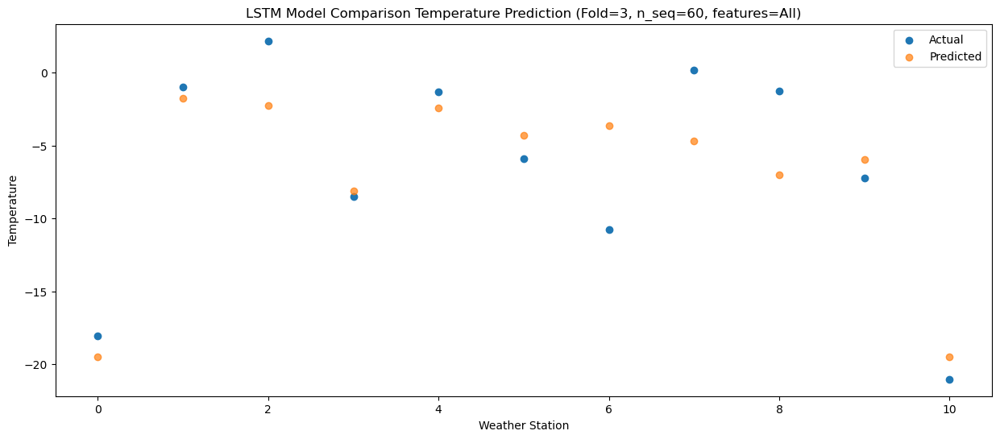

Predictions for (t+28):
    Weather_Station  Actual  Predicted
0                 0  -13.98 -13.778303
1                 1    5.82   3.970548
2                 2    6.90   3.464816
3                 3   -2.76  -2.394356
4                 4    7.16   3.298357
5                 5    1.05   1.420698
6                 6   -6.20   2.056696
7                 7    4.89   0.988665
8                 8    0.98  -1.304848
9                 9   -3.28  -0.238575
10               10  -15.85 -13.804231


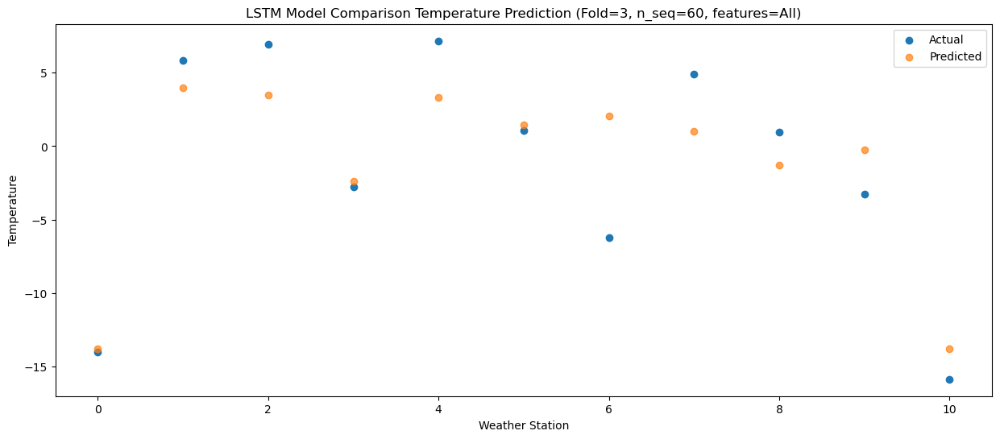

Predictions for (t+29):
    Weather_Station  Actual  Predicted
0                 0  -10.88  -9.466455
1                 1   10.67   8.286776
2                 2    9.97   7.786144
3                 3    0.25   1.918567
4                 4   11.29   7.610096
5                 5    4.90   5.733193
6                 6   -1.88   6.373653
7                 7    9.52   5.305884
8                 8    2.42   3.012608
9                 9    1.01   4.079703
10               10  -12.03  -9.491669


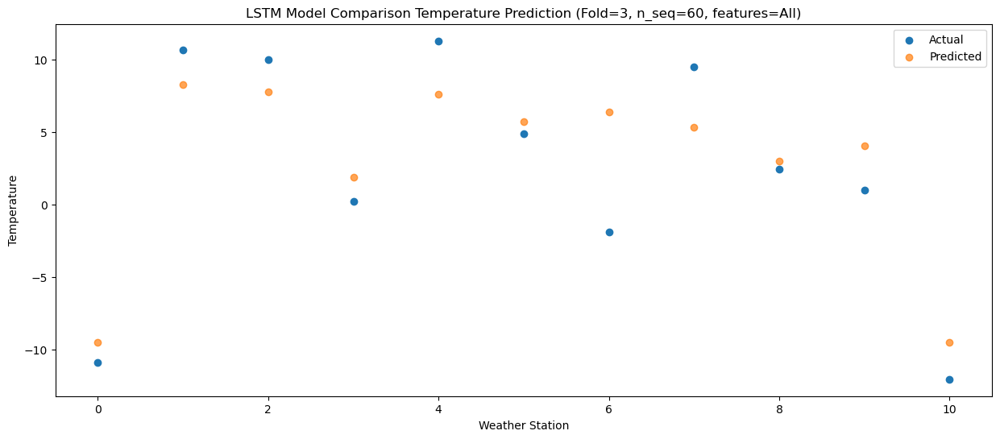

Predictions for (t+30):
    Weather_Station  Actual  Predicted
0                 0   -6.04  -2.533089
1                 1   16.10  15.215081
2                 2   14.21  14.711567
3                 3    7.03   8.849015
4                 4   18.86  14.544295
5                 5   12.70  12.663306
6                 6    4.03  13.309552
7                 7   14.19  12.237645
8                 8    5.41   9.942857
9                 9    6.80  11.013298
10               10   -5.25  -2.562964


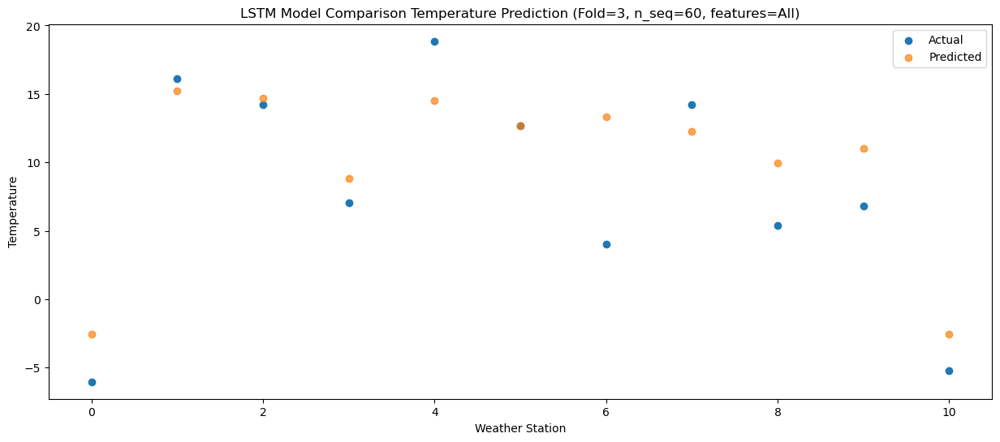

Predictions for (t+31):
    Weather_Station  Actual  Predicted
0                 0   -2.08   1.533329
1                 1   21.25  19.285390
2                 2   19.60  18.783797
3                 3   10.51  12.915131
4                 4   24.31  18.613237
5                 5   16.64  16.733090
6                 6    9.80  17.379238
7                 7   20.67  16.311237
8                 8    8.56  14.015046
9                 9   11.12  15.086264
10               10   -1.26   1.511580


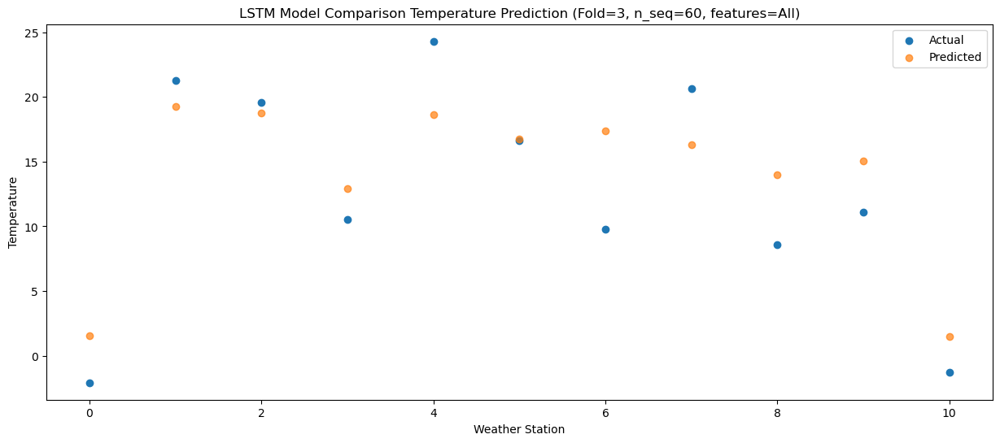

Predictions for (t+32):
    Weather_Station  Actual  Predicted
0                 0   -1.31   4.012704
1                 1   25.29  21.757304
2                 2   22.17  21.262702
3                 3   12.06  15.386401
4                 4   25.43  21.081045
5                 5   18.63  19.199196
6                 6   11.72  19.850029
7                 7   22.90  18.790273
8                 8    6.91  16.491471
9                 9   15.67  17.556395
10               10    2.52   3.983290


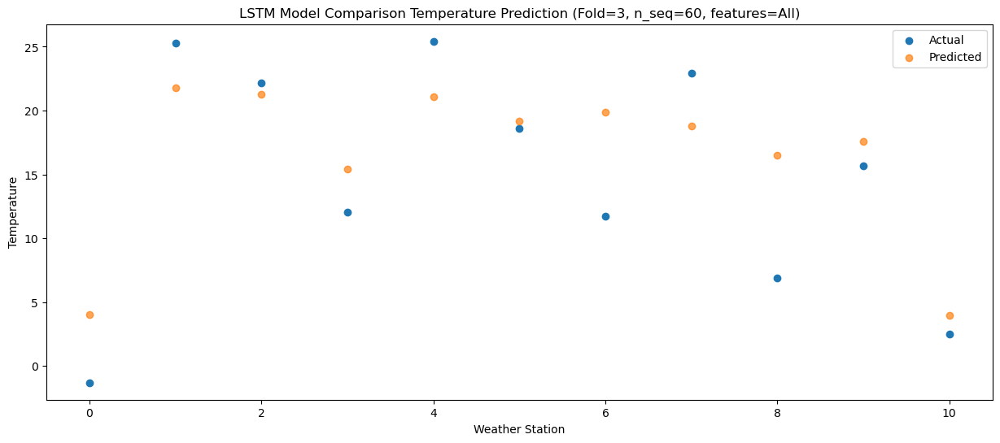

Predictions for (t+33):
    Weather_Station  Actual  Predicted
0                 0   -2.22   2.657944
1                 1   22.21  20.401274
2                 2   22.35  19.899016
3                 3   10.99  14.029370
4                 4   23.61  19.724225
5                 5   16.98  17.838666
6                 6   10.96  18.489029
7                 7   21.31  17.422198
8                 8    8.33  15.126452
9                 9   15.59  16.198304
10               10    1.65   2.623046


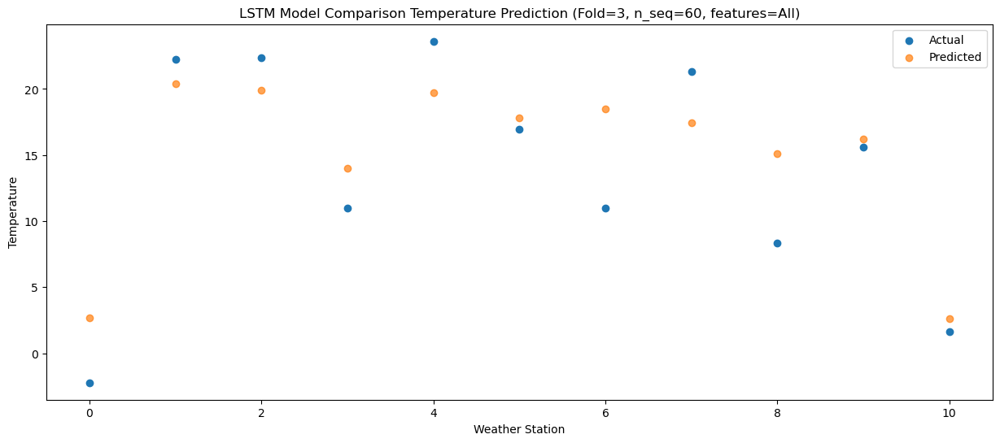

Predictions for (t+34):
    Weather_Station  Actual  Predicted
0                 0   -5.43  -0.896321
1                 1   18.35  16.837741
2                 2   19.53  16.328085
3                 3    7.01  10.467052
4                 4   19.29  16.165732
5                 5   13.03  14.278131
6                 6    8.80  14.916698
7                 7   18.95  13.851889
8                 8    8.56  11.555400
9                 9   10.68  12.631554
10               10   -3.58  -0.939488


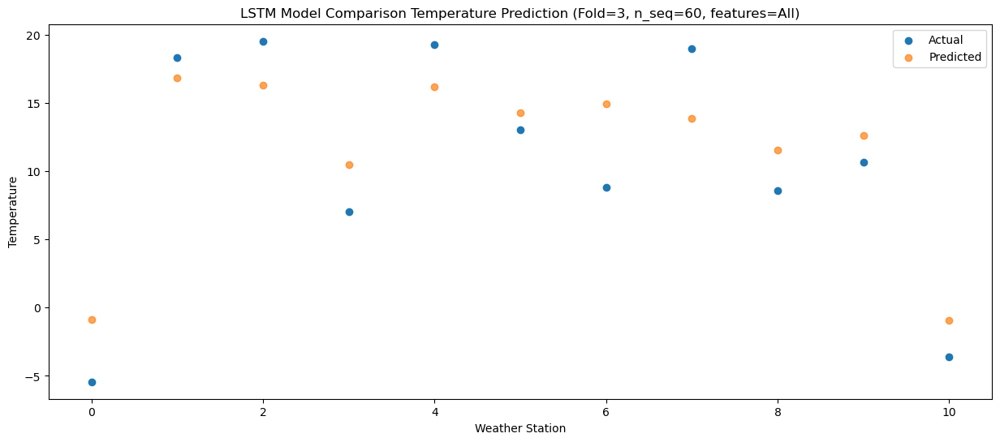

Predictions for (t+35):
    Weather_Station  Actual  Predicted
0                 0  -12.44  -7.636300
1                 1   11.80  10.099711
2                 2   12.35   9.590849
3                 3   -0.26   3.731228
4                 4   12.02   9.427720
5                 5    6.99   7.542423
6                 6    0.54   8.180652
7                 7   11.06   7.115600
8                 8    3.83   4.815542
9                 9    4.42   5.894032
10               10  -11.19  -7.675885


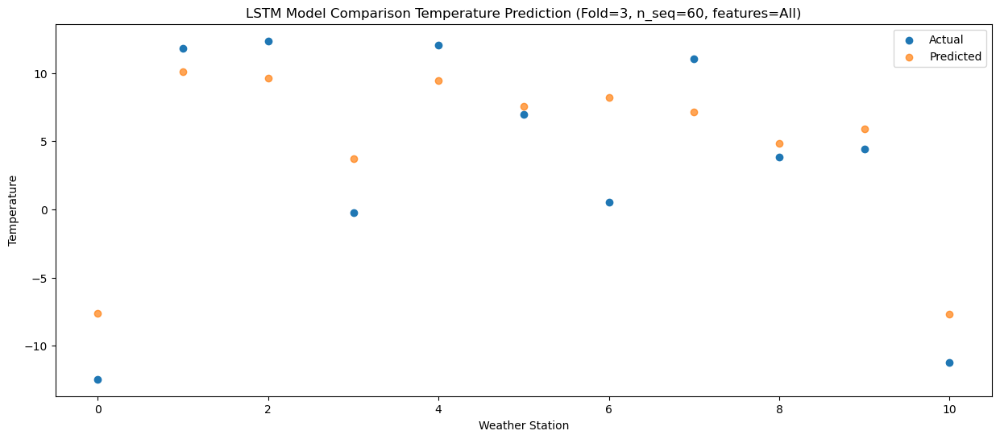

Predictions for (t+36):
    Weather_Station  Actual  Predicted
0                 0  -14.47 -13.789142
1                 1    4.57   3.940314
2                 2    1.62   3.424680
3                 3   -3.38  -2.423456
4                 4    6.13   3.267521
5                 5    0.44   1.384956
6                 6   -7.14   2.019460
7                 7   -0.36   0.946725
8                 8   -1.90  -1.351608
9                 9    0.46  -0.264954
10               10  -14.31 -13.829566


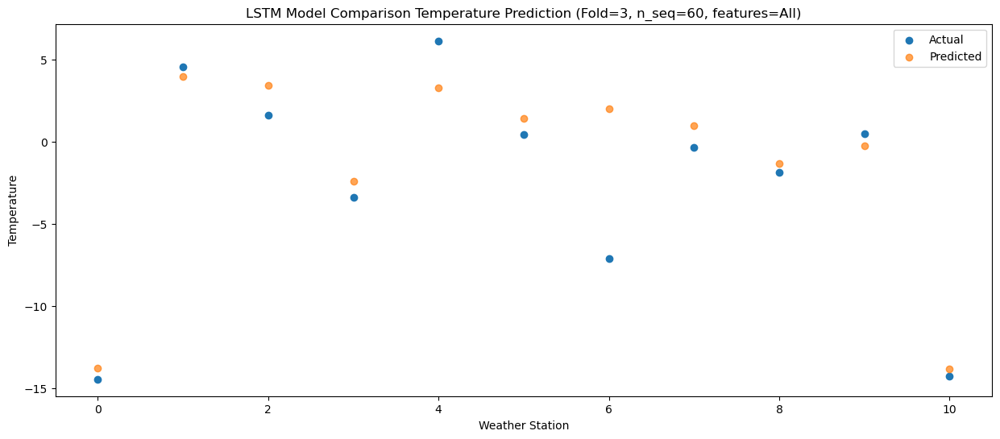

Predictions for (t+37):
    Weather_Station  Actual  Predicted
0                 0  -21.35 -18.982010
1                 1    0.52  -1.255302
2                 2    0.66  -1.766408
3                 3   -8.65  -7.618935
4                 4    0.16  -1.929106
5                 5   -5.10  -3.812858
6                 6   -9.31  -3.173153
7                 7   -2.69  -4.242881
8                 8   -3.10  -6.538081
9                 9   -5.90  -5.457117
10               10  -21.34 -19.027830


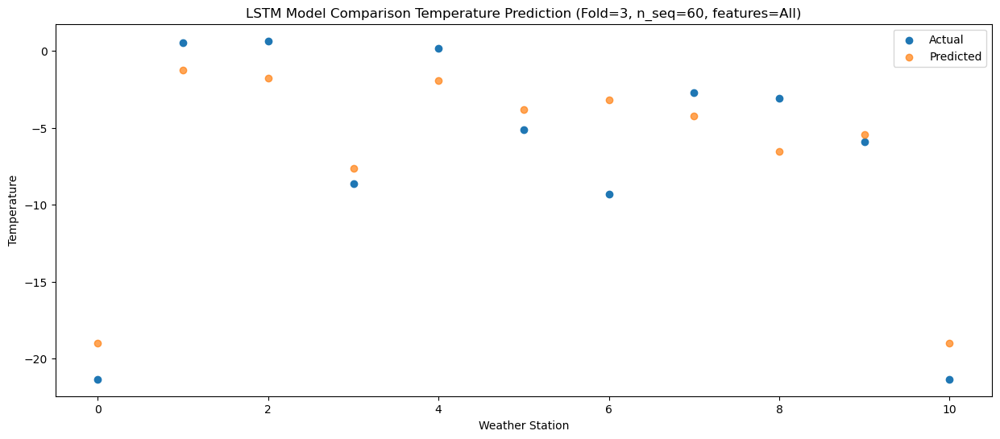

Predictions for (t+38):
    Weather_Station  Actual  Predicted
0                 0  -17.93 -17.740425
1                 1    1.22  -0.006865
2                 2    2.05  -0.525022
3                 3   -6.90  -6.372483
4                 4    1.88  -0.679465
5                 5   -2.96  -2.557130
6                 6  -10.04  -1.930608
7                 7   -3.20  -3.004798
8                 8   -1.43  -5.295496
9                 9   -3.92  -4.213639
10               10  -18.69 -17.784255


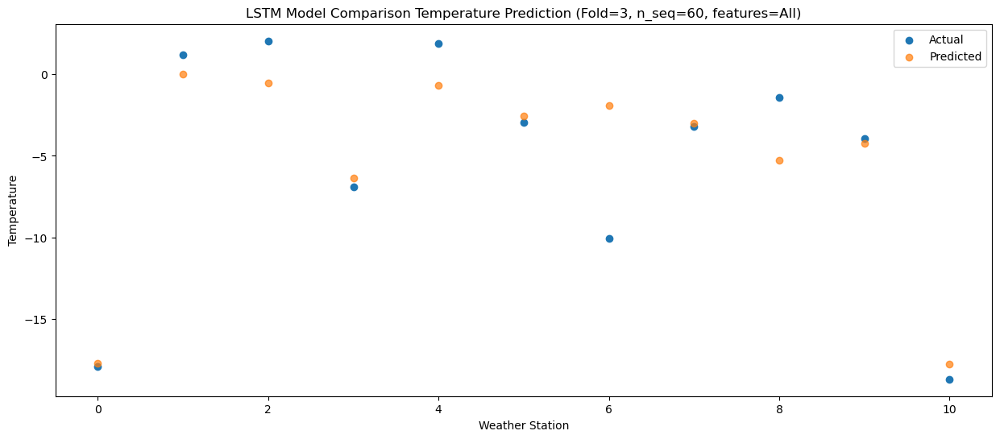

Predictions for (t+39):
    Weather_Station  Actual  Predicted
0                 0  -15.11 -17.226948
1                 1    3.18   0.502219
2                 2    1.20  -0.023818
3                 3   -4.56  -5.865918
4                 4    8.40  -0.176634
5                 5   -1.24  -2.052808
6                 6  -10.01  -1.425908
7                 7   -2.29  -2.503934
8                 8   -3.23  -4.795565
9                 9   -5.65  -3.708784
10               10  -18.48 -17.277467


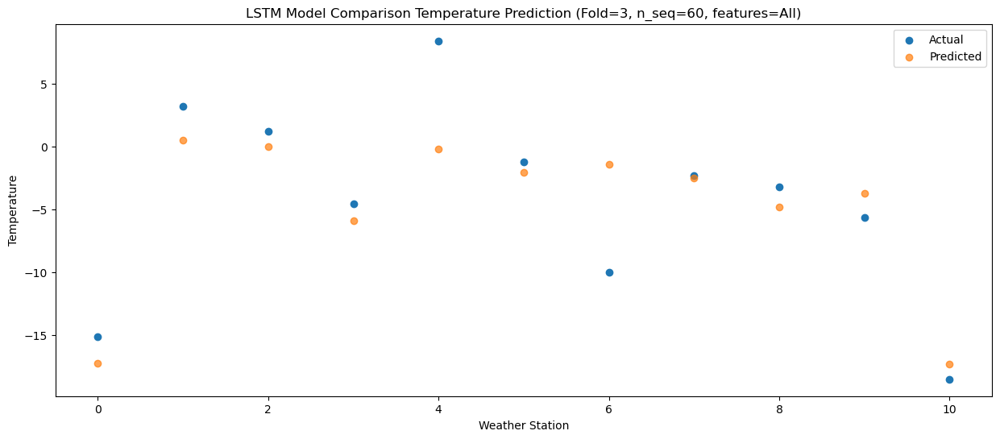

Predictions for (t+40):
    Weather_Station  Actual  Predicted
0                 0  -14.64 -15.016540
1                 1    5.78   2.707298
2                 2    4.07   2.176078
3                 3   -4.32  -3.662526
4                 4    5.44   2.021858
5                 5   -0.34   0.146526
6                 6   -8.22   0.774517
7                 7    0.54  -0.311775
8                 8   -1.77  -2.600092
9                 9   -3.68  -1.511798
10               10  -16.92 -15.075635


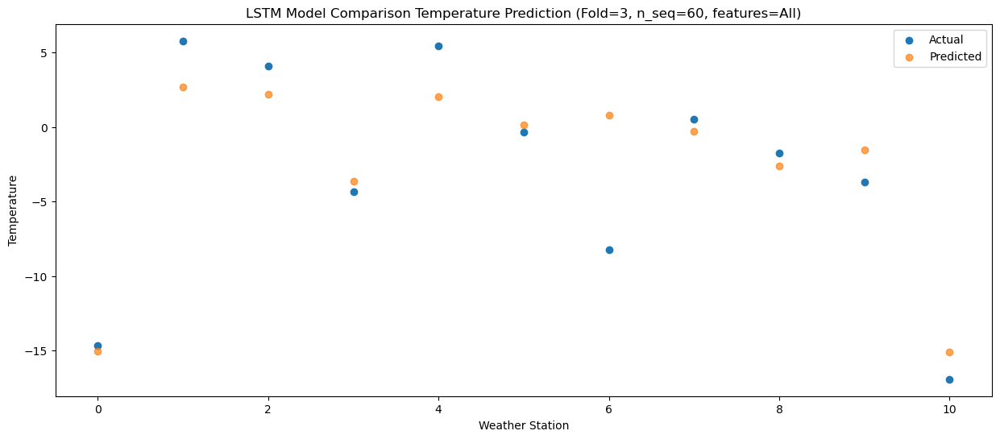

Predictions for (t+41):
    Weather_Station  Actual  Predicted
0                 0  -10.97  -8.554146
1                 1   10.83   9.173373
2                 2    9.70   8.637399
3                 3    1.92   2.797898
4                 4   12.65   8.479495
5                 5    5.89   6.602602
6                 6   -2.88   7.228557
7                 7    8.49   6.143905
8                 8    2.31   3.857921
9                 9    2.37   4.944631
10               10   -9.35  -8.619904


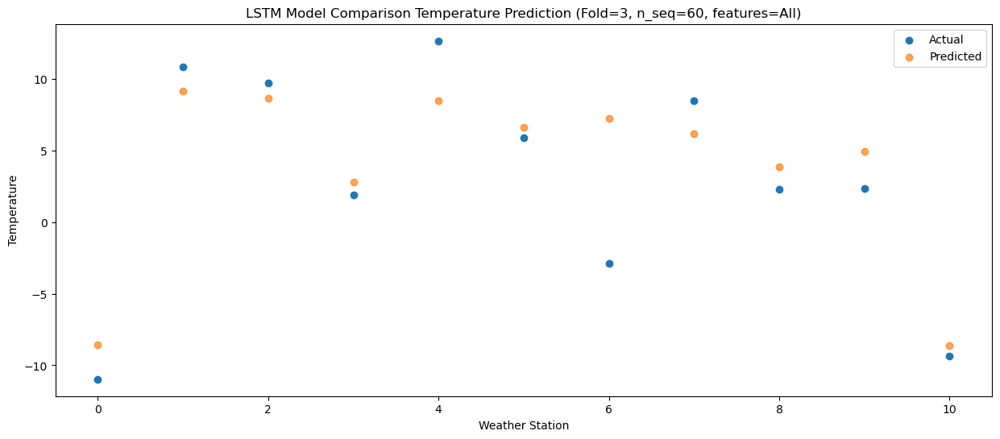

Predictions for (t+42):
    Weather_Station  Actual  Predicted
0                 0   -8.61  -3.477873
1                 1   16.14  14.260039
2                 2   14.14  13.714993
3                 3    4.61   7.876618
4                 4   18.65  13.562831
5                 5   11.30  11.686582
6                 6    4.33  12.303460
7                 7   14.29  11.213520
8                 8    3.34   8.922519
9                 9    6.01  10.012498
10               10   -6.88  -3.548888


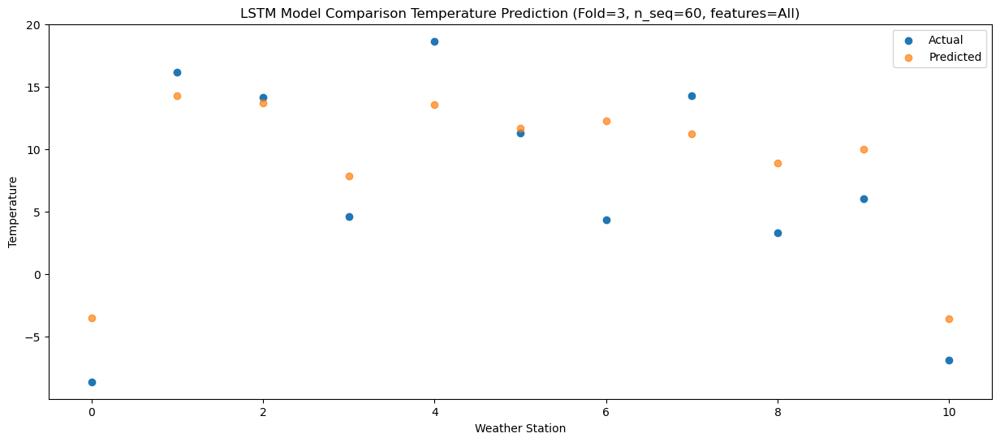

Predictions for (t+43):
    Weather_Station  Actual  Predicted
0                 0   -4.84   0.653701
1                 1   20.47  18.398726
2                 2   16.94  17.840367
3                 3    8.35  12.006531
4                 4   22.75  17.694377
5                 5   14.76  15.815255
6                 6    8.91  16.428690
7                 7   16.79  15.336458
8                 8    5.24  13.046272
9                 9   10.00  14.141327
10               10   -2.95   0.582957


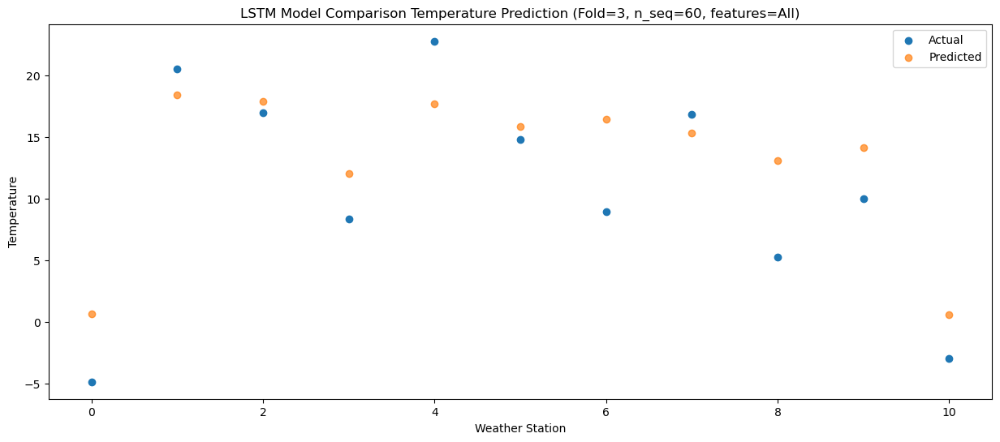

Predictions for (t+44):
    Weather_Station  Actual  Predicted
0                 0   -1.06   3.252271
1                 1   22.73  20.992385
2                 2   22.60  20.440429
3                 3   11.97  14.598663
4                 4   24.45  20.287825
5                 5   18.02  18.408591
6                 6   15.05  19.027448
7                 7   25.15  17.939177
8                 8    8.25  15.643820
9                 9   15.68  16.739698
10               10    1.89   3.180350


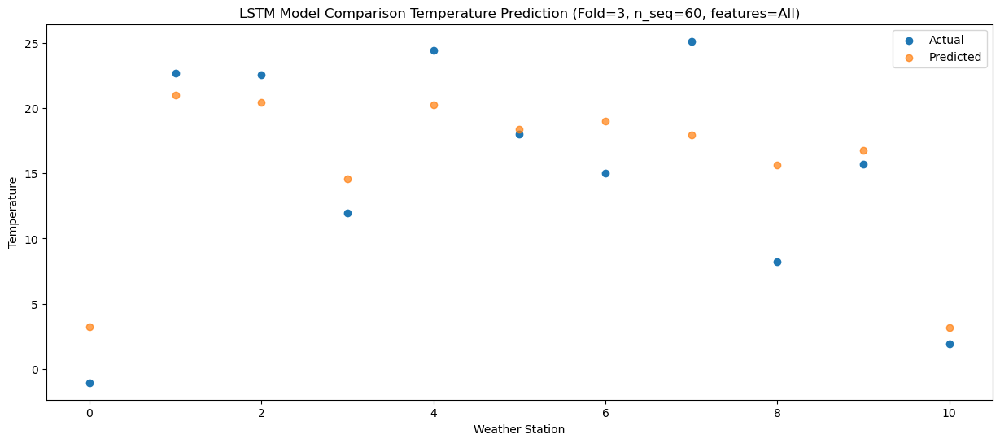

Predictions for (t+45):
    Weather_Station  Actual  Predicted
0                 0   -1.57   2.979317
1                 1   22.91  20.727188
2                 2   20.91  20.173883
3                 3   10.86  14.327951
4                 4   23.16  20.022095
5                 5   16.47  18.142760
6                 6   12.46  18.759530
7                 7   20.52  17.673628
8                 8    9.28  15.379469
9                 9   13.43  16.466693
10               10   -0.08   2.901345


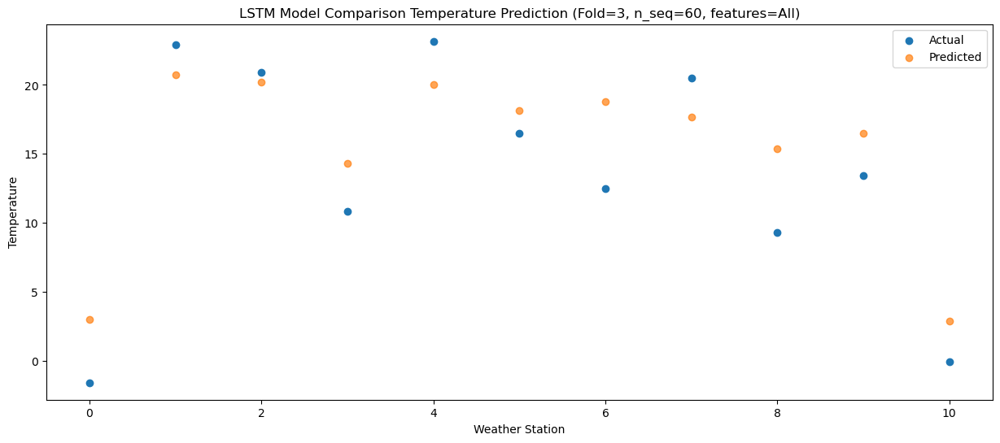

Predictions for (t+46):
    Weather_Station  Actual  Predicted
0                 0   -5.71  -0.532831
1                 1   18.86  17.221117
2                 2   17.14  16.655075
3                 3    8.13  10.818841
4                 4   19.80  16.519071
5                 5   13.01  14.638682
6                 6    8.31  15.246870
7                 7   15.82  14.155227
8                 8    6.67  11.852745
9                 9   10.86  12.952366
10               10   -3.37  -0.608306


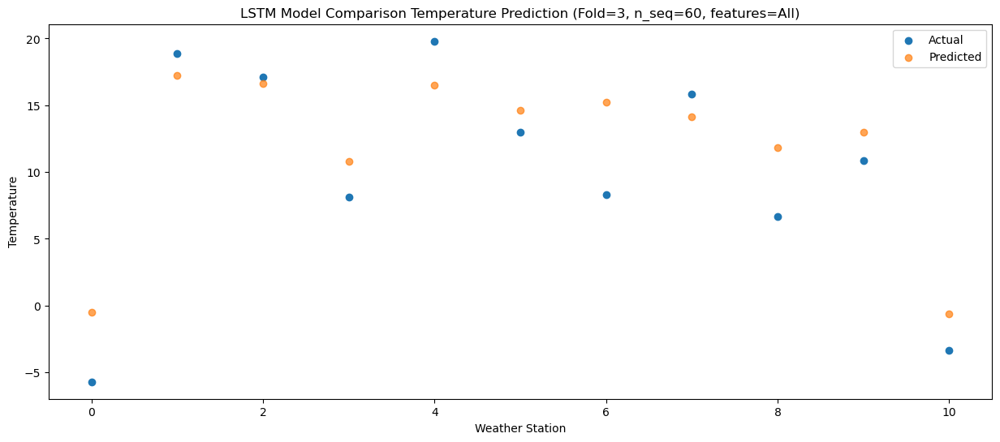

Predictions for (t+47):
    Weather_Station  Actual  Predicted
0                 0  -10.74  -6.971452
1                 1   11.92  10.784524
2                 2   11.83  10.212222
3                 3    2.69   4.382463
4                 4   13.34  10.082231
5                 5    7.36   8.197228
6                 6    2.18   8.802595
7                 7   10.53   7.715982
8                 8    5.21   5.423131
9                 9    5.43   6.523488
10               10   -8.66  -7.040674


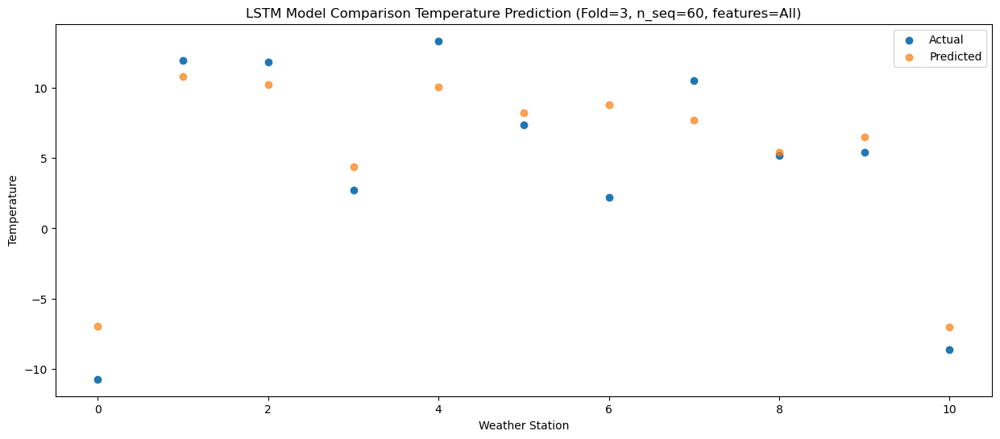

Predictions for (t+48):
    Weather_Station  Actual  Predicted
0                 0  -16.40 -13.708050
1                 1    6.14   4.052925
2                 2    4.92   3.478984
3                 3   -3.70  -2.355323
4                 4    6.39   3.346425
5                 5    0.88   1.462003
6                 6   -3.68   2.069981
7                 7    2.39   0.982600
8                 8    1.17  -1.319521
9                 9   -2.42  -0.219335
10               10  -16.93 -13.781944


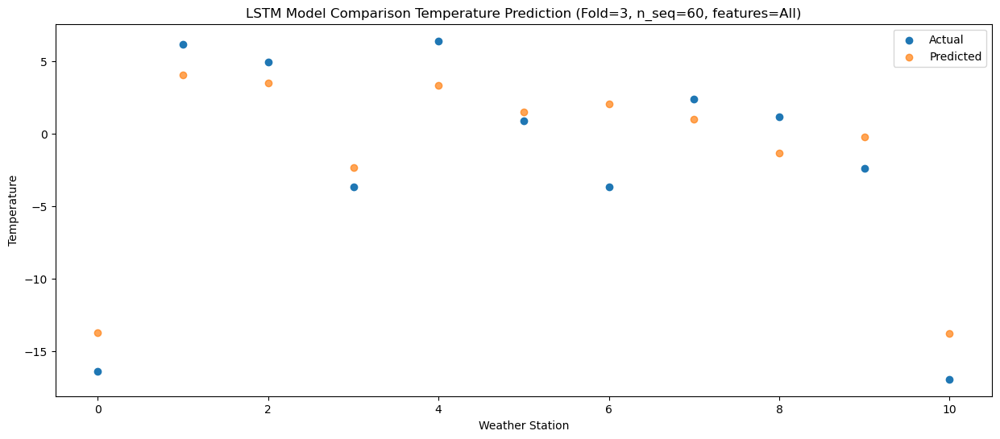

Predictions for (t+49):
    Weather_Station  Actual  Predicted
0                 0  -18.45 -15.749180
1                 1    2.79   2.019347
2                 2    3.08   1.431736
3                 3   -5.53  -4.397085
4                 4    3.58   1.312227
5                 5   -1.58  -0.575238
6                 6   -7.31   0.025807
7                 7   -0.74  -1.067854
8                 8   -0.67  -3.364581
9                 9   -3.15  -2.258446
10               10  -17.68 -15.824333


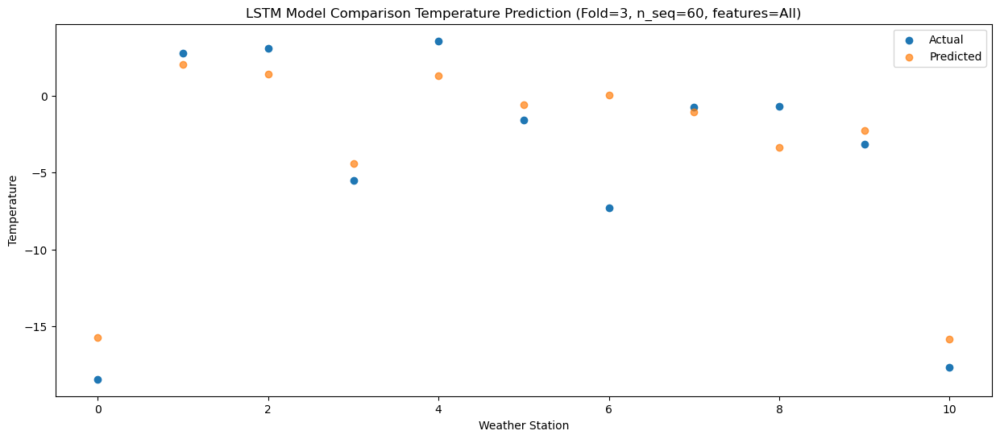

Predictions for (t+50):
    Weather_Station  Actual  Predicted
0                 0  -20.76 -20.532515
1                 1   -3.82  -2.765086
2                 2    2.87  -3.351270
3                 3  -10.69  -9.180661
4                 4   -2.92  -3.478265
5                 5   -7.74  -5.369029
6                 6   -9.45  -4.759072
7                 7   -2.46  -5.856307
8                 8   -0.36  -8.142781
9                 9   -7.14  -7.039061
10               10  -20.70 -20.604468


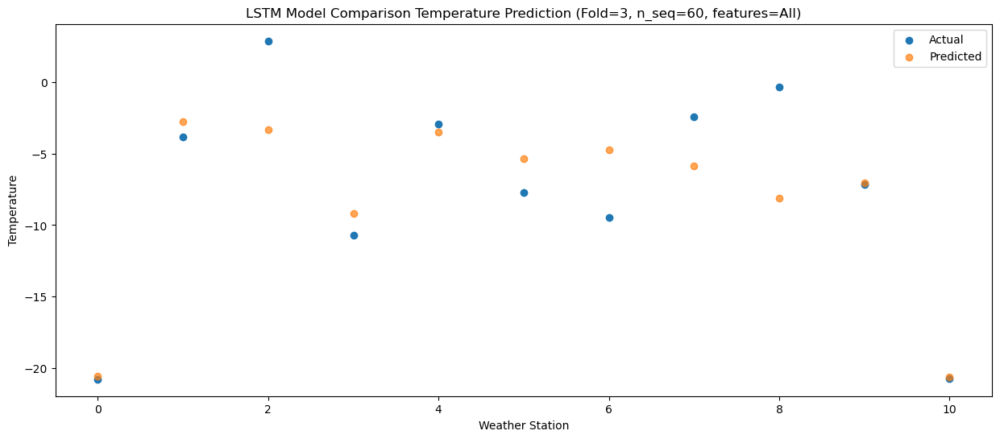

Predictions for (t+51):
    Weather_Station  Actual  Predicted
0                 0  -17.62 -14.743511
1                 1    5.83   3.021885
2                 2    4.36   2.434569
3                 3   -5.01  -3.390687
4                 4    4.89   2.313926
5                 5   -1.11   0.418269
6                 6   -7.29   1.030139
7                 7   -0.10  -0.062529
8                 8   -0.65  -2.346130
9                 9   -6.57  -1.240581
10               10  -18.66 -14.810406


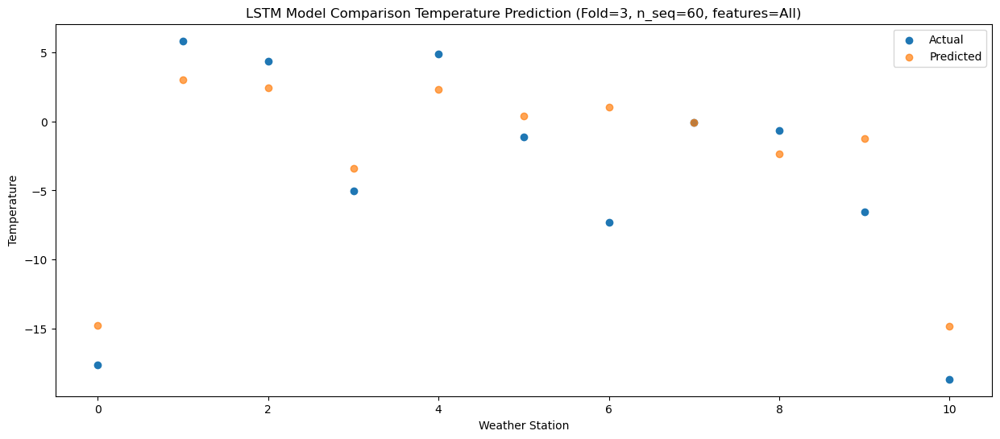

Predictions for (t+52):
    Weather_Station  Actual  Predicted
0                 0  -13.95 -12.106579
1                 1    8.31   5.661251
2                 2    6.39   5.074494
3                 3   -1.36  -0.753563
4                 4    9.00   4.955949
5                 5    2.96   3.063688
6                 6   -5.55   3.672294
7                 7    3.26   2.578622
8                 8    0.28   0.290865
9                 9   -1.87   1.399457
10               10  -14.00 -12.172258


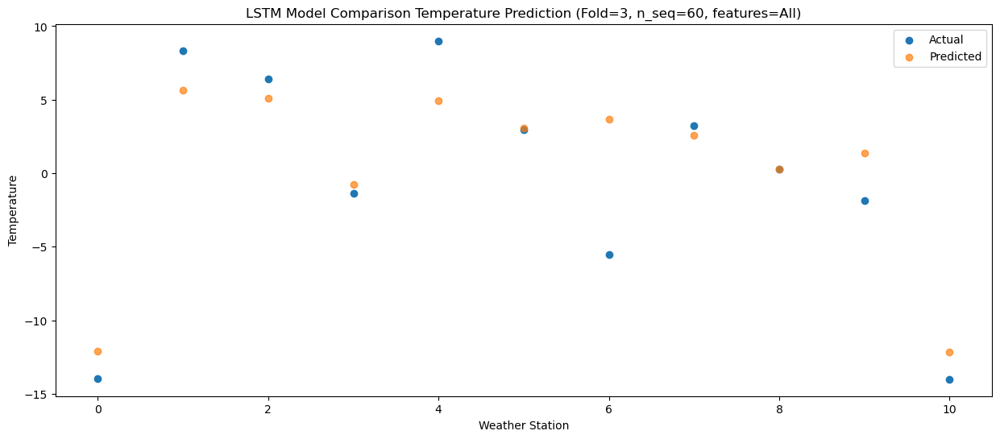

Predictions for (t+53):
    Weather_Station  Actual  Predicted
0                 0   -9.93  -7.797369
1                 1   12.48   9.965593
2                 2    9.58   9.369635
3                 3    3.70   3.555330
4                 4   13.75   9.262954
5                 5    7.93   7.371010
6                 6   -0.57   7.974980
7                 7    8.76   6.882385
8                 8    2.51   4.590096
9                 9    1.00   5.709225
10               10   -9.42  -7.861019


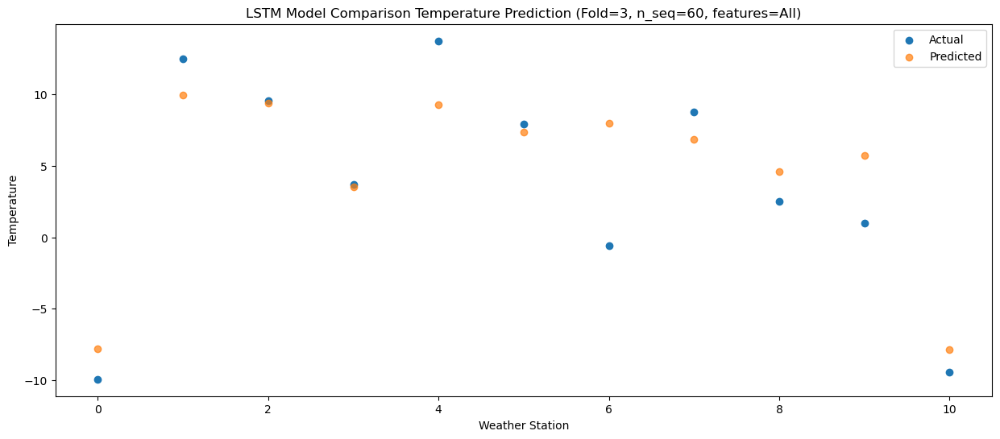

Predictions for (t+54):
    Weather_Station  Actual  Predicted
0                 0   -5.66  -2.276911
1                 1   17.25  15.489924
2                 2   14.97  14.883946
3                 3    7.89   9.080704
4                 4   19.91  14.783141
5                 5   13.45  12.896092
6                 6    2.54  13.490295
7                 7   14.39  12.391861
8                 8    5.48  10.100412
9                 9    6.55  11.228340
10               10   -3.75  -2.339567


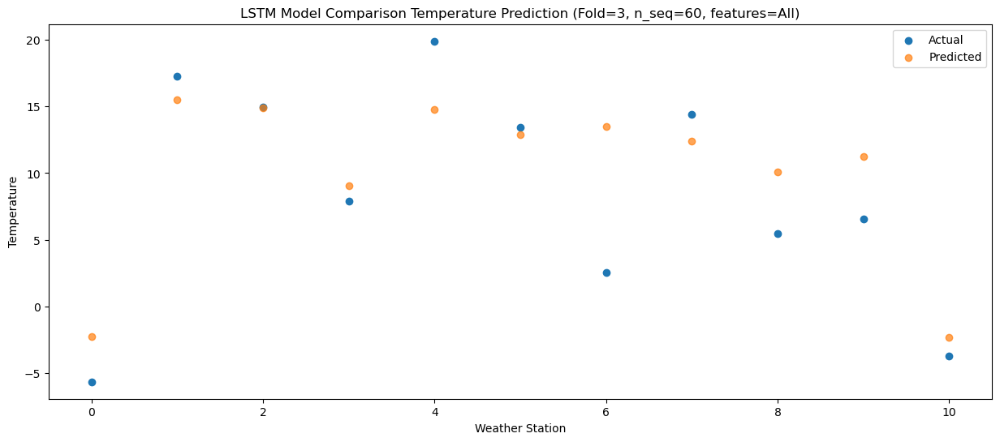

Predictions for (t+55):
    Weather_Station  Actual  Predicted
0                 0   -2.00   1.807476
1                 1   21.81  19.584253
2                 2   20.92  18.964954
3                 3   11.79  13.162409
4                 4   24.78  18.869334
5                 5   16.68  16.984033
6                 6   11.69  17.576199
7                 7   22.57  16.474765
8                 8    8.39  14.177386
9                 9   13.02  15.308049
10               10    1.62   1.740487


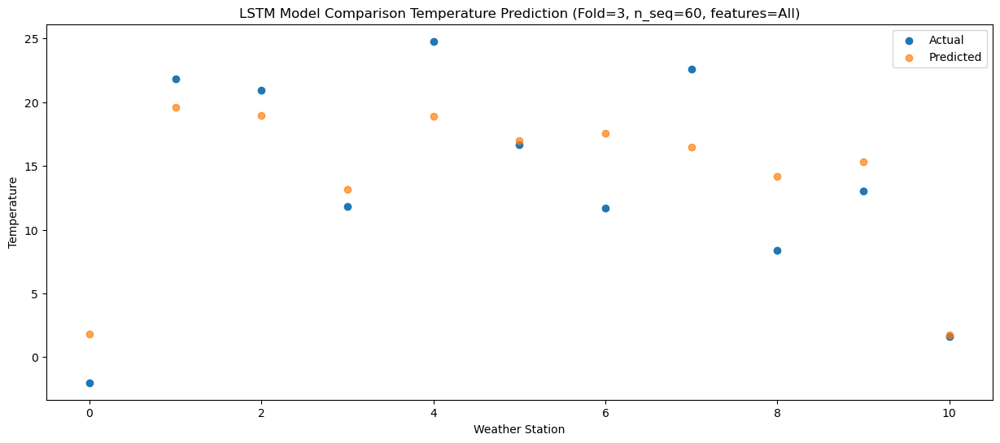

Predictions for (t+56):
    Weather_Station  Actual  Predicted
0                 0   -1.11   3.251093
1                 1   22.33  21.025920
2                 2   24.49  20.409527
3                 3   13.50  14.605746
4                 4   23.94  20.306690
5                 5   17.23  18.422654
6                 6   12.44  19.017776
7                 7   25.65  17.919624
8                 8    9.65  15.627786
9                 9   15.58  16.755194
10               10    4.28   3.189191


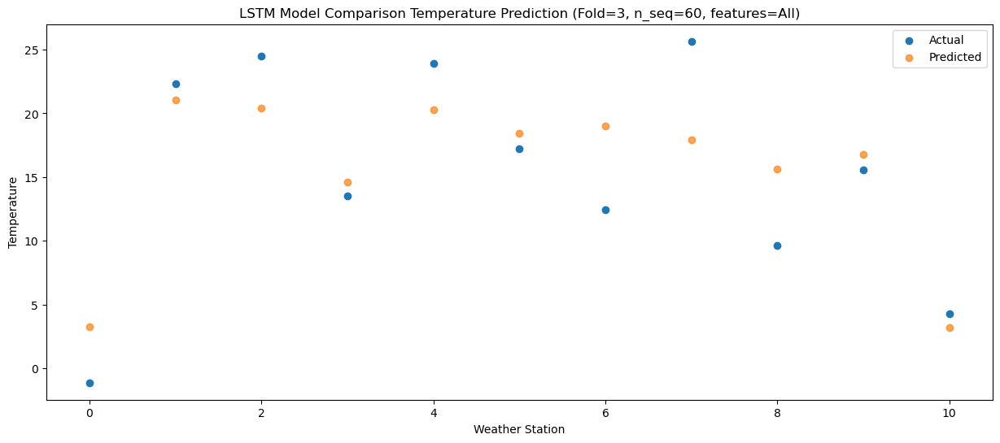

Predictions for (t+57):
    Weather_Station  Actual  Predicted
0                 0   -2.51   2.476581
1                 1   22.61  20.254111
2                 2   21.52  19.638490
3                 3   12.48  13.833104
4                 4   23.39  19.537614
5                 5   16.68  17.656312
6                 6   12.15  18.252523
7                 7   22.79  17.152028
8                 8    8.37  14.854513
9                 9   13.86  15.984732
10               10    1.14   2.419370


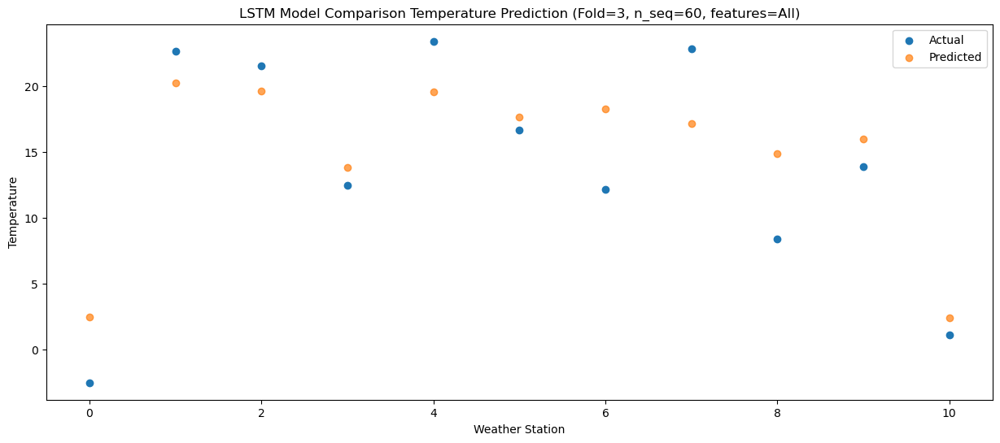

Predictions for (t+58):
    Weather_Station  Actual  Predicted
0                 0   -5.20  -0.319186
1                 1   18.57  17.459184
2                 2   18.49  16.846494
3                 3    9.51  11.035847
4                 4   20.13  16.735860
5                 5   13.99  14.851140
6                 6    8.53  15.455069
7                 7   18.84  14.356136
8                 8    6.93  12.065444
9                 9    9.85  13.187565
10               10   -2.45  -0.383231


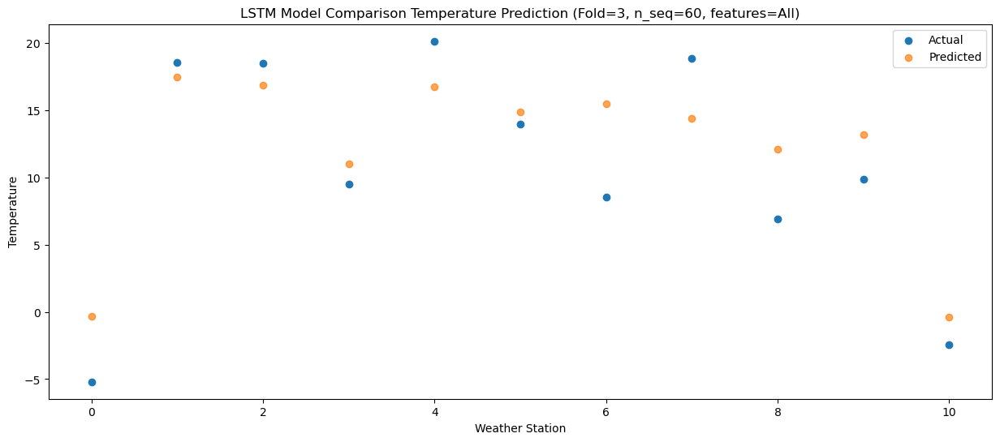

Predictions for (t+59):
    Weather_Station  Actual  Predicted
0                 0  -10.51  -5.802967
1                 1   15.18  11.970534
2                 2   13.46  11.368149
3                 3    3.01   5.552451
4                 4   14.50  11.254799
5                 5    8.11   9.362171
6                 6    4.30   9.967682
7                 7   12.95   8.876703
8                 8    6.47   6.587973
9                 9    5.32   7.705035
10               10   -7.69  -5.869477


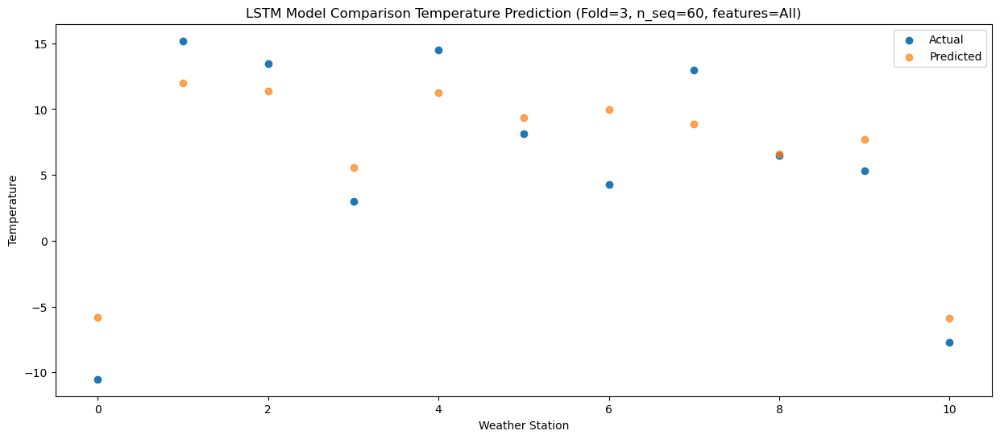

Model: "sequential_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_6 (LSTM)               (1, 1, 256)               2290688   
                                                                 
 dropout_6 (Dropout)         (1, 1, 256)               0         
                                                                 
 lstm_7 (LSTM)               (1, 256)                  525312    
                                                                 
 dropout_7 (Dropout)         (1, 256)                  0         
                                                                 
 dense_9 (Dense)             (1, 256)                  65792     
                                                                 
 dense_10 (Dense)            (1, 128)                  32896     
                                                                 
 dense_11 (Dense)            (1, 60)                  

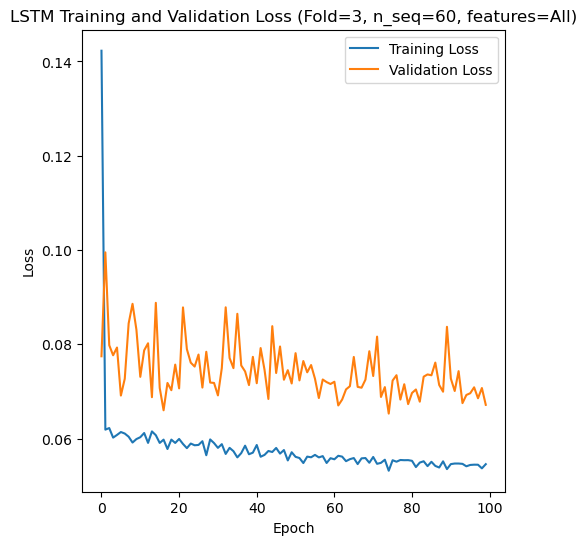

Epoch 1/100
84/84 [==============================] - 6s 22ms/step - loss: 0.1618 - accuracy: 0.2738 - mae: 0.1284 - rmse: 0.1618 - mape: inf - pearson: 0.6479 - val_loss: 0.0678 - val_accuracy: 0.6000 - val_mae: 0.0538 - val_rmse: 0.0678 - val_mape: 12.6678 - val_pearson: 0.8365
Epoch 2/100
84/84 [==============================] - 1s 9ms/step - loss: 0.0618 - accuracy: 0.4167 - mae: 0.0486 - rmse: 0.0618 - mape: inf - pearson: 0.8221 - val_loss: 0.0741 - val_accuracy: 0.1000 - val_mae: 0.0573 - val_rmse: 0.0741 - val_mape: 13.6432 - val_pearson: 0.8108
Epoch 3/100
84/84 [==============================] - 1s 10ms/step - loss: 0.0619 - accuracy: 0.4048 - mae: 0.0486 - rmse: 0.0619 - mape: inf - pearson: 0.8229 - val_loss: 0.0622 - val_accuracy: 0.6000 - val_mae: 0.0497 - val_rmse: 0.0622 - val_mape: 11.7546 - val_pearson: 0.8646
Epoch 4/100
84/84 [==============================] - 1s 9ms/step - loss: 0.0606 - accuracy: 0.3810 - mae: 0.0477 - rmse: 0.0606 - mape: inf - pearson: 0.8310 - v

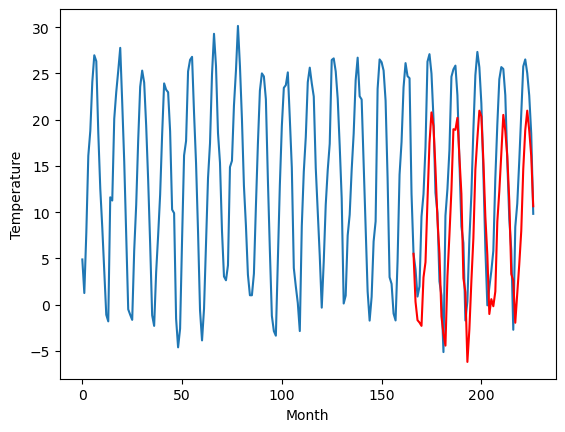

Weather Station 2:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
0.37		-1.37		-1.74
0.19		-3.36		-3.55
-1.27		-3.61		-2.34
0.28		-3.96		-4.24
4.35		1.28		-3.07
6.03		2.91		-3.12
7.43		9.59		2.16
9.19		15.78		6.59
9.51		19.09		9.58
9.36		17.62		8.26
8.78		13.07		4.29
7.28		7.51		0.23
3.89		3.86		-0.03
-3.86		-2.97		0.89
-3.16		-4.81		-1.65
0.27		-6.09		-6.36
1.87		1.38		-0.49
3.31		5.87		2.56
7.35		10.71		3.36
8.98		17.28		8.30
9.35		17.22		7.87
9.63		18.51		8.88
8.34		14.27		5.93
6.50		10.29		3.79
-0.66		1.20		1.86
1.14		-0.30		-1.44
-3.62		-7.84		-4.22
-0.19		-4.30		-4.11
2.63		0.88		-1.75
4.97		5.50		0.53
7.79		12.94		5.15
9.51		16.31		6.80
9.88		19.29		9.41
9.83		18.65		8.82
8.39		13.94		5.55
4.56		7.84		3.28
3.10		3.65		0.55
-1.75		-2.72		-0.97
-1.90		-1.13		0.77
1.40		-1.90		-3.30
3.12		-0.32		-3.44
5.84		7.24		1.40
6.62		10.54		3.92
8.83		14.57		5.74
10.44		18.77		8.33
10.95		17.03		6.08
8.85		14.28		5.43
5.20		9.44		4.24
1.49		1.58		0.09
-0.63		0.85

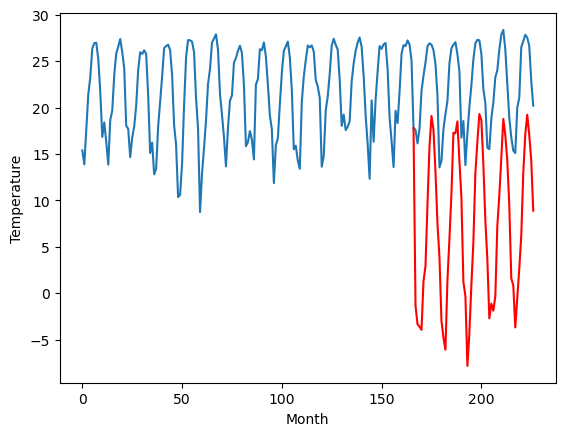

Weather Station 3:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-4.37		-4.75		-0.38
-4.31		-6.74		-2.43
-4.50		-7.00		-2.50
-4.24		-7.35		-3.11
3.56		-2.11		-5.67
2.61		-0.48		-3.09
6.49		6.21		-0.28
10.58		12.40		1.82
12.15		15.69		3.54
11.32		14.22		2.90
9.22		9.67		0.45
3.88		4.11		0.23
-0.12		0.46		0.58
-6.37		-6.36		0.01
-6.34		-8.21		-1.87
-8.26		-9.49		-1.23
1.07		-2.03		-3.10
2.14		2.47		0.33
6.61		7.30		0.69
10.87		13.87		3.00
11.53		13.80		2.27
12.18		15.10		2.92
9.06		10.86		1.80
5.67		6.89		1.22
-3.00		-2.21		0.79
0.51		-3.71		-4.22
-7.77		-11.26		-3.49
-5.41		-7.71		-2.30
-0.67		-2.54		-1.87
3.54		2.08		-1.46
9.34		9.52		0.18
12.63		12.88		0.25
12.83		15.87		3.04
11.29		15.23		3.94
9.22		10.52		1.30
3.09		4.42		1.33
-1.50		0.24		1.74
-3.93		-6.13		-2.20
-3.52		-4.53		-1.01
-1.58		-5.30		-3.72
0.57		-3.73		-4.30
2.32		3.82		1.50
7.18		7.12		-0.06
10.77		11.16		0.39
12.55		15.35		2.80
14.63		13.61		-1.02
10.88		10.84		-0.04
4.77		6.01		1.24
-2.

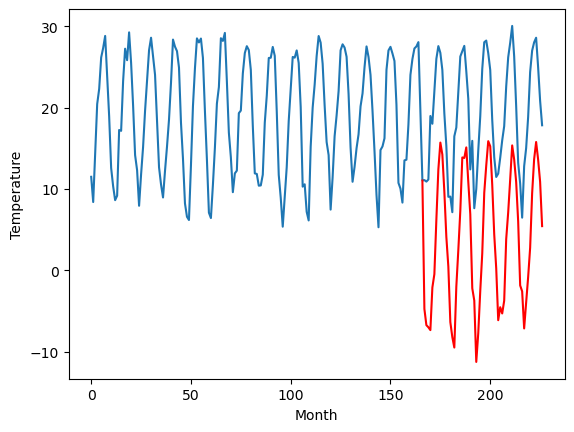

Weather Station 4:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-3.64		-5.38		-1.74
-5.29		-7.38		-2.09
-5.05		-7.65		-2.60
-5.38		-8.00		-2.62
2.08		-2.76		-4.84
2.74		-1.13		-3.87
7.87		5.55		-2.32
12.83		11.74		-1.09
14.69		15.04		0.35
14.44		13.57		-0.87
8.66		9.01		0.35
2.93		3.45		0.52
0.32		-0.20		-0.52
-5.96		-7.02		-1.06
-6.88		-8.87		-1.99
-10.34		-10.16		0.18
0.62		-2.69		-3.31
2.31		1.80		-0.51
6.47		6.63		0.16
12.15		13.20		1.05
13.74		13.14		-0.60
14.11		14.43		0.32
11.32		10.20		-1.12
6.67		6.22		-0.45
-1.33		-2.88		-1.55
0.67		-4.39		-5.06
-7.80		-11.93		-4.13
-7.54		-8.39		-0.85
-1.36		-3.22		-1.86
4.69		1.41		-3.28
9.40		8.85		-0.55
13.95		12.22		-1.73
17.25		15.20		-2.05
14.52		14.57		0.05
11.09		9.85		-1.24
4.22		3.76		-0.46
-2.83		-0.42		2.41
-5.52		-6.80		-1.28
-4.53		-5.20		-0.67
-4.47		-5.97		-1.50
0.06		-4.38		-4.44
2.66		3.17		0.51
8.34		6.47		-1.87
12.53		10.50		-2.03
15.08		14.70		-0.38
17.63		12.96		-4.67
12.93		10.18		-2.75
4

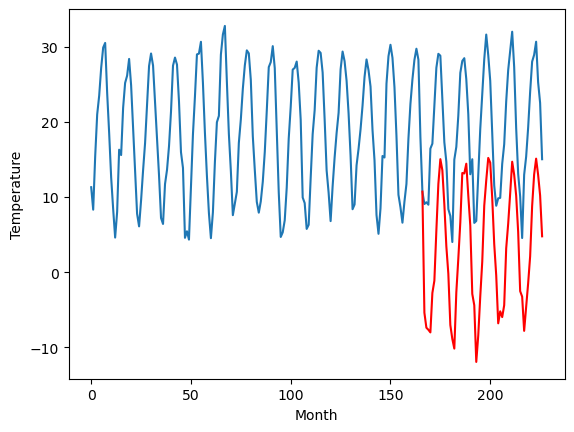

Weather Station 5:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-2.77		-4.12		-1.35
-4.55		-6.11		-1.56
-3.93		-6.39		-2.46
-4.31		-6.74		-2.43
3.57		-1.49		-5.06
4.26		0.14		-4.12
9.91		6.82		-3.09
14.62		13.01		-1.61
17.06		16.31		-0.75
16.38		14.84		-1.54
10.08		10.27		0.19
4.33		4.72		0.39
1.57		1.06		-0.51
-5.00		-5.75		-0.75
-5.60		-7.60		-2.00
-9.49		-8.89		0.60
1.43		-1.42		-2.85
3.61		3.07		-0.54
7.14		7.90		0.76
13.99		14.47		0.48
15.48		14.41		-1.07
15.85		15.71		-0.14
12.42		11.47		-0.95
7.55		7.49		-0.06
-0.29		-1.61		-1.32
1.45		-3.12		-4.57
-7.45		-10.65		-3.20
-6.83		-7.11		-0.28
0.09		-1.94		-2.03
6.78		2.68		-4.10
11.61		10.13		-1.48
16.28		13.49		-2.79
19.70		16.48		-3.22
16.86		15.85		-1.01
12.77		11.13		-1.64
5.62		5.04		-0.58
-1.47		0.86		2.33
-4.44		-5.51		-1.07
-3.67		-3.91		-0.24
-3.44		-4.68		-1.24
1.41		-3.09		-4.50
4.06		4.46		0.40
10.22		7.76		-2.46
15.33		11.79		-3.54
18.41		15.99		-2.42
20.28		14.25		-6.03
15.19		11.47		-3.7

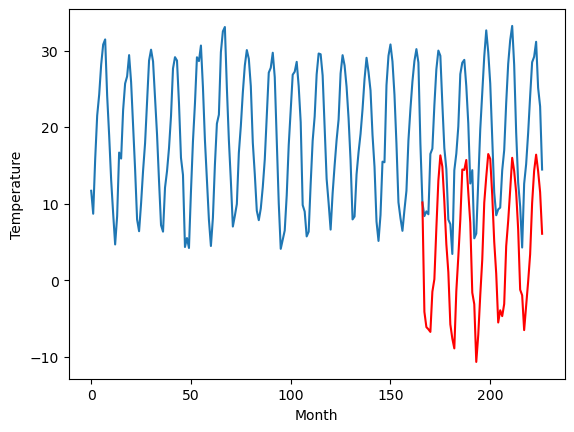

Weather Station 6:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
8.81		6.37		-2.44
7.17		4.36		-2.81
6.44		4.09		-2.35
5.68		3.74		-1.94
13.24		8.99		-4.25
16.21		10.63		-5.58
22.78		17.31		-5.47
26.11		23.50		-2.61
28.94		26.80		-2.14
28.32		25.32		-3.00
20.59		20.76		0.17
16.63		15.20		-1.43
12.75		11.54		-1.21
5.77		4.73		-1.04
4.67		2.87		-1.80
3.10		1.60		-1.50
12.35		9.06		-3.29
14.58		13.55		-1.03
20.07		18.38		-1.69
25.03		24.95		-0.08
24.77		24.89		0.12
25.09		26.18		1.09
24.40		21.96		-2.44
18.70		17.97		-0.73
11.76		8.87		-2.89
12.17		7.37		-4.80
4.80		-0.16		-4.96
4.60		3.39		-1.21
11.92		8.55		-3.37
19.43		13.18		-6.25
25.12		20.62		-4.50
27.49		23.99		-3.50
29.39		26.98		-2.41
26.09		26.34		0.25
23.19		21.62		-1.57
16.38		15.53		-0.85
8.53		11.35		2.82
6.93		4.98		-1.95
7.30		6.57		-0.73
7.47		5.81		-1.66
12.54		7.40		-5.14
16.76		14.96		-1.80
21.68		18.26		-3.42
28.16		22.29		-5.87
29.62		26.48		-3.14
29.71		24.75		-4.96
26.23		21.97		-4.26


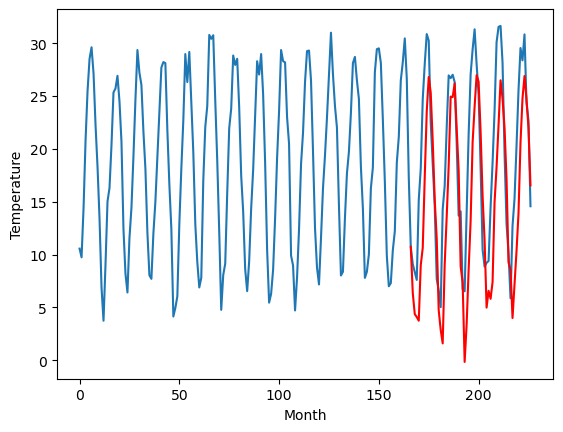

Weather Station 7:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
1.79		2.48		0.69
1.44		0.49		-0.95
1.27		0.21		-1.06
1.74		-0.14		-1.88
7.35		5.11		-2.24
8.62		6.74		-1.88
11.41		13.42		2.01
16.00		19.61		3.61
19.04		22.91		3.87
17.84		21.44		3.60
14.04		16.89		2.85
10.22		11.34		1.12
5.91		7.68		1.77
-1.34		0.87		2.21
-1.11		-0.98		0.13
-0.44		-2.26		-1.82
5.96		5.21		-0.75
8.69		9.70		1.01
12.14		14.52		2.38
16.16		21.09		4.93
17.90		21.03		3.13
18.03		22.33		4.30
14.06		18.09		4.03
10.26		14.12		3.86
2.10		5.02		2.92
4.01		3.52		-0.49
-2.05		-4.02		-1.97
2.23		-0.47		-2.70
5.79		4.70		-1.09
8.45		9.32		0.87
14.43		16.76		2.33
17.64		20.13		2.49
18.91		23.11		4.20
17.39		22.47		5.08
14.30		17.75		3.45
7.43		11.66		4.23
4.73		7.48		2.75
-1.22		1.11		2.33
1.80		2.70		0.90
5.22		1.93		-3.29
5.70		3.51		-2.19
8.81		11.06		2.25
11.43		14.36		2.93
15.07		18.38		3.31
18.94		22.58		3.64
18.38		20.84		2.46
14.54		18.06		3.52
9.10		13.23		4.13
3.37		5.36		1.99
1.

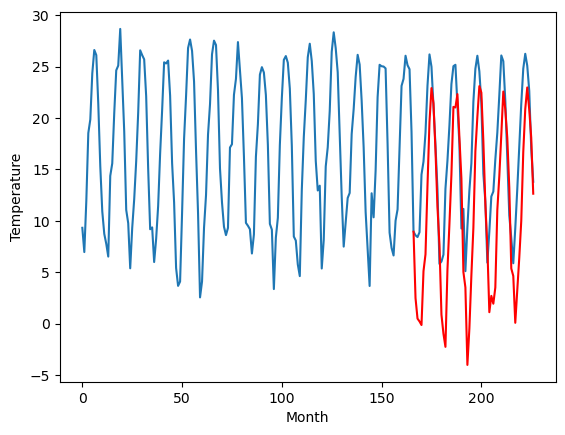

Weather Station 8:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
4.00		2.30		-1.70
3.19		0.31		-2.88
1.54		0.03		-1.51
2.11		-0.32		-2.43
9.04		4.92		-4.12
10.62		6.56		-4.06
14.72		13.24		-1.48
21.07		19.43		-1.64
23.61		22.73		-0.88
21.62		21.26		-0.36
18.04		16.70		-1.34
11.11		11.15		0.04
8.56		7.50		-1.06
2.03		0.69		-1.34
0.36		-1.16		-1.52
-3.25		-2.44		0.81
9.02		5.03		-3.99
10.92		9.52		-1.40
14.96		14.35		-0.61
21.26		20.91		-0.35
22.55		20.85		-1.70
23.07		22.16		-0.91
20.03		17.92		-2.11
14.26		13.95		-0.31
6.32		4.84		-1.48
7.78		3.34		-4.44
-1.29		-4.20		-2.91
0.77		-0.66		-1.43
7.43		4.52		-2.91
11.29		9.14		-2.15
16.96		16.58		-0.38
22.28		19.95		-2.33
25.98		22.93		-3.05
22.46		22.30		-0.16
18.87		17.58		-1.29
12.50		11.49		-1.01
5.95		7.32		1.37
1.10		0.95		-0.15
2.75		2.55		-0.20
4.89		1.78		-3.11
6.61		3.36		-3.25
12.23		10.91		-1.32
17.01		14.20		-2.81
21.09		18.23		-2.86
23.05		22.42		-0.63
22.86		20.68		-2.18
18.92		17.90		-1.02
13.0

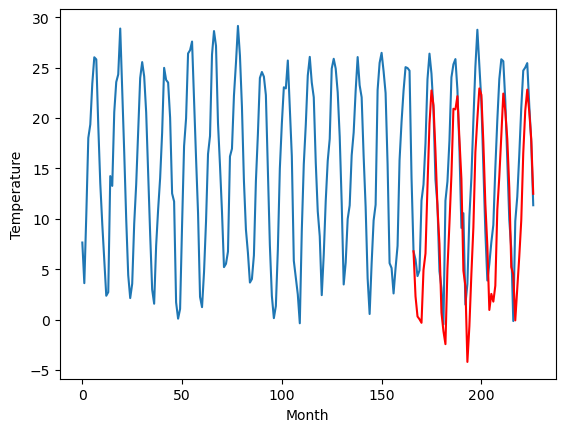

Weather Station 9:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
1.41		2.67		1.26
0.59		0.68		0.09
-0.34		0.41		0.75
-1.17		0.05		1.22
5.65		5.29		-0.36
8.64		6.93		-1.71
14.22		13.62		-0.60
21.51		19.80		-1.71
23.55		23.10		-0.45
21.35		21.63		0.28
17.59		17.07		-0.52
10.75		11.52		0.77
6.91		7.87		0.96
-0.60		1.05		1.65
-2.18		-0.80		1.38
-5.54		-2.09		3.45
6.43		5.38		-1.05
10.08		9.87		-0.21
14.49		14.71		0.22
21.73		21.27		-0.46
22.30		21.21		-1.09
23.16		22.51		-0.65
19.67		18.27		-1.40
14.32		14.29		-0.03
3.46		5.18		1.72
3.78		3.68		-0.10
-5.06		-3.87		1.19
-2.04		-0.32		1.72
5.43		4.86		-0.57
9.21		9.48		0.27
17.71		16.92		-0.79
22.19		20.28		-1.91
24.13		23.27		-0.86
21.90		22.63		0.73
17.99		17.91		-0.08
10.50		11.83		1.33
4.71		7.65		2.94
-1.07		1.29		2.36
0.89		2.89		2.00
2.48		2.11		-0.37
3.75		3.69		-0.06
10.25		11.24		0.99
15.96		14.54		-1.42
19.84		18.57		-1.27
22.57		22.76		0.19
21.41		21.02		-0.39
18.32		18.24		-0.08
12.18		13.42		1.24
5

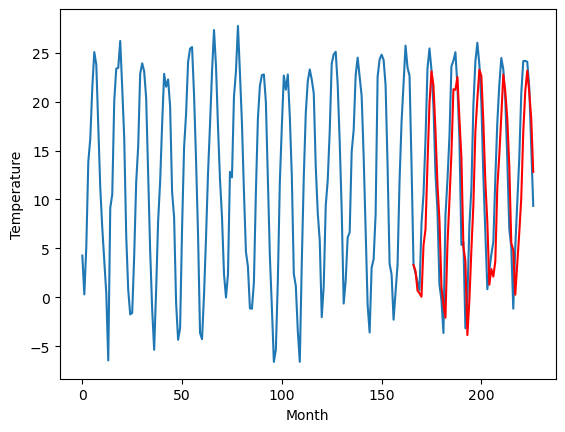

Weather Station 10:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
1.42		1.54		0.12
1.10		-0.45		-1.55
-1.34		-0.71		0.63
-1.59		-1.07		0.52
6.01		4.17		-1.84
9.12		5.81		-3.31
15.00		12.50		-2.50
22.73		18.69		-4.04
23.94		21.99		-1.95
21.34		20.52		-0.82
17.44		15.96		-1.48
10.10		10.41		0.31
7.46		6.76		-0.70
-0.42		-0.06		0.36
-2.45		-1.90		0.55
-6.89		-3.20		3.69
6.97		4.27		-2.70
10.68		8.77		-1.91
15.46		13.61		-1.85
22.85		20.18		-2.67
22.56		20.12		-2.44
22.84		21.43		-1.41
19.73		17.19		-2.54
14.27		13.21		-1.06
3.96		4.09		0.13
3.71		2.60		-1.11
-5.77		-4.95		0.82
-2.94		-1.40		1.54
5.27		3.78		-1.49
9.39		8.40		-0.99
17.92		15.84		-2.08
22.53		19.20		-3.33
23.35		22.19		-1.16
22.05		21.56		-0.49
17.91		16.85		-1.06
10.44		10.76		0.32
4.90		6.59		1.69
-1.83		0.23		2.06
0.41		1.83		1.42
1.60		1.05		-0.55
4.14		2.63		-1.51
11.47		10.19		-1.28
17.23		13.49		-3.74
21.54		17.52		-4.02
23.07		21.71		-1.36
21.81		19.98		-1.83
18.77		17.20		-1.57
12.36		

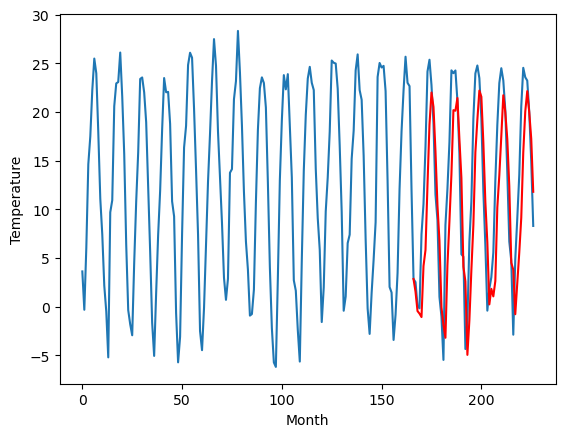

Weather Station 11:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-1.09		0.29		1.38
-1.87		-1.71		0.16
-3.07		-1.97		1.10
-3.88		-2.32		1.56
2.28		2.92		0.64
3.66		4.56		0.90
10.40		11.24		0.84
16.89		17.43		0.54
20.33		20.73		0.40
17.92		19.26		1.34
13.93		14.70		0.77
7.77		9.14		1.37
4.54		5.49		0.95
-3.02		-1.33		1.69
-4.94		-3.18		1.76
-7.18		-4.48		2.70
2.71		2.99		0.28
6.51		7.49		0.98
11.04		12.33		1.29
17.93		18.90		0.97
18.09		18.83		0.74
19.29		20.13		0.84
15.00		15.89		0.89
11.47		11.92		0.45
1.07		2.80		1.73
0.21		1.30		1.09
-8.62		-6.24		2.38
-5.06		-2.69		2.37
0.91		2.49		1.58
4.91		7.11		2.20
13.49		14.55		1.06
16.76		17.91		1.15
19.36		20.90		1.54
18.29		20.27		1.98
14.24		15.55		1.31
7.38		9.47		2.09
3.30		5.29		1.99
-3.41		-1.08		2.33
-1.78		0.52		2.30
-1.64		-0.25		1.39
-0.76		1.32		2.08
7.71		8.88		1.17
11.40		12.18		0.78
15.71		16.21		0.50
18.80		20.40		1.60
17.47		18.67		1.20
15.13		15.89		0.76
9.87		11.06		1.19
2.48		3.19		0.71
1.82	

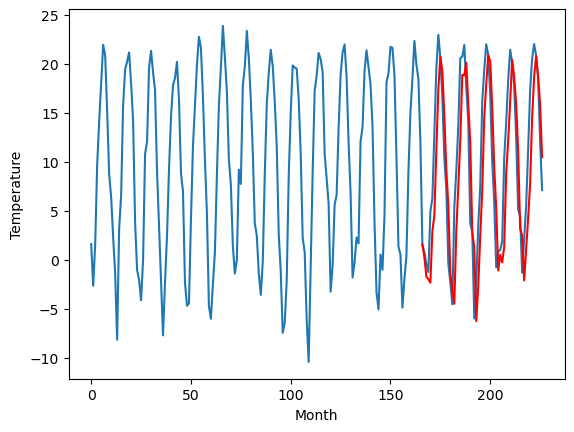

RangeIndex(start=1, stop=12, step=1)
[2.839999999999999, 0.3700000000000001, -4.370000000000001, -3.639999999999999, -2.7700000000000005, 8.81, 1.7899999999999991, 4.0, 1.4099999999999984, 1.42, -1.0899999999999999]
[0.32046539306640653, -1.3667777633666995, -4.747983207702637, -5.3845814514160155, -4.115226135253907, 6.370781784057618, 2.482459297180176, 2.300545272827149, 2.6715912246704097, 1.536263046264649, 0.29051525115966825]
Predictions for (t+0):
    Weather_Station  Actual  Predicted
0                 0    2.84   0.320465
1                 1    0.37  -1.366778
2                 2   -4.37  -4.747983
3                 3   -3.64  -5.384581
4                 4   -2.77  -4.115226
5                 5    8.81   6.370782
6                 6    1.79   2.482459
7                 7    4.00   2.300545
8                 8    1.41   2.671591
9                 9    1.42   1.536263
10               10   -1.09   0.290515


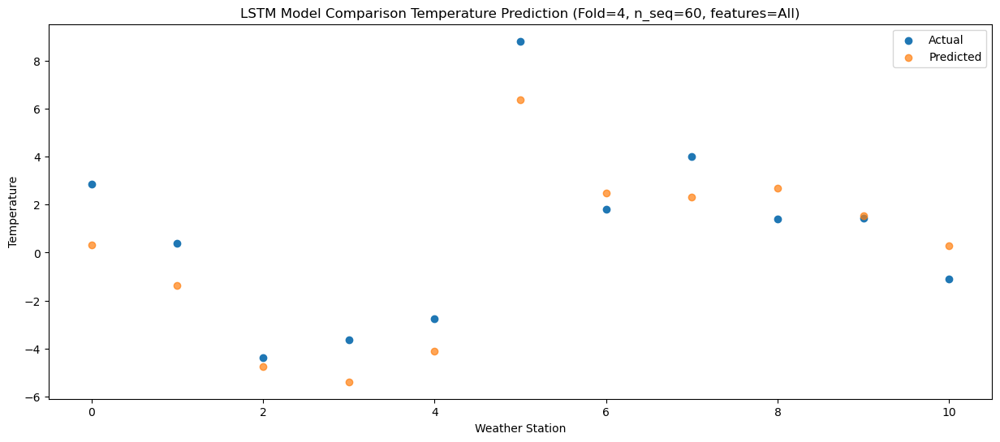

Predictions for (t+1):
    Weather_Station  Actual  Predicted
0                 0    1.18  -1.670645
1                 1    0.19  -3.357743
2                 2   -4.31  -6.738351
3                 3   -5.29  -7.379126
4                 4   -4.55  -6.110502
5                 5    7.17   4.364374
6                 6    1.44   0.486840
7                 7    3.19   0.305369
8                 8    0.59   0.677857
9                 9    1.10  -0.451626
10               10   -1.87  -1.707254


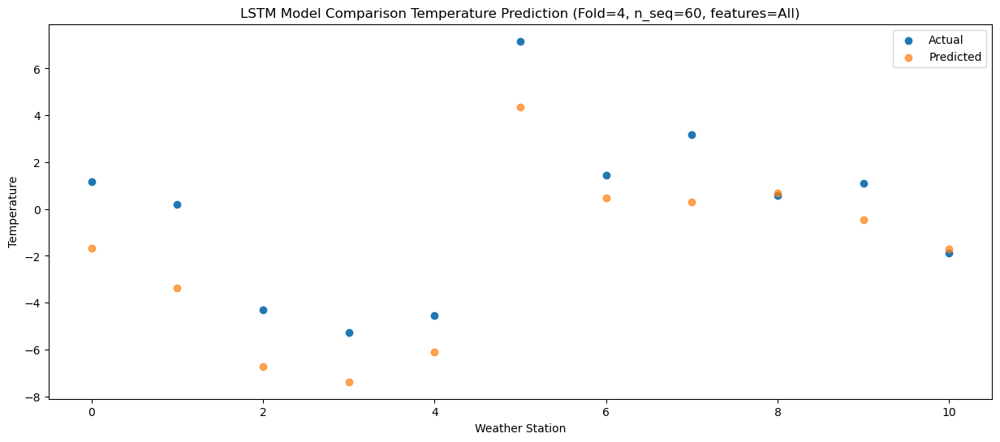

Predictions for (t+2):
    Weather_Station  Actual  Predicted
0                 0   -1.78  -1.930645
1                 1   -1.27  -3.609210
2                 2   -4.50  -7.000326
3                 3   -5.05  -7.651061
4                 4   -3.93  -6.385324
5                 5    6.44   4.086868
6                 6    1.27   0.211257
7                 7    1.54   0.029804
8                 8   -0.34   0.408255
9                 9   -1.34  -0.714121
10               10   -3.07  -1.972005


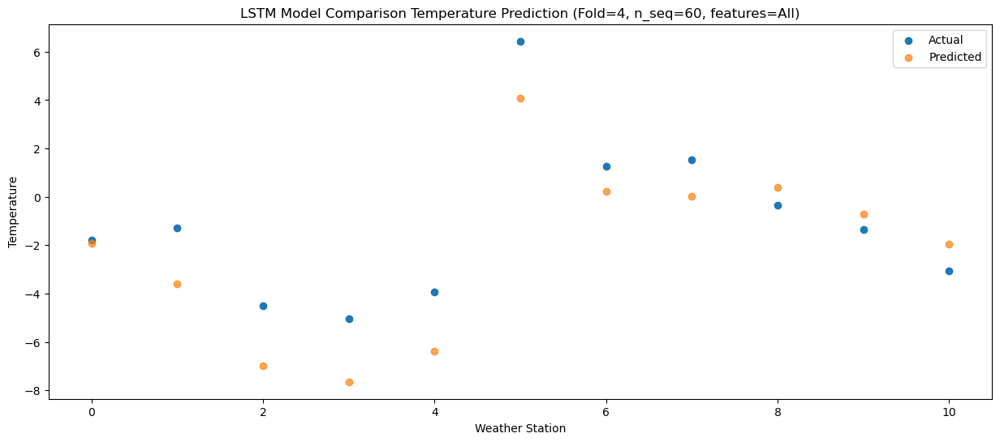

Predictions for (t+3):
    Weather_Station  Actual  Predicted
0                 0   -0.67  -2.287798
1                 1    0.28  -3.958009
2                 2   -4.24  -7.348815
3                 3   -5.38  -8.003452
4                 4   -4.31  -6.737019
5                 5    5.68   3.739594
6                 6    1.74  -0.138344
7                 7    2.11  -0.323540
8                 8   -1.17   0.053107
9                 9   -1.59  -1.068429
10               10   -3.88  -2.322199


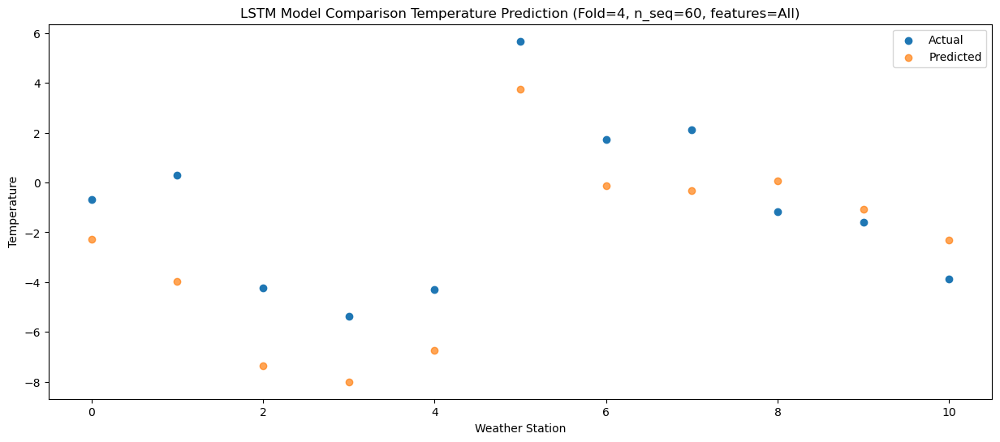

Predictions for (t+4):
    Weather_Station  Actual  Predicted
0                 0    6.86   2.952038
1                 1    4.35   1.276796
2                 2    3.56  -2.110515
3                 3    2.08  -2.761646
4                 4    3.57  -1.490605
5                 5   13.24   8.992834
6                 6    7.35   5.106648
7                 7    9.04   4.919240
8                 8    5.65   5.293230
9                 9    6.01   4.171252
10               10    2.28   2.917804


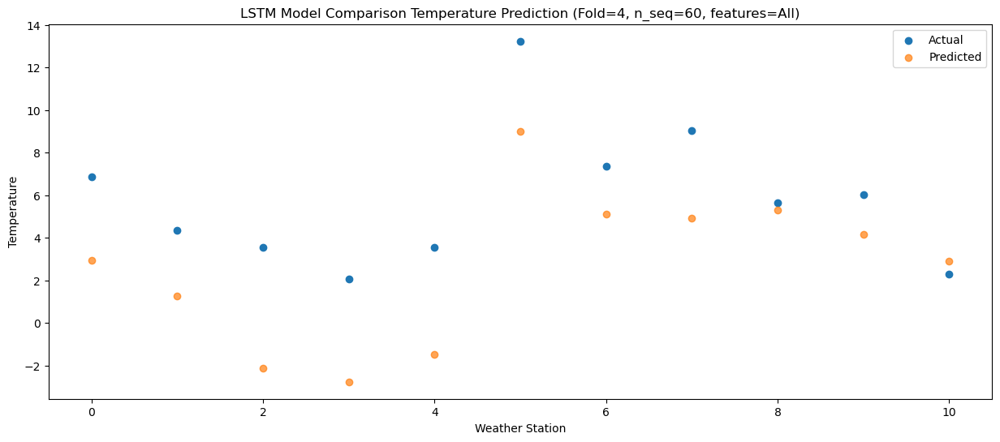

Predictions for (t+5):
    Weather_Station  Actual  Predicted
0                 0    9.29   4.594566
1                 1    6.03   2.910411
2                 2    2.61  -0.475728
3                 3    2.74  -1.129348
4                 4    4.26   0.141792
5                 5   16.21  10.627130
6                 6    8.62   6.740030
7                 7   10.62   6.555474
8                 8    8.64   6.929354
9                 9    9.12   5.811725
10               10    3.66   4.555867


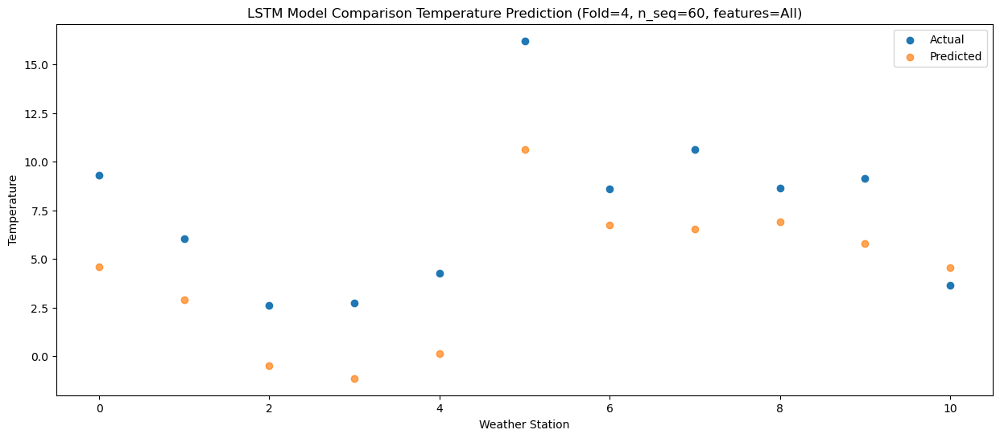

Predictions for (t+6):
    Weather_Station  Actual  Predicted
0                 0   14.36  11.280010
1                 1    7.43   9.590361
2                 2    6.49   6.208721
3                 3    7.87   5.552636
4                 4    9.91   6.822704
5                 5   22.78  17.311511
6                 6   11.41  13.424556
7                 7   14.72  13.242918
8                 8   14.22  13.615982
9                 9   15.00  12.501074
10               10   10.40  11.240802


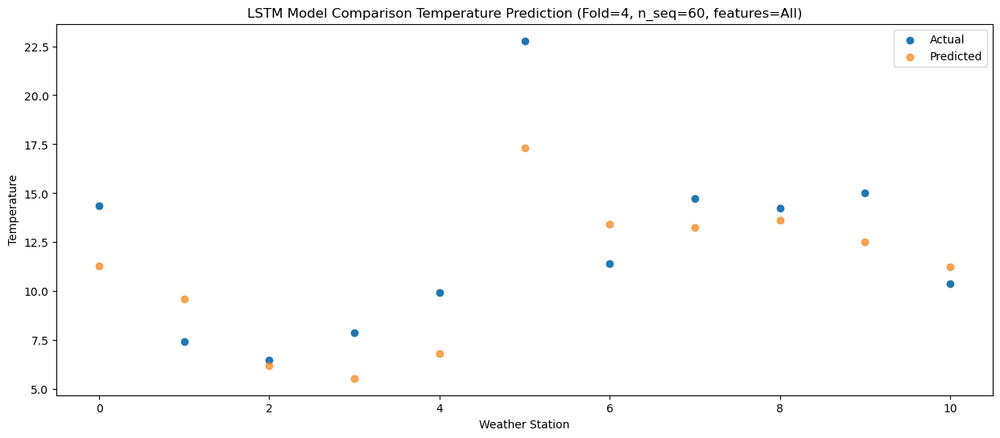

Predictions for (t+7):
    Weather_Station  Actual  Predicted
0                 0   23.61  17.475897
1                 1    9.19  15.784922
2                 2   10.58  12.395225
3                 3   12.83  11.737737
4                 4   14.62  13.005738
5                 5   26.11  23.497238
6                 6   16.00  19.609310
7                 7   21.07  19.427257
8                 8   21.51  19.801717
9                 9   22.73  18.690237
10               10   16.89  17.430424


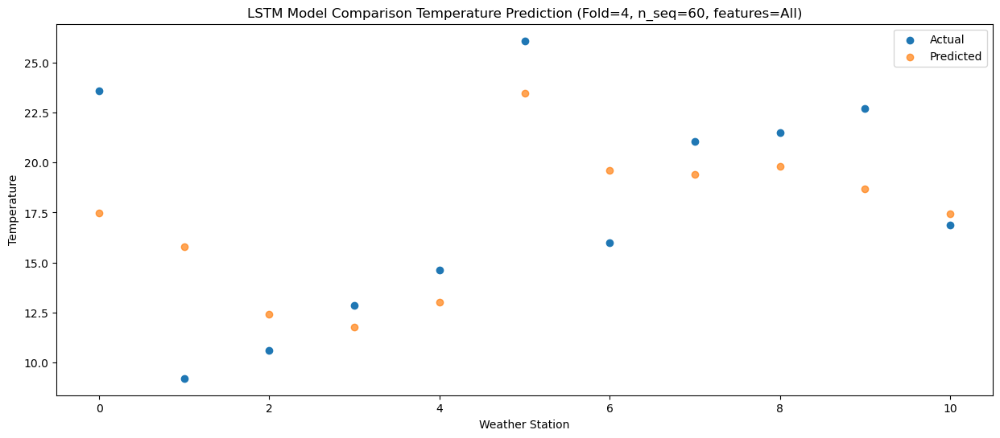

Predictions for (t+8):
    Weather_Station  Actual  Predicted
0                 0   24.42  20.782241
1                 1    9.51  19.090121
2                 2   12.15  15.694659
3                 3   14.69  15.039915
4                 4   17.06  16.310476
5                 5   28.94  26.798177
6                 6   19.04  22.913891
7                 7   23.61  22.729720
8                 8   23.55  23.101786
9                 9   23.94  21.992388
10               10   20.33  20.732836


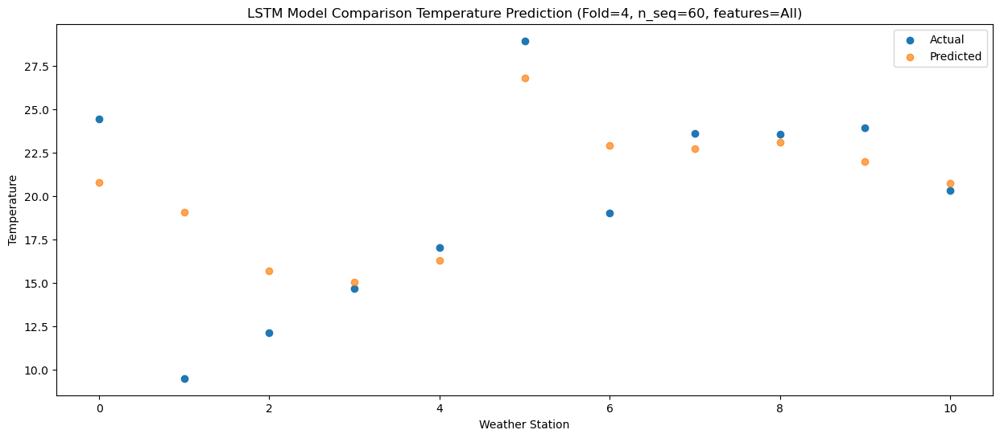

Predictions for (t+9):
    Weather_Station  Actual  Predicted
0                 0   22.32  19.311378
1                 1    9.36  17.620338
2                 2   11.32  14.220548
3                 3   14.44  13.567369
4                 4   16.38  14.837181
5                 5   28.32  25.317332
6                 6   17.84  21.437511
7                 7   21.62  21.257022
8                 8   21.35  21.628126
9                 9   21.34  20.520209
10               10   17.92  19.255642


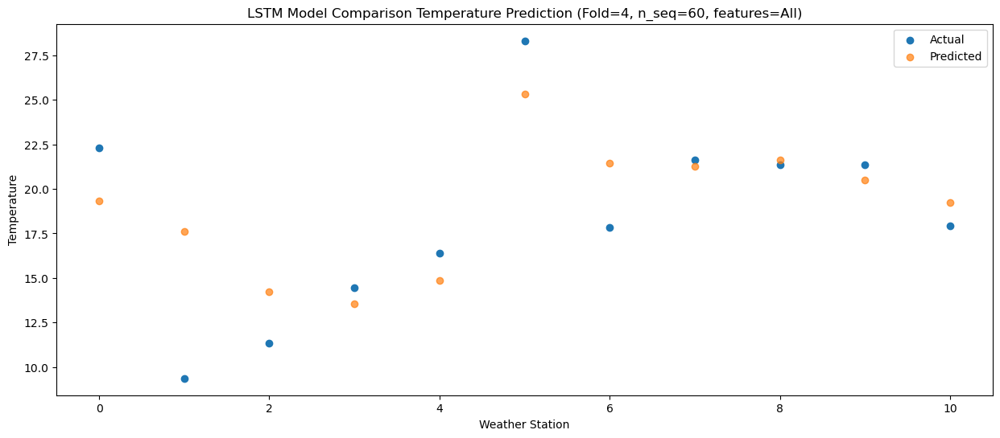

Predictions for (t+10):
    Weather_Station  Actual  Predicted
0                 0   17.48  14.749175
1                 1    8.78  13.071631
2                 2    9.22   9.668264
3                 3    8.66   9.006362
4                 4   10.08  10.272900
5                 5   20.59  20.756470
6                 6   14.04  16.886953
7                 7   18.04  16.704201
8                 8   17.59  17.071502
9                 9   17.44  15.962486
10               10   13.93  14.700683


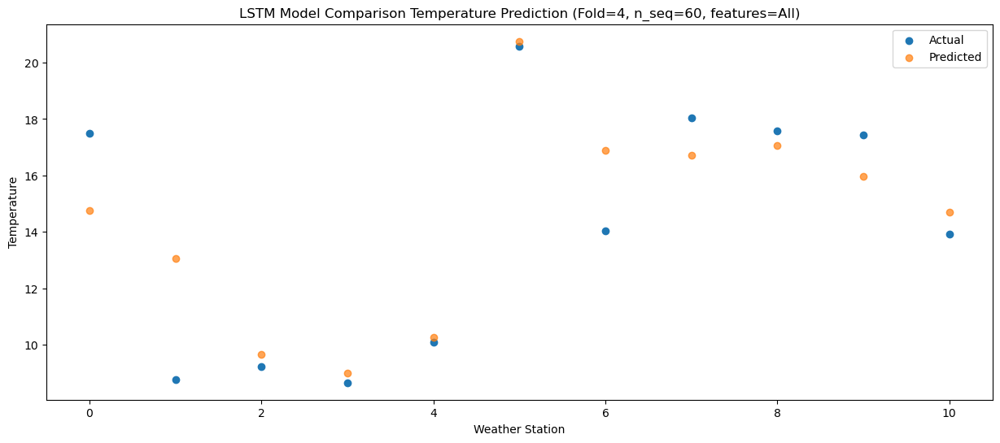

Predictions for (t+11):
    Weather_Station  Actual  Predicted
0                 0    9.43   9.195012
1                 1    7.28   7.512621
2                 2    3.88   4.113119
3                 3    2.93   3.451747
4                 4    4.33   4.716368
5                 5   16.63  15.200615
6                 6   10.22  11.336081
7                 7   11.11  11.149437
8                 8   10.75  11.517751
9                 9   10.10  10.408605
10               10    7.77   9.142225


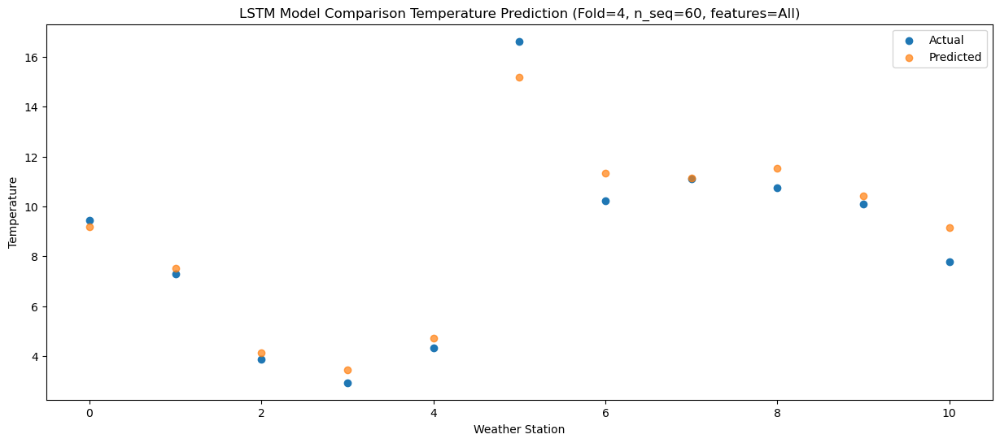

Predictions for (t+12):
    Weather_Station  Actual  Predicted
0                 0    7.24   5.540400
1                 1    3.89   3.859678
2                 2   -0.12   0.460948
3                 3    0.32  -0.202672
4                 4    1.57   1.062487
5                 5   12.75  11.544462
6                 6    5.91   7.683414
7                 7    8.56   7.502795
8                 8    6.91   7.868886
9                 9    7.46   6.763010
10               10    4.54   5.489430


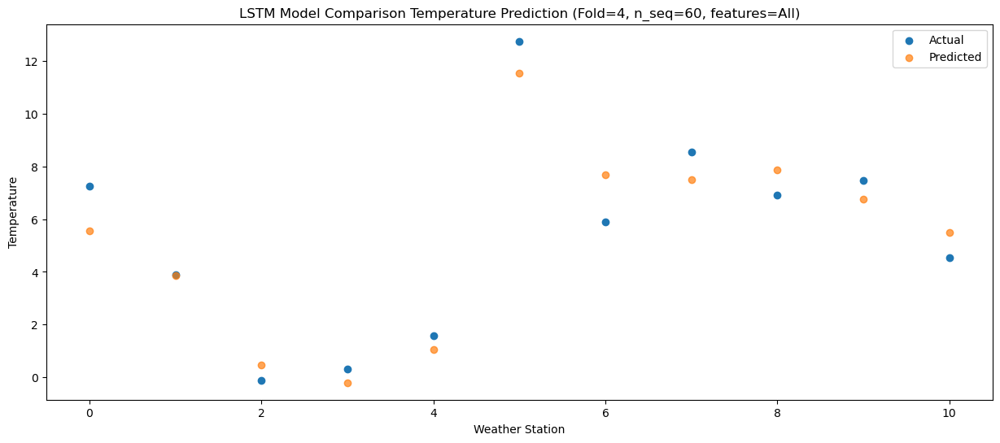

Predictions for (t+13):
    Weather_Station  Actual  Predicted
0                 0   -0.14  -1.276373
1                 1   -3.86  -2.969991
2                 2   -6.37  -6.363022
3                 3   -5.96  -7.020200
4                 4   -5.00  -5.749211
5                 5    5.77   4.730524
6                 6   -1.34   0.868073
7                 7    2.03   0.692514
8                 8   -0.60   1.050216
9                 9   -0.42  -0.055921
10               10   -3.02  -1.333023


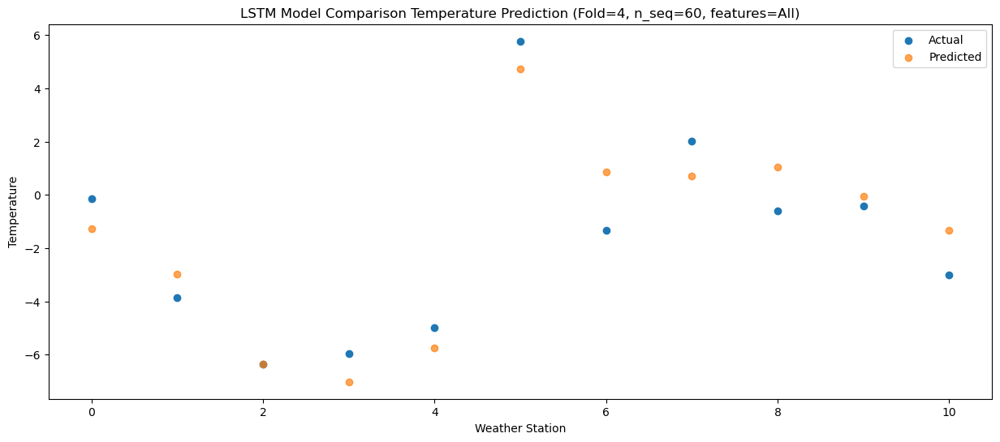

Predictions for (t+14):
    Weather_Station  Actual  Predicted
0                 0   -1.65  -3.125575
1                 1   -3.16  -4.810180
2                 2   -6.34  -8.208460
3                 3   -6.88  -8.869189
4                 4   -5.60  -7.602520
5                 5    4.67   2.874470
6                 6   -1.11  -0.981728
7                 7    0.36  -1.156914
8                 8   -2.18  -0.798540
9                 9   -2.45  -1.904598
10               10   -4.94  -3.182969


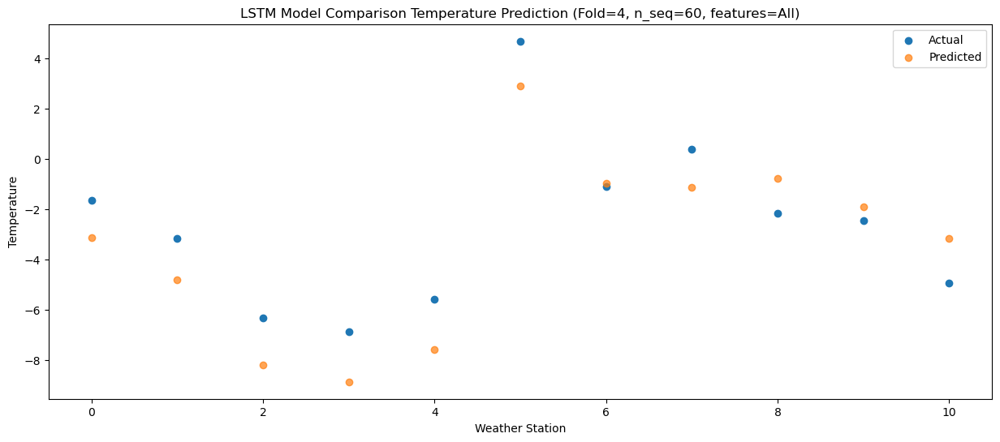

Predictions for (t+15):
    Weather_Station  Actual  Predicted
0                 0   -7.78  -4.421782
1                 1    0.27  -6.093349
2                 2   -8.26  -9.490648
3                 3  -10.34 -10.155121
4                 4   -9.49  -8.888532
5                 5    3.10   1.595446
6                 6   -0.44  -2.261815
7                 7   -3.25  -2.441300
8                 8   -5.54  -2.089860
9                 9   -6.89  -3.195727
10               10   -7.18  -4.478728


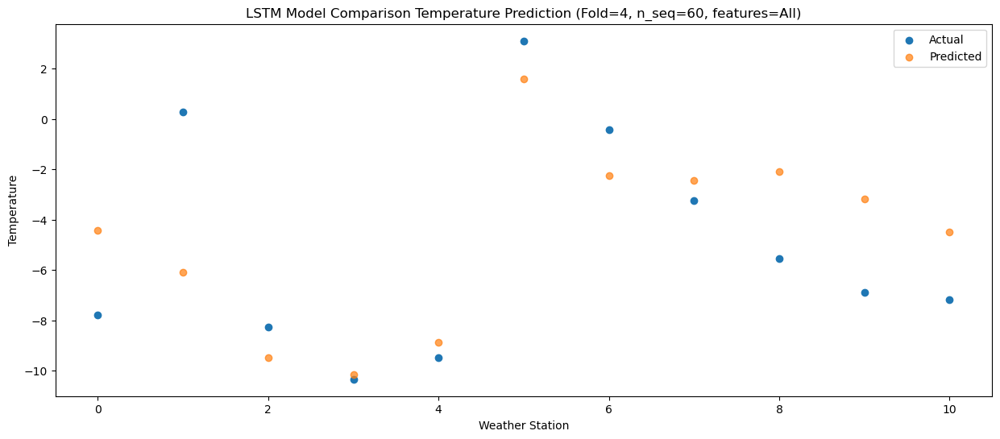

Predictions for (t+16):
    Weather_Station  Actual  Predicted
0                 0    6.95   3.057353
1                 1    1.87   1.379419
2                 2    1.07  -2.025288
3                 3    0.62  -2.686836
4                 4    1.43  -1.417888
5                 5   12.35   9.063712
6                 6    5.96   5.206971
7                 7    9.02   5.027758
8                 8    6.43   5.376083
9                 9    6.97   4.271092
10               10    2.71   2.985970


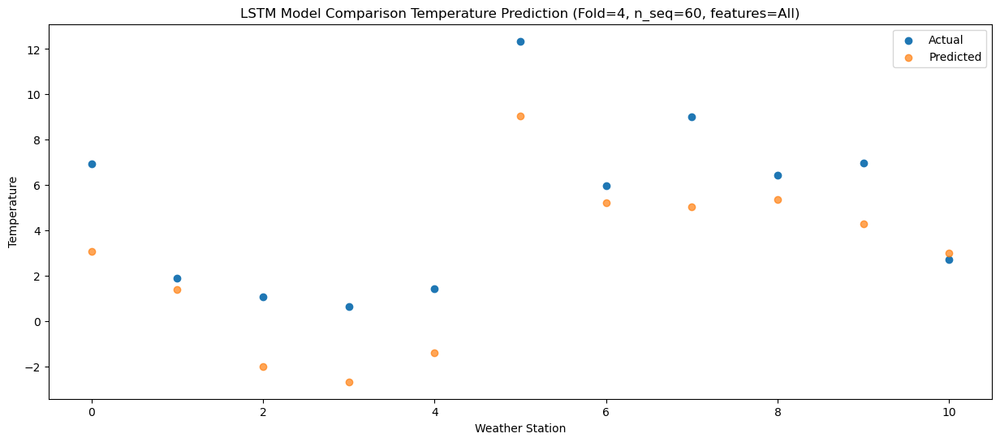

Predictions for (t+17):
    Weather_Station  Actual  Predicted
0                 0    9.86   7.551783
1                 1    3.31   5.873125
2                 2    2.14   2.468338
3                 3    2.31   1.802258
4                 4    3.61   3.071737
5                 5   14.58  13.552404
6                 6    8.69   9.700496
7                 7   10.92   9.518903
8                 8   10.08   9.872197
9                 9   10.68   8.771536
10               10    6.51   7.489866


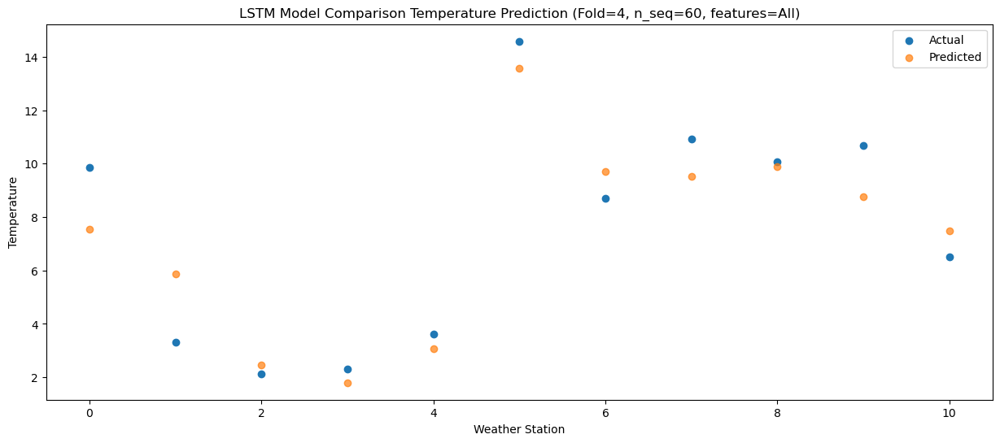

Predictions for (t+18):
    Weather_Station  Actual  Predicted
0                 0   14.07  12.399594
1                 1    7.35  10.710595
2                 2    6.61   7.299955
3                 3    6.47   6.634633
4                 4    7.14   7.901820
5                 5   20.07  18.383060
6                 6   12.14  14.523033
7                 7   14.96  14.350655
8                 8   14.49  14.705207
9                 9   15.46  13.610332
10               10   11.04  12.326924


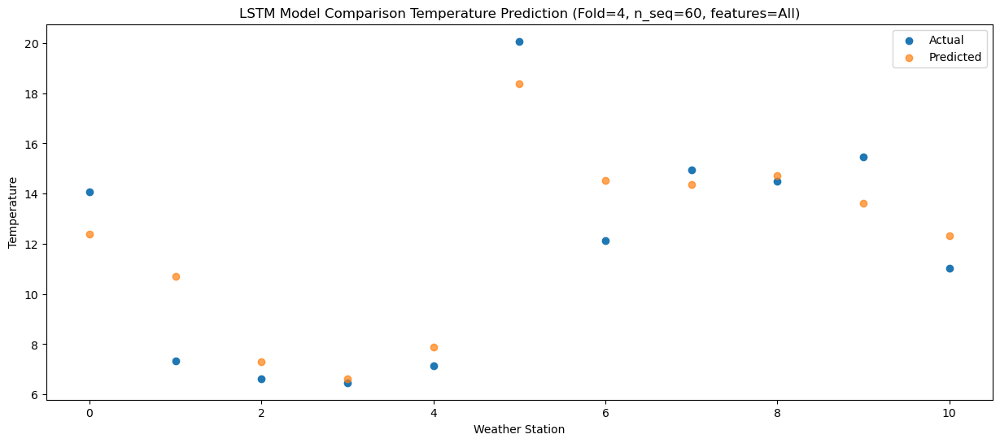

Predictions for (t+19):
    Weather_Station  Actual  Predicted
0                 0   21.98  18.970661
1                 1    8.98  17.284117
2                 2   10.87  13.871189
3                 3   12.15  13.201287
4                 4   13.99  14.468939
5                 5   25.03  24.949127
6                 6   16.16  21.088635
7                 7   21.26  20.914245
8                 8   21.73  21.273353
9                 9   22.85  20.184626
10               10   17.93  18.902292


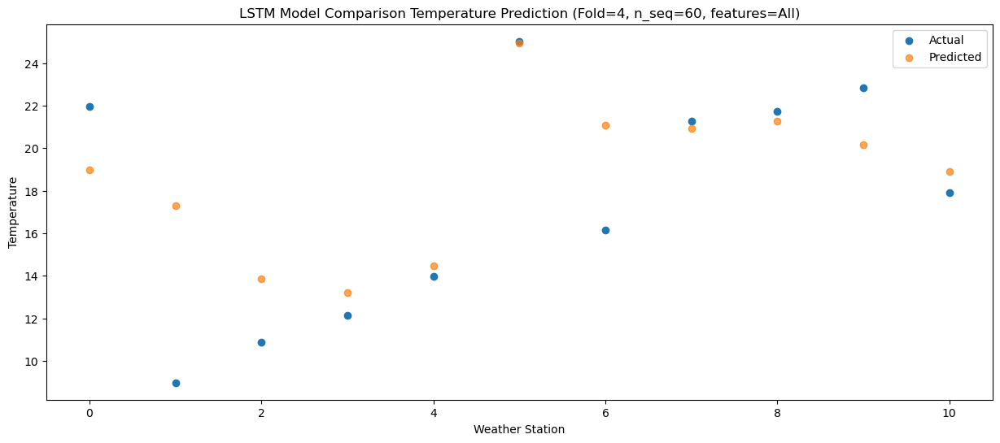

Predictions for (t+20):
    Weather_Station  Actual  Predicted
0                 0   22.78  18.898739
1                 1    9.35  17.217681
2                 2   11.53  13.804076
3                 3   13.74  13.135130
4                 4   15.48  14.406812
5                 5   24.77  24.887793
6                 6   17.90  21.027586
7                 7   22.55  20.849889
8                 8   22.30  21.207264
9                 9   22.56  20.123129
10               10   18.09  18.834783


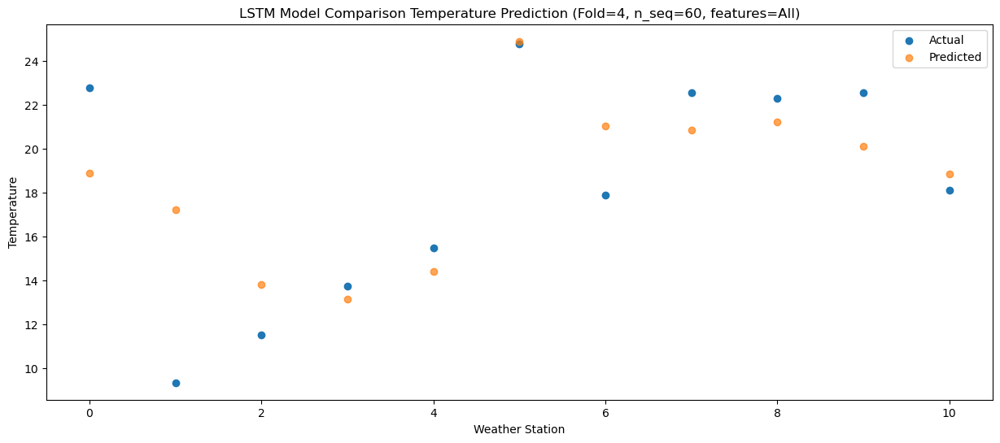

Predictions for (t+21):
    Weather_Station  Actual  Predicted
0                 0   23.18  20.198374
1                 1    9.63  18.506370
2                 2   12.18  15.102001
3                 3   14.11  14.434332
4                 4   15.85  15.706917
5                 5   25.09  26.184227
6                 6   18.03  22.329374
7                 7   23.07  22.159702
8                 8   23.16  22.509720
9                 9   22.84  21.428500
10               10   19.29  20.131823


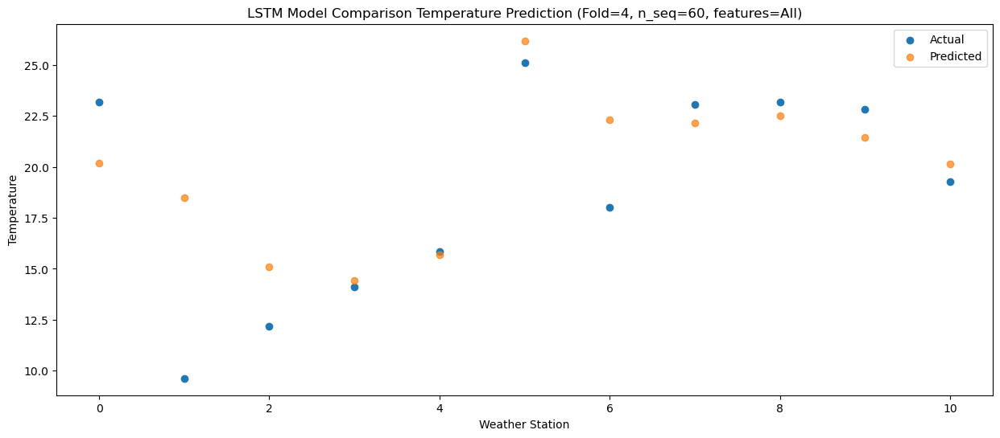

Predictions for (t+22):
    Weather_Station  Actual  Predicted
0                 0   19.99  15.958512
1                 1    8.34  14.270171
2                 2    9.06  10.862676
3                 3   11.32  10.195792
4                 4   12.42  11.469598
5                 5   24.40  21.955495
6                 6   14.06  18.092719
7                 7   20.03  17.920660
8                 8   19.67  18.265114
9                 9   19.73  17.188042
10               10   15.00  15.888729


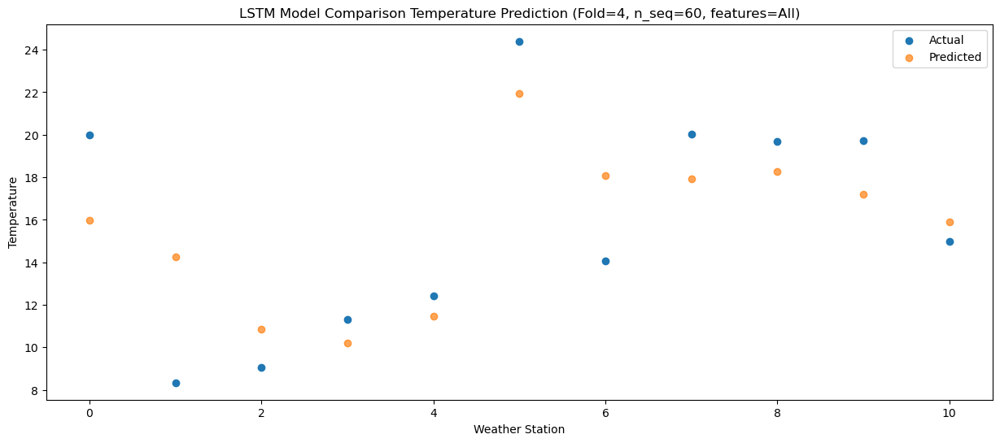

Predictions for (t+23):
    Weather_Station  Actual  Predicted
0                 0   12.86  11.971756
1                 1    6.50  10.294859
2                 2    5.67   6.890426
3                 3    6.67   6.219571
4                 4    7.55   7.493120
5                 5   18.70  17.973891
6                 6   10.26  14.121582
7                 7   14.26  13.948317
8                 8   14.32  14.294007
9                 9   14.27  13.214388
10               10   11.47  11.918958


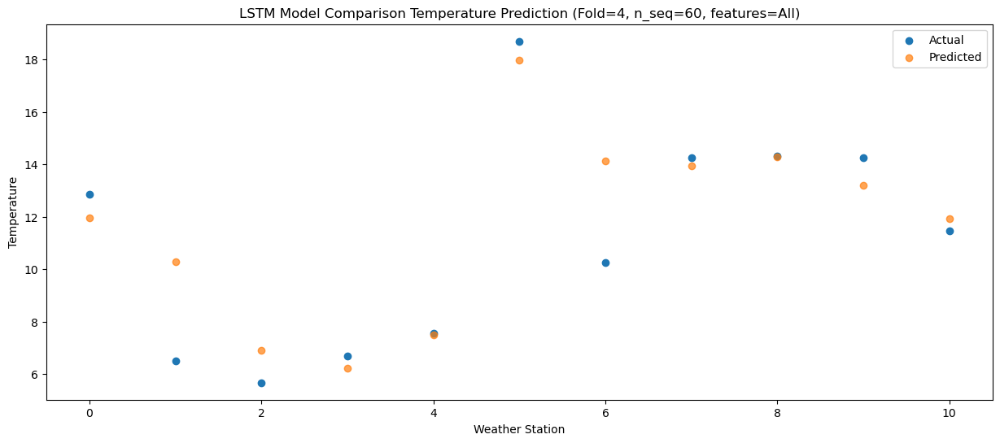

Predictions for (t+24):
    Weather_Station  Actual  Predicted
0                 0    5.80   2.863923
1                 1   -0.66   1.197933
2                 2   -3.00  -2.211481
3                 3   -1.33  -2.884908
4                 4   -0.29  -1.612840
5                 5   11.76   8.871135
6                 6    2.10   5.018961
7                 7    6.32   4.841480
8                 8    3.46   5.178849
9                 9    3.96   4.094231
10               10    1.07   2.796747


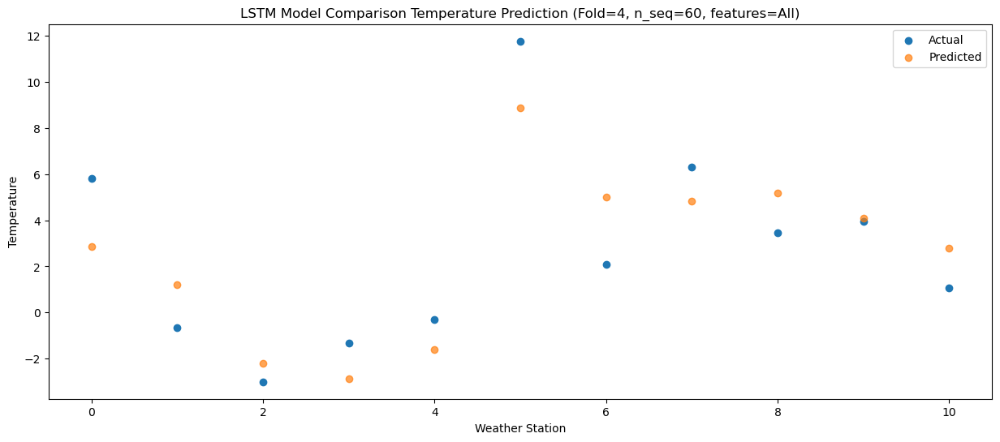

Predictions for (t+25):
    Weather_Station  Actual  Predicted
0                 0    4.01   1.354201
1                 1    1.14  -0.301025
2                 2    0.51  -3.711764
3                 3    0.67  -4.386553
4                 4    1.45  -3.115604
5                 5   12.17   7.373308
6                 6    4.01   3.520544
7                 7    7.78   3.342955
8                 8    3.78   3.680911
9                 9    3.71   2.596070
10               10    0.21   1.302933


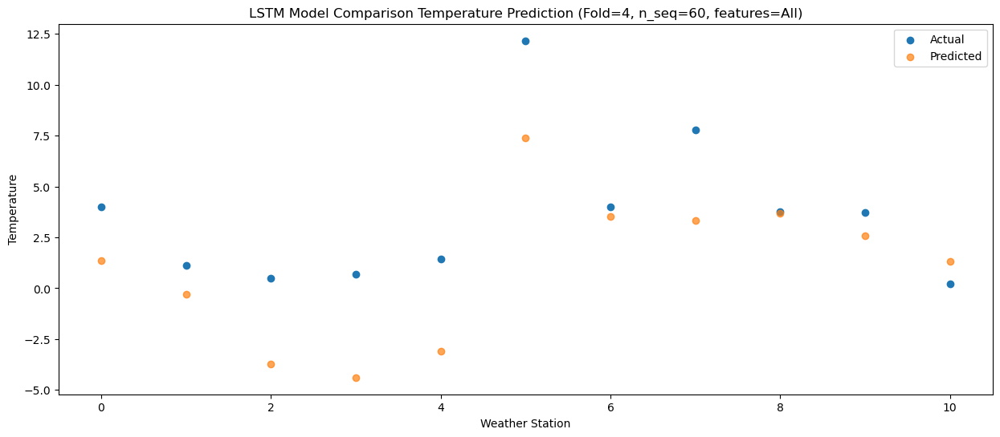

Predictions for (t+26):
    Weather_Station  Actual  Predicted
0                 0   -4.37  -6.184668
1                 1   -3.62  -7.844498
2                 2   -7.77 -11.257134
3                 3   -7.80 -11.928455
4                 4   -7.45 -10.654984
5                 5    4.80  -0.158389
6                 6   -2.05  -4.020524
7                 7   -1.29  -4.203762
8                 8   -5.06  -3.867781
9                 9   -5.77  -4.953415
10               10   -8.62  -6.244554


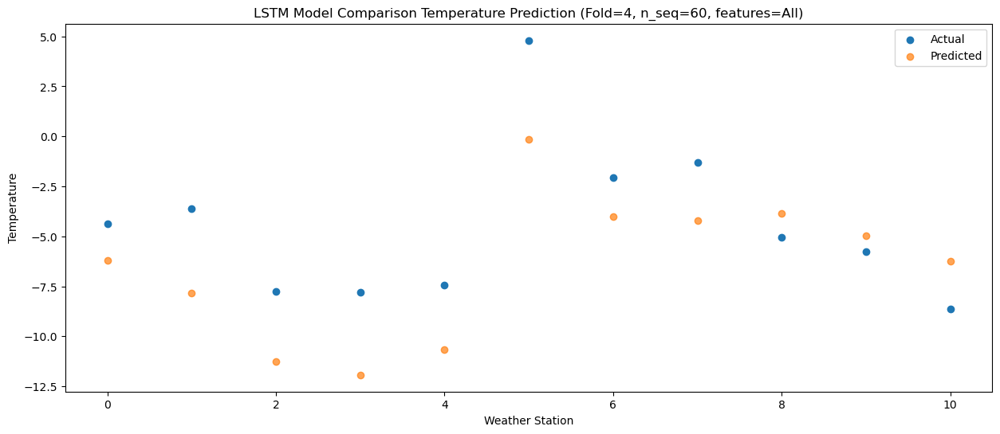

Predictions for (t+27):
    Weather_Station  Actual  Predicted
0                 0   -2.30  -2.636380
1                 1   -0.19  -4.296328
2                 2   -5.41  -7.713750
3                 3   -7.54  -8.388403
4                 4   -6.83  -7.114444
5                 5    4.60   3.385713
6                 6    2.23  -0.471910
7                 7    0.77  -0.655582
8                 8   -2.04  -0.315345
9                 9   -2.94  -1.397838
10               10   -5.06  -2.688214


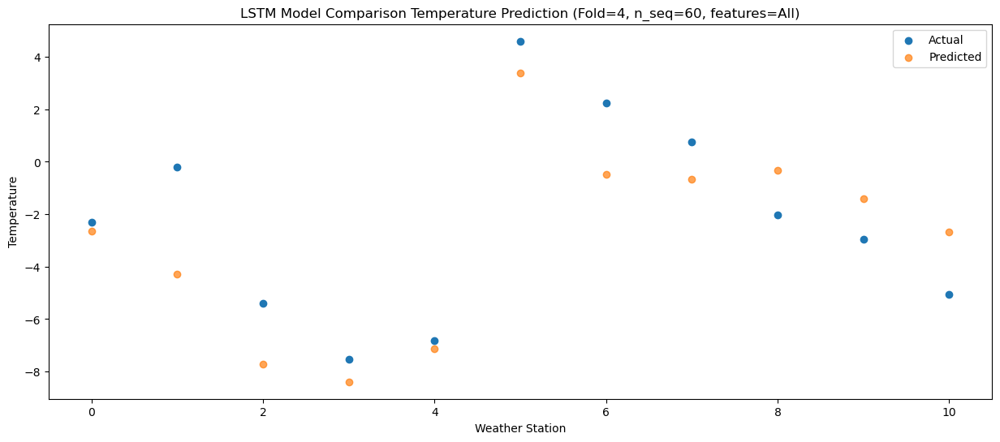

Predictions for (t+28):
    Weather_Station  Actual  Predicted
0                 0    4.41   2.549041
1                 1    2.63   0.882594
2                 2   -0.67  -2.541138
3                 3   -1.36  -3.215314
4                 4    0.09  -1.940999
5                 5   11.92   8.554993
6                 6    5.79   4.698219
7                 7    7.43   4.515383
8                 8    5.43   4.855293
9                 9    5.27   3.775689
10               10    0.91   2.487828


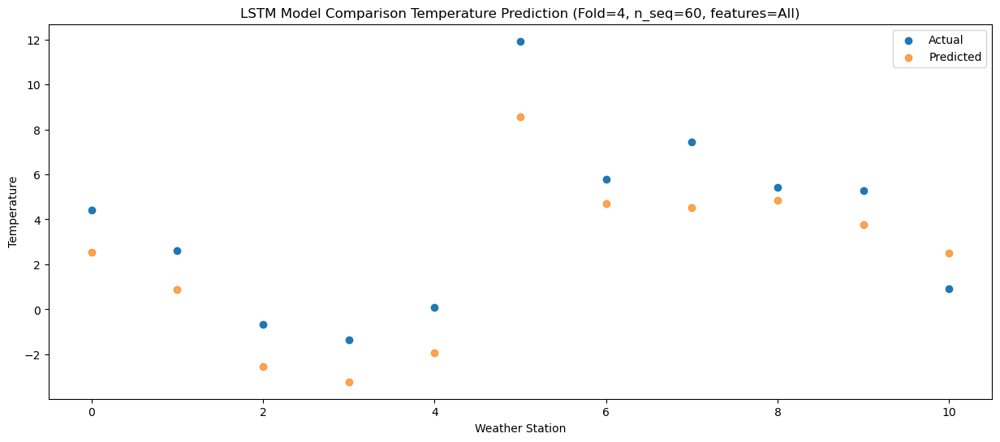

Predictions for (t+29):
    Weather_Station  Actual  Predicted
0                 0    9.29   7.173369
1                 1    4.97   5.498656
2                 2    3.54   2.077302
3                 3    4.69   1.407466
4                 4    6.78   2.682333
5                 5   19.43  13.179194
6                 6    8.45   9.315388
7                 7   11.29   9.137985
8                 8    9.21   9.476324
9                 9    9.39   8.400109
10               10    4.91   7.105685


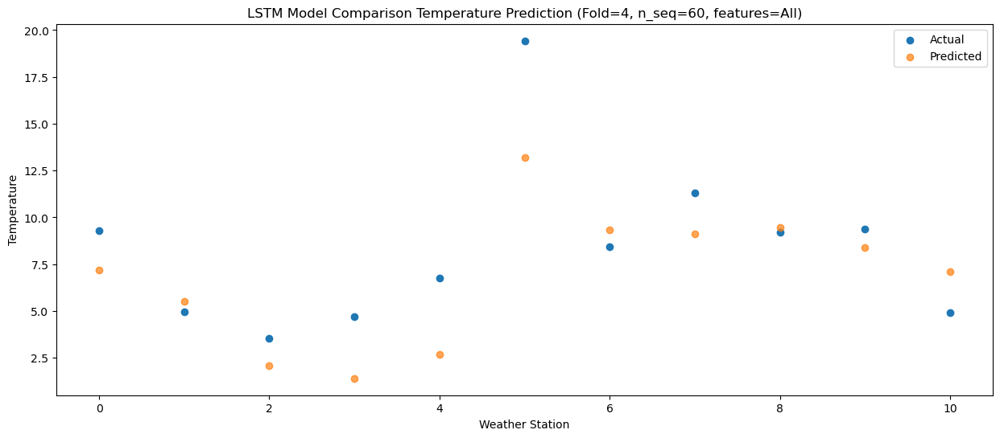

Predictions for (t+30):
    Weather_Station  Actual  Predicted
0                 0   16.23  14.613052
1                 1    7.79  12.944066
2                 2    9.34   9.522832
3                 3    9.40   8.852724
4                 4   11.61  10.127867
5                 5   25.12  20.624589
6                 6   14.43  16.762097
7                 7   16.96  16.584526
8                 8   17.71  16.921032
9                 9   17.92  15.844825
10               10   13.49  14.548497


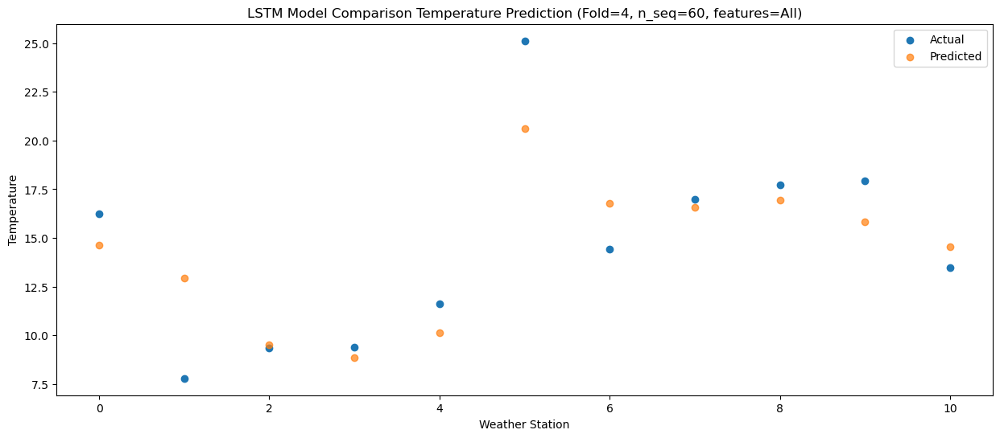

Predictions for (t+31):
    Weather_Station  Actual  Predicted
0                 0   22.14  17.975615
1                 1    9.51  16.305211
2                 2   12.63  12.881736
3                 3   13.95  12.216289
4                 4   16.28  13.494117
5                 5   27.49  23.992950
6                 6   17.64  20.125057
7                 7   22.28  19.946459
8                 8   22.19  20.279991
9                 9   22.53  19.203483
10               10   16.76  17.908709


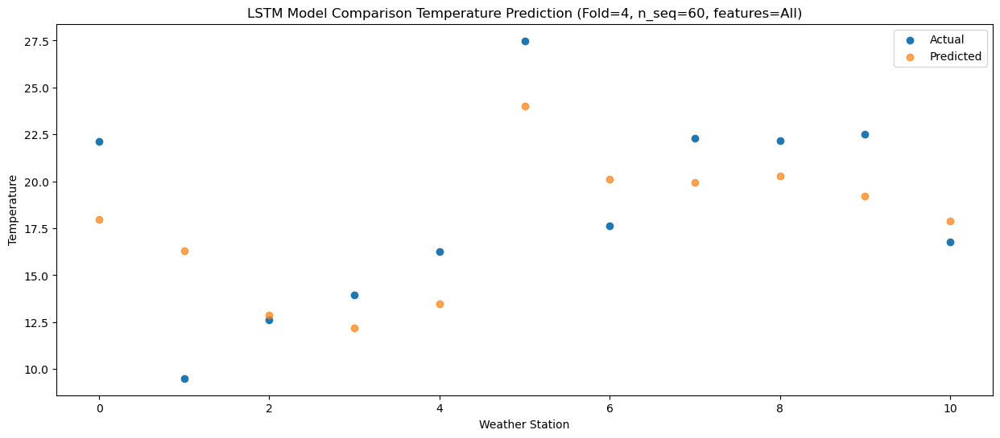

Predictions for (t+32):
    Weather_Station  Actual  Predicted
0                 0   24.66  20.970994
1                 1    9.88  19.292788
2                 2   12.83  15.870167
3                 3   17.25  15.204414
4                 4   19.70  16.483767
5                 5   29.39  26.976283
6                 6   18.91  23.108198
7                 7   25.98  22.932025
8                 8   24.13  23.265742
9                 9   23.35  22.190317
10               10   19.36  20.896220


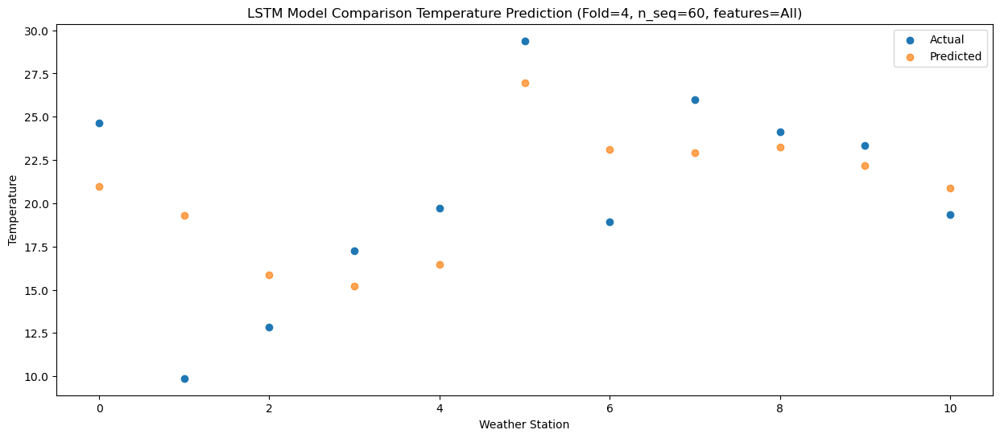

Predictions for (t+33):
    Weather_Station  Actual  Predicted
0                 0   23.00  20.342930
1                 1    9.83  18.654609
2                 2   11.29  15.234983
3                 3   14.52  14.571886
4                 4   16.86  15.851490
5                 5   26.09  26.341622
6                 6   17.39  22.470072
7                 7   22.46  22.295540
8                 8   21.90  22.631585
9                 9   22.05  21.558697
10               10   18.29  20.267046


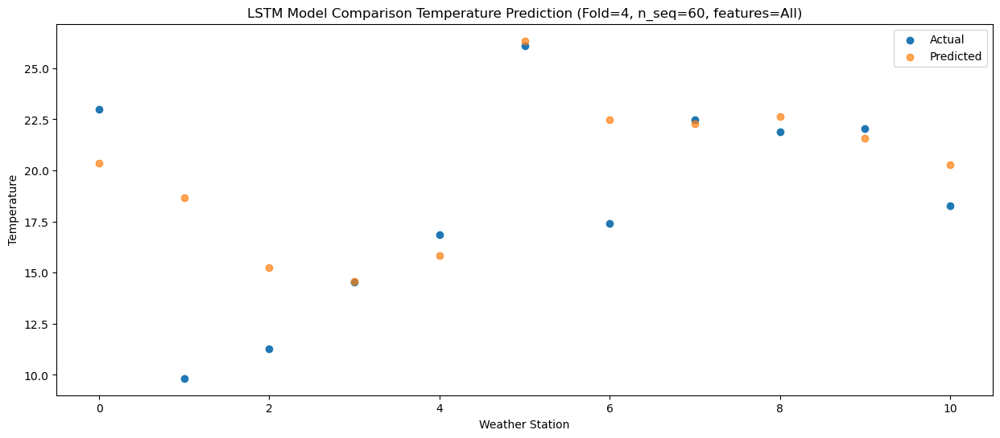

Predictions for (t+34):
    Weather_Station  Actual  Predicted
0                 0   19.09  15.633723
1                 1    8.39  13.937392
2                 2    9.22  10.515394
3                 3   11.09   9.854025
4                 4   12.77  11.134576
5                 5   23.19  21.621465
6                 6   14.30  17.746981
7                 7   18.87  17.576339
8                 8   17.99  17.913517
9                 9   17.91  16.845364
10               10   14.24  15.550614


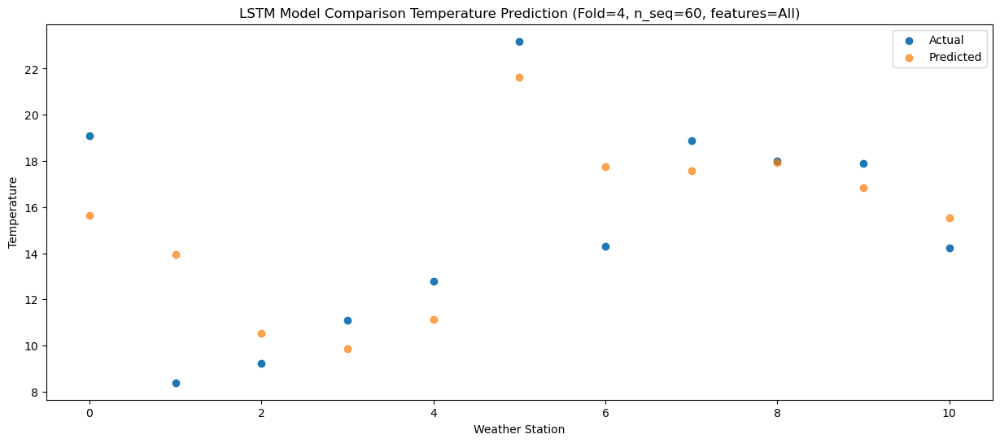

Predictions for (t+35):
    Weather_Station  Actual  Predicted
0                 0   11.74   9.539094
1                 1    4.56   7.839200
2                 2    3.09   4.419882
3                 3    4.22   3.756320
4                 4    5.62   5.037545
5                 5   16.38  15.529409
6                 6    7.43  11.656765
7                 7   12.50  11.490777
8                 8   10.50  11.825508
9                 9   10.44  10.761175
10               10    7.38   9.466714


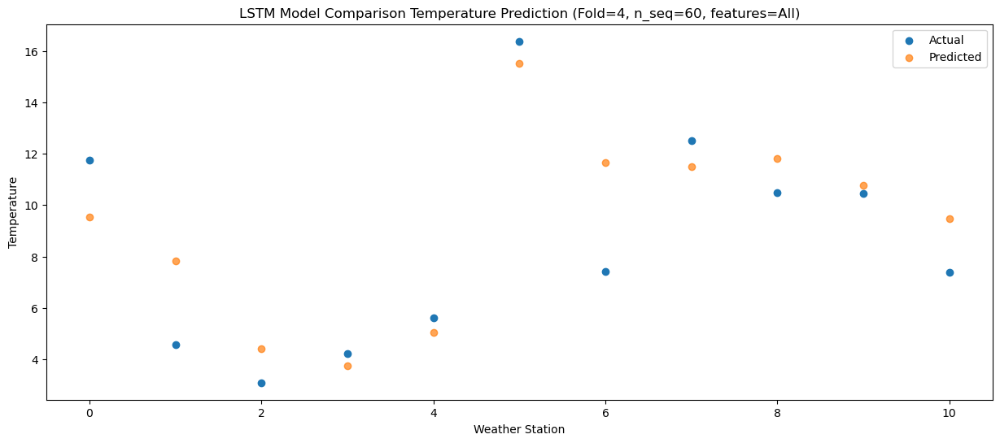

Predictions for (t+36):
    Weather_Station  Actual  Predicted
0                 0    3.41   5.359108
1                 1    3.10   3.653296
2                 2   -1.50   0.240317
3                 3   -2.83  -0.423672
4                 4   -1.47   0.859783
5                 5    8.53  11.351578
6                 6    4.73   7.479559
7                 7    5.95   7.317329
8                 8    4.71   7.653855
9                 9    4.90   6.592636
10               10    3.30   5.294032


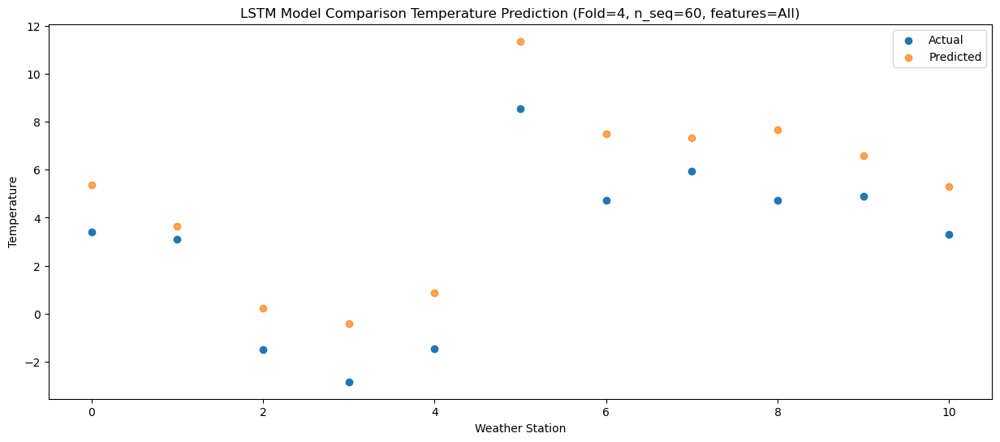

Predictions for (t+37):
    Weather_Station  Actual  Predicted
0                 0   -2.73  -1.006664
1                 1   -1.75  -2.721819
2                 2   -3.93  -6.130432
3                 3   -5.52  -6.795209
4                 4   -4.44  -5.508444
5                 5    6.93   4.980739
6                 6   -1.22   1.108817
7                 7    1.10   0.951346
8                 8   -1.07   1.289122
9                 9   -1.83   0.229950
10               10   -3.41  -1.077478


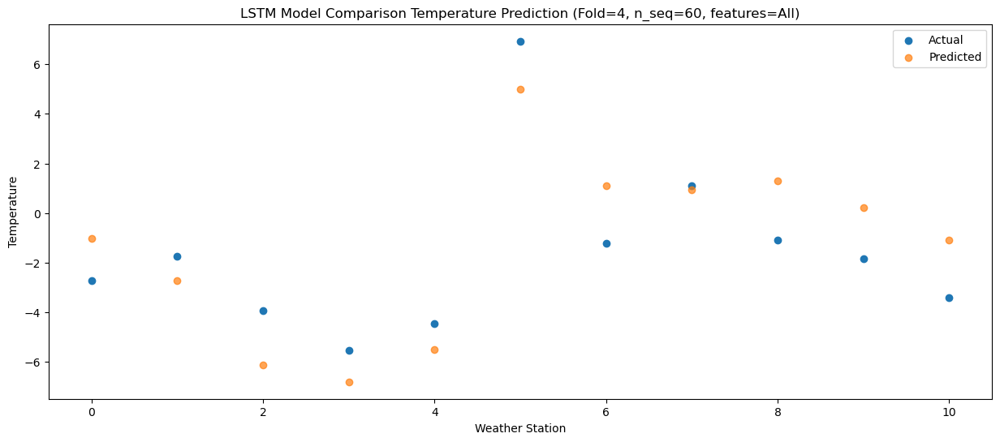

Predictions for (t+38):
    Weather_Station  Actual  Predicted
0                 0   -0.77   0.601188
1                 1   -1.90  -1.129610
2                 2   -3.52  -4.533906
3                 3   -4.53  -5.198406
4                 4   -3.67  -3.912338
5                 5    7.30   6.572556
6                 6    1.80   2.700331
7                 7    2.75   2.547672
8                 8    0.89   2.887802
9                 9    0.41   1.830685
10               10   -1.78   0.524756


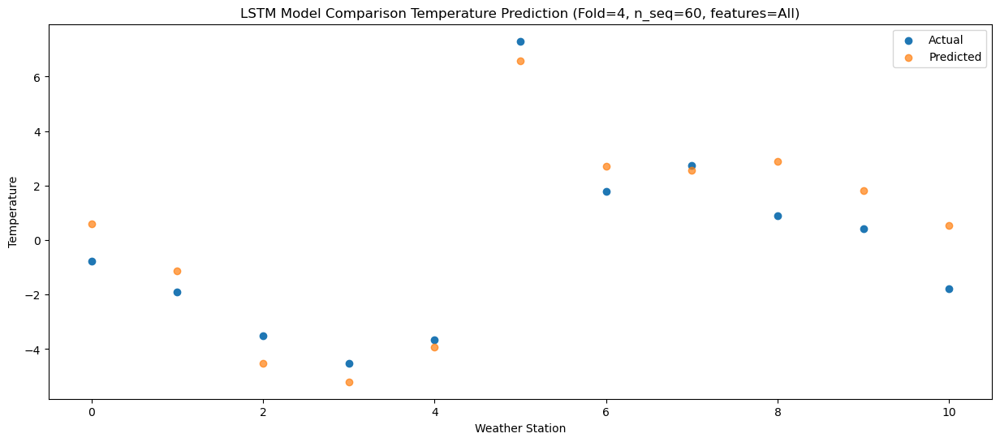

Predictions for (t+39):
    Weather_Station  Actual  Predicted
0                 0    0.98  -0.168395
1                 1    1.40  -1.900275
2                 2   -1.58  -5.303353
3                 3   -4.47  -5.966549
4                 4   -3.44  -4.678605
5                 5    7.47   5.808685
6                 6    5.22   1.933432
7                 7    4.89   1.775619
8                 8    2.48   2.112909
9                 9    1.60   1.052892
10               10   -1.64  -0.253472


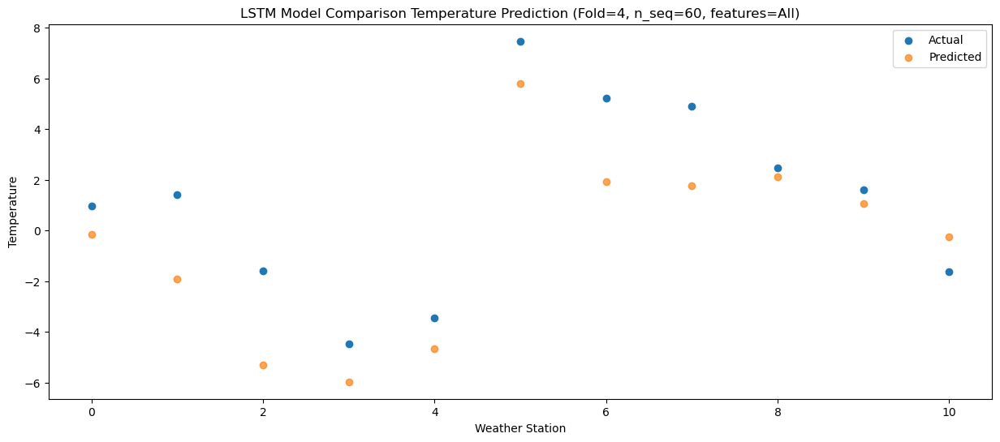

Predictions for (t+40):
    Weather_Station  Actual  Predicted
0                 0    3.16   1.419900
1                 1    3.12  -0.317679
2                 2    0.57  -3.725978
3                 3    0.06  -4.380542
4                 4    1.41  -3.089331
5                 5   12.54   7.398532
6                 6    5.70   3.513315
7                 7    6.61   3.357356
8                 8    3.75   3.689344
9                 9    4.14   2.629162
10               10   -0.76   1.317872


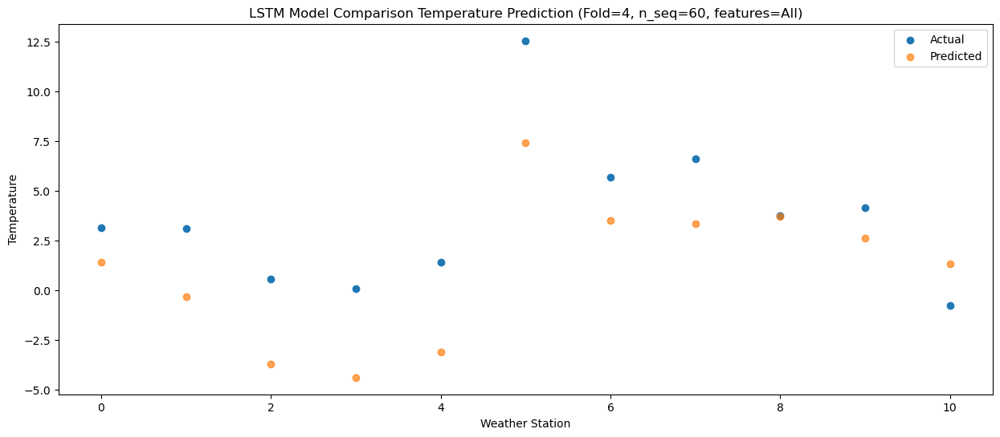

Predictions for (t+41):
    Weather_Station  Actual  Predicted
0                 0   10.99   8.980373
1                 1    5.84   7.235197
2                 2    2.32   3.822333
3                 3    2.66   3.171168
4                 4    4.06   4.464243
5                 5   16.76  14.956825
6                 6    8.81  11.061935
7                 7   12.23  10.908703
8                 8   10.25  11.242542
9                 9   11.47  10.188941
10               10    7.71   8.876159


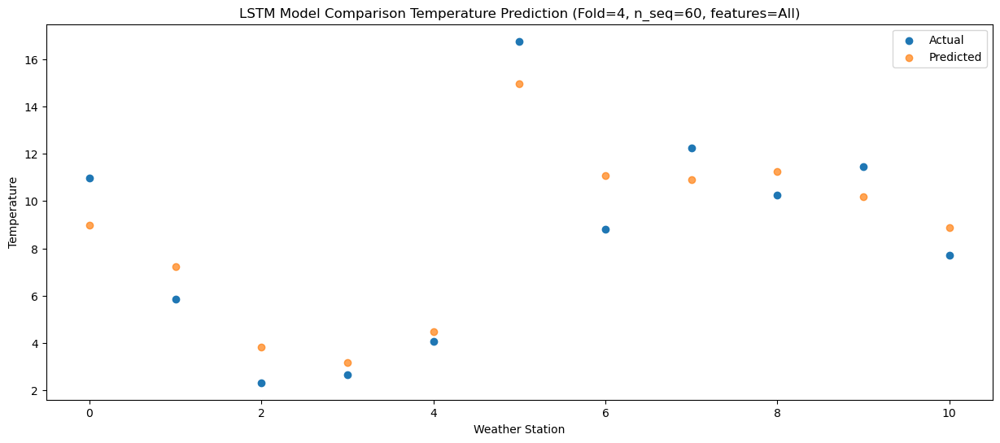

Predictions for (t+42):
    Weather_Station  Actual  Predicted
0                 0   16.80  12.276190
1                 1    6.62  10.537124
2                 2    7.18   7.123880
3                 3    8.34   6.467197
4                 4   10.22   7.758639
5                 5   21.68  18.257221
6                 6   11.43  14.358851
7                 7   17.01  14.200178
8                 8   15.96  14.537737
9                 9   17.23  13.485788
10               10   11.40  12.175916


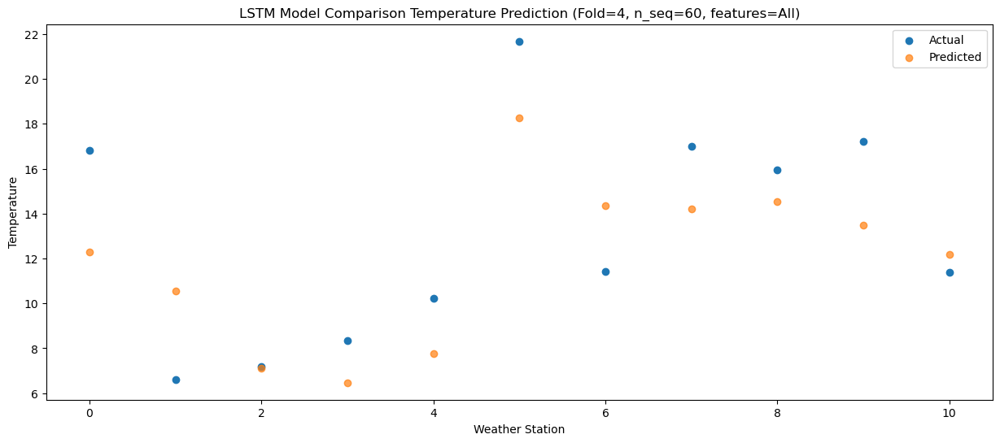

Predictions for (t+43):
    Weather_Station  Actual  Predicted
0                 0   21.71  16.312651
1                 1    8.83  14.573749
2                 2   10.77  11.157398
3                 3   12.53  10.501276
4                 4   15.33  11.791687
5                 5   28.16  22.286513
6                 6   15.07  18.384936
7                 7   21.09  18.230127
8                 8   19.84  18.570139
9                 9   21.54  17.522812
10               10   15.71  16.210459


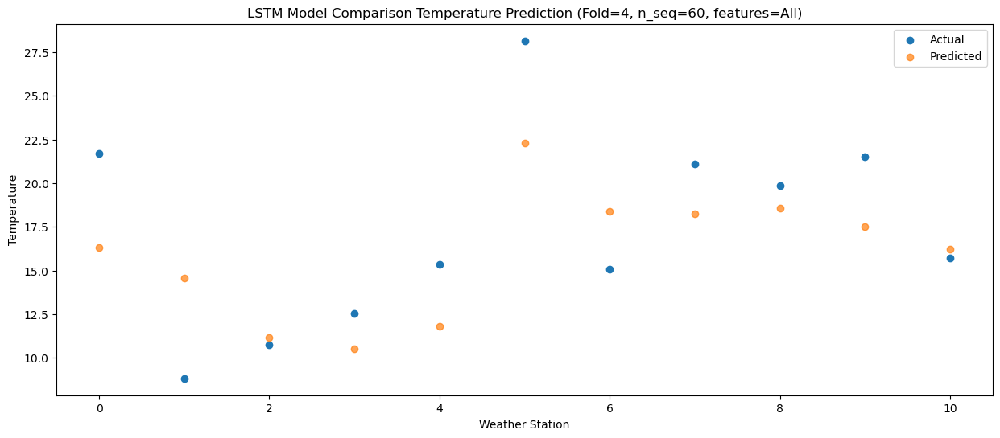

Predictions for (t+44):
    Weather_Station  Actual  Predicted
0                 0   23.02  20.513325
1                 1   10.44  18.767786
2                 2   12.55  15.347157
3                 3   15.08  14.697992
4                 4   18.41  15.992089
5                 5   29.62  26.484298
6                 6   18.94  22.577397
7                 7   23.05  22.420391
8                 8   22.57  22.760269
9                 9   23.07  21.714277
10               10   18.80  20.402780


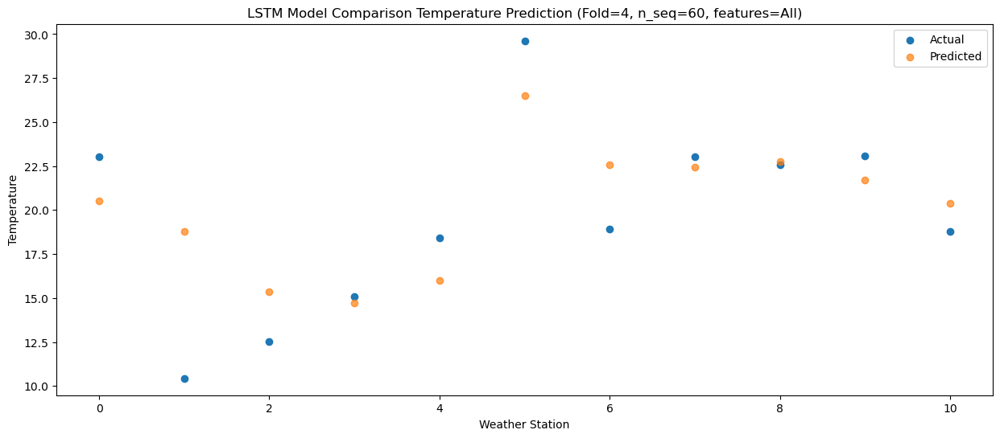

Predictions for (t+45):
    Weather_Station  Actual  Predicted
0                 0   22.82  18.788569
1                 1   10.95  17.034550
2                 2   14.63  13.607980
3                 3   17.63  12.958107
4                 4   20.28  14.251487
5                 5   29.71  24.750397
6                 6   18.38  20.837060
7                 7   22.86  20.684701
8                 8   21.41  21.021402
9                 9   21.81  19.981745
10               10   17.47  18.666742


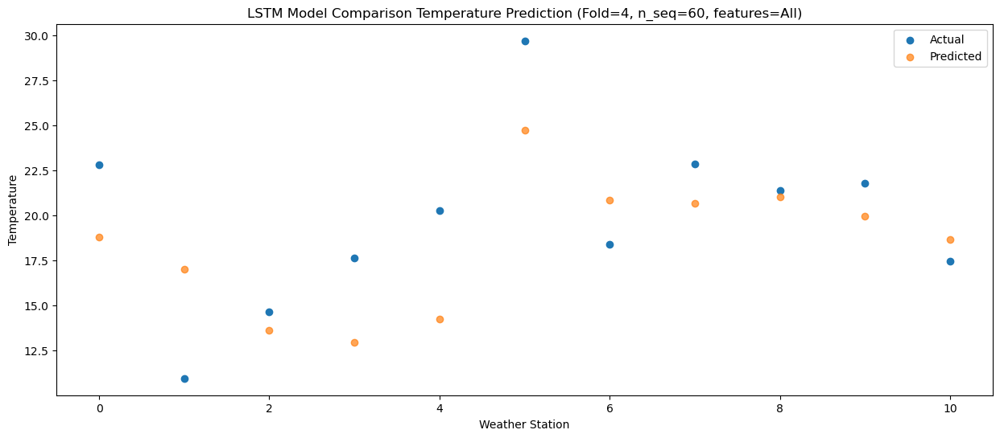

Predictions for (t+46):
    Weather_Station  Actual  Predicted
0                 0   19.99  16.018881
1                 1    8.85  14.275985
2                 2   10.88  10.841236
3                 3   12.93  10.183488
4                 4   15.19  11.472262
5                 5   26.23  21.974940
6                 6   14.54  18.058831
7                 7   18.92  17.900702
8                 8   18.32  18.242702
9                 9   18.77  17.200934
10               10   15.13  15.889577


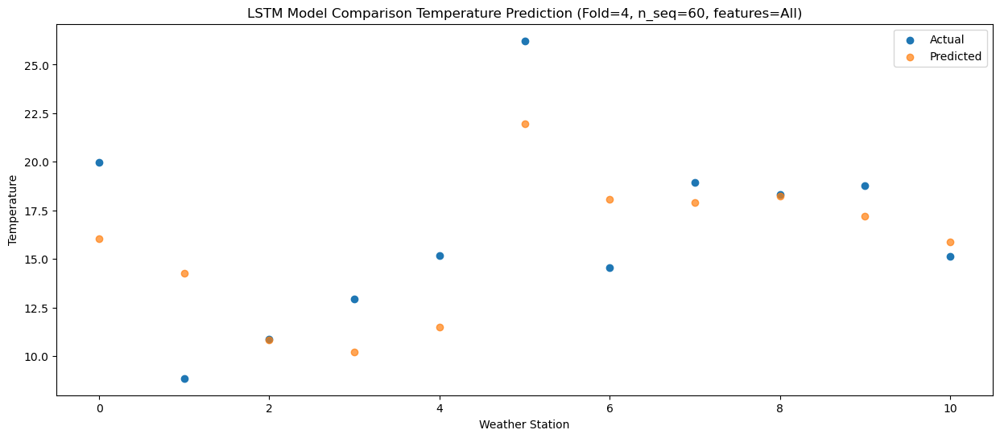

Predictions for (t+47):
    Weather_Station  Actual  Predicted
0                 0   12.87  11.199602
1                 1    5.20   9.444557
2                 2    4.77   6.012376
3                 3    4.80   5.355592
4                 4    6.36   6.646348
5                 5   17.70  17.142976
6                 6    9.10  13.231617
7                 7   13.02  13.078954
8                 8   12.18  13.418118
9                 9   12.36  12.380719
10               10    9.87  11.061023


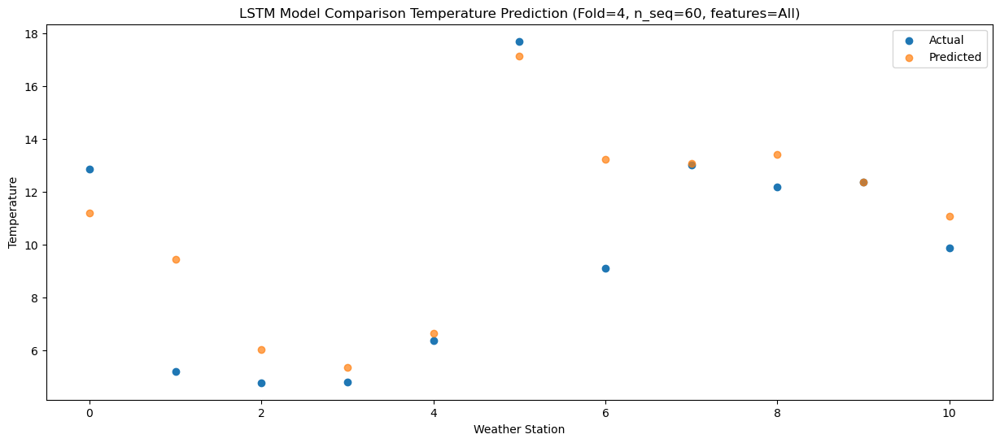

Predictions for (t+48):
    Weather_Station  Actual  Predicted
0                 0    6.62   3.320169
1                 1    1.49   1.577118
2                 2   -2.19  -1.857223
3                 3   -1.27  -2.517022
4                 4   -0.17  -1.226181
5                 5   10.99   9.269589
6                 6    3.37   5.362547
7                 7    7.12   5.204252
8                 8    5.11   5.543981
9                 9    5.27   4.510059
10               10    2.48   3.191493


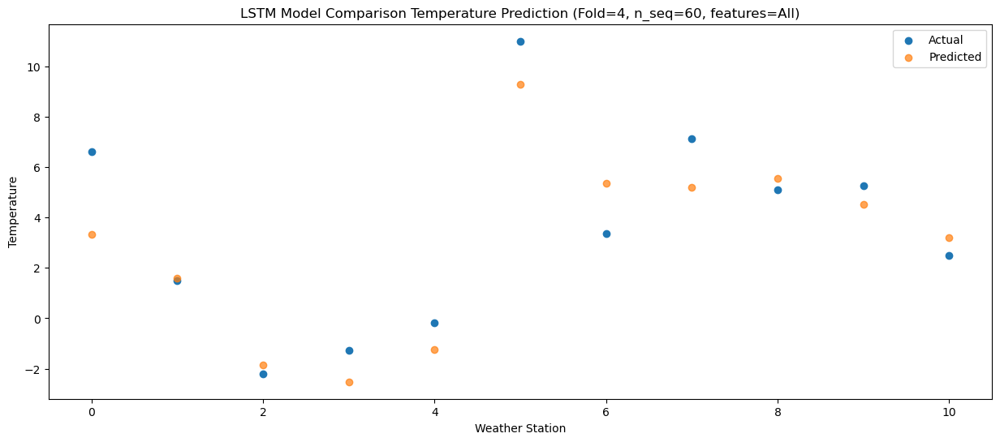

Predictions for (t+49):
    Weather_Station  Actual  Predicted
0                 0    3.22   2.600759
1                 1   -0.63   0.852815
2                 2   -4.74  -2.586810
3                 3   -4.29  -3.245203
4                 4   -3.30  -1.953287
5                 5    8.19   8.540619
6                 6    1.16   4.632562
7                 7    4.24   4.478003
8                 8    3.22   4.821551
9                 9    3.28   3.794127
10               10    1.82   2.472660


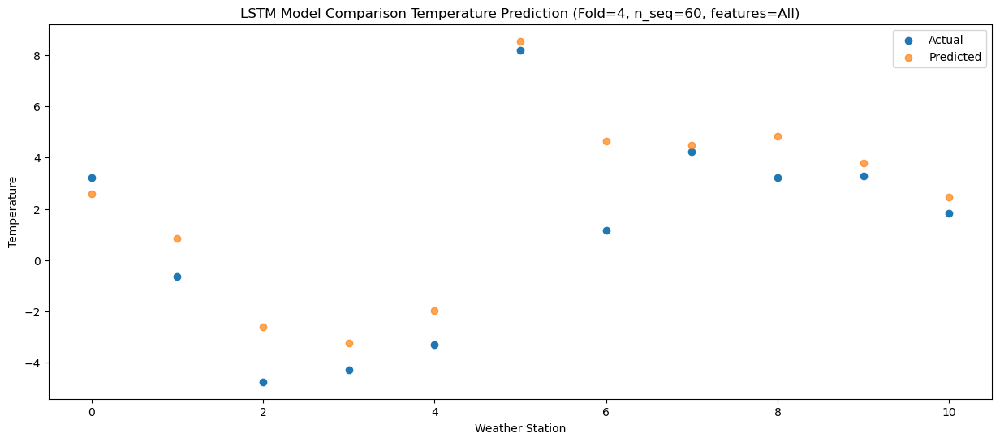

Predictions for (t+50):
    Weather_Station  Actual  Predicted
0                 0   -5.37  -1.950855
1                 1   -2.05  -3.697213
2                 2   -8.93  -7.143027
3                 3   -9.81  -7.797955
4                 4   -8.65  -6.502128
5                 5    3.94   3.994370
6                 6   -1.28   0.077127
7                 7   -2.92  -0.082668
8                 8   -3.06   0.255021
9                 9   -4.30  -0.778670
10               10   -3.95  -2.096303


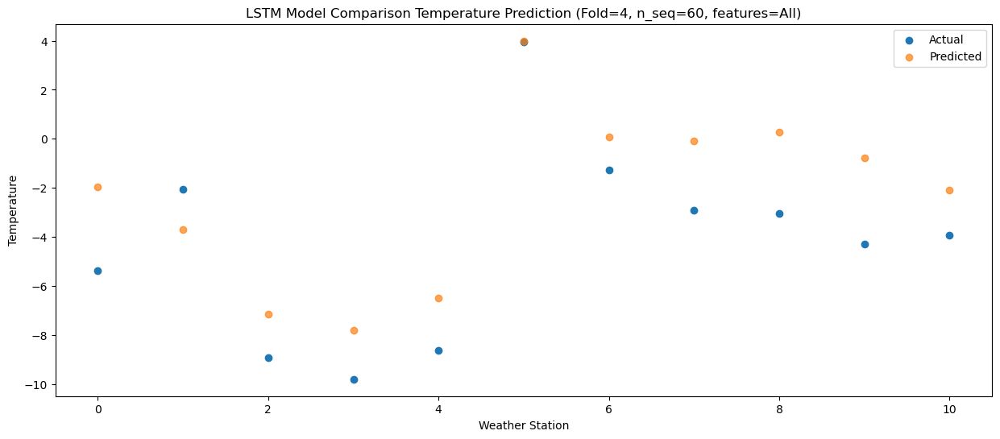

Predictions for (t+51):
    Weather_Station  Actual  Predicted
0                 0    5.74   1.240054
1                 1   -2.32  -0.515051
2                 2   -2.61  -3.961050
3                 3   -1.40  -4.614428
4                 4   -0.33  -3.317710
5                 5   10.76   7.175645
6                 6    2.13   3.259575
7                 7    6.99   3.105188
8                 8    3.28   3.441743
9                 9    3.47   2.411584
10               10   -0.47   1.087958


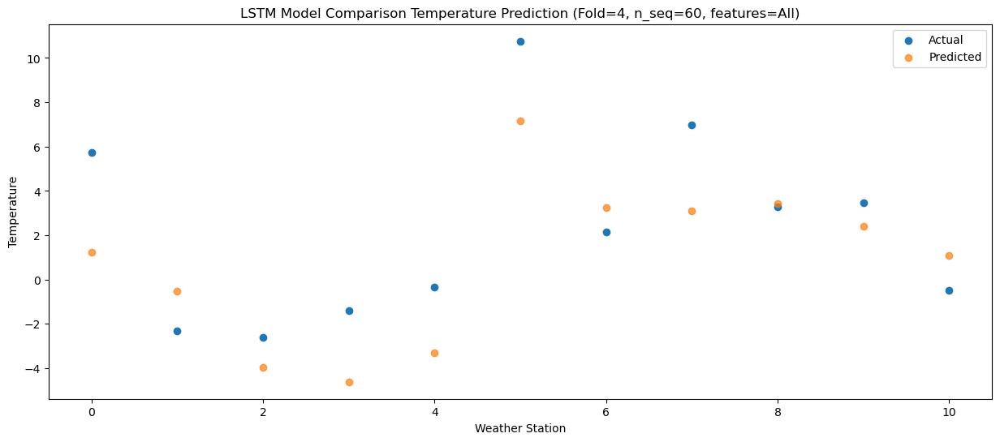

Predictions for (t+52):
    Weather_Station  Actual  Predicted
0                 0    8.27   4.372709
1                 1    2.58   2.609607
2                 2   -0.38  -0.833184
3                 3    1.01  -1.481170
4                 4    2.24  -0.183184
5                 5   13.36  10.315594
6                 6    5.92   6.396405
7                 7    9.42   6.240624
8                 8    7.72   6.575945
9                 9    7.62   5.548368
10               10    2.88   4.223939


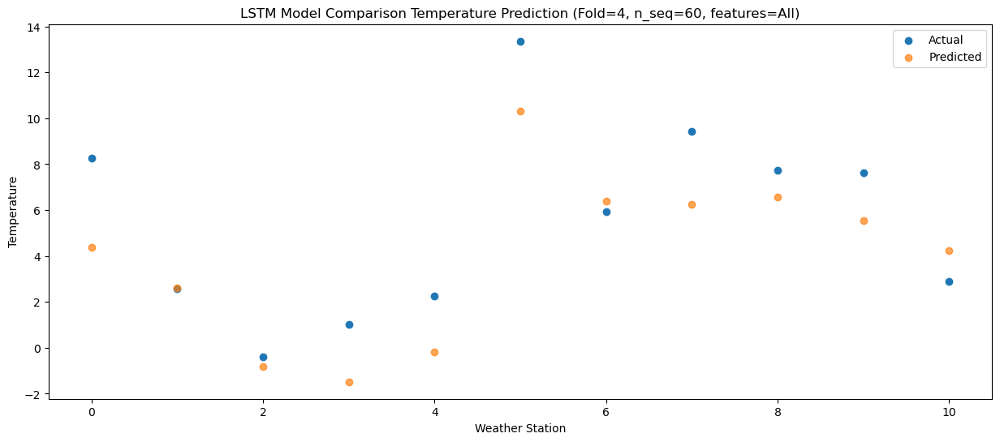

Predictions for (t+53):
    Weather_Station  Actual  Predicted
0                 0   12.89   7.975351
1                 1    3.63   6.204473
2                 2    3.44   2.764388
3                 3    4.86   2.111579
4                 4    6.29   3.408527
5                 5   18.32  13.909626
6                 6   10.15   9.989817
7                 7   13.56   9.831850
8                 8   12.30  10.166490
9                 9   12.11   9.138482
10               10    8.60   7.815634


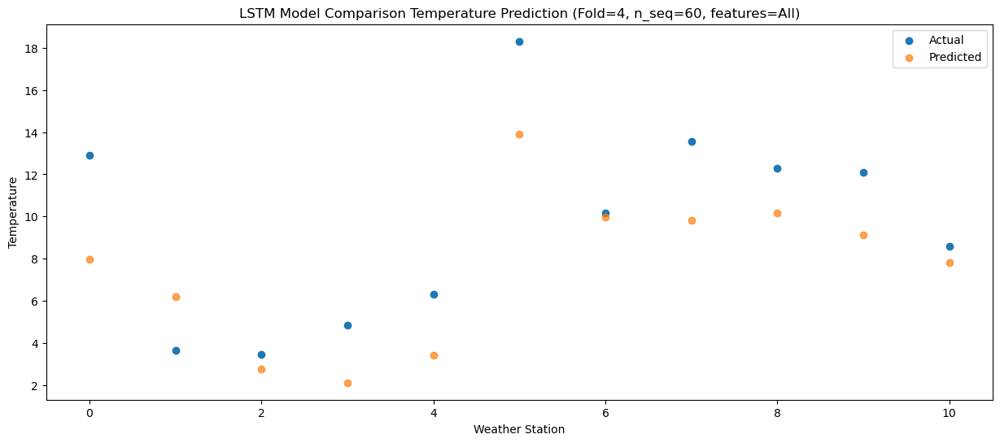

Predictions for (t+54):
    Weather_Station  Actual  Predicted
0                 0   17.90  14.653204
1                 1    9.08  12.881994
2                 2    8.96   9.449097
3                 3    9.62   8.791606
4                 4   11.09  10.086876
5                 5   23.61  20.582999
6                 6   14.22  16.672543
7                 7   18.21  16.509784
8                 8   18.90  16.851687
9                 9   19.14  15.824403
10               10   14.70  14.506699


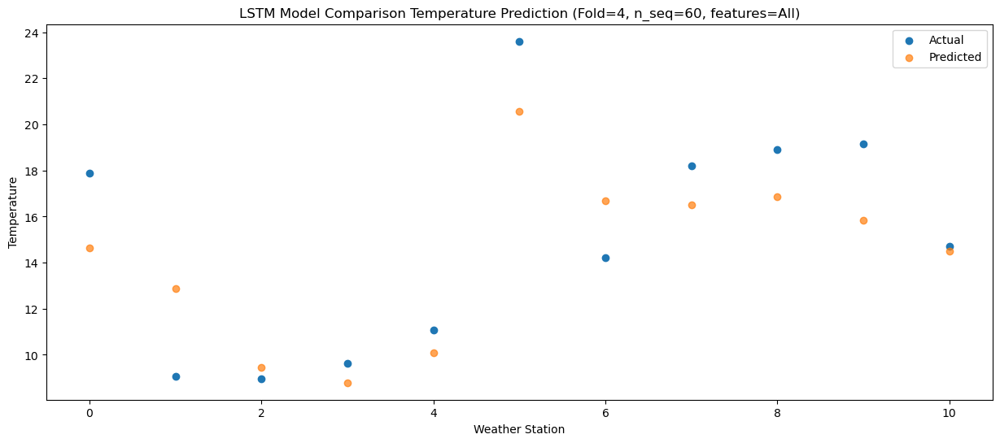

Predictions for (t+55):
    Weather_Station  Actual  Predicted
0                 0   23.09  18.851115
1                 1    9.73  17.083838
2                 2   11.59  13.645643
3                 3   13.65  12.987330
4                 4   15.54  14.284690
5                 5   27.62  24.776033
6                 6   17.64  20.862881
7                 7   21.93  20.702235
8                 8   22.26  21.042524
9                 9   23.11  20.016007
10               10   17.86  18.695940


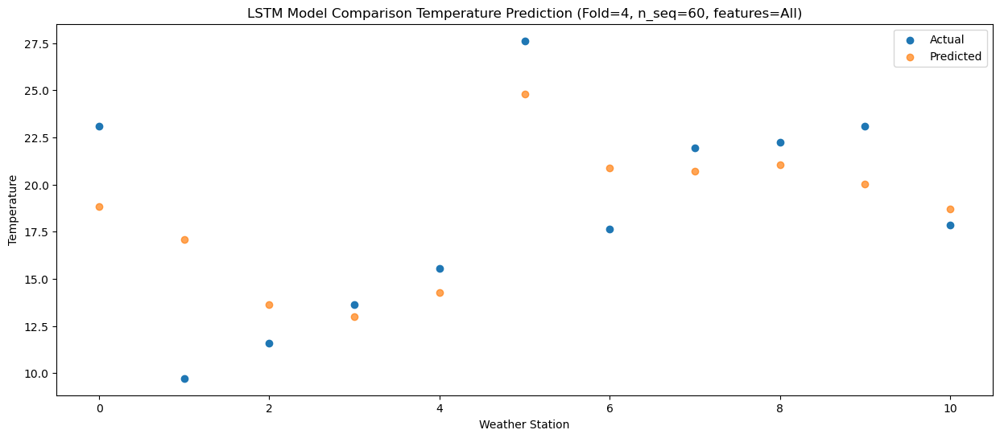

Predictions for (t+56):
    Weather_Station  Actual  Predicted
0                 0   23.85  20.973192
1                 1   10.42  19.217367
2                 2   12.61  15.767073
3                 3   14.55  15.107336
4                 4   16.25  16.402947
5                 5   26.45  26.887052
6                 6   19.10  22.976345
7                 7   22.23  22.810958
8                 8   22.27  23.158428
9                 9   22.14  22.135010
10               10   19.38  20.822515


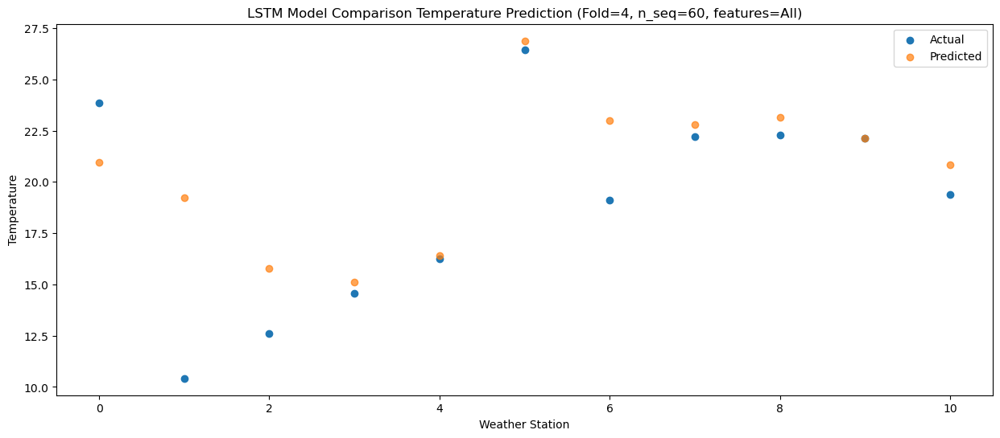

Predictions for (t+57):
    Weather_Station  Actual  Predicted
0                 0   22.36  18.818954
1                 1   10.12  17.066501
2                 2   13.18  13.613142
3                 3   16.30  12.953882
4                 4   18.21  14.250322
5                 5   28.91  24.724573
6                 6   17.94  20.813352
7                 7   22.67  20.651072
8                 8   22.19  20.998655
9                 9   21.80  19.977719
10               10   18.24  18.665672


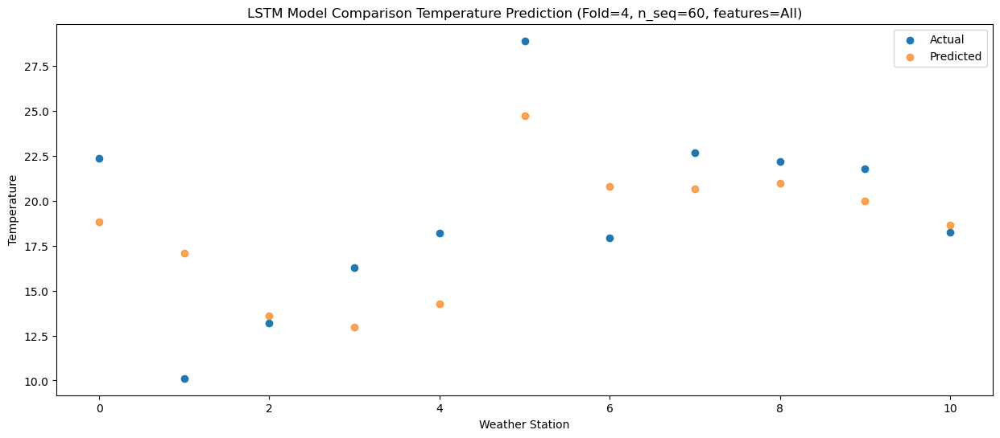

Predictions for (t+58):
    Weather_Station  Actual  Predicted
0                 0   19.93  16.076116
1                 1    9.25  14.323540
2                 2    9.57  10.869203
3                 3   10.91  10.212576
4                 4   12.20  11.508712
5                 5   22.46  21.984363
6                 6   15.50  18.077233
7                 7   18.53  17.909475
8                 8   19.58  18.257785
9                 9   18.57  17.237335
10               10   15.97  15.925555


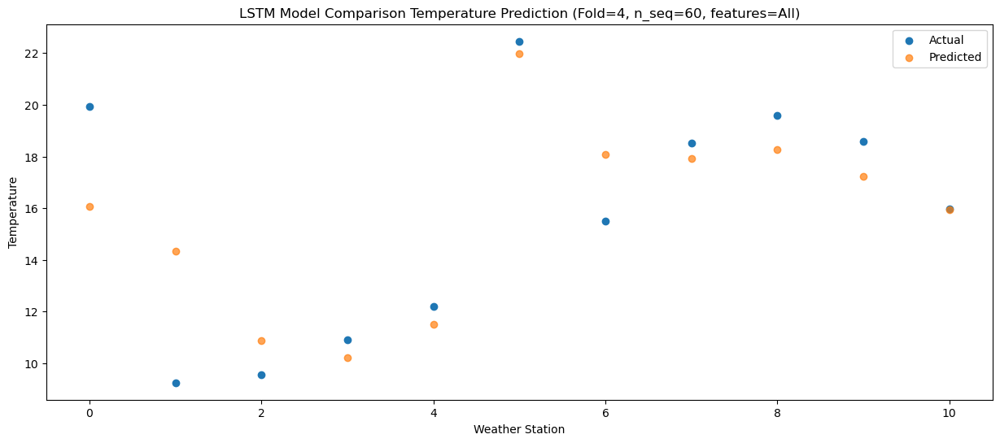

Predictions for (t+59):
    Weather_Station  Actual  Predicted
0                 0   15.80  10.640564
1                 1    5.48   8.886047
2                 2    5.43   5.428506
3                 3    8.16   4.776467
4                 4    9.78   6.076233
5                 5   20.75  16.549224
6                 6    9.88  12.638399
7                 7   14.85  12.474549
8                 8   13.65  12.818660
9                 9   13.50  11.796704
10               10    9.50  10.483850


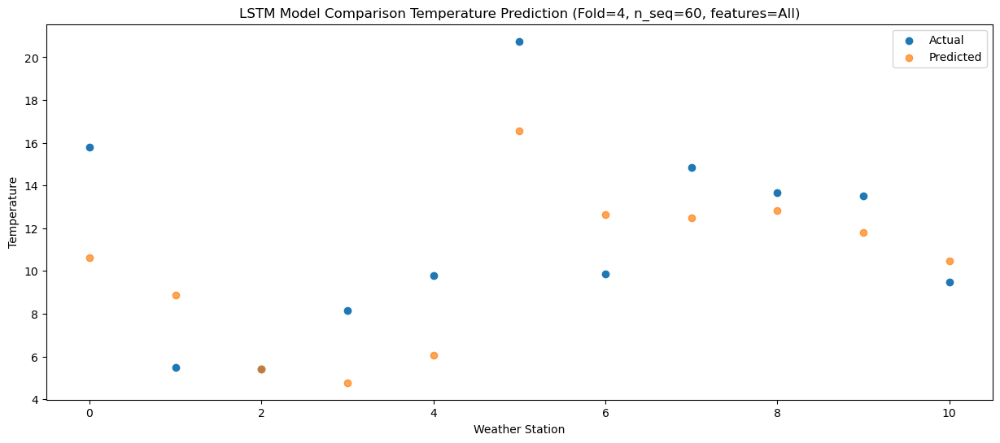

Model: "sequential_4"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_8 (LSTM)               (1, 1, 256)               2290688   
                                                                 
 dropout_8 (Dropout)         (1, 1, 256)               0         
                                                                 
 lstm_9 (LSTM)               (1, 256)                  525312    
                                                                 
 dropout_9 (Dropout)         (1, 256)                  0         
                                                                 
 dense_12 (Dense)            (1, 256)                  65792     
                                                                 
 dense_13 (Dense)            (1, 128)                  32896     
                                                                 
 dense_14 (Dense)            (1, 60)                  

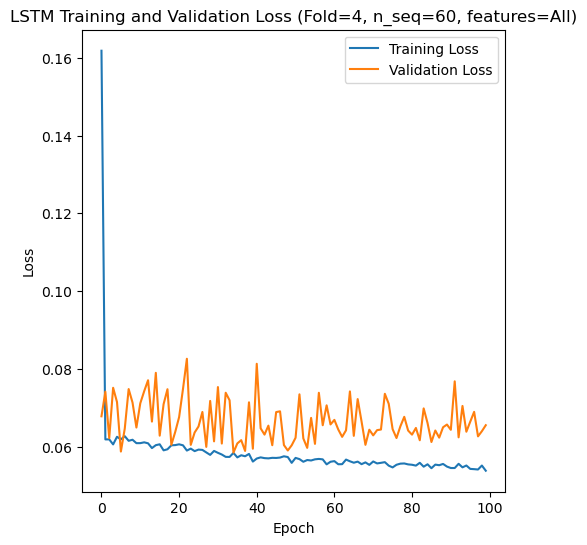

[[1.9003730104243246, 0.9832722777442242, 1.3350700083319254, 1.654659236241013, 2.00369542755717, 1.9050411272758596, 3.063862206996226, 4.3736791111847975, 4.907242705577698, 4.380957461507406, 3.097618879634098, 1.1061540734887996, 1.54163350785354, 1.9403949748245306, 1.6832124076888666, 2.3880962064249633, 1.505041063179924, 2.172674102103388, 2.6953825806004983, 4.64263710249008, 4.215066197050082, 3.8448430379833685, 3.395058444949068, 2.1942879643537685, 2.466574556946545, 2.5152895120172656, 2.4755079242375504, 2.2103219088688677, 1.102396317227979, 1.777524438841657, 2.1512719108370213, 2.9359883649196274, 4.416586878360154, 4.3812118563459155, 2.9918031107490664, 2.9825254920954136, 1.0338515981094398, 2.4908692071287724, 2.114775337370056, 2.724067159513216, 2.4632058007801, 1.611741254468658, 3.6680660053402994, 4.299437818299593, 4.1650661402098335, 3.8659250622651875, 3.7362879680659637, 2.8584022217466294, 1.9699395599880294, 2.3409064580767645, 1.3932251151216717, 2.25

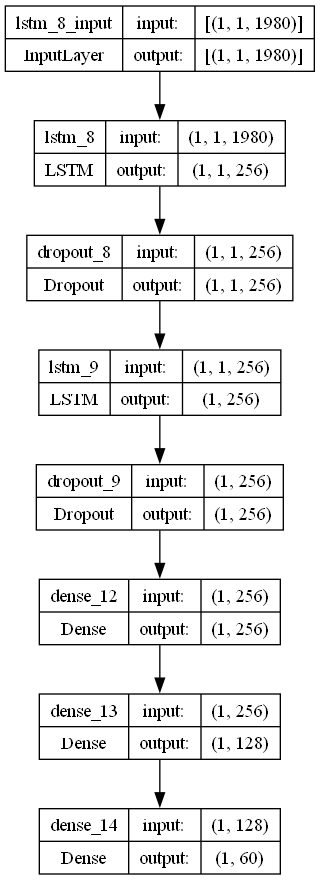

In [3]:
from sklearn.metrics import mean_squared_error, mean_absolute_error, mean_absolute_percentage_error, r2_score
from tensorflow.keras.utils import plot_model

def rmse (y_true, y_pred):
    return K.sqrt(K.mean(K.square(y_pred - y_true)))

# fit best LSTM model using parameters found by Optuna
def create_best_model(X, y, n_lag, n_seq, n_batch, nb_epoch):
    
    #Parameters:
    #trial (array-like): Optuna parameters.
    #train (array-like): Target values.
    #n_lag (int): Number of lag observations.
    #n_seq (int): Number of sequence observations
    #nb_epoch (int): Maximum number of epochs
    
    # Hyperparameters from best model
    lr = 0.057985701700996824
    optimizer = SGD(learning_rate = lr)
    activation_function = 'sigmoid'
    lstm_units = 256
    dropout_rate = 0.2304602014121111

    # design network
    model = Sequential()
    #model.add(Conv1D(filters=filters, kernel_size=1, activation='relu', input_shape=(X.shape[1], X.shape[2]))) # CNN-LSTM only
    model.add(LSTM(lstm_units, return_sequences=True, batch_input_shape=(n_batch, X.shape[1], X.shape[2]), stateful=True))
    model.add(Dropout(dropout_rate))
    model.add(LSTM(lstm_units))
    model.add(Dropout(dropout_rate))
    model.add(Dense(256, input_dim=y.shape[1], activation=activation_function))
    model.add(Dense(128, activation=activation_function))
    model.add(Dense(n_seq))
    model.compile(loss=rmse, optimizer=optimizer, metrics=['accuracy', 'mae', rmse, mape, pearson])
        
    return model

# Make one forecast with an LSTM
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def forecast_lstm(model, X, n_seq, n_test):
    # reshape input pattern to [samples, timesteps, features]
    X = X.reshape(1, 1, X.shape[1])
    # make forecast
    forecast = model.predict(X)
    # convert to array
    return forecast
     
# Evaluate the persistence model
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def make_forecasts(model, X_test, y_test, n_lag, n_seq, n_test):
    forecasts = list()
    for i in range(len(X_test)):
        X, y = X_test[i, :], y_test[i, :]
        # make forecast
        forecast = forecast_lstm(model, X, n_seq, n_test)
        # store the forecast
        forecasts.append(forecast)
    return forecasts
     
# Invert differenced forecast
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def inverse_difference(last_ob, forecast):
    # Invert the first forecast
    inverted = list()
    inverted.append(forecast[0] + last_ob)
    # Propagate the difference forecast using the inverted first value
    for i in range(1, len(forecast)):
        inverted.append(forecast[i] + inverted[i-1])
    return inverted
     
# Inverse data transform on forecasts
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def inverse_transform(series, forecasts, scaler, n_test, n_seq):
    inverted = list()
    for i in range(len(forecasts)):
        # Create an array from the forecast
        forecast = forecasts[i]
        forecast = forecast.reshape(1, n_seq)
        # invert scaling
        inv_scale = scaler.inverse_transform(forecast)
        inv_scale = inv_scale[0, :]
        # invert differencing
        index = len(series) - n_test + i - 1
        last_ob = series.values[index]
        inv_diff = inverse_difference(last_ob, inv_scale)
        # store
        inverted.append(inv_diff)
    return inverted
     
# evaluate the RMSE for each forecast time step
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def evaluate_forecasts(test, forecasts, n_lag, n_seq):
    rmse_list = []
    mae_list = []
    mape_list = []
    r2_list = []
    for i in range(n_seq):
        actual = [row[i] for row in test]
        predicted = [forecast[i] for forecast in forecasts]
        rmse = sqrt(mean_squared_error(actual, predicted))
        mae = mean_absolute_error(actual, predicted)
        mse = mean_squared_error(actual, predicted)
        mape = mean_absolute_percentage_error(actual, predicted)
        r2 = r2_score(actual, predicted) 
        rmse_list.append(rmse)
        mae_list.append(mae)
        mape_list.append(mape)
        r2_list.append(r2)
        print("Month at t+"+str(i+1)+":")
        print('t+%d RMSE: %f' % ((i+1), rmse))
        print('t+%d MAE: %f' % ((i+1), mae))
        print('t+%d MAPE: %f' % ((i+1), mape))
        print('t+%d R2_SCORE: %f' % ((i+1), r2))

    return rmse_list, mae_list, mape_list, r2_list
     
# plot the forecasts in the context of the original dataset
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def plot_forecasts(series, forecasts, n_test, n_seq, n_lag):
    # plot the entire dataset in blue
    plt.plot(series[:n_lag+2+len(forecasts)].values)
    # plot the forecasts in red
    off_s = n_lag + 1
    off_e = off_s + len(forecasts) + 1
    xaxis = [x for x in range(off_s, off_e)]
    yaxis = [series.values[off_s]] + forecasts
    print(xaxis)
    print(yaxis)
    plt.plot(xaxis, yaxis, color='red')
    plt.xlabel("Month")
    plt.ylabel("Temperature")
    # show the plot
    plt.show()

n_batch = 1
n_test = 11
nb_epoch = 100
    
rmse_avg_list = []
mae_avg_list = []
mape_avg_list = []
r2_score_avg_list = []
forecast_results = []
actual_results = []
    
for i in range(5):
    train1 = train[i]
    test1 = test[i]
    validation1 = validation[i]

    X = train1[:, 0:-n_seq]
    y = train1[:, -n_seq:]
    X_test = test1[:, 0:-n_seq]
    y_test = test1[:, -n_seq:]
    X_val = validation1[:, 0:-n_seq]
    y_val = validation1[:, -n_seq:]

    dataset_df = pd.DataFrame(val_y[i])
    dataset_df = dataset_df.iloc[0:10, :]
    dataset = dataset_df.values

    series = pd.Series(dataset[:, 0]) # Using first column (temperature)

    X = X.reshape(X.shape[0], 1, X.shape[1])
    X1 = X_test
    X_test = X_test.reshape(X_test.shape[0], 1, X_test.shape[1])
    X_val = X_val.reshape(X_val.shape[0], 1, X_val.shape[1])

    best_model = create_best_model(X, y, n_lag, n_seq, n_batch, nb_epoch)
    history = best_model.fit(X, y, epochs=100, batch_size=n_batch, validation_data=(X_val, y_val))

    # Evaluate the model
    loss = best_model.evaluate(X_test, y_test, verbose=2)
    print(f'Test Loss: {loss}')

    # make forecasts
    forecasts = make_forecasts(best_model, X_test, y_test, n_lag, n_seq, n_test)
    
    # inverse transform forecasts and test
    forecasts = inverse_transform(series, forecasts, scaler[i], n_test+2, n_seq)
    actual = [row[-n_seq:] for row in test1]
    actual = inverse_transform(series, actual, scaler[i], n_test+2, n_seq)

    rmse_list = [] # list stores root mean squared errors for each future time prediction
    mae_list = [] # list stores root mean squared errors for each future time prediction
    mape_list = [] # list stores root mean squared errors for each future time prediction
    r2_list = [] # list stores root mean squared errors for each future time prediction

    # evaluate forecasts
    rmse_list, mae_list, mape_list, r2_list = evaluate_forecasts(actual, forecasts, n_lag, n_seq)

    rmse_avg_list.append(rmse_list)
    mae_avg_list.append(mae_list)
    mape_avg_list.append(mape_list)
    r2_score_avg_list.append(r2_list)
    forecast_results.append(forecasts)
    actual_results.append(actual)

    for j in range(11):
        print("Weather Station "+str(j+1)+":")
        print("Actual Temp\tPredicted Temp\tDifference")
        print("-----------\t--------------\t----------")
        for k in range(n_seq):
            diff = forecasts[j][k] - actual[j][k]
            print(f"{actual[j][k]:.2f}\t\t{forecasts[j][k]:.2f}\t\t{diff:.2f}")
    
        # plot forecasts
        dataset_df = pd.DataFrame(val_y[i])
        dataset_df = dataset_df.iloc[0:11, :]
        dataset_df = dataset_df.transpose()
        dataset = dataset_df.values

        series_ws = pd.Series(dataset[:, j]) # Using first column (temperatures)
        forecasts_ws = forecasts[j]
        
        plot_forecasts(series_ws, forecasts_ws, n_test, n_seq, n_lag)

    # Print out plots of actual and predicted values for weather stations
    ws = df.index[1:12]
    print(ws)
    a = []
    f = []
    for q in range(len(actual)):
        x = actual[q]
        a.append(x[0])
    for q in range(len(forecasts)):
        x = forecasts[q]
        f.append(x[0])
    print(a)
    print(f)
    # Create a DataFrame for plotting
    results_df = pd.DataFrame({
        'ws': ws,
        'Actual': a,
        'Predicted': f
    })

    for k in range(n_seq):
        print("Predictions for (t+"+str(k)+"):")
        # Print out plots of actual and predicted values for each weather station
        results = []

        # Create a DataFrame for plotting
        for j in range(11):
            results.append([j, actual[j][k], forecasts[j][k]])
               
        results_df = pd.DataFrame(results)
        results_df.columns = ['Weather_Station', 'Actual', 'Predicted']

        print(results_df)
            
        # Plotting the results
        plt.figure(figsize=(15, 6))
        plt.scatter(results_df['Weather_Station'], results_df['Actual'], label='Actual')
        plt.scatter(results_df['Weather_Station'], results_df['Predicted'], label='Predicted', alpha=0.7)
        title1='LSTM Model Comparison Temperature Prediction (Fold='+str(i)+', n_seq='+str(n_seq)+', features=All)'
        plt.title(title1)
        plt.xlabel('Weather Station')
        plt.ylabel('Temperature')
        plt.legend()
        plt.show()

    best_model.summary()

    plt.figure(figsize=(12, 6))
    plt.subplot(1, 2, 1)
    plt.plot(history.history['loss'], label='Training Loss')
    plt.plot(history.history['val_loss'], label='Validation Loss')
    title2 = 'LSTM Training and Validation Loss (Fold='+str(i)+', n_seq='+str(n_seq)+', features=All)'
    plt.title(title2)
    plt.ylabel('Loss')
    plt.xlabel('Epoch')
    plt.legend(loc='upper right')
    plt.show()

print(rmse_avg_list)
print(mae_avg_list)
print(mape_avg_list)
print(r2_score_avg_list)
print(forecast_results)
print(actual_results)
print("Accuracy Results:")
print("RMSE for each fold:")
print(rmse_avg_list)
print("Average RMSE:"+str(np.mean(rmse_avg_list)))
print("Average MAE:"+str(np.mean(mae_avg_list)))
print("Average MAPE:"+str(np.mean(mape_avg_list)))
print("Average R2 Score:"+str(np.mean(r2_score_avg_list)))

# Plot model architecture
filename = "lstm_model_optimized_CV_S60.png"
plot_model(best_model, to_file=filename, show_shapes=True, show_layer_names=True)